In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import scipy
from tqdm import tqdm
from scipy.sparse import csr_matrix
sns.set(font_scale=1.5)
import warnings
warnings.filterwarnings("ignore")

In [3]:
import sklearn.linear_model as lm
import sklearn.tree as tree
import sklearn.ensemble as ensemble
import sklearn.svm as svm
import sklearn.gaussian_process as gp
from sklearn.gaussian_process.kernels import RBF, WhiteKernel

In [4]:
import networkx as nx
from pyvis.network import Network
net = Network()

# Generate Data

In [5]:
def data_gen(n,p=6,p_d=3,meaningful=True,noise=1):
    G = nx.barabasi_albert_graph(n,m=4)
    social_net = nx.to_numpy_array(G) #((social_net + social_net.T)>0).astype(int)
    np.fill_diagonal(social_net, 0)
    triangle = np.sum((((np.dot(social_net,social_net)>0).astype(int) + social_net)>1).astype(int),axis=1)
    
    df = pd.DataFrame()
    if meaningful:
        p = 6
        p_d = 3
        discrete_col = ['gender','is_diabetic','is_health_worker']
        continuous_col = ['age','income','avg_mobility']
        df_continuous = pd.DataFrame()
        df_continuous['age'] = np.random.randint(21,99,size=(n,))
        df_continuous['income'] = np.random.uniform(20,60,size=(n,)) + 0.25*np.random.normal(df_continuous['age'],10,size=(n,))
        df_continuous['avg_mobility'] = 400*np.random.uniform(0,100,size=(n,))/np.abs(df_continuous['age']*df_continuous['income'])
        df_discrete = pd.DataFrame(np.random.binomial(1,0.5,size=(n,p_d)),columns=discrete_col)
        df_X = df_continuous.join(df_discrete,how='inner')
        
        T = np.random.binomial(1, 1/2, size=(n,) )
        p_inf = np.nan_to_num(np.minimum(0.95,(df_X['avg_mobility']*triangle/500) + (np.dot(social_net,df_X['is_health_worker'])/np.sum(social_net,axis=1))),
                              nan=0.05)
        Y0 = np.random.binomial(1,scipy.special.expit((1)*(df_X['age'] + 10*df_X['is_diabetic'])*np.random.binomial(1,p_inf)))
        Y1 = np.random.binomial(1,scipy.special.expit((0)*(0.025*df_X['age'] + df_X['is_diabetic'])*np.random.binomial(1,p_inf)))
        Y = T*Y1 + (1-T)*Y0
        df = df_X
        df['Y'] = Y
        df['T'] = T
    else:
        p_d = 0
        continuous_col = ['X%d'%(i) for i in range(0,p-p_d)]
        discrete_col = ['X%d'%(i) for i in range(p-p_d,p)]
        
        X = np.random.normal(0,1,size=(n,p))
        Y1 =  50*(np.dot(social_net,X[:,0])/np.dot(social_net, np.ones_like(X[:,0]))).reshape(-1,1) + 50*(triangle.reshape(-1,1)>0) + np.dot(X[:,:p//2],np.array([[10 for i in range(p//2)]]).T) + np.random.normal(0,noise)
        Y0 = np.dot(X,np.array([[0 for i in range(p)]]).T) + np.random.normal(0,noise)
        T = np.random.binomial(1,0.5,size=(n,1))
        Y = T*Y1 + (1-T)*Y0
        
        df = pd.DataFrame(X,columns=continuous_col+discrete_col)
        df['Y'] = Y[:,0]
        df['T'] = T[:,0]
        
    df_social_net = np.zeros((n,n-1))
    for i in tqdm(range(social_net.shape[0])):
        k=0
        for j in range(social_net.shape[1]):
            if social_net[i,j]==1:
                df_social_net[i,k] = j
                k += 1
    df_social_net = pd.DataFrame(df_social_net)
    
    return df, df_social_net, social_net, triangle, Y1, Y0
    
    
    

In [6]:
n = 100
p = 2
p_d = 0
df,df_social_net,social_net,triangle,Y1,Y0 = data_gen(n=n,p=p,meaningful=False)

100%|██████████| 100/100 [00:00<00:00, 21435.60it/s]


# Estimation

In [7]:
import effect_modifier_test

In [8]:
hypothesis = {}
hypothesis['Delta'] = [(nx.complete_graph(3),0)]#,(nx.complete_graph(4),0),(nx.complete_graph(5),0),(nx.complete_graph(6),0)]
hypothesis['Delta_col'] = ['Clique-3'] #,'Clique-4','Clique-5','Clique-6']
hypothesis['X_col'] = ['X%d'%(i) for i in range(0,p-p_d)] + ['neighbor_X%d'%(i) for i in range(0,p-p_d)]  #['age','income','avg_mobility','gender','is_diabetic','is_health_worker',
                      #'neighbor_gender','neighbor_is_health_worker']

In [9]:
X,Y,T = effect_modifier_test.set_data(outcome='Y', treatment='T', df_unit = df, df_social_net = df_social_net, hypothesis = hypothesis)
X['Clique-3'] = (triangle>0).astype(int)

100%|██████████| 100/100 [00:00<00:00, 373.10it/s]


## Effect of increasing sample size

In [121]:
sample_sizes = [8,16,32,64,256,1024,4096]
accumulator_main = {'test':[]}
for rep in tqdm(range(100)):
    accumulator = {'test':[]}
    for n in (sample_sizes):
        df,df_social_net,social_net,triangle,Y1,Y0 = data_gen(n=n,p=p,meaningful=False)
        X,Y,T = effect_modifier_test.set_data(outcome='Y', treatment='T', df_unit = df, df_social_net = df_social_net, hypothesis = hypothesis)
        X['Clique-3'] = (triangle>0).astype(int)
        X_sample, Y_sample, T_sample = X[0:n], Y[0:n], T[0:n]
        X_sample,Y_sample,T_sample,CDE,ADE = effect_modifier_test.get_cde(X_sample,Y_sample,T_sample)
        discrete = ['Clique-3']
        df_CDE,ADE,estimator_f,Q,H  = effect_modifier_test.test_heterogeneity(X_sample,Y_sample,T_sample,CDE,ADE,hypothesis,discrete=discrete,predictor='Ridge')
        dfree = (n-1)/n#np.array([k-1 if key not in discrete else 1 for key in Q.keys()]).reshape(-1,1)
        df_test = pd.DataFrame.from_dict(Q,orient='index',columns=['Q'])
        df_test['I2'] = np.abs(pd.DataFrame((100*(df_test[['Q']].to_numpy()-dfree)/df_test[['Q']].to_numpy())*((df_test[['Q']].to_numpy()-dfree)>0),index=Q.keys()))
        df_test['df'] = dfree
        df_test['n'] = n
        df_test['repeat'] = rep
        accumulator['test'] = accumulator['test']+[df_test]
    for key in accumulator.keys():
        accumulator_main[key] =  accumulator_main[key] + [pd.concat(accumulator[key])]

100%|██████████| 8/8 [00:00<00:00, 14627.04it/s]

100%|██████████| 8/8 [00:00<00:00, 230.51it/s]

100%|██████████| 8/8 [00:00<00:00, 201.96it/s]

100%|██████████| 8/8 [00:00<00:00, 263.12it/s]

100%|██████████| 5/5 [00:00<00:00, 151.30it/s]

100%|██████████| 16/16 [00:00<00:00, 65857.57it/s]

100%|██████████| 16/16 [00:00<00:00, 225.84it/s]

100%|██████████| 16/16 [00:00<00:00, 253.61it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

11.333520251533702
(-25.650945861295757, 48.317986364363165)


100%|██████████| 16/16 [00:00<00:00, 313.93it/s]

100%|██████████| 5/5 [00:00<00:00, 133.14it/s]

100%|██████████| 32/32 [00:00<00:00, 30215.61it/s]

 47%|████▋     | 15/32 [00:00<00:00, 143.14it/s]

30.555836657653607
(-44.383930606550074, 105.49560392185728)


100%|██████████| 32/32 [00:00<00:00, 188.91it/s]

100%|██████████| 32/32 [00:00<00:00, 241.27it/s]

100%|██████████| 32/32 [00:00<00:00, 331.89it/s]

100%|██████████| 5/5 [00:00<00:00, 107.28it/s]

100%|██████████| 64/64 [00:00<00:00, 17917.20it/s]

 19%|█▉        | 12/64 [00:00<00:00, 119.44it/s]


15.212822394076479
(-31.83805284472793, 62.26369763288089)


100%|██████████| 64/64 [00:00<00:00, 189.54it/s]

100%|██████████| 64/64 [00:00<00:00, 196.49it/s]

100%|██████████| 64/64 [00:00<00:00, 319.98it/s]

100%|██████████| 5/5 [00:00<00:00, 116.78it/s]

100%|██████████| 256/256 [00:00<00:00, 4930.40it/s]

  0%|          | 0/256 [00:00<?, ?it/s]

18.099836370039178
(-37.85424420988644, 74.05391694996479)



100%|██████████| 256/256 [00:01<00:00, 190.00it/s]

100%|██████████| 256/256 [00:00<00:00, 293.22it/s]

100%|██████████| 256/256 [00:00<00:00, 372.79it/s]

100%|██████████| 5/5 [00:00<00:00, 145.37it/s]


18.65061795122801
(-39.92568389019348, 77.22691979264951)



100%|██████████| 1024/1024 [00:00<00:00, 1991.30it/s]

100%|██████████| 1024/1024 [00:05<00:00, 181.55it/s]

100%|██████████| 1024/1024 [00:03<00:00, 295.78it/s]

100%|██████████| 1024/1024 [00:03<00:00, 306.53it/s]

100%|██████████| 5/5 [00:00<00:00, 149.88it/s]


7.932483135013101
(-37.76906818784077, 53.634034457866974)



100%|██████████| 4096/4096 [00:07<00:00, 543.78it/s]

100%|██████████| 4096/4096 [00:23<00:00, 176.77it/s]

100%|██████████| 4096/4096 [00:17<00:00, 238.14it/s]

100%|██████████| 4096/4096 [00:17<00:00, 231.53it/s]

100%|██████████| 8/8 [00:00<00:00, 26051.58it/s]

100%|██████████| 8/8 [00:00<00:00, 302.66it/s]

100%|██████████| 8/8 [00:00<00:00, 234.18it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

5.902567058041605
(-41.896521016234686, 53.701655132317896)


100%|██████████| 8/8 [00:00<00:00, 306.19it/s]

100%|██████████| 5/5 [00:00<00:00, 150.28it/s]

100%|██████████| 16/16 [00:00<00:00, 18957.31it/s]

100%|██████████| 16/16 [00:00<00:00, 298.04it/s]

100%|██████████| 16/16 [00:00<00:00, 304.15it/s]

100%|██████████| 16/16 [00:00<00:00, 323.44it/s]

17.643763462164426
(-27.047530956453745, 62.3350578807826)




100%|██████████| 5/5 [00:00<00:00, 161.89it/s]

100%|██████████| 32/32 [00:00<00:00, 39130.53it/s]

100%|██████████| 32/32 [00:00<00:00, 226.15it/s]


17.173794705226886
(-42.43675995773579, 76.78434936818957)



100%|██████████| 32/32 [00:00<00:00, 285.09it/s]

100%|██████████| 32/32 [00:00<00:00, 420.68it/s]

100%|██████████| 5/5 [00:00<00:00, 171.86it/s]

100%|██████████| 64/64 [00:00<00:00, 22888.43it/s]

 19%|█▉        | 12/64 [00:00<00:00, 118.43it/s]


29.736667699399874
(-40.86690869594892, 100.34024409474867)


100%|██████████| 64/64 [00:00<00:00, 189.35it/s]

100%|██████████| 64/64 [00:00<00:00, 290.42it/s]

100%|██████████| 64/64 [00:00<00:00, 417.83it/s]

100%|██████████| 5/5 [00:00<00:00, 175.25it/s]

100%|██████████| 256/256 [00:00<00:00, 7530.27it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.89it/s]


16.138545973925943
(-37.52844464290604, 69.80553659075792)


100%|██████████| 256/256 [00:01<00:00, 213.09it/s]

100%|██████████| 256/256 [00:01<00:00, 239.54it/s]

100%|██████████| 256/256 [00:00<00:00, 354.28it/s]

100%|██████████| 5/5 [00:00<00:00, 151.35it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

16.617542686467026
(-34.45131948442425, 67.6864048573583)



100%|██████████| 1024/1024 [00:00<00:00, 2053.07it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 219.84it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 297.49it/s]

100%|██████████| 1024/1024 [00:03<00:00, 315.60it/s]

100%|██████████| 5/5 [00:00<00:00, 149.69it/s]


11.180304042170789
(-42.19295548544369, 64.55356356978527)



100%|██████████| 4096/4096 [00:07<00:00, 557.46it/s]

100%|██████████| 4096/4096 [00:20<00:00, 197.70it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.01it/s]

100%|██████████| 4096/4096 [00:18<00:00, 225.06it/s]

100%|██████████| 8/8 [00:00<00:00, 37744.02it/s]

100%|██████████| 8/8 [00:00<00:00, 252.34it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

4.51017859996395
(-39.626545147636236, 48.64690234756414)


100%|██████████| 8/8 [00:00<00:00, 163.63it/s]

100%|██████████| 8/8 [00:00<00:00, 256.51it/s]

100%|██████████| 5/5 [00:00<00:00, 151.72it/s]

100%|██████████| 16/16 [00:00<00:00, 43833.35it/s]

100%|██████████| 16/16 [00:00<00:00, 269.67it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

12.056985606906158
(-24.10722891445902, 48.22120012827134)


100%|██████████| 16/16 [00:00<00:00, 209.74it/s]

100%|██████████| 16/16 [00:00<00:00, 286.37it/s]

100%|██████████| 5/5 [00:00<00:00, 122.29it/s]

100%|██████████| 32/32 [00:00<00:00, 38791.25it/s]

 41%|████      | 13/32 [00:00<00:00, 125.10it/s]

37.732390607100356
(-26.770590473612415, 102.23537168781313)


100%|██████████| 32/32 [00:00<00:00, 160.10it/s]

100%|██████████| 32/32 [00:00<00:00, 227.31it/s]

100%|██████████| 32/32 [00:00<00:00, 334.50it/s]

100%|██████████| 5/5 [00:00<00:00, 169.16it/s]

100%|██████████| 64/64 [00:00<00:00, 21820.47it/s]

 14%|█▍        | 9/64 [00:00<00:00, 82.99it/s]


28.67281041605392
(-38.6820592523393, 96.02768008444714)


100%|██████████| 64/64 [00:00<00:00, 177.91it/s]

100%|██████████| 64/64 [00:00<00:00, 259.37it/s]

100%|██████████| 64/64 [00:00<00:00, 380.39it/s]

100%|██████████| 5/5 [00:00<00:00, 132.70it/s]

100%|██████████| 256/256 [00:00<00:00, 5994.74it/s]

  0%|          | 0/256 [00:00<?, ?it/s]


36.25710992504623
(-35.929234109333755, 108.44345395942622)


100%|██████████| 256/256 [00:01<00:00, 195.87it/s]

100%|██████████| 256/256 [00:00<00:00, 256.99it/s]

100%|██████████| 256/256 [00:00<00:00, 281.80it/s]

100%|██████████| 5/5 [00:00<00:00, 131.71it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

16.123135478640688
(-38.22387232744779, 70.47014328472916)



100%|██████████| 1024/1024 [00:00<00:00, 1868.69it/s][A

100%|██████████| 1024/1024 [00:05<00:00, 185.37it/s]

100%|██████████| 1024/1024 [00:03<00:00, 297.06it/s]

100%|██████████| 1024/1024 [00:03<00:00, 320.35it/s]

100%|██████████| 5/5 [00:00<00:00, 149.11it/s]


8.18507596745677
(-39.25439243896181, 55.624544373875345)



100%|██████████| 4096/4096 [00:07<00:00, 566.84it/s]

100%|██████████| 4096/4096 [00:20<00:00, 197.56it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.55it/s]

100%|██████████| 4096/4096 [00:17<00:00, 233.15it/s]

100%|██████████| 8/8 [00:00<00:00, 37365.74it/s]

100%|██████████| 8/8 [00:00<00:00, 309.73it/s]

100%|██████████| 8/8 [00:00<00:00, 210.62it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

5.4642886514245665
(-40.2460758794745, 51.17465318232364)


100%|██████████| 8/8 [00:00<00:00, 305.89it/s]

100%|██████████| 5/5 [00:00<00:00, 156.55it/s]

100%|██████████| 16/16 [00:00<00:00, 58002.48it/s]

100%|██████████| 16/16 [00:00<00:00, 273.47it/s]

100%|██████████| 16/16 [00:00<00:00, 269.80it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

11.412277681652851
(-15.438638999463565, 38.26319436276927)


100%|██████████| 16/16 [00:00<00:00, 388.01it/s]

100%|██████████| 5/5 [00:00<00:00, 181.52it/s]

100%|██████████| 32/32 [00:00<00:00, 33263.38it/s]

100%|██████████| 32/32 [00:00<00:00, 195.63it/s]

21.73084253634821
(-15.780368323639284, 59.242053396335706)




100%|██████████| 32/32 [00:00<00:00, 264.74it/s]

100%|██████████| 32/32 [00:00<00:00, 399.62it/s]

100%|██████████| 5/5 [00:00<00:00, 173.14it/s]

100%|██████████| 64/64 [00:00<00:00, 24512.41it/s]

 19%|█▉        | 12/64 [00:00<00:00, 118.03it/s]

20.421286658835655
(-40.08296197214262, 80.92553528981392)



100%|██████████| 64/64 [00:00<00:00, 220.54it/s]

100%|██████████| 64/64 [00:00<00:00, 303.39it/s]

100%|██████████| 64/64 [00:00<00:00, 400.02it/s]

100%|██████████| 5/5 [00:00<00:00, 173.87it/s]

100%|██████████| 256/256 [00:00<00:00, 7945.40it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.66it/s]


31.496653756167994
(-40.54207213201145, 103.53537964434744)


100%|██████████| 256/256 [00:01<00:00, 218.53it/s]

100%|██████████| 256/256 [00:00<00:00, 297.54it/s]

100%|██████████| 256/256 [00:00<00:00, 321.93it/s]

100%|██████████| 5/5 [00:00<00:00, 154.83it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

16.20772106422909
(-39.87233411387418, 72.28777624233237)



100%|██████████| 1024/1024 [00:00<00:00, 2128.30it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 216.05it/s]

100%|██████████| 1024/1024 [00:03<00:00, 287.01it/s]

100%|██████████| 1024/1024 [00:03<00:00, 322.43it/s][A

100%|██████████| 5/5 [00:00<00:00, 185.67it/s]


10.338475955990987
(-43.616638762441404, 64.29359067442337)



100%|██████████| 4096/4096 [00:06<00:00, 600.20it/s]

100%|██████████| 4096/4096 [00:19<00:00, 214.16it/s]

100%|██████████| 4096/4096 [00:14<00:00, 276.62it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.86it/s]

100%|██████████| 8/8 [00:00<00:00, 52593.15it/s]

100%|██████████| 8/8 [00:00<00:00, 402.58it/s]

100%|██████████| 8/8 [00:00<00:00, 300.64it/s]

100%|██████████| 8/8 [00:00<00:00, 382.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.167994312054787
(-41.72445331013328, 52.06044193424285)
29.970117523508772
(-30.026700657452114, 89.96693570446966)


100%|██████████| 5/5 [00:00<00:00, 180.39it/s]

100%|██████████| 16/16 [00:00<00:00, 27169.58it/s]

100%|██████████| 16/16 [00:00<00:00, 320.16it/s]

100%|██████████| 16/16 [00:00<00:00, 324.34it/s]

100%|██████████| 16/16 [00:00<00:00, 464.43it/s]

100%|██████████| 5/5 [00:00<00:00, 199.23it/s]

100%|██████████| 32/32 [00:00<00:00, 59257.28it/s]

100%|██████████| 32/32 [00:00<00:00, 262.24it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

5.900519328495905
(-13.664176962417992, 25.465215619409804)


100%|██████████| 32/32 [00:00<00:00, 320.71it/s]

100%|██████████| 32/32 [00:00<00:00, 451.12it/s]

100%|██████████| 5/5 [00:00<00:00, 198.62it/s]

100%|██████████| 64/64 [00:00<00:00, 20202.86it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.47it/s]

26.003135469817437
(-29.564743950487866, 81.57101489012274)



100%|██████████| 64/64 [00:00<00:00, 252.88it/s]

100%|██████████| 64/64 [00:00<00:00, 347.88it/s]

100%|██████████| 64/64 [00:00<00:00, 453.81it/s]

100%|██████████| 5/5 [00:00<00:00, 185.65it/s]

100%|██████████| 256/256 [00:00<00:00, 9418.71it/s]

  3%|▎         | 8/256 [00:00<00:03, 77.57it/s]

22.435461658680758
(-33.00619203973084, 77.87711535709235)



100%|██████████| 256/256 [00:01<00:00, 245.13it/s]

100%|██████████| 256/256 [00:00<00:00, 338.69it/s]

100%|██████████| 256/256 [00:00<00:00, 424.80it/s]

100%|██████████| 5/5 [00:00<00:00, 180.61it/s]

 23%|██▎       | 234/1024 [00:00<00:00, 2337.03it/s]

16.371692753064046
(-38.22241217481771, 70.9657976809458)



100%|██████████| 1024/1024 [00:00<00:00, 2393.99it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.47it/s]

100%|██████████| 1024/1024 [00:03<00:00, 265.52it/s]

100%|██████████| 1024/1024 [00:03<00:00, 329.06it/s]

100%|██████████| 5/5 [00:00<00:00, 182.74it/s]


9.755681119293149
(-40.226555627335095, 59.737917865921396)



100%|██████████| 4096/4096 [00:07<00:00, 540.07it/s]

100%|██████████| 4096/4096 [00:20<00:00, 200.84it/s]

100%|██████████| 4096/4096 [00:14<00:00, 280.36it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.36it/s]

100%|██████████| 8/8 [00:00<00:00, 55188.21it/s]

100%|██████████| 8/8 [00:00<00:00, 390.85it/s]

100%|██████████| 8/8 [00:00<00:00, 290.59it/s]

100%|██████████| 8/8 [00:00<00:00, 440.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

3.4706637053462783
(-39.46696295127963, 46.408290361972185)
4.597562747275604
(-18.652229243368573, 27.84735473791978)


100%|██████████| 5/5 [00:00<00:00, 160.92it/s]

100%|██████████| 16/16 [00:00<00:00, 37282.70it/s]

100%|██████████| 16/16 [00:00<00:00, 318.55it/s]

100%|██████████| 16/16 [00:00<00:00, 325.20it/s]

100%|██████████| 16/16 [00:00<00:00, 459.87it/s]

100%|██████████| 5/5 [00:00<00:00, 213.47it/s]

100%|██████████| 32/32 [00:00<00:00, 47326.42it/s]

100%|██████████| 32/32 [00:00<00:00, 256.04it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.30213927951432
(-51.95812543959063, 92.56240399861927)



100%|██████████| 32/32 [00:00<00:00, 291.29it/s]

100%|██████████| 32/32 [00:00<00:00, 432.17it/s]

100%|██████████| 5/5 [00:00<00:00, 193.38it/s]

100%|██████████| 64/64 [00:00<00:00, 19950.61it/s]

 22%|██▏       | 14/64 [00:00<00:00, 138.18it/s]

23.39834208796353
(-38.587821320215554, 85.38450549614262)



100%|██████████| 64/64 [00:00<00:00, 249.68it/s]

100%|██████████| 64/64 [00:00<00:00, 336.07it/s]

100%|██████████| 64/64 [00:00<00:00, 424.87it/s]

100%|██████████| 5/5 [00:00<00:00, 207.64it/s]

100%|██████████| 256/256 [00:00<00:00, 8603.84it/s]

  3%|▎         | 8/256 [00:00<00:03, 67.19it/s]


21.769954810594776
(-38.260637598290856, 81.8005472194804)


100%|██████████| 256/256 [00:01<00:00, 248.79it/s]

100%|██████████| 256/256 [00:00<00:00, 340.21it/s]

100%|██████████| 256/256 [00:00<00:00, 392.55it/s]

100%|██████████| 5/5 [00:00<00:00, 166.44it/s]

 20%|██        | 209/1024 [00:00<00:00, 2088.79it/s]

16.715770954654314
(-45.22914357233455, 78.66068548164317)



100%|██████████| 1024/1024 [00:00<00:00, 2201.05it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 233.47it/s]

100%|██████████| 1024/1024 [00:03<00:00, 320.90it/s]

100%|██████████| 1024/1024 [00:02<00:00, 350.52it/s]

100%|██████████| 5/5 [00:00<00:00, 179.56it/s]


8.638940160859056
(-41.8521882502908, 59.130068572008916)



100%|██████████| 4096/4096 [00:06<00:00, 605.46it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.17it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.23it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.61it/s]

100%|██████████| 8/8 [00:00<00:00, 64902.19it/s]

100%|██████████| 8/8 [00:00<00:00, 377.82it/s]

100%|██████████| 8/8 [00:00<00:00, 281.88it/s]

100%|██████████| 8/8 [00:00<00:00, 410.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

6.336716278093069
(-38.39452532590408, 51.06795788209022)
15.651513991731058
(-13.345266568791804, 44.648294552253915)


100%|██████████| 5/5 [00:00<00:00, 162.81it/s]

100%|██████████| 16/16 [00:00<00:00, 55877.49it/s]

100%|██████████| 16/16 [00:00<00:00, 309.86it/s]

100%|██████████| 16/16 [00:00<00:00, 334.86it/s]

100%|██████████| 16/16 [00:00<00:00, 431.87it/s]

100%|██████████| 5/5 [00:00<00:00, 197.34it/s]

100%|██████████| 32/32 [00:00<00:00, 26250.29it/s]

100%|██████████| 32/32 [00:00<00:00, 251.82it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

38.891689209654515
(-36.07673765903388, 113.86011607834291)



100%|██████████| 32/32 [00:00<00:00, 299.65it/s]

100%|██████████| 32/32 [00:00<00:00, 425.65it/s]

100%|██████████| 5/5 [00:00<00:00, 192.28it/s]

100%|██████████| 64/64 [00:00<00:00, 28058.48it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.66it/s]


19.559910959732086
(-36.4032288222017, 75.52305074166587)


100%|██████████| 64/64 [00:00<00:00, 250.63it/s]

100%|██████████| 64/64 [00:00<00:00, 291.83it/s]

100%|██████████| 64/64 [00:00<00:00, 448.67it/s]

100%|██████████| 5/5 [00:00<00:00, 190.66it/s]

100%|██████████| 256/256 [00:00<00:00, 7501.24it/s]

  2%|▏         | 6/256 [00:00<00:04, 58.37it/s]

18.4508315490672
(-32.01888801267147, 68.92055111080586)



100%|██████████| 256/256 [00:01<00:00, 238.35it/s]

100%|██████████| 256/256 [00:00<00:00, 340.04it/s]

100%|██████████| 256/256 [00:00<00:00, 412.70it/s]

100%|██████████| 5/5 [00:00<00:00, 178.30it/s]

 22%|██▏       | 223/1024 [00:00<00:00, 2218.69it/s]

13.017481935490558
(-34.334798128645616, 60.36976199962673)



100%|██████████| 1024/1024 [00:00<00:00, 2321.67it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.18it/s]

100%|██████████| 1024/1024 [00:03<00:00, 330.11it/s]

100%|██████████| 1024/1024 [00:02<00:00, 342.95it/s]

100%|██████████| 5/5 [00:00<00:00, 180.84it/s]


8.845206027963558
(-38.82987414139359, 56.5202861973207)



100%|██████████| 4096/4096 [00:06<00:00, 607.17it/s]

100%|██████████| 4096/4096 [00:19<00:00, 213.74it/s]

100%|██████████| 4096/4096 [00:14<00:00, 279.68it/s]

100%|██████████| 4096/4096 [00:15<00:00, 257.81it/s]

100%|██████████| 8/8 [00:00<00:00, 53345.68it/s]

100%|██████████| 8/8 [00:00<00:00, 400.93it/s]

100%|██████████| 8/8 [00:00<00:00, 307.34it/s]

100%|██████████| 8/8 [00:00<00:00, 389.35it/s]

100%|██████████| 5/5 [00:00<00:00, 173.06it/s]

6.9833083185990885
(-40.35081233244927, 54.317428969647445)
21.69043170324055
(-27.113741914699943, 70.49460532118104)




100%|██████████| 16/16 [00:00<00:00, 54782.75it/s]

100%|██████████| 16/16 [00:00<00:00, 304.40it/s]

100%|██████████| 16/16 [00:00<00:00, 326.04it/s]

100%|██████████| 16/16 [00:00<00:00, 432.70it/s]

100%|██████████| 5/5 [00:00<00:00, 196.55it/s]

100%|██████████| 32/32 [00:00<00:00, 35954.39it/s]

100%|██████████| 32/32 [00:00<00:00, 254.18it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

29.485715894154865
(-25.862697311356378, 84.83412909966611)



100%|██████████| 32/32 [00:00<00:00, 306.68it/s]

100%|██████████| 32/32 [00:00<00:00, 433.91it/s]

100%|██████████| 5/5 [00:00<00:00, 186.31it/s]

100%|██████████| 64/64 [00:00<00:00, 25217.05it/s]

 23%|██▎       | 15/64 [00:00<00:00, 146.38it/s]


25.87751210456466
(-42.5201070050237, 94.27513121415302)


100%|██████████| 64/64 [00:00<00:00, 244.42it/s]

100%|██████████| 64/64 [00:00<00:00, 285.83it/s]

100%|██████████| 64/64 [00:00<00:00, 443.08it/s]

100%|██████████| 5/5 [00:00<00:00, 190.16it/s]

100%|██████████| 256/256 [00:00<00:00, 8361.89it/s]

  2%|▏         | 6/256 [00:00<00:04, 51.67it/s]

25.60751547456101
(-42.35454839669775, 93.56957934581978)



100%|██████████| 256/256 [00:01<00:00, 255.32it/s]

100%|██████████| 256/256 [00:00<00:00, 347.52it/s]

100%|██████████| 256/256 [00:00<00:00, 409.21it/s]

100%|██████████| 5/5 [00:00<00:00, 174.86it/s]

 22%|██▏       | 223/1024 [00:00<00:00, 2222.75it/s]

19.162566150496872
(-42.502916242607114, 80.82804854360086)



100%|██████████| 1024/1024 [00:00<00:00, 2282.54it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.52it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 309.10it/s]

100%|██████████| 1024/1024 [00:03<00:00, 324.98it/s]

100%|██████████| 5/5 [00:00<00:00, 155.80it/s]


9.452025679754481
(-42.17774891384076, 61.081800273349714)



100%|██████████| 4096/4096 [00:06<00:00, 607.69it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.84it/s]

100%|██████████| 4096/4096 [00:14<00:00, 281.22it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.30it/s]

100%|██████████| 8/8 [00:00<00:00, 49128.01it/s]

100%|██████████| 8/8 [00:00<00:00, 421.98it/s]

100%|██████████| 8/8 [00:00<00:00, 295.62it/s]

100%|██████████| 8/8 [00:00<00:00, 387.28it/s]

100%|██████████| 5/5 [00:00<00:00, 177.08it/s]

5.60764038038597
(-40.266213889718955, 51.4814946504909)
22.928208806547115
(-25.841638003922913, 71.69805561701715)




100%|██████████| 16/16 [00:00<00:00, 45313.21it/s]

100%|██████████| 16/16 [00:00<00:00, 286.72it/s]

100%|██████████| 16/16 [00:00<00:00, 328.33it/s]

100%|██████████| 16/16 [00:00<00:00, 462.57it/s]

100%|██████████| 5/5 [00:00<00:00, 212.82it/s]

100%|██████████| 32/32 [00:00<00:00, 35507.34it/s]

100%|██████████| 32/32 [00:00<00:00, 283.85it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.907505301574837
(-22.486802879380463, 50.301813482530136)


100%|██████████| 32/32 [00:00<00:00, 325.73it/s]

100%|██████████| 32/32 [00:00<00:00, 483.51it/s]

100%|██████████| 5/5 [00:00<00:00, 178.29it/s]

100%|██████████| 64/64 [00:00<00:00, 21226.91it/s]

 27%|██▋       | 17/64 [00:00<00:00, 168.44it/s]


17.331511455743254
(-40.441793217812496, 75.104816129299)


100%|██████████| 64/64 [00:00<00:00, 258.51it/s]

100%|██████████| 64/64 [00:00<00:00, 298.57it/s]

100%|██████████| 64/64 [00:00<00:00, 430.83it/s]

100%|██████████| 5/5 [00:00<00:00, 196.97it/s]

100%|██████████| 256/256 [00:00<00:00, 9029.03it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.66it/s]


16.887311565993166
(-33.38042494837138, 67.15504808035772)


100%|██████████| 256/256 [00:01<00:00, 239.35it/s]

100%|██████████| 256/256 [00:00<00:00, 348.55it/s]

100%|██████████| 256/256 [00:00<00:00, 415.48it/s]

100%|██████████| 5/5 [00:00<00:00, 191.84it/s]

 23%|██▎       | 232/1024 [00:00<00:00, 2311.93it/s]

14.706689650881307
(-43.23668398026366, 72.65006328202628)



100%|██████████| 1024/1024 [00:00<00:00, 2397.91it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 226.51it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 324.70it/s]

100%|██████████| 1024/1024 [00:02<00:00, 349.84it/s]

100%|██████████| 5/5 [00:00<00:00, 188.96it/s]


9.013198244340833
(-39.946359179826175, 57.972755668507844)



100%|██████████| 4096/4096 [00:07<00:00, 561.55it/s]

100%|██████████| 4096/4096 [00:20<00:00, 200.26it/s]

100%|██████████| 4096/4096 [00:14<00:00, 279.71it/s]

100%|██████████| 4096/4096 [00:15<00:00, 257.07it/s]

100%|██████████| 8/8 [00:00<00:00, 39568.91it/s]

100%|██████████| 8/8 [00:00<00:00, 403.05it/s]

100%|██████████| 8/8 [00:00<00:00, 305.16it/s]

100%|██████████| 8/8 [00:00<00:00, 386.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.136956776328999
(-39.47030392643242, 49.74421747909042)
49.49686567367612
(-53.42986144938093, 152.42359279673317)


100%|██████████| 5/5 [00:00<00:00, 168.64it/s]

100%|██████████| 16/16 [00:00<00:00, 61063.57it/s]

100%|██████████| 16/16 [00:00<00:00, 321.10it/s]

100%|██████████| 16/16 [00:00<00:00, 338.52it/s]

100%|██████████| 16/16 [00:00<00:00, 403.75it/s]

100%|██████████| 5/5 [00:00<00:00, 201.08it/s]

100%|██████████| 32/32 [00:00<00:00, 23069.39it/s]

100%|██████████| 32/32 [00:00<00:00, 274.59it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

17.02137105248483
(-38.29956888946484, 72.3423109944345)



100%|██████████| 32/32 [00:00<00:00, 308.95it/s]

100%|██████████| 32/32 [00:00<00:00, 447.02it/s]

100%|██████████| 5/5 [00:00<00:00, 195.10it/s]

100%|██████████| 64/64 [00:00<00:00, 22831.97it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.20it/s]

40.027473981617575
(-33.799738734727555, 113.8546866979627)



100%|██████████| 64/64 [00:00<00:00, 253.58it/s]

100%|██████████| 64/64 [00:00<00:00, 348.83it/s]

100%|██████████| 64/64 [00:00<00:00, 430.33it/s]

100%|██████████| 5/5 [00:00<00:00, 198.28it/s]

100%|██████████| 256/256 [00:00<00:00, 9773.19it/s]

  3%|▎         | 8/256 [00:00<00:03, 77.44it/s]

17.889573452414723
(-32.88064413218576, 68.6597910370152)



100%|██████████| 256/256 [00:01<00:00, 249.64it/s]

100%|██████████| 256/256 [00:00<00:00, 341.22it/s]

100%|██████████| 256/256 [00:00<00:00, 408.12it/s]

100%|██████████| 5/5 [00:00<00:00, 194.55it/s]

 23%|██▎       | 239/1024 [00:00<00:00, 2380.92it/s]

15.71628025017609
(-37.15652599756777, 68.58908649791995)



100%|██████████| 1024/1024 [00:00<00:00, 2416.66it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.47it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 334.61it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 353.17it/s]

100%|██████████| 5/5 [00:00<00:00, 187.95it/s]


11.028819597186084
(-41.15571234334242, 63.213351537714594)



100%|██████████| 4096/4096 [00:06<00:00, 613.01it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.20it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.26it/s]

100%|██████████| 4096/4096 [00:15<00:00, 259.21it/s]

100%|██████████| 8/8 [00:00<00:00, 66052.03it/s]

100%|██████████| 8/8 [00:00<00:00, 414.83it/s]

100%|██████████| 8/8 [00:00<00:00, 282.05it/s]

100%|██████████| 8/8 [00:00<00:00, 428.04it/s]

100%|██████████| 5/5 [00:00<00:00, 185.42it/s]

3.2993028917338623
(-40.007071587475515, 46.60567737094323)
17.071567718170574
(-32.51490476266092, 66.65804019900206)




100%|██████████| 16/16 [00:00<00:00, 23029.81it/s]

100%|██████████| 16/16 [00:00<00:00, 328.42it/s]

100%|██████████| 16/16 [00:00<00:00, 335.32it/s]

100%|██████████| 16/16 [00:00<00:00, 453.37it/s]

100%|██████████| 5/5 [00:00<00:00, 209.87it/s]

100%|██████████| 32/32 [00:00<00:00, 57977.42it/s]

100%|██████████| 32/32 [00:00<00:00, 269.25it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

11.002224684435841
(-37.167811087276206, 59.17226045614788)


100%|██████████| 32/32 [00:00<00:00, 322.07it/s]

100%|██████████| 32/32 [00:00<00:00, 458.15it/s]

100%|██████████| 5/5 [00:00<00:00, 206.07it/s]

100%|██████████| 64/64 [00:00<00:00, 24087.89it/s]

 23%|██▎       | 15/64 [00:00<00:00, 144.22it/s]


27.66498349964641
(-31.175846392515147, 86.50581339180798)


100%|██████████| 64/64 [00:00<00:00, 252.62it/s]

100%|██████████| 64/64 [00:00<00:00, 347.08it/s]

100%|██████████| 64/64 [00:00<00:00, 462.72it/s]

100%|██████████| 5/5 [00:00<00:00, 212.59it/s]

100%|██████████| 256/256 [00:00<00:00, 9528.03it/s]

  2%|▏         | 6/256 [00:00<00:04, 56.60it/s]

20.476611550990047
(-27.692634476801064, 68.64585757878116)



100%|██████████| 256/256 [00:01<00:00, 233.87it/s]

100%|██████████| 256/256 [00:00<00:00, 341.36it/s]

100%|██████████| 256/256 [00:00<00:00, 398.28it/s]

100%|██████████| 5/5 [00:00<00:00, 187.82it/s]

 24%|██▎       | 243/1024 [00:00<00:00, 2426.33it/s]

23.903946357783163
(-41.75619775677976, 89.5640904723461)



100%|██████████| 1024/1024 [00:00<00:00, 2327.69it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.82it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 336.16it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 350.05it/s][A

100%|██████████| 5/5 [00:00<00:00, 189.59it/s]


7.4085267460773885
(-39.03755283924657, 53.85460633140134)



100%|██████████| 4096/4096 [00:06<00:00, 612.09it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.26it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.33it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.79it/s]

100%|██████████| 8/8 [00:00<00:00, 48700.19it/s]

100%|██████████| 8/8 [00:00<00:00, 367.43it/s]

100%|██████████| 8/8 [00:00<00:00, 233.01it/s]

100%|██████████| 8/8 [00:00<00:00, 352.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.061103325493768
(-38.59124097376579, 48.71344762475333)
32.259772701682536
(-26.565620330161963, 91.08516573352703)


100%|██████████| 5/5 [00:00<00:00, 172.84it/s]

100%|██████████| 16/16 [00:00<00:00, 32002.32it/s]

100%|██████████| 16/16 [00:00<00:00, 299.86it/s]

100%|██████████| 16/16 [00:00<00:00, 332.99it/s]

100%|██████████| 16/16 [00:00<00:00, 443.43it/s]

100%|██████████| 5/5 [00:00<00:00, 203.05it/s]

100%|██████████| 32/32 [00:00<00:00, 27898.09it/s]

100%|██████████| 32/32 [00:00<00:00, 263.78it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

26.558329730830007
(-61.29297442520219, 114.40963388686221)


100%|██████████| 32/32 [00:00<00:00, 319.76it/s]

100%|██████████| 32/32 [00:00<00:00, 419.61it/s]

100%|██████████| 5/5 [00:00<00:00, 197.20it/s]

100%|██████████| 64/64 [00:00<00:00, 23487.22it/s]

 27%|██▋       | 17/64 [00:00<00:00, 161.69it/s]


20.012291706275875
(-34.22718785543543, 74.25177126798718)


100%|██████████| 64/64 [00:00<00:00, 247.97it/s]

100%|██████████| 64/64 [00:00<00:00, 339.19it/s]

100%|██████████| 64/64 [00:00<00:00, 461.75it/s]

100%|██████████| 5/5 [00:00<00:00, 192.69it/s]

100%|██████████| 256/256 [00:00<00:00, 8570.53it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.33it/s]


21.810433186063257
(-33.235468090283135, 76.85633446240965)


100%|██████████| 256/256 [00:01<00:00, 252.54it/s]

100%|██████████| 256/256 [00:00<00:00, 340.36it/s]

100%|██████████| 256/256 [00:00<00:00, 396.06it/s]

100%|██████████| 5/5 [00:00<00:00, 178.24it/s]

 22%|██▏       | 224/1024 [00:00<00:00, 2231.52it/s]

18.808331138847212
(-38.75160493365698, 76.3682672113514)



100%|██████████| 1024/1024 [00:00<00:00, 2386.35it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.08it/s]

100%|██████████| 1024/1024 [00:03<00:00, 301.98it/s]

100%|██████████| 1024/1024 [00:03<00:00, 338.73it/s]

100%|██████████| 5/5 [00:00<00:00, 193.60it/s]


8.959565270812579
(-40.201181305722685, 58.120311847347836)



100%|██████████| 4096/4096 [00:06<00:00, 620.51it/s]

100%|██████████| 4096/4096 [00:18<00:00, 216.72it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.40it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.01it/s]

100%|██████████| 8/8 [00:00<00:00, 52593.15it/s]

100%|██████████| 8/8 [00:00<00:00, 405.72it/s]

100%|██████████| 8/8 [00:00<00:00, 301.94it/s]

100%|██████████| 8/8 [00:00<00:00, 390.93it/s]

100%|██████████| 5/5 [00:00<00:00, 173.59it/s]

5.723499287401403
(-40.11208343456661, 51.55908200936941)
-0.2978504822565071
(-83.90709591227456, 83.31139494776154)




100%|██████████| 16/16 [00:00<00:00, 49272.29it/s]

100%|██████████| 16/16 [00:00<00:00, 291.55it/s]

100%|██████████| 16/16 [00:00<00:00, 334.00it/s]

100%|██████████| 16/16 [00:00<00:00, 444.37it/s]

100%|██████████| 5/5 [00:00<00:00, 195.73it/s]

100%|██████████| 32/32 [00:00<00:00, 57827.54it/s]

100%|██████████| 32/32 [00:00<00:00, 262.54it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

9.45882575873598
(-42.41408380203889, 61.33173531951084)


100%|██████████| 32/32 [00:00<00:00, 322.74it/s]

100%|██████████| 32/32 [00:00<00:00, 492.14it/s]

100%|██████████| 5/5 [00:00<00:00, 190.05it/s]

100%|██████████| 64/64 [00:00<00:00, 29436.94it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.59it/s]


12.230594313929977
(-26.195036734450355, 50.65622536231031)


100%|██████████| 64/64 [00:00<00:00, 256.89it/s]

100%|██████████| 64/64 [00:00<00:00, 345.16it/s]

100%|██████████| 64/64 [00:00<00:00, 460.71it/s]

100%|██████████| 5/5 [00:00<00:00, 196.52it/s]

100%|██████████| 256/256 [00:00<00:00, 9433.60it/s]

  3%|▎         | 7/256 [00:00<00:03, 62.76it/s]

22.153987833853233
(-30.692214907904297, 75.00019057561076)



100%|██████████| 256/256 [00:01<00:00, 236.78it/s]

100%|██████████| 256/256 [00:00<00:00, 337.13it/s]

100%|██████████| 256/256 [00:00<00:00, 414.46it/s]

100%|██████████| 5/5 [00:00<00:00, 186.74it/s]

 23%|██▎       | 232/1024 [00:00<00:00, 2317.86it/s]

13.49842941392489
(-44.61316967021819, 71.61002849806798)



100%|██████████| 1024/1024 [00:00<00:00, 2361.18it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.36it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 338.56it/s]

100%|██████████| 1024/1024 [00:02<00:00, 351.28it/s][A

100%|██████████| 5/5 [00:00<00:00, 177.28it/s]


8.193760059894013
(-38.335395029968616, 54.72291514975664)



100%|██████████| 4096/4096 [00:06<00:00, 603.85it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.30it/s]

100%|██████████| 4096/4096 [00:14<00:00, 274.81it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.41it/s]

100%|██████████| 8/8 [00:00<00:00, 45221.61it/s]

100%|██████████| 8/8 [00:00<00:00, 408.04it/s]

100%|██████████| 8/8 [00:00<00:00, 252.17it/s]

100%|██████████| 8/8 [00:00<00:00, 407.64it/s]

100%|██████████| 5/5 [00:00<00:00, 187.20it/s]

5.376863728488349
(-38.99170595802951, 49.745433415006204)
28.385264293699645
(-18.83461914974271, 75.605147737142)




100%|██████████| 16/16 [00:00<00:00, 60567.57it/s]

100%|██████████| 16/16 [00:00<00:00, 285.70it/s]

100%|██████████| 16/16 [00:00<00:00, 322.61it/s]

100%|██████████| 16/16 [00:00<00:00, 427.83it/s]

100%|██████████| 5/5 [00:00<00:00, 200.79it/s]

100%|██████████| 32/32 [00:00<00:00, 41553.48it/s]

100%|██████████| 32/32 [00:00<00:00, 273.55it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

19.153526061679706
(-31.7738663102391, 70.08091843359851)



100%|██████████| 32/32 [00:00<00:00, 295.59it/s]

100%|██████████| 32/32 [00:00<00:00, 449.70it/s]

100%|██████████| 5/5 [00:00<00:00, 193.57it/s]

100%|██████████| 64/64 [00:00<00:00, 26633.14it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.37it/s]


22.422383690504184
(-32.2364275864505, 77.08119496745887)


100%|██████████| 64/64 [00:00<00:00, 252.85it/s]

100%|██████████| 64/64 [00:00<00:00, 338.66it/s]

100%|██████████| 64/64 [00:00<00:00, 458.77it/s]

100%|██████████| 5/5 [00:00<00:00, 206.60it/s]

100%|██████████| 256/256 [00:00<00:00, 9525.57it/s]

  2%|▏         | 6/256 [00:00<00:04, 53.71it/s]

10.770241647927946
(-25.875249655708203, 47.415732951564095)



100%|██████████| 256/256 [00:01<00:00, 244.39it/s]

100%|██████████| 256/256 [00:00<00:00, 341.90it/s]

100%|██████████| 256/256 [00:00<00:00, 429.54it/s]

100%|██████████| 5/5 [00:00<00:00, 178.04it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2432.84it/s]

18.410921621581004
(-40.18683712238033, 77.00868036554235)



100%|██████████| 1024/1024 [00:00<00:00, 2447.22it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.50it/s]

100%|██████████| 1024/1024 [00:03<00:00, 330.62it/s]

100%|██████████| 1024/1024 [00:02<00:00, 358.00it/s][A

100%|██████████| 5/5 [00:00<00:00, 178.68it/s]


7.252112681031715
(-39.88696202598504, 54.39118738804848)



100%|██████████| 4096/4096 [00:06<00:00, 612.77it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.58it/s]

100%|██████████| 4096/4096 [00:14<00:00, 284.57it/s]

100%|██████████| 4096/4096 [00:15<00:00, 263.86it/s]

100%|██████████| 8/8 [00:00<00:00, 52265.47it/s]

100%|██████████| 8/8 [00:00<00:00, 342.36it/s]

100%|██████████| 8/8 [00:00<00:00, 323.05it/s]

100%|██████████| 8/8 [00:00<00:00, 408.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.234943574324398
(-40.397016543141994, 50.86690369179079)
42.02398981107789
(-65.31145714845542, 149.3594367706112)


100%|██████████| 5/5 [00:00<00:00, 182.69it/s]

100%|██████████| 16/16 [00:00<00:00, 70789.94it/s]

100%|██████████| 16/16 [00:00<00:00, 334.13it/s]

100%|██████████| 16/16 [00:00<00:00, 341.22it/s]

100%|██████████| 16/16 [00:00<00:00, 447.43it/s]

100%|██████████| 5/5 [00:00<00:00, 197.48it/s]

100%|██████████| 32/32 [00:00<00:00, 23877.91it/s]

100%|██████████| 32/32 [00:00<00:00, 264.72it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

35.76809101737702
(-11.64241240055916, 83.17859443531319)


100%|██████████| 32/32 [00:00<00:00, 329.44it/s]

100%|██████████| 32/32 [00:00<00:00, 487.98it/s]

100%|██████████| 5/5 [00:00<00:00, 197.61it/s]

100%|██████████| 64/64 [00:00<00:00, 23031.79it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.95it/s]


23.699081800752403
(-26.502842441427234, 73.90100604293204)


100%|██████████| 64/64 [00:00<00:00, 253.36it/s]

100%|██████████| 64/64 [00:00<00:00, 350.18it/s]

100%|██████████| 64/64 [00:00<00:00, 425.65it/s]

100%|██████████| 5/5 [00:00<00:00, 194.89it/s]

100%|██████████| 256/256 [00:00<00:00, 9148.43it/s]

  3%|▎         | 7/256 [00:00<00:03, 65.86it/s]

17.7841039338565
(-29.830182890352376, 65.39839075806537)



100%|██████████| 256/256 [00:01<00:00, 254.35it/s]

100%|██████████| 256/256 [00:00<00:00, 342.43it/s]

100%|██████████| 256/256 [00:00<00:00, 404.56it/s]

100%|██████████| 5/5 [00:00<00:00, 197.05it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2371.70it/s]

14.876901370059176
(-42.562001214408966, 72.31580395452731)



100%|██████████| 1024/1024 [00:00<00:00, 2429.79it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.57it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.76it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.61it/s]

100%|██████████| 5/5 [00:00<00:00, 176.25it/s]


10.28171705154767
(-41.676075216945875, 62.23950932004122)



100%|██████████| 4096/4096 [00:06<00:00, 605.13it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.10it/s]

100%|██████████| 4096/4096 [00:14<00:00, 284.50it/s]

100%|██████████| 4096/4096 [00:15<00:00, 264.12it/s]

100%|██████████| 8/8 [00:00<00:00, 60677.09it/s]

100%|██████████| 8/8 [00:00<00:00, 391.26it/s]

100%|██████████| 8/8 [00:00<00:00, 316.97it/s]

100%|██████████| 8/8 [00:00<00:00, 415.43it/s]

100%|██████████| 5/5 [00:00<00:00, 178.15it/s]

5.4767841275671225
(-39.6205251290304, 50.57409338416464)
12.305250250476577
(-47.10845087110726, 71.71895137206042)




100%|██████████| 16/16 [00:00<00:00, 59283.45it/s]

100%|██████████| 16/16 [00:00<00:00, 319.50it/s]

100%|██████████| 16/16 [00:00<00:00, 341.17it/s]

100%|██████████| 16/16 [00:00<00:00, 454.97it/s]

100%|██████████| 5/5 [00:00<00:00, 209.12it/s]

100%|██████████| 32/32 [00:00<00:00, 22328.69it/s]

100%|██████████| 32/32 [00:00<00:00, 259.25it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

12.956744070759234
(-27.819088730278978, 53.73257687179745)


100%|██████████| 32/32 [00:00<00:00, 323.33it/s]

100%|██████████| 32/32 [00:00<00:00, 451.85it/s]

100%|██████████| 5/5 [00:00<00:00, 188.91it/s]

100%|██████████| 64/64 [00:00<00:00, 21440.53it/s]

 27%|██▋       | 17/64 [00:00<00:00, 163.01it/s]


22.44182718868889
(-32.372243031127454, 77.25589740850523)


100%|██████████| 64/64 [00:00<00:00, 256.63it/s]

100%|██████████| 64/64 [00:00<00:00, 350.20it/s]

100%|██████████| 64/64 [00:00<00:00, 428.94it/s]

100%|██████████| 5/5 [00:00<00:00, 197.12it/s]

100%|██████████| 256/256 [00:00<00:00, 9128.52it/s]

  3%|▎         | 8/256 [00:00<00:03, 69.82it/s]

11.411099801224205
(-33.898526546936985, 56.72072614938539)



100%|██████████| 256/256 [00:01<00:00, 251.73it/s]

100%|██████████| 256/256 [00:00<00:00, 339.44it/s]

100%|██████████| 256/256 [00:00<00:00, 431.07it/s]

100%|██████████| 5/5 [00:00<00:00, 190.98it/s]

 23%|██▎       | 231/1024 [00:00<00:00, 2308.09it/s]

13.84889969334807
(-43.05113545921601, 70.74893484591216)



100%|██████████| 1024/1024 [00:00<00:00, 2413.89it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.89it/s]

100%|██████████| 1024/1024 [00:03<00:00, 332.26it/s]

100%|██████████| 1024/1024 [00:02<00:00, 351.48it/s]

100%|██████████| 5/5 [00:00<00:00, 189.19it/s]


9.879064732286245
(-39.92800264069859, 59.68613210527108)



100%|██████████| 4096/4096 [00:06<00:00, 605.26it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.03it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.46it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.17it/s]

100%|██████████| 8/8 [00:00<00:00, 60241.35it/s]

100%|██████████| 8/8 [00:00<00:00, 406.28it/s]

100%|██████████| 8/8 [00:00<00:00, 305.65it/s]

100%|██████████| 8/8 [00:00<00:00, 417.74it/s]

100%|██████████| 5/5 [00:00<00:00, 186.19it/s]

4.295484363016403
(-39.62928480144801, 48.22025352748082)
27.441662691647778
(-31.79189823674507, 86.67522362004063)




100%|██████████| 16/16 [00:00<00:00, 47193.29it/s]

100%|██████████| 16/16 [00:00<00:00, 316.44it/s]

100%|██████████| 16/16 [00:00<00:00, 327.33it/s]

100%|██████████| 16/16 [00:00<00:00, 451.53it/s]

100%|██████████| 5/5 [00:00<00:00, 208.79it/s]

100%|██████████| 32/32 [00:00<00:00, 37775.89it/s]

100%|██████████| 32/32 [00:00<00:00, 265.50it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

2.9743507070395476
(-46.38745737804805, 52.336158792127144)


100%|██████████| 32/32 [00:00<00:00, 330.47it/s]

100%|██████████| 32/32 [00:00<00:00, 399.67it/s]

100%|██████████| 5/5 [00:00<00:00, 201.93it/s]

100%|██████████| 64/64 [00:00<00:00, 27338.37it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.69it/s]

21.696601445513963
(-36.89377489233053, 80.28697778335845)



100%|██████████| 64/64 [00:00<00:00, 255.17it/s]

100%|██████████| 64/64 [00:00<00:00, 343.45it/s]

100%|██████████| 64/64 [00:00<00:00, 462.03it/s]

100%|██████████| 5/5 [00:00<00:00, 196.51it/s]

100%|██████████| 256/256 [00:00<00:00, 9062.26it/s]

  4%|▎         | 9/256 [00:00<00:02, 85.63it/s]

23.335174844367913
(-32.13623924174858, 78.8065889304844)



100%|██████████| 256/256 [00:01<00:00, 248.22it/s]

100%|██████████| 256/256 [00:00<00:00, 333.74it/s]

100%|██████████| 256/256 [00:00<00:00, 384.60it/s]

100%|██████████| 5/5 [00:00<00:00, 168.71it/s]

 21%|██▏       | 219/1024 [00:00<00:00, 2181.56it/s]

13.158802016611645
(-36.127941037861326, 62.44554507108462)



100%|██████████| 1024/1024 [00:00<00:00, 2354.77it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.82it/s]

100%|██████████| 1024/1024 [00:03<00:00, 332.23it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 352.18it/s][A

100%|██████████| 5/5 [00:00<00:00, 179.50it/s]


7.918063222302551
(-42.87503207929349, 58.71115852389859)



100%|██████████| 4096/4096 [00:06<00:00, 599.76it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.63it/s]

100%|██████████| 4096/4096 [00:14<00:00, 283.32it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.32it/s]

100%|██████████| 8/8 [00:00<00:00, 45160.74it/s]

100%|██████████| 8/8 [00:00<00:00, 403.10it/s]

100%|██████████| 8/8 [00:00<00:00, 298.91it/s]

100%|██████████| 8/8 [00:00<00:00, 382.30it/s]

100%|██████████| 5/5 [00:00<00:00, 192.97it/s]

5.5009479132223795
(-40.71866845594715, 51.72056428239192)
42.980984925453
(-12.377330572131932, 98.33930042303794)




100%|██████████| 16/16 [00:00<00:00, 61567.77it/s]

100%|██████████| 16/16 [00:00<00:00, 329.84it/s]

100%|██████████| 16/16 [00:00<00:00, 333.74it/s]

100%|██████████| 16/16 [00:00<00:00, 466.16it/s]

100%|██████████| 5/5 [00:00<00:00, 206.12it/s]

100%|██████████| 32/32 [00:00<00:00, 39993.36it/s]

100%|██████████| 32/32 [00:00<00:00, 277.62it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

6.888328040053122
(-34.80593054390351, 48.58258662400976)


100%|██████████| 32/32 [00:00<00:00, 326.59it/s]

100%|██████████| 32/32 [00:00<00:00, 495.67it/s]

100%|██████████| 5/5 [00:00<00:00, 194.09it/s]

100%|██████████| 64/64 [00:00<00:00, 26902.73it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.16it/s]


24.25915637252506
(-39.671751455575816, 88.19006420062594)


100%|██████████| 64/64 [00:00<00:00, 259.19it/s]

100%|██████████| 64/64 [00:00<00:00, 342.12it/s]

100%|██████████| 64/64 [00:00<00:00, 427.20it/s]

100%|██████████| 5/5 [00:00<00:00, 209.43it/s]

100%|██████████| 256/256 [00:00<00:00, 9875.76it/s]

  3%|▎         | 8/256 [00:00<00:03, 67.76it/s]

34.44550021250758
(-34.36007590211348, 103.25107632712864)



100%|██████████| 256/256 [00:01<00:00, 254.55it/s]

100%|██████████| 256/256 [00:00<00:00, 343.16it/s]

100%|██████████| 256/256 [00:00<00:00, 400.61it/s]

100%|██████████| 5/5 [00:00<00:00, 190.39it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2431.10it/s]

12.9207573381205
(-39.98507506707577, 65.82658974331677)



100%|██████████| 1024/1024 [00:00<00:00, 2448.31it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 245.26it/s]

100%|██████████| 1024/1024 [00:03<00:00, 340.53it/s]

100%|██████████| 1024/1024 [00:02<00:00, 358.65it/s][A

100%|██████████| 5/5 [00:00<00:00, 186.92it/s]


12.90342171653425
(-42.98937809530898, 68.79622152837749)



100%|██████████| 4096/4096 [00:06<00:00, 620.47it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.36it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.37it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.03it/s]

100%|██████████| 8/8 [00:00<00:00, 67786.73it/s]

100%|██████████| 8/8 [00:00<00:00, 423.04it/s]

100%|██████████| 8/8 [00:00<00:00, 295.41it/s]

100%|██████████| 8/8 [00:00<00:00, 411.69it/s]

100%|██████████| 5/5 [00:00<00:00, 187.39it/s]

5.275221916100999
(-38.62956323977209, 49.18000707197408)
7.664157339717557
(-38.20433000897943, 53.53264468841454)




100%|██████████| 16/16 [00:00<00:00, 54962.21it/s]

100%|██████████| 16/16 [00:00<00:00, 320.94it/s]

100%|██████████| 16/16 [00:00<00:00, 335.59it/s]

100%|██████████| 16/16 [00:00<00:00, 406.93it/s]

100%|██████████| 5/5 [00:00<00:00, 196.57it/s]

100%|██████████| 32/32 [00:00<00:00, 44694.55it/s]

100%|██████████| 32/32 [00:00<00:00, 263.94it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

37.723088652714836
(-37.52274330829475, 112.96892061372442)



100%|██████████| 32/32 [00:00<00:00, 275.79it/s]

100%|██████████| 32/32 [00:00<00:00, 447.21it/s]

100%|██████████| 5/5 [00:00<00:00, 202.71it/s]

100%|██████████| 64/64 [00:00<00:00, 22760.34it/s]

 22%|██▏       | 14/64 [00:00<00:00, 137.88it/s]

24.234803496757436
(-23.811057893406733, 72.28066488692161)



100%|██████████| 64/64 [00:00<00:00, 260.05it/s]

100%|██████████| 64/64 [00:00<00:00, 336.74it/s]

100%|██████████| 64/64 [00:00<00:00, 466.73it/s]

100%|██████████| 5/5 [00:00<00:00, 208.28it/s]

100%|██████████| 256/256 [00:00<00:00, 8782.09it/s]

  3%|▎         | 7/256 [00:00<00:03, 68.99it/s]

27.591223263525002
(-39.25326415743708, 94.43571068448708)



100%|██████████| 256/256 [00:01<00:00, 247.69it/s]

100%|██████████| 256/256 [00:00<00:00, 339.00it/s]

100%|██████████| 256/256 [00:00<00:00, 420.58it/s]

100%|██████████| 5/5 [00:00<00:00, 194.44it/s]

 21%|██        | 213/1024 [00:00<00:00, 2124.28it/s]

20.95677511062914
(-41.273780220928636, 83.18733044218692)



100%|██████████| 1024/1024 [00:00<00:00, 2309.58it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.86it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.18it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 350.11it/s][A

100%|██████████| 5/5 [00:00<00:00, 190.61it/s]


11.242304388844735
(-40.57934170594427, 63.06395048363375)



100%|██████████| 4096/4096 [00:06<00:00, 625.37it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.70it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.32it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.45it/s]

100%|██████████| 8/8 [00:00<00:00, 47866.52it/s]

100%|██████████| 8/8 [00:00<00:00, 381.79it/s]

100%|██████████| 8/8 [00:00<00:00, 303.49it/s]

100%|██████████| 8/8 [00:00<00:00, 419.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.867147054708369
(-37.8884604760603, 47.62275458547704)
24.55094068893857
(-11.36856139838218, 60.47044277625932)


100%|██████████| 5/5 [00:00<00:00, 170.95it/s]

100%|██████████| 16/16 [00:00<00:00, 56727.70it/s]

100%|██████████| 16/16 [00:00<00:00, 301.13it/s]

100%|██████████| 16/16 [00:00<00:00, 323.02it/s]

100%|██████████| 16/16 [00:00<00:00, 449.08it/s]

100%|██████████| 5/5 [00:00<00:00, 195.35it/s]

100%|██████████| 32/32 [00:00<00:00, 52469.79it/s]

100%|██████████| 32/32 [00:00<00:00, 255.25it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

24.7383393655086
(-35.51688288116683, 84.99356161218404)



100%|██████████| 32/32 [00:00<00:00, 309.27it/s]

100%|██████████| 32/32 [00:00<00:00, 458.58it/s]

100%|██████████| 5/5 [00:00<00:00, 192.54it/s]

100%|██████████| 64/64 [00:00<00:00, 25427.25it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.26it/s]


21.791087182308523
(-34.67824392541469, 78.26041829003174)


100%|██████████| 64/64 [00:00<00:00, 241.67it/s]

100%|██████████| 64/64 [00:00<00:00, 323.93it/s]

100%|██████████| 64/64 [00:00<00:00, 462.96it/s]

100%|██████████| 5/5 [00:00<00:00, 207.55it/s]

100%|██████████| 256/256 [00:00<00:00, 8160.37it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.17it/s]

29.37031925133823
(-36.847394330301526, 95.58803283297799)



100%|██████████| 256/256 [00:01<00:00, 245.50it/s]

100%|██████████| 256/256 [00:00<00:00, 354.40it/s]

100%|██████████| 256/256 [00:00<00:00, 409.68it/s]

100%|██████████| 5/5 [00:00<00:00, 192.70it/s]

 24%|██▍       | 245/1024 [00:00<00:00, 2443.30it/s]

14.982466586666396
(-45.84260698806752, 75.80754016140031)



100%|██████████| 1024/1024 [00:00<00:00, 2436.77it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.27it/s]

100%|██████████| 1024/1024 [00:02<00:00, 343.63it/s]

100%|██████████| 1024/1024 [00:02<00:00, 353.18it/s]

100%|██████████| 5/5 [00:00<00:00, 181.79it/s]


9.00204846367929
(-39.1963812670416, 57.200478194400176)



100%|██████████| 4096/4096 [00:06<00:00, 613.60it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.61it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.10it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.63it/s]

100%|██████████| 8/8 [00:00<00:00, 53008.58it/s]

100%|██████████| 8/8 [00:00<00:00, 386.57it/s]

100%|██████████| 8/8 [00:00<00:00, 287.43it/s]

100%|██████████| 8/8 [00:00<00:00, 435.23it/s]

100%|██████████| 5/5 [00:00<00:00, 181.63it/s]

5.377018716019911
(-38.47504167609077, 49.22907910813059)
79.50292016841894
(-16.618781631928357, 175.62462196876623)




100%|██████████| 16/16 [00:00<00:00, 57952.39it/s]

100%|██████████| 16/16 [00:00<00:00, 320.35it/s]

100%|██████████| 16/16 [00:00<00:00, 316.32it/s]

100%|██████████| 16/16 [00:00<00:00, 441.56it/s]

100%|██████████| 5/5 [00:00<00:00, 209.24it/s]

100%|██████████| 32/32 [00:00<00:00, 41348.65it/s]

100%|██████████| 32/32 [00:00<00:00, 278.18it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.320578574794336
(-19.184857648390622, 59.8260147979793)



100%|██████████| 32/32 [00:00<00:00, 276.99it/s]

100%|██████████| 32/32 [00:00<00:00, 388.57it/s]

100%|██████████| 5/5 [00:00<00:00, 204.99it/s]

100%|██████████| 64/64 [00:00<00:00, 30188.42it/s]

 25%|██▌       | 16/64 [00:00<00:00, 153.92it/s]

25.03119388487525
(-22.30118718962096, 72.36357495937146)



100%|██████████| 64/64 [00:00<00:00, 254.15it/s]

100%|██████████| 64/64 [00:00<00:00, 304.98it/s]

100%|██████████| 64/64 [00:00<00:00, 449.78it/s]

100%|██████████| 5/5 [00:00<00:00, 213.01it/s]

100%|██████████| 256/256 [00:00<00:00, 9280.08it/s]

  3%|▎         | 7/256 [00:00<00:03, 64.95it/s]

26.481936997345244
(-32.51175781797256, 85.47563181266304)



100%|██████████| 256/256 [00:01<00:00, 251.56it/s]

100%|██████████| 256/256 [00:00<00:00, 343.85it/s]

100%|██████████| 256/256 [00:00<00:00, 417.71it/s]

100%|██████████| 5/5 [00:00<00:00, 189.16it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2345.59it/s]

18.150911625448224
(-39.703768961359124, 76.00559221225558)



100%|██████████| 1024/1024 [00:00<00:00, 2396.66it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.71it/s]

100%|██████████| 1024/1024 [00:03<00:00, 330.51it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 361.84it/s][A

100%|██████████| 5/5 [00:00<00:00, 181.19it/s]


10.5415533513902
(-38.40343793923175, 59.48654464201215)



100%|██████████| 4096/4096 [00:06<00:00, 612.81it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.21it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.97it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.62it/s]

100%|██████████| 8/8 [00:00<00:00, 57162.58it/s]

100%|██████████| 8/8 [00:00<00:00, 419.32it/s]

100%|██████████| 8/8 [00:00<00:00, 290.28it/s]

100%|██████████| 8/8 [00:00<00:00, 397.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

6.263189874921647
(-36.88358592382039, 49.40996567366368)
25.019920250329104
(-22.91091398626033, 72.95075448691854)


100%|██████████| 5/5 [00:00<00:00, 189.34it/s]

100%|██████████| 16/16 [00:00<00:00, 60187.32it/s]

100%|██████████| 16/16 [00:00<00:00, 314.51it/s]

100%|██████████| 16/16 [00:00<00:00, 336.40it/s]

100%|██████████| 16/16 [00:00<00:00, 471.08it/s]

100%|██████████| 5/5 [00:00<00:00, 200.67it/s]

100%|██████████| 32/32 [00:00<00:00, 25584.77it/s]

100%|██████████| 32/32 [00:00<00:00, 254.95it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.530045553767657
(-35.63808326071808, 76.6981743682534)



100%|██████████| 32/32 [00:00<00:00, 308.95it/s]

100%|██████████| 32/32 [00:00<00:00, 450.88it/s]

100%|██████████| 5/5 [00:00<00:00, 197.20it/s]

100%|██████████| 64/64 [00:00<00:00, 24233.59it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.73it/s]


40.88177285489769
(-34.32162388993032, 116.0851695997257)


100%|██████████| 64/64 [00:00<00:00, 256.51it/s]

100%|██████████| 64/64 [00:00<00:00, 341.93it/s]

100%|██████████| 64/64 [00:00<00:00, 463.85it/s]

100%|██████████| 5/5 [00:00<00:00, 208.15it/s]

100%|██████████| 256/256 [00:00<00:00, 8780.72it/s]

  3%|▎         | 7/256 [00:00<00:04, 62.07it/s]

17.086351197706648
(-32.0804145000122, 66.2531168954255)



100%|██████████| 256/256 [00:01<00:00, 253.86it/s]

100%|██████████| 256/256 [00:00<00:00, 351.64it/s]

100%|██████████| 256/256 [00:00<00:00, 426.54it/s]

100%|██████████| 5/5 [00:00<00:00, 184.23it/s]

 24%|██▍       | 245/1024 [00:00<00:00, 2443.77it/s]

14.008795405692695
(-37.799456760034985, 65.81704757142037)



100%|██████████| 1024/1024 [00:00<00:00, 2455.28it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.43it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 334.65it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 352.90it/s][A

100%|██████████| 5/5 [00:00<00:00, 172.61it/s]


13.131191468929474
(-40.64900760475629, 66.91139054261524)



100%|██████████| 4096/4096 [00:06<00:00, 607.79it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.28it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.22it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.22it/s]

100%|██████████| 8/8 [00:00<00:00, 58355.53it/s]

100%|██████████| 8/8 [00:00<00:00, 421.27it/s]

100%|██████████| 8/8 [00:00<00:00, 309.86it/s]

100%|██████████| 8/8 [00:00<00:00, 432.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.772387597265111
(-39.713594776886914, 51.25836997141713)
42.927365948789934
(-59.92841099554773, 145.7831428931276)


100%|██████████| 5/5 [00:00<00:00, 110.02it/s]

100%|██████████| 16/16 [00:00<00:00, 55924.05it/s]

100%|██████████| 16/16 [00:00<00:00, 314.15it/s]

100%|██████████| 16/16 [00:00<00:00, 329.50it/s]

100%|██████████| 16/16 [00:00<00:00, 457.55it/s]

100%|██████████| 5/5 [00:00<00:00, 201.55it/s]

100%|██████████| 32/32 [00:00<00:00, 57752.90it/s]

100%|██████████| 32/32 [00:00<00:00, 267.60it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

32.28660519120598
(-35.381080210181594, 99.95429059259355)


100%|██████████| 32/32 [00:00<00:00, 319.48it/s]

100%|██████████| 32/32 [00:00<00:00, 453.64it/s]

100%|██████████| 5/5 [00:00<00:00, 196.43it/s]

100%|██████████| 64/64 [00:00<00:00, 26433.82it/s]

 28%|██▊       | 18/64 [00:00<00:00, 171.55it/s]


21.741612549904602
(-30.777868695200695, 74.2610937950099)


100%|██████████| 64/64 [00:00<00:00, 256.45it/s]

100%|██████████| 64/64 [00:00<00:00, 343.02it/s]

100%|██████████| 64/64 [00:00<00:00, 437.19it/s]

100%|██████████| 5/5 [00:00<00:00, 205.31it/s]

100%|██████████| 256/256 [00:00<00:00, 9563.58it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.24it/s]

17.84767260650081
(-30.104256445287785, 65.7996016582894)



100%|██████████| 256/256 [00:01<00:00, 253.41it/s]

100%|██████████| 256/256 [00:00<00:00, 345.72it/s]

100%|██████████| 256/256 [00:00<00:00, 425.39it/s]

100%|██████████| 5/5 [00:00<00:00, 188.12it/s]

 23%|██▎       | 233/1024 [00:00<00:00, 2324.94it/s]

19.217436669478033
(-39.257273176786875, 77.69214651574293)



100%|██████████| 1024/1024 [00:00<00:00, 2376.90it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.13it/s]

100%|██████████| 1024/1024 [00:03<00:00, 333.45it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 355.99it/s]

100%|██████████| 5/5 [00:00<00:00, 190.37it/s]


11.000116602281043
(-40.85643945305276, 62.85667265761484)



100%|██████████| 4096/4096 [00:06<00:00, 616.92it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.07it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.30it/s]

100%|██████████| 4096/4096 [00:16<00:00, 247.23it/s]

100%|██████████| 8/8 [00:00<00:00, 11996.58it/s]

100%|██████████| 8/8 [00:00<00:00, 370.42it/s]

100%|██████████| 8/8 [00:00<00:00, 273.08it/s]

100%|██████████| 8/8 [00:00<00:00, 354.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.118962843887326
(-39.4810442541557, 49.71896994193035)
35.42123436717943
(-41.101343657145414, 111.94381239150428)


100%|██████████| 5/5 [00:00<00:00, 167.40it/s]

100%|██████████| 16/16 [00:00<00:00, 66378.70it/s]

100%|██████████| 16/16 [00:00<00:00, 298.27it/s]

100%|██████████| 16/16 [00:00<00:00, 337.54it/s]

100%|██████████| 16/16 [00:00<00:00, 433.92it/s]

100%|██████████| 5/5 [00:00<00:00, 199.77it/s]

100%|██████████| 32/32 [00:00<00:00, 57752.90it/s]

100%|██████████| 32/32 [00:00<00:00, 241.04it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

18.87774868049747
(-25.672610060286942, 63.42810742128188)



100%|██████████| 32/32 [00:00<00:00, 281.45it/s]

100%|██████████| 32/32 [00:00<00:00, 413.73it/s]

100%|██████████| 5/5 [00:00<00:00, 188.82it/s]

100%|██████████| 64/64 [00:00<00:00, 23313.83it/s]

 22%|██▏       | 14/64 [00:00<00:00, 139.96it/s]


27.399048972198134
(-25.01270126846403, 79.8107992128603)


100%|██████████| 64/64 [00:00<00:00, 240.84it/s]

100%|██████████| 64/64 [00:00<00:00, 321.02it/s]

100%|██████████| 64/64 [00:00<00:00, 428.57it/s]

100%|██████████| 5/5 [00:00<00:00, 205.96it/s]

100%|██████████| 256/256 [00:00<00:00, 8859.04it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.18it/s]

19.45782471256536
(-42.77938474791276, 81.69503417304347)



100%|██████████| 256/256 [00:01<00:00, 245.20it/s]

100%|██████████| 256/256 [00:00<00:00, 326.11it/s]

100%|██████████| 256/256 [00:00<00:00, 385.70it/s]

100%|██████████| 5/5 [00:00<00:00, 188.22it/s]

 23%|██▎       | 237/1024 [00:00<00:00, 2368.15it/s]

19.16391640701417
(-38.52339544421997, 76.85122825824831)



100%|██████████| 1024/1024 [00:00<00:00, 2334.88it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.64it/s]

100%|██████████| 1024/1024 [00:03<00:00, 338.24it/s]

100%|██████████| 1024/1024 [00:02<00:00, 357.42it/s][A

100%|██████████| 5/5 [00:00<00:00, 193.25it/s]


8.2324200683903
(-42.25360183549496, 58.71844197227557)



100%|██████████| 4096/4096 [00:06<00:00, 621.56it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.74it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.35it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.85it/s]

100%|██████████| 8/8 [00:00<00:00, 55924.05it/s]

100%|██████████| 8/8 [00:00<00:00, 404.59it/s]

100%|██████████| 8/8 [00:00<00:00, 286.71it/s]

100%|██████████| 8/8 [00:00<00:00, 367.04it/s]

100%|██████████| 5/5 [00:00<00:00, 180.13it/s]

6.455208986854036
(-40.16562204432803, 53.076040018036096)
18.832887001150603
(-31.17745272881057, 68.84322673111177)




100%|██████████| 16/16 [00:00<00:00, 44590.61it/s]

100%|██████████| 16/16 [00:00<00:00, 298.61it/s]

100%|██████████| 16/16 [00:00<00:00, 321.72it/s]

100%|██████████| 16/16 [00:00<00:00, 435.96it/s]

100%|██████████| 5/5 [00:00<00:00, 192.04it/s]

100%|██████████| 32/32 [00:00<00:00, 24537.06it/s]

100%|██████████| 32/32 [00:00<00:00, 251.20it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

33.771818056566936
(-29.978132915646214, 97.52176902878008)



100%|██████████| 32/32 [00:00<00:00, 252.11it/s]

100%|██████████| 32/32 [00:00<00:00, 449.92it/s]

100%|██████████| 5/5 [00:00<00:00, 201.07it/s]

100%|██████████| 64/64 [00:00<00:00, 27444.58it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.82it/s]


35.63863103473614
(-28.6151728356029, 99.89243490507519)


100%|██████████| 64/64 [00:00<00:00, 252.11it/s]

100%|██████████| 64/64 [00:00<00:00, 342.59it/s]

100%|██████████| 64/64 [00:00<00:00, 456.36it/s]

100%|██████████| 5/5 [00:00<00:00, 201.61it/s]

100%|██████████| 256/256 [00:00<00:00, 9357.31it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.81it/s]

27.555981024400737
(-38.63901890955236, 93.75098095835384)



100%|██████████| 256/256 [00:01<00:00, 254.56it/s]

100%|██████████| 256/256 [00:00<00:00, 331.21it/s]

100%|██████████| 256/256 [00:00<00:00, 391.77it/s]

100%|██████████| 5/5 [00:00<00:00, 182.41it/s]

 23%|██▎       | 232/1024 [00:00<00:00, 2313.54it/s]

17.6477629909767
(-37.7456008993517, 73.0411268813051)



100%|██████████| 1024/1024 [00:00<00:00, 2354.07it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.03it/s]

100%|██████████| 1024/1024 [00:03<00:00, 331.39it/s]

100%|██████████| 1024/1024 [00:02<00:00, 354.60it/s]

100%|██████████| 5/5 [00:00<00:00, 189.03it/s]


12.447287607942162
(-41.33589315331551, 66.23046836919984)



100%|██████████| 4096/4096 [00:06<00:00, 615.15it/s]

100%|██████████| 4096/4096 [00:18<00:00, 216.28it/s]

100%|██████████| 4096/4096 [00:14<00:00, 284.48it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.37it/s]

100%|██████████| 8/8 [00:00<00:00, 40184.95it/s]

100%|██████████| 8/8 [00:00<00:00, 422.14it/s]

100%|██████████| 8/8 [00:00<00:00, 301.61it/s]

100%|██████████| 8/8 [00:00<00:00, 440.65it/s]

100%|██████████| 5/5 [00:00<00:00, 177.10it/s]

4.361851633955852
(-40.30137516163169, 49.02507842954339)
14.717191075731623
(-14.914598927720512, 44.34898107918376)




100%|██████████| 16/16 [00:00<00:00, 43380.00it/s]

100%|██████████| 16/16 [00:00<00:00, 307.07it/s]

100%|██████████| 16/16 [00:00<00:00, 331.67it/s]

100%|██████████| 16/16 [00:00<00:00, 442.75it/s]

100%|██████████| 5/5 [00:00<00:00, 206.19it/s]

100%|██████████| 32/32 [00:00<00:00, 34143.41it/s]

100%|██████████| 32/32 [00:00<00:00, 269.95it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

45.1197642807287
(-37.719659395454315, 127.95918795691172)


100%|██████████| 32/32 [00:00<00:00, 320.68it/s]

100%|██████████| 32/32 [00:00<00:00, 430.29it/s]

100%|██████████| 5/5 [00:00<00:00, 193.85it/s]

100%|██████████| 64/64 [00:00<00:00, 25880.78it/s]

 27%|██▋       | 17/64 [00:00<00:00, 166.07it/s]


23.42799094344297
(-46.625701586459336, 93.48168347334527)


100%|██████████| 64/64 [00:00<00:00, 253.71it/s]

100%|██████████| 64/64 [00:00<00:00, 335.64it/s]

100%|██████████| 64/64 [00:00<00:00, 428.99it/s]

100%|██████████| 5/5 [00:00<00:00, 159.05it/s]

100%|██████████| 256/256 [00:00<00:00, 8953.82it/s]

  3%|▎         | 7/256 [00:00<00:03, 68.49it/s]

19.52633736357204
(-36.71365791640337, 75.76633264354746)



100%|██████████| 256/256 [00:01<00:00, 242.66it/s]

100%|██████████| 256/256 [00:00<00:00, 343.94it/s]

100%|██████████| 256/256 [00:00<00:00, 428.23it/s]

100%|██████████| 5/5 [00:00<00:00, 188.18it/s]

 24%|██▎       | 242/1024 [00:00<00:00, 2411.70it/s]

22.608708965200222
(-37.06040702503005, 82.2778249554305)



100%|██████████| 1024/1024 [00:00<00:00, 2442.39it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.38it/s]

100%|██████████| 1024/1024 [00:03<00:00, 338.82it/s]

100%|██████████| 1024/1024 [00:02<00:00, 343.95it/s][A

100%|██████████| 5/5 [00:00<00:00, 189.78it/s]


8.635950299399068
(-43.39665670714751, 60.66855730594565)



100%|██████████| 4096/4096 [00:06<00:00, 617.13it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.08it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.39it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.87it/s]

100%|██████████| 8/8 [00:00<00:00, 70051.01it/s]

100%|██████████| 8/8 [00:00<00:00, 416.86it/s]

100%|██████████| 8/8 [00:00<00:00, 309.27it/s]

100%|██████████| 8/8 [00:00<00:00, 403.02it/s]

100%|██████████| 5/5 [00:00<00:00, 195.66it/s]

2.882062798640998
(-40.35843165393824, 46.12255725122024)
3.4039455105293834
(-36.349955349596385, 43.15784637065515)




100%|██████████| 16/16 [00:00<00:00, 59705.40it/s]

100%|██████████| 16/16 [00:00<00:00, 324.79it/s]

100%|██████████| 16/16 [00:00<00:00, 323.77it/s]

100%|██████████| 16/16 [00:00<00:00, 370.60it/s]

100%|██████████| 5/5 [00:00<00:00, 193.28it/s]

100%|██████████| 32/32 [00:00<00:00, 34970.75it/s]

100%|██████████| 32/32 [00:00<00:00, 267.06it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

0.932628482506694
(-20.39245675837725, 22.257713723390637)



100%|██████████| 32/32 [00:00<00:00, 307.36it/s]

100%|██████████| 32/32 [00:00<00:00, 476.89it/s]

100%|██████████| 5/5 [00:00<00:00, 202.37it/s]

100%|██████████| 64/64 [00:00<00:00, 20029.51it/s]

 27%|██▋       | 17/64 [00:00<00:00, 167.07it/s]


15.717302622560068
(-29.27669897619682, 60.71130422131696)


100%|██████████| 64/64 [00:00<00:00, 257.10it/s]

100%|██████████| 64/64 [00:00<00:00, 346.33it/s]

100%|██████████| 64/64 [00:00<00:00, 456.69it/s]

100%|██████████| 5/5 [00:00<00:00, 209.89it/s]

100%|██████████| 256/256 [00:00<00:00, 9334.21it/s]

  3%|▎         | 8/256 [00:00<00:03, 73.37it/s]


25.030562230317873
(-37.5791572473193, 87.64028170795504)


100%|██████████| 256/256 [00:01<00:00, 251.46it/s]

100%|██████████| 256/256 [00:00<00:00, 345.44it/s]

100%|██████████| 256/256 [00:00<00:00, 426.08it/s]

100%|██████████| 5/5 [00:00<00:00, 178.28it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2408.46it/s]

17.71925609597117
(-41.74641142294292, 77.18492361488526)



100%|██████████| 1024/1024 [00:00<00:00, 2413.70it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 235.06it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 306.57it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 347.87it/s][A

100%|██████████| 5/5 [00:00<00:00, 192.49it/s]


9.60634054590069
(-42.86566610063096, 62.078347192432346)



100%|██████████| 4096/4096 [00:06<00:00, 618.32it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.48it/s]

100%|██████████| 4096/4096 [00:15<00:00, 271.44it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.47it/s]

100%|██████████| 8/8 [00:00<00:00, 47060.91it/s]

100%|██████████| 8/8 [00:00<00:00, 425.40it/s]

100%|██████████| 8/8 [00:00<00:00, 309.85it/s]

100%|██████████| 8/8 [00:00<00:00, 436.85it/s]

100%|██████████| 5/5 [00:00<00:00, 175.29it/s]

4.1347205964157
(-37.48618201100977, 45.75562320384116)
12.373196156220198
(-23.05441099358169, 47.80080330602208)




100%|██████████| 16/16 [00:00<00:00, 63013.02it/s]

100%|██████████| 16/16 [00:00<00:00, 320.98it/s]

100%|██████████| 16/16 [00:00<00:00, 331.90it/s]

100%|██████████| 16/16 [00:00<00:00, 465.48it/s]

100%|██████████| 5/5 [00:00<00:00, 208.61it/s]

100%|██████████| 32/32 [00:00<00:00, 56631.95it/s]

100%|██████████| 32/32 [00:00<00:00, 270.32it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.535518081591967
(-31.769973069598123, 58.841009232782056)


100%|██████████| 32/32 [00:00<00:00, 322.99it/s]

100%|██████████| 32/32 [00:00<00:00, 456.46it/s]

100%|██████████| 5/5 [00:00<00:00, 200.19it/s]

100%|██████████| 64/64 [00:00<00:00, 26667.54it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.32it/s]


33.33821033895066
(-34.011078957503344, 100.68749963540466)


100%|██████████| 64/64 [00:00<00:00, 251.93it/s]

100%|██████████| 64/64 [00:00<00:00, 340.47it/s]

100%|██████████| 64/64 [00:00<00:00, 420.07it/s]

100%|██████████| 5/5 [00:00<00:00, 187.77it/s]

100%|██████████| 256/256 [00:00<00:00, 9363.92it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.60it/s]

13.115610280475135
(-30.802327224105117, 57.03354778505539)



100%|██████████| 256/256 [00:01<00:00, 245.92it/s]

100%|██████████| 256/256 [00:00<00:00, 355.34it/s]

100%|██████████| 256/256 [00:00<00:00, 409.55it/s]

100%|██████████| 5/5 [00:00<00:00, 184.88it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2349.88it/s]

18.968682919651197
(-41.69309012642127, 79.63045596572366)



100%|██████████| 1024/1024 [00:00<00:00, 2383.85it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.71it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 329.08it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.91it/s]

100%|██████████| 5/5 [00:00<00:00, 190.92it/s]


7.829775820881871
(-40.826369715837295, 56.485921357601036)



100%|██████████| 4096/4096 [00:06<00:00, 611.03it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.15it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.88it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.05it/s]

100%|██████████| 8/8 [00:00<00:00, 54827.50it/s]

100%|██████████| 8/8 [00:00<00:00, 426.74it/s]

100%|██████████| 8/8 [00:00<00:00, 231.67it/s]

100%|██████████| 8/8 [00:00<00:00, 298.19it/s]

100%|██████████| 5/5 [00:00<00:00, 191.26it/s]

5.801338110843128
(-41.57937294444233, 53.182049166128586)
15.940773094240365
(-39.94460274914897, 71.8261489376297)




100%|██████████| 16/16 [00:00<00:00, 60133.39it/s]

100%|██████████| 16/16 [00:00<00:00, 309.85it/s]

100%|██████████| 16/16 [00:00<00:00, 291.63it/s]

100%|██████████| 16/16 [00:00<00:00, 428.61it/s]

100%|██████████| 5/5 [00:00<00:00, 193.17it/s]

100%|██████████| 32/32 [00:00<00:00, 60025.82it/s]

100%|██████████| 32/32 [00:00<00:00, 260.21it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

43.16010792717303
(-58.19118566761502, 144.5114015219611)



100%|██████████| 32/32 [00:00<00:00, 288.02it/s]

100%|██████████| 32/32 [00:00<00:00, 433.05it/s]

100%|██████████| 5/5 [00:00<00:00, 202.16it/s]

100%|██████████| 64/64 [00:00<00:00, 25930.78it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.72it/s]


23.293025059797387
(-31.62370274782289, 78.20975286741766)


100%|██████████| 64/64 [00:00<00:00, 259.13it/s]

100%|██████████| 64/64 [00:00<00:00, 337.10it/s]

100%|██████████| 64/64 [00:00<00:00, 455.33it/s]

100%|██████████| 5/5 [00:00<00:00, 198.08it/s]

100%|██████████| 256/256 [00:00<00:00, 9201.66it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.72it/s]

15.772234162483281
(-24.288604629570607, 55.833072954537165)



100%|██████████| 256/256 [00:01<00:00, 252.99it/s]

100%|██████████| 256/256 [00:00<00:00, 337.89it/s]

100%|██████████| 256/256 [00:00<00:00, 408.57it/s]

100%|██████████| 5/5 [00:00<00:00, 190.05it/s]

 23%|██▎       | 233/1024 [00:00<00:00, 2324.66it/s]

16.411797237820767
(-36.45203601584612, 69.27563049148765)



100%|██████████| 1024/1024 [00:00<00:00, 2368.70it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 246.06it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 336.56it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 350.40it/s]

100%|██████████| 5/5 [00:00<00:00, 190.99it/s]


9.676495763335664
(-43.30963432655723, 62.66262585322856)



100%|██████████| 4096/4096 [00:06<00:00, 621.79it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.71it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.17it/s]

100%|██████████| 4096/4096 [00:16<00:00, 248.08it/s]

100%|██████████| 8/8 [00:00<00:00, 59705.40it/s]

100%|██████████| 8/8 [00:00<00:00, 412.01it/s]

100%|██████████| 8/8 [00:00<00:00, 305.43it/s]

100%|██████████| 8/8 [00:00<00:00, 368.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.32493925854314
(-40.05355215991015, 50.703430676996426)
2.1272498576341903
(-64.11447340585951, 68.36897312112791)


100%|██████████| 5/5 [00:00<00:00, 178.43it/s]

100%|██████████| 16/16 [00:00<00:00, 54604.45it/s]

100%|██████████| 16/16 [00:00<00:00, 298.85it/s]

100%|██████████| 16/16 [00:00<00:00, 303.56it/s]

100%|██████████| 16/16 [00:00<00:00, 433.31it/s]

100%|██████████| 5/5 [00:00<00:00, 202.76it/s]

100%|██████████| 32/32 [00:00<00:00, 60160.34it/s]

100%|██████████| 32/32 [00:00<00:00, 246.22it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

-1.1966158623209804
(-29.174318237958005, 26.78108651331604)


100%|██████████| 32/32 [00:00<00:00, 320.51it/s]

100%|██████████| 32/32 [00:00<00:00, 436.69it/s]

100%|██████████| 5/5 [00:00<00:00, 201.44it/s]

100%|██████████| 64/64 [00:00<00:00, 24051.20it/s]

 25%|██▌       | 16/64 [00:00<00:00, 152.94it/s]


26.396463887101632
(-28.00905595114544, 80.8019837253487)


100%|██████████| 64/64 [00:00<00:00, 251.33it/s]

100%|██████████| 64/64 [00:00<00:00, 340.22it/s]

100%|██████████| 64/64 [00:00<00:00, 438.34it/s]

100%|██████████| 5/5 [00:00<00:00, 208.53it/s]

100%|██████████| 256/256 [00:00<00:00, 9623.93it/s]

  3%|▎         | 8/256 [00:00<00:03, 70.48it/s]


17.795086831741408
(-35.1011503093698, 70.69132397285262)


100%|██████████| 256/256 [00:01<00:00, 242.22it/s]

100%|██████████| 256/256 [00:00<00:00, 346.96it/s]

100%|██████████| 256/256 [00:00<00:00, 410.02it/s]

100%|██████████| 5/5 [00:00<00:00, 184.28it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2438.56it/s]

12.749489472883512
(-42.040969968125445, 67.53994891389247)



100%|██████████| 1024/1024 [00:00<00:00, 2425.01it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.18it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 337.09it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 356.25it/s]

100%|██████████| 5/5 [00:00<00:00, 186.34it/s]


9.408472072325933
(-43.003697573879656, 61.820641718531526)



100%|██████████| 4096/4096 [00:06<00:00, 624.79it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.56it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.23it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.24it/s]

100%|██████████| 8/8 [00:00<00:00, 46538.74it/s]

100%|██████████| 8/8 [00:00<00:00, 395.88it/s]

100%|██████████| 8/8 [00:00<00:00, 306.30it/s]

100%|██████████| 8/8 [00:00<00:00, 409.97it/s]

100%|██████████| 5/5 [00:00<00:00, 191.72it/s]

4.278279333477011
(-40.39697372433747, 48.95353239129149)
44.22275343298071
(-27.527848745634913, 115.97335561159633)




100%|██████████| 16/16 [00:00<00:00, 20623.50it/s]

100%|██████████| 16/16 [00:00<00:00, 320.23it/s]

100%|██████████| 16/16 [00:00<00:00, 317.53it/s]

100%|██████████| 16/16 [00:00<00:00, 444.12it/s]

100%|██████████| 5/5 [00:00<00:00, 209.46it/s]

100%|██████████| 32/32 [00:00<00:00, 31432.72it/s]

100%|██████████| 32/32 [00:00<00:00, 269.55it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

22.65827314762921
(-23.57670111739207, 68.89324741265048)



100%|██████████| 32/32 [00:00<00:00, 308.50it/s]

100%|██████████| 32/32 [00:00<00:00, 488.13it/s]

100%|██████████| 5/5 [00:00<00:00, 204.46it/s]

100%|██████████| 64/64 [00:00<00:00, 24710.99it/s]

 22%|██▏       | 14/64 [00:00<00:00, 132.38it/s]


34.644166754557936
(-35.715245931029266, 105.00357944014513)


100%|██████████| 64/64 [00:00<00:00, 242.91it/s]

100%|██████████| 64/64 [00:00<00:00, 352.58it/s]

100%|██████████| 64/64 [00:00<00:00, 460.30it/s]

100%|██████████| 5/5 [00:00<00:00, 197.64it/s]

100%|██████████| 256/256 [00:00<00:00, 8953.00it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.73it/s]

25.222008768744587
(-35.834521986264306, 86.27853952375348)



100%|██████████| 256/256 [00:00<00:00, 258.17it/s]

100%|██████████| 256/256 [00:00<00:00, 352.95it/s]

100%|██████████| 256/256 [00:00<00:00, 426.79it/s]

100%|██████████| 5/5 [00:00<00:00, 182.94it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2394.87it/s]

17.32154793166933
(-40.525765338210256, 75.1688612015489)



100%|██████████| 1024/1024 [00:00<00:00, 2406.91it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.80it/s]

100%|██████████| 1024/1024 [00:03<00:00, 326.08it/s]

100%|██████████| 1024/1024 [00:03<00:00, 340.33it/s]

100%|██████████| 5/5 [00:00<00:00, 181.44it/s]


7.117805389535457
(-40.823614882702714, 55.059225661773624)



100%|██████████| 4096/4096 [00:06<00:00, 616.27it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.71it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.38it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.73it/s]

100%|██████████| 8/8 [00:00<00:00, 42313.28it/s]

100%|██████████| 8/8 [00:00<00:00, 427.54it/s]

100%|██████████| 8/8 [00:00<00:00, 291.98it/s]

100%|██████████| 8/8 [00:00<00:00, 413.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.580279469929275
(-40.158080491087354, 51.3186394309459)
10.762084189973589
(-22.87284209655731, 44.39701047650449)


100%|██████████| 5/5 [00:00<00:00, 193.74it/s]

100%|██████████| 16/16 [00:00<00:00, 24573.00it/s]

100%|██████████| 16/16 [00:00<00:00, 328.06it/s]

100%|██████████| 16/16 [00:00<00:00, 335.37it/s]

100%|██████████| 16/16 [00:00<00:00, 461.89it/s]

100%|██████████| 5/5 [00:00<00:00, 205.38it/s]

100%|██████████| 32/32 [00:00<00:00, 29628.64it/s]

100%|██████████| 32/32 [00:00<00:00, 266.07it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.496769481165334
(-21.23278652568457, 62.226325488015235)


100%|██████████| 32/32 [00:00<00:00, 320.49it/s]

100%|██████████| 32/32 [00:00<00:00, 476.46it/s]

100%|██████████| 5/5 [00:00<00:00, 203.48it/s]

100%|██████████| 64/64 [00:00<00:00, 25628.74it/s]

 27%|██▋       | 17/64 [00:00<00:00, 161.53it/s]


26.32937300639408
(-37.006355153200566, 89.66510116598872)


100%|██████████| 64/64 [00:00<00:00, 251.02it/s]

100%|██████████| 64/64 [00:00<00:00, 350.15it/s]

100%|██████████| 64/64 [00:00<00:00, 459.92it/s]

100%|██████████| 5/5 [00:00<00:00, 201.83it/s]

100%|██████████| 256/256 [00:00<00:00, 9572.96it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.00it/s]

16.335448736647024
(-36.02787557135856, 68.6987730446526)



100%|██████████| 256/256 [00:01<00:00, 243.14it/s]

100%|██████████| 256/256 [00:00<00:00, 348.68it/s]

100%|██████████| 256/256 [00:00<00:00, 404.78it/s]

100%|██████████| 5/5 [00:00<00:00, 194.12it/s]

 22%|██▏       | 221/1024 [00:00<00:00, 2205.28it/s]

17.463057916816048
(-40.769031452681126, 75.69514728631322)



100%|██████████| 1024/1024 [00:00<00:00, 2276.81it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 228.53it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 323.47it/s]

100%|██████████| 1024/1024 [00:02<00:00, 359.87it/s]

100%|██████████| 5/5 [00:00<00:00, 177.89it/s]


8.59973348340038
(-40.99625344453074, 58.19572041133149)



100%|██████████| 4096/4096 [00:06<00:00, 624.59it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.99it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.42it/s]

100%|██████████| 4096/4096 [00:18<00:00, 224.53it/s]

100%|██████████| 8/8 [00:00<00:00, 58355.53it/s]

100%|██████████| 8/8 [00:00<00:00, 412.88it/s]

100%|██████████| 8/8 [00:00<00:00, 299.53it/s]

100%|██████████| 8/8 [00:00<00:00, 413.39it/s]

100%|██████████| 5/5 [00:00<00:00, 188.29it/s]

5.401727369525813
(-39.18088895779487, 49.9843436968465)
22.867813690216813
(-24.842271826197525, 70.57789920663114)




100%|██████████| 16/16 [00:00<00:00, 49526.84it/s]

100%|██████████| 16/16 [00:00<00:00, 315.55it/s]

100%|██████████| 16/16 [00:00<00:00, 342.58it/s]

100%|██████████| 16/16 [00:00<00:00, 454.19it/s]

100%|██████████| 5/5 [00:00<00:00, 190.55it/s]

100%|██████████| 32/32 [00:00<00:00, 42595.28it/s]

100%|██████████| 32/32 [00:00<00:00, 269.89it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.063803933694263
(-34.84357183140793, 74.97117969879645)


100%|██████████| 32/32 [00:00<00:00, 319.81it/s]

100%|██████████| 32/32 [00:00<00:00, 438.06it/s]

100%|██████████| 5/5 [00:00<00:00, 191.98it/s]

100%|██████████| 64/64 [00:00<00:00, 23888.53it/s]

 27%|██▋       | 17/64 [00:00<00:00, 164.51it/s]


30.820777908035144
(-27.315900854131048, 88.95745667020134)


100%|██████████| 64/64 [00:00<00:00, 255.71it/s]

100%|██████████| 64/64 [00:00<00:00, 349.43it/s]

100%|██████████| 64/64 [00:00<00:00, 469.05it/s]

100%|██████████| 5/5 [00:00<00:00, 204.54it/s]

100%|██████████| 256/256 [00:00<00:00, 9104.52it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.72it/s]

26.50225066193719
(-44.40262165181236, 97.40712297568675)



100%|██████████| 256/256 [00:01<00:00, 254.44it/s]

100%|██████████| 256/256 [00:00<00:00, 325.18it/s]

100%|██████████| 256/256 [00:00<00:00, 395.20it/s]

100%|██████████| 5/5 [00:00<00:00, 194.94it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2408.75it/s]

15.210362443674047
(-41.88852404036308, 72.30924892771117)



100%|██████████| 1024/1024 [00:00<00:00, 2429.30it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 232.91it/s]

100%|██████████| 1024/1024 [00:03<00:00, 332.23it/s]

100%|██████████| 1024/1024 [00:02<00:00, 350.45it/s]

100%|██████████| 5/5 [00:00<00:00, 192.75it/s]


9.423213727091806
(-42.360257663415574, 61.206685117599186)



100%|██████████| 4096/4096 [00:06<00:00, 616.51it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.71it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.22it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.43it/s]

100%|██████████| 8/8 [00:00<00:00, 57554.77it/s]

100%|██████████| 8/8 [00:00<00:00, 403.53it/s]

100%|██████████| 8/8 [00:00<00:00, 301.66it/s]

100%|██████████| 8/8 [00:00<00:00, 426.46it/s]

100%|██████████| 5/5 [00:00<00:00, 191.11it/s]

6.208474800712988
(-39.267202588888395, 51.68415219031438)
28.84408761576702
(-36.02783292566437, 93.71600815719842)




100%|██████████| 16/16 [00:00<00:00, 53687.09it/s]

100%|██████████| 16/16 [00:00<00:00, 321.39it/s]

100%|██████████| 16/16 [00:00<00:00, 339.39it/s]

100%|██████████| 16/16 [00:00<00:00, 457.26it/s]

100%|██████████| 5/5 [00:00<00:00, 200.22it/s]

100%|██████████| 32/32 [00:00<00:00, 41786.34it/s]

100%|██████████| 32/32 [00:00<00:00, 238.98it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

36.118122474329304
(-30.845314034066938, 103.08155898272554)


100%|██████████| 32/32 [00:00<00:00, 324.98it/s]

100%|██████████| 32/32 [00:00<00:00, 460.04it/s]

100%|██████████| 5/5 [00:00<00:00, 202.75it/s]

100%|██████████| 64/64 [00:00<00:00, 33230.44it/s]

 27%|██▋       | 17/64 [00:00<00:00, 166.91it/s]


28.251681440295926
(-38.451771923065635, 94.95513480365749)


100%|██████████| 64/64 [00:00<00:00, 258.17it/s]

100%|██████████| 64/64 [00:00<00:00, 342.95it/s]

100%|██████████| 64/64 [00:00<00:00, 470.00it/s]

100%|██████████| 5/5 [00:00<00:00, 196.85it/s]

100%|██████████| 256/256 [00:00<00:00, 8884.03it/s]

  3%|▎         | 7/256 [00:00<00:03, 63.30it/s]

24.105042596984518
(-26.947593090728475, 75.15767828469751)



100%|██████████| 256/256 [00:01<00:00, 253.18it/s]

100%|██████████| 256/256 [00:00<00:00, 329.53it/s]

100%|██████████| 256/256 [00:00<00:00, 402.24it/s]

100%|██████████| 5/5 [00:00<00:00, 196.44it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2396.84it/s]

17.436337949700327
(-40.37609151391692, 75.24876741331757)



100%|██████████| 1024/1024 [00:00<00:00, 2331.06it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 235.94it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.65it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 349.67it/s][A

100%|██████████| 5/5 [00:00<00:00, 163.24it/s]


8.357319566046732
(-42.50817411603487, 59.22281324812834)



100%|██████████| 4096/4096 [00:06<00:00, 624.68it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.78it/s]

100%|██████████| 4096/4096 [00:14<00:00, 291.65it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.89it/s]

100%|██████████| 8/8 [00:00<00:00, 61908.55it/s]

100%|██████████| 8/8 [00:00<00:00, 426.60it/s]

100%|██████████| 8/8 [00:00<00:00, 301.39it/s]

100%|██████████| 8/8 [00:00<00:00, 287.35it/s]

100%|██████████| 5/5 [00:00<00:00, 194.61it/s]

5.771676881533309
(-40.267849152967194, 51.811202916033814)
52.19387600648841
(-10.292760222860906, 114.68051223583772)




100%|██████████| 16/16 [00:00<00:00, 71392.41it/s]

100%|██████████| 16/16 [00:00<00:00, 322.60it/s]

100%|██████████| 16/16 [00:00<00:00, 331.49it/s]

100%|██████████| 16/16 [00:00<00:00, 441.82it/s]

100%|██████████| 5/5 [00:00<00:00, 193.52it/s]

100%|██████████| 32/32 [00:00<00:00, 27736.67it/s]

100%|██████████| 32/32 [00:00<00:00, 257.59it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.365979296900228
(-29.304757623582454, 56.03671621738291)



100%|██████████| 32/32 [00:00<00:00, 305.66it/s]

100%|██████████| 32/32 [00:00<00:00, 442.50it/s]

100%|██████████| 5/5 [00:00<00:00, 191.82it/s]

100%|██████████| 64/64 [00:00<00:00, 27999.94it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.76it/s]

37.480920388762364
(-42.30471846867106, 117.26655924619578)



100%|██████████| 64/64 [00:00<00:00, 248.52it/s]

100%|██████████| 64/64 [00:00<00:00, 342.83it/s]

100%|██████████| 64/64 [00:00<00:00, 454.54it/s]

100%|██████████| 5/5 [00:00<00:00, 201.69it/s]

100%|██████████| 256/256 [00:00<00:00, 8488.35it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.65it/s]

20.632805467529835
(-38.55423078952522, 79.81984172458489)



100%|██████████| 256/256 [00:01<00:00, 243.58it/s]

100%|██████████| 256/256 [00:00<00:00, 339.47it/s]

100%|██████████| 256/256 [00:00<00:00, 402.71it/s]

100%|██████████| 5/5 [00:00<00:00, 184.04it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2395.88it/s]

16.863638871519413
(-38.37449751007838, 72.10177525311721)



100%|██████████| 1024/1024 [00:00<00:00, 2433.92it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.04it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 338.49it/s]

100%|██████████| 1024/1024 [00:02<00:00, 348.67it/s][A

100%|██████████| 5/5 [00:00<00:00, 193.26it/s]


13.04567259027123
(-40.13417059534024, 66.2255157758827)



100%|██████████| 4096/4096 [00:06<00:00, 622.09it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.38it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.22it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.00it/s]

100%|██████████| 8/8 [00:00<00:00, 49636.73it/s]

100%|██████████| 8/8 [00:00<00:00, 393.81it/s]

100%|██████████| 8/8 [00:00<00:00, 297.25it/s]

100%|██████████| 8/8 [00:00<00:00, 411.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.726282292619372
(-39.28086791290091, 48.733432498139656)
25.383623758052266
(-32.079923004591144, 82.84717052069567)


100%|██████████| 5/5 [00:00<00:00, 190.98it/s]

100%|██████████| 16/16 [00:00<00:00, 59335.87it/s]

100%|██████████| 16/16 [00:00<00:00, 334.38it/s]

100%|██████████| 16/16 [00:00<00:00, 345.60it/s]

100%|██████████| 16/16 [00:00<00:00, 459.37it/s]

100%|██████████| 5/5 [00:00<00:00, 178.27it/s]

100%|██████████| 32/32 [00:00<00:00, 46170.53it/s]

100%|██████████| 32/32 [00:00<00:00, 260.73it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

19.098822257186896
(-46.79925888639757, 84.99690340077136)


100%|██████████| 32/32 [00:00<00:00, 320.57it/s]

100%|██████████| 32/32 [00:00<00:00, 501.21it/s]

100%|██████████| 5/5 [00:00<00:00, 203.39it/s]

100%|██████████| 64/64 [00:00<00:00, 26036.42it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.46it/s]


20.61587258062878
(-36.08225445791375, 77.3139996191713)


100%|██████████| 64/64 [00:00<00:00, 256.51it/s]

100%|██████████| 64/64 [00:00<00:00, 335.11it/s]

100%|██████████| 64/64 [00:00<00:00, 462.80it/s]

100%|██████████| 5/5 [00:00<00:00, 204.07it/s]

100%|██████████| 256/256 [00:00<00:00, 9027.44it/s]

  3%|▎         | 7/256 [00:00<00:03, 63.62it/s]

23.28005919972708
(-33.305643394420784, 79.86576179387495)



100%|██████████| 256/256 [00:01<00:00, 255.49it/s]

100%|██████████| 256/256 [00:00<00:00, 350.22it/s]

100%|██████████| 256/256 [00:00<00:00, 413.14it/s]

100%|██████████| 5/5 [00:00<00:00, 196.96it/s]

 22%|██▏       | 225/1024 [00:00<00:00, 2242.42it/s]

14.296025350340862
(-48.62378679459984, 77.21583749528156)



100%|██████████| 1024/1024 [00:00<00:00, 2347.92it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.29it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 330.24it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.08it/s]

100%|██████████| 5/5 [00:00<00:00, 188.80it/s]


9.241265009829075
(-39.530827915391384, 58.01335793504954)



100%|██████████| 4096/4096 [00:06<00:00, 620.76it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.45it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.91it/s]

100%|██████████| 4096/4096 [00:16<00:00, 242.83it/s]

100%|██████████| 8/8 [00:00<00:00, 47594.94it/s]

100%|██████████| 8/8 [00:00<00:00, 433.91it/s]

100%|██████████| 8/8 [00:00<00:00, 297.33it/s]

100%|██████████| 8/8 [00:00<00:00, 422.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.579894323318546
(-38.92014337330331, 50.07993201994041)
29.03058688141729
(-50.71732074447611, 108.7784945073107)


100%|██████████| 5/5 [00:00<00:00, 177.92it/s]

100%|██████████| 16/16 [00:00<00:00, 67786.73it/s]

100%|██████████| 16/16 [00:00<00:00, 311.68it/s]

100%|██████████| 16/16 [00:00<00:00, 337.77it/s]

100%|██████████| 16/16 [00:00<00:00, 421.29it/s]

100%|██████████| 5/5 [00:00<00:00, 188.26it/s]

100%|██████████| 32/32 [00:00<00:00, 60376.85it/s]

100%|██████████| 32/32 [00:00<00:00, 266.44it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

16.077574548726155
(-16.759687943772917, 48.914837041225226)



100%|██████████| 32/32 [00:00<00:00, 256.20it/s]

100%|██████████| 32/32 [00:00<00:00, 398.96it/s]

100%|██████████| 5/5 [00:00<00:00, 184.48it/s]

100%|██████████| 64/64 [00:00<00:00, 30462.49it/s]

 22%|██▏       | 14/64 [00:00<00:00, 139.41it/s]


28.3726610937956
(-26.229627657063467, 82.97494984465467)


100%|██████████| 64/64 [00:00<00:00, 229.86it/s]

100%|██████████| 64/64 [00:00<00:00, 320.84it/s]

100%|██████████| 64/64 [00:00<00:00, 452.64it/s]

100%|██████████| 5/5 [00:00<00:00, 205.84it/s]

100%|██████████| 256/256 [00:00<00:00, 9766.88it/s]

  3%|▎         | 8/256 [00:00<00:03, 75.72it/s]

16.040824296681357
(-39.63235764940624, 71.71400624276896)



100%|██████████| 256/256 [00:01<00:00, 245.47it/s]

100%|██████████| 256/256 [00:00<00:00, 344.30it/s]

100%|██████████| 256/256 [00:00<00:00, 405.07it/s]

100%|██████████| 5/5 [00:00<00:00, 192.38it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2437.29it/s]

14.08543191719265
(-40.6075926394084, 68.77845647379371)



100%|██████████| 1024/1024 [00:00<00:00, 2411.53it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.61it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 340.74it/s]

100%|██████████| 1024/1024 [00:02<00:00, 348.20it/s][A

100%|██████████| 5/5 [00:00<00:00, 189.60it/s]


9.050971357679986
(-41.27966735433067, 59.38161006969064)



100%|██████████| 4096/4096 [00:06<00:00, 618.01it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.11it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.69it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.64it/s]

100%|██████████| 8/8 [00:00<00:00, 58867.42it/s]

100%|██████████| 8/8 [00:00<00:00, 412.32it/s]

100%|██████████| 8/8 [00:00<00:00, 297.12it/s]

100%|██████████| 8/8 [00:00<00:00, 362.94it/s]

100%|██████████| 5/5 [00:00<00:00, 187.33it/s]

7.518516508402874
(-38.0247941776524, 53.061827194458154)
49.54746419017704
(-27.3224360730852, 126.41736445343928)




100%|██████████| 16/16 [00:00<00:00, 71774.19it/s]

100%|██████████| 16/16 [00:00<00:00, 310.87it/s]

100%|██████████| 16/16 [00:00<00:00, 336.99it/s]

100%|██████████| 16/16 [00:00<00:00, 457.44it/s]

100%|██████████| 5/5 [00:00<00:00, 199.28it/s]

100%|██████████| 32/32 [00:00<00:00, 50081.24it/s]

100%|██████████| 32/32 [00:00<00:00, 267.42it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

36.690134162811646
(-44.62086224183102, 118.00113056745431)


100%|██████████| 32/32 [00:00<00:00, 320.92it/s]

100%|██████████| 32/32 [00:00<00:00, 491.14it/s]

100%|██████████| 5/5 [00:00<00:00, 203.96it/s]

100%|██████████| 64/64 [00:00<00:00, 27799.86it/s]

 22%|██▏       | 14/64 [00:00<00:00, 136.93it/s]


20.69617935985736
(-31.079038776696137, 72.47139749641086)


100%|██████████| 64/64 [00:00<00:00, 255.07it/s]

100%|██████████| 64/64 [00:00<00:00, 338.47it/s]

100%|██████████| 64/64 [00:00<00:00, 420.73it/s]

100%|██████████| 5/5 [00:00<00:00, 208.57it/s]

100%|██████████| 256/256 [00:00<00:00, 9765.02it/s]

  3%|▎         | 8/256 [00:00<00:03, 74.29it/s]

15.716489040102989
(-24.776769342034445, 56.209747422240426)



100%|██████████| 256/256 [00:01<00:00, 250.43it/s]

100%|██████████| 256/256 [00:00<00:00, 350.97it/s]

100%|██████████| 256/256 [00:00<00:00, 427.70it/s]

100%|██████████| 5/5 [00:00<00:00, 190.77it/s]

 20%|█▉        | 203/1024 [00:00<00:00, 2023.28it/s]

14.913738216402848
(-41.26670596926584, 71.09418240207154)



100%|██████████| 1024/1024 [00:00<00:00, 2232.56it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.12it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 329.38it/s]

100%|██████████| 1024/1024 [00:02<00:00, 346.62it/s][A

100%|██████████| 5/5 [00:00<00:00, 195.31it/s]


11.211370255009117
(-41.356933503206136, 63.779674013224366)



100%|██████████| 4096/4096 [00:06<00:00, 619.81it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.97it/s]

100%|██████████| 4096/4096 [00:14<00:00, 278.14it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.04it/s]

100%|██████████| 8/8 [00:00<00:00, 57456.22it/s]

100%|██████████| 8/8 [00:00<00:00, 320.95it/s]

100%|██████████| 8/8 [00:00<00:00, 266.49it/s]

100%|██████████| 8/8 [00:00<00:00, 400.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.338286424050061
(-38.43861000262178, 47.1151828507219)
45.35570132407064
(-12.366613589834294, 103.07801623797556)


100%|██████████| 5/5 [00:00<00:00, 175.24it/s]

100%|██████████| 16/16 [00:00<00:00, 49526.84it/s]

100%|██████████| 16/16 [00:00<00:00, 315.65it/s]

100%|██████████| 16/16 [00:00<00:00, 345.12it/s]

100%|██████████| 16/16 [00:00<00:00, 442.26it/s]

100%|██████████| 5/5 [00:00<00:00, 208.56it/s]

100%|██████████| 32/32 [00:00<00:00, 28067.28it/s]

100%|██████████| 32/32 [00:00<00:00, 269.33it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.584856924965859
(-27.24768873497359, 54.417402584905304)


100%|██████████| 32/32 [00:00<00:00, 324.27it/s]

100%|██████████| 32/32 [00:00<00:00, 487.19it/s]

100%|██████████| 5/5 [00:00<00:00, 198.90it/s]

100%|██████████| 64/64 [00:00<00:00, 27388.58it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.41it/s]


20.823269450047516
(-44.38278502695192, 86.02932392704696)


100%|██████████| 64/64 [00:00<00:00, 254.36it/s]

100%|██████████| 64/64 [00:00<00:00, 287.07it/s]

100%|██████████| 64/64 [00:00<00:00, 460.47it/s]

100%|██████████| 5/5 [00:00<00:00, 207.98it/s]

100%|██████████| 256/256 [00:00<00:00, 9373.48it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.84it/s]


28.303806611416263
(-38.205075582650124, 94.81268880548265)


100%|██████████| 256/256 [00:01<00:00, 250.18it/s]

100%|██████████| 256/256 [00:00<00:00, 345.95it/s]

100%|██████████| 256/256 [00:00<00:00, 424.05it/s]

100%|██████████| 5/5 [00:00<00:00, 188.37it/s]

 23%|██▎       | 239/1024 [00:00<00:00, 2387.21it/s]

19.66981458485186
(-39.52058931325773, 78.86021848296146)



100%|██████████| 1024/1024 [00:00<00:00, 2417.52it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.73it/s]

100%|██████████| 1024/1024 [00:03<00:00, 321.94it/s]

100%|██████████| 1024/1024 [00:02<00:00, 361.55it/s][A

100%|██████████| 5/5 [00:00<00:00, 190.08it/s]


6.8305208531072426
(-43.265294994003646, 56.92633670021814)



100%|██████████| 4096/4096 [00:06<00:00, 614.92it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.49it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.74it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.81it/s]

100%|██████████| 8/8 [00:00<00:00, 11924.11it/s]

100%|██████████| 8/8 [00:00<00:00, 392.58it/s]

100%|██████████| 8/8 [00:00<00:00, 297.88it/s]

100%|██████████| 8/8 [00:00<00:00, 374.93it/s]

100%|██████████| 5/5 [00:00<00:00, 179.30it/s]

5.223150165913482
(-41.04441246127101, 51.49071279309797)
21.746904001364353
(-34.19847274020553, 77.69228074293424)




100%|██████████| 16/16 [00:00<00:00, 20020.54it/s]

100%|██████████| 16/16 [00:00<00:00, 308.19it/s]

100%|██████████| 16/16 [00:00<00:00, 342.64it/s]

100%|██████████| 16/16 [00:00<00:00, 460.25it/s]

100%|██████████| 5/5 [00:00<00:00, 210.43it/s]

100%|██████████| 32/32 [00:00<00:00, 38151.71it/s]

100%|██████████| 32/32 [00:00<00:00, 273.26it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

17.49151032052453
(-22.459619893089137, 57.44264053413819)


100%|██████████| 32/32 [00:00<00:00, 324.69it/s]

100%|██████████| 32/32 [00:00<00:00, 441.43it/s]

100%|██████████| 5/5 [00:00<00:00, 201.68it/s]

100%|██████████| 64/64 [00:00<00:00, 24816.07it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.92it/s]


16.10810212213522
(-31.674542444373458, 63.8907466886439)


100%|██████████| 64/64 [00:00<00:00, 255.12it/s]

100%|██████████| 64/64 [00:00<00:00, 335.03it/s]

100%|██████████| 64/64 [00:00<00:00, 457.15it/s]

100%|██████████| 5/5 [00:00<00:00, 201.50it/s]

100%|██████████| 256/256 [00:00<00:00, 8819.67it/s]

  3%|▎         | 8/256 [00:00<00:03, 74.79it/s]


28.17964033449217
(-44.45486199379901, 100.81414266278335)


100%|██████████| 256/256 [00:01<00:00, 253.47it/s]

100%|██████████| 256/256 [00:00<00:00, 353.04it/s]

100%|██████████| 256/256 [00:00<00:00, 421.26it/s]

100%|██████████| 5/5 [00:00<00:00, 189.60it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2431.88it/s]

15.32359924496371
(-39.65245669077922, 70.29965518070664)



100%|██████████| 1024/1024 [00:00<00:00, 2392.10it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 248.17it/s]

100%|██████████| 1024/1024 [00:03<00:00, 331.82it/s]

100%|██████████| 1024/1024 [00:02<00:00, 341.90it/s]

100%|██████████| 5/5 [00:00<00:00, 188.18it/s]


10.588964924097233
(-41.76303484955574, 62.9409646977502)



100%|██████████| 4096/4096 [00:06<00:00, 600.91it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.42it/s]

100%|██████████| 4096/4096 [00:14<00:00, 280.28it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.72it/s]

100%|██████████| 8/8 [00:00<00:00, 12576.62it/s]

100%|██████████| 8/8 [00:00<00:00, 380.30it/s]

100%|██████████| 8/8 [00:00<00:00, 264.70it/s]

100%|██████████| 8/8 [00:00<00:00, 395.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.268745921329775
(-39.702743673831364, 50.24023551649091)
40.366284728562206
(-63.6943146893222, 144.4268841464466)


100%|██████████| 5/5 [00:00<00:00, 186.35it/s]

100%|██████████| 16/16 [00:00<00:00, 59493.67it/s]

100%|██████████| 16/16 [00:00<00:00, 321.30it/s]

100%|██████████| 16/16 [00:00<00:00, 337.66it/s]

100%|██████████| 16/16 [00:00<00:00, 445.40it/s]

100%|██████████| 5/5 [00:00<00:00, 193.90it/s]

100%|██████████| 32/32 [00:00<00:00, 37117.73it/s]

100%|██████████| 32/32 [00:00<00:00, 267.55it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

29.953080754849037
(-49.267758966422306, 109.17392047612039)



100%|██████████| 32/32 [00:00<00:00, 311.35it/s]

100%|██████████| 32/32 [00:00<00:00, 434.77it/s]

100%|██████████| 5/5 [00:00<00:00, 196.13it/s]

100%|██████████| 64/64 [00:00<00:00, 20527.30it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.43it/s]


17.55945330500925
(-27.58451929407846, 62.70342590409696)


100%|██████████| 64/64 [00:00<00:00, 255.75it/s]

100%|██████████| 64/64 [00:00<00:00, 343.03it/s]

100%|██████████| 64/64 [00:00<00:00, 465.51it/s]

100%|██████████| 5/5 [00:00<00:00, 210.67it/s]

100%|██████████| 256/256 [00:00<00:00, 8179.15it/s]

  2%|▏         | 6/256 [00:00<00:04, 56.10it/s]

24.055342597917363
(-37.52288095229541, 85.63356614813014)



100%|██████████| 256/256 [00:01<00:00, 254.98it/s]

100%|██████████| 256/256 [00:00<00:00, 337.88it/s]

100%|██████████| 256/256 [00:00<00:00, 417.68it/s]

100%|██████████| 5/5 [00:00<00:00, 192.31it/s]

 23%|██▎       | 234/1024 [00:00<00:00, 2333.49it/s]

21.909684843535885
(-36.856971252271805, 80.67634093934358)



100%|██████████| 1024/1024 [00:00<00:00, 2399.42it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.70it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.95it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 353.88it/s]

100%|██████████| 5/5 [00:00<00:00, 191.50it/s]


13.772361318328104
(-40.37447750639425, 67.91920014305046)



100%|██████████| 4096/4096 [00:06<00:00, 616.69it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.62it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.20it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.28it/s]

100%|██████████| 8/8 [00:00<00:00, 58457.20it/s]

100%|██████████| 8/8 [00:00<00:00, 415.67it/s]

100%|██████████| 8/8 [00:00<00:00, 300.56it/s]

100%|██████████| 8/8 [00:00<00:00, 413.78it/s]

100%|██████████| 5/5 [00:00<00:00, 189.89it/s]

5.691339133881768
(-40.66417862125082, 52.04685688901436)
6.8118804246769
(-25.38892774044467, 39.01268858979847)




100%|██████████| 16/16 [00:00<00:00, 71392.41it/s]

100%|██████████| 16/16 [00:00<00:00, 319.59it/s]

100%|██████████| 16/16 [00:00<00:00, 337.42it/s]

100%|██████████| 16/16 [00:00<00:00, 459.02it/s]

100%|██████████| 5/5 [00:00<00:00, 205.70it/s]

100%|██████████| 32/32 [00:00<00:00, 55301.91it/s]

100%|██████████| 32/32 [00:00<00:00, 262.27it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

25.76079743301208
(-29.128752023590074, 80.65034688961424)



100%|██████████| 32/32 [00:00<00:00, 297.89it/s]

100%|██████████| 32/32 [00:00<00:00, 476.64it/s]

100%|██████████| 5/5 [00:00<00:00, 200.51it/s]

100%|██████████| 64/64 [00:00<00:00, 26069.29it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.90it/s]


28.539240496647558
(-38.304225185594355, 95.38270617888946)


100%|██████████| 64/64 [00:00<00:00, 256.51it/s]

100%|██████████| 64/64 [00:00<00:00, 343.66it/s]

100%|██████████| 64/64 [00:00<00:00, 472.62it/s]

100%|██████████| 5/5 [00:00<00:00, 210.19it/s]

100%|██████████| 256/256 [00:00<00:00, 9273.74it/s]

  3%|▎         | 7/256 [00:00<00:03, 65.67it/s]

22.853704533109177
(-36.267236573889846, 81.97464564010819)



100%|██████████| 256/256 [00:01<00:00, 243.79it/s]

100%|██████████| 256/256 [00:00<00:00, 354.29it/s]

100%|██████████| 256/256 [00:00<00:00, 406.70it/s]

100%|██████████| 5/5 [00:00<00:00, 189.44it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2376.72it/s]

17.662211322790522
(-38.77717994830277, 74.10160259388383)



100%|██████████| 1024/1024 [00:00<00:00, 2424.52it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.69it/s]

100%|██████████| 1024/1024 [00:02<00:00, 342.25it/s]

100%|██████████| 1024/1024 [00:02<00:00, 351.49it/s]

100%|██████████| 5/5 [00:00<00:00, 188.25it/s]


8.789268050189317
(-41.291166579710946, 58.869702680089574)



100%|██████████| 4096/4096 [00:06<00:00, 610.95it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.79it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.34it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.68it/s]

100%|██████████| 8/8 [00:00<00:00, 46538.74it/s]

100%|██████████| 8/8 [00:00<00:00, 395.30it/s]

100%|██████████| 8/8 [00:00<00:00, 303.59it/s]

100%|██████████| 8/8 [00:00<00:00, 401.42it/s]

100%|██████████| 5/5 [00:00<00:00, 182.66it/s]

4.87364647269029
(-38.91616324893777, 48.66345619431835)
7.793042913348197
(-25.912494025716377, 41.49857985241277)




100%|██████████| 16/16 [00:00<00:00, 60187.32it/s]

100%|██████████| 16/16 [00:00<00:00, 334.66it/s]

100%|██████████| 16/16 [00:00<00:00, 336.41it/s]

100%|██████████| 16/16 [00:00<00:00, 450.71it/s]

100%|██████████| 5/5 [00:00<00:00, 209.80it/s]

100%|██████████| 32/32 [00:00<00:00, 40463.59it/s]

100%|██████████| 32/32 [00:00<00:00, 264.75it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

23.791196774270052
(-31.941794294046286, 79.52418784258639)


100%|██████████| 32/32 [00:00<00:00, 325.05it/s]

100%|██████████| 32/32 [00:00<00:00, 472.04it/s]

100%|██████████| 5/5 [00:00<00:00, 195.58it/s]

100%|██████████| 64/64 [00:00<00:00, 25266.89it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.99it/s]


21.418782554820304
(-28.42799641073612, 71.26556152037674)


100%|██████████| 64/64 [00:00<00:00, 257.35it/s]

100%|██████████| 64/64 [00:00<00:00, 293.76it/s]

100%|██████████| 64/64 [00:00<00:00, 405.60it/s]

100%|██████████| 5/5 [00:00<00:00, 205.50it/s]

100%|██████████| 256/256 [00:00<00:00, 8952.25it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.72it/s]

19.567686892432796
(-28.716998596232216, 67.85237238109781)



100%|██████████| 256/256 [00:01<00:00, 251.50it/s]

100%|██████████| 256/256 [00:00<00:00, 341.23it/s]

100%|██████████| 256/256 [00:00<00:00, 401.14it/s]

100%|██████████| 5/5 [00:00<00:00, 187.58it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2378.03it/s]

16.199797828286467
(-40.526271777091026, 72.92586743366395)



100%|██████████| 1024/1024 [00:00<00:00, 2389.33it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.69it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 331.53it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 339.60it/s]

100%|██████████| 5/5 [00:00<00:00, 178.39it/s]


8.413741039963922
(-40.921406634057924, 57.74888871398577)



100%|██████████| 4096/4096 [00:06<00:00, 597.97it/s]

100%|██████████| 4096/4096 [00:18<00:00, 215.71it/s]

100%|██████████| 4096/4096 [00:14<00:00, 275.86it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.56it/s]

100%|██████████| 8/8 [00:00<00:00, 70197.56it/s]

100%|██████████| 8/8 [00:00<00:00, 398.86it/s]

100%|██████████| 8/8 [00:00<00:00, 316.98it/s]

100%|██████████| 8/8 [00:00<00:00, 421.50it/s]

100%|██████████| 5/5 [00:00<00:00, 184.93it/s]

4.597878395447506
(-39.412419736651394, 48.60817652754641)
59.17132939806309
(-33.34242671055478, 151.68508550668096)




100%|██████████| 16/16 [00:00<00:00, 74731.47it/s]

100%|██████████| 16/16 [00:00<00:00, 303.64it/s]

100%|██████████| 16/16 [00:00<00:00, 339.52it/s]

100%|██████████| 16/16 [00:00<00:00, 452.70it/s]

100%|██████████| 5/5 [00:00<00:00, 203.65it/s]

100%|██████████| 32/32 [00:00<00:00, 39510.66it/s]

100%|██████████| 32/32 [00:00<00:00, 268.29it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.339862370115387
(-23.02167000897717, 49.70139474920795)


100%|██████████| 32/32 [00:00<00:00, 320.48it/s]

100%|██████████| 32/32 [00:00<00:00, 498.51it/s]

100%|██████████| 5/5 [00:00<00:00, 191.57it/s]

100%|██████████| 64/64 [00:00<00:00, 27188.84it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.08it/s]

17.22024556412088
(-25.158823064477005, 59.599314192718765)



100%|██████████| 64/64 [00:00<00:00, 248.86it/s]

100%|██████████| 64/64 [00:00<00:00, 345.77it/s]

100%|██████████| 64/64 [00:00<00:00, 436.45it/s]

100%|██████████| 5/5 [00:00<00:00, 212.12it/s]

100%|██████████| 256/256 [00:00<00:00, 9059.05it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.81it/s]

25.358106193633567
(-41.6101246072245, 92.32633699449164)



100%|██████████| 256/256 [00:01<00:00, 251.82it/s]

100%|██████████| 256/256 [00:00<00:00, 350.96it/s]

100%|██████████| 256/256 [00:00<00:00, 425.71it/s]

100%|██████████| 5/5 [00:00<00:00, 184.32it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2348.61it/s]

18.305835395597157
(-39.519712816854764, 76.13138360804908)



100%|██████████| 1024/1024 [00:00<00:00, 2334.68it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.71it/s]

100%|██████████| 1024/1024 [00:03<00:00, 329.43it/s]

100%|██████████| 1024/1024 [00:02<00:00, 355.10it/s]

100%|██████████| 5/5 [00:00<00:00, 187.47it/s]


10.94663886682643
(-39.50682953814922, 61.40010727180207)



100%|██████████| 4096/4096 [00:06<00:00, 613.62it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.61it/s]

100%|██████████| 4096/4096 [00:15<00:00, 271.15it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.38it/s]

100%|██████████| 8/8 [00:00<00:00, 53946.03it/s]

100%|██████████| 8/8 [00:00<00:00, 410.30it/s]

100%|██████████| 8/8 [00:00<00:00, 316.35it/s]

100%|██████████| 8/8 [00:00<00:00, 410.15it/s]

100%|██████████| 5/5 [00:00<00:00, 189.06it/s]

3.6918915207338774
(-40.2182360966381, 47.60201913810585)
31.297752585109542
(-37.41258430739338, 100.00808947761246)




100%|██████████| 16/16 [00:00<00:00, 60349.70it/s]

100%|██████████| 16/16 [00:00<00:00, 318.59it/s]

100%|██████████| 16/16 [00:00<00:00, 336.17it/s]

100%|██████████| 16/16 [00:00<00:00, 447.89it/s]

100%|██████████| 5/5 [00:00<00:00, 190.35it/s]

100%|██████████| 32/32 [00:00<00:00, 42167.05it/s]

100%|██████████| 32/32 [00:00<00:00, 263.89it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

7.036041238041891
(-26.312860971758624, 40.3849434478424)


100%|██████████| 32/32 [00:00<00:00, 326.98it/s]

100%|██████████| 32/32 [00:00<00:00, 490.84it/s]

100%|██████████| 5/5 [00:00<00:00, 200.76it/s]

100%|██████████| 64/64 [00:00<00:00, 23407.35it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.30it/s]


20.30248391491738
(-37.848193717573615, 78.45316154740837)


100%|██████████| 64/64 [00:00<00:00, 259.02it/s]

100%|██████████| 64/64 [00:00<00:00, 336.39it/s]

100%|██████████| 64/64 [00:00<00:00, 438.17it/s]

100%|██████████| 5/5 [00:00<00:00, 204.26it/s]

100%|██████████| 256/256 [00:00<00:00, 9448.63it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.64it/s]

37.55385125717547
(-31.235155113388245, 106.34285762773918)



100%|██████████| 256/256 [00:01<00:00, 254.87it/s]

100%|██████████| 256/256 [00:00<00:00, 339.39it/s]

100%|██████████| 256/256 [00:00<00:00, 428.87it/s]

100%|██████████| 5/5 [00:00<00:00, 184.09it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2408.31it/s]

13.257075745182547
(-40.799356976942356, 67.31350846730746)



100%|██████████| 1024/1024 [00:00<00:00, 2437.81it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.98it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 330.47it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 322.20it/s][A

100%|██████████| 5/5 [00:00<00:00, 179.99it/s]


7.281948062277136
(-42.483054829835126, 57.0469509543894)



100%|██████████| 4096/4096 [00:06<00:00, 612.32it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.73it/s]

100%|██████████| 4096/4096 [00:14<00:00, 292.11it/s]

100%|██████████| 4096/4096 [00:15<00:00, 260.59it/s]

100%|██████████| 8/8 [00:00<00:00, 58764.33it/s]

100%|██████████| 8/8 [00:00<00:00, 401.53it/s]

100%|██████████| 8/8 [00:00<00:00, 297.89it/s]

100%|██████████| 8/8 [00:00<00:00, 426.78it/s]

100%|██████████| 5/5 [00:00<00:00, 190.09it/s]

5.82642472788579
(-38.64085833682741, 50.293707792598994)
-3.3897251503310923
(-89.6963611572693, 82.91691085660712)




100%|██████████| 16/16 [00:00<00:00, 56346.65it/s]

100%|██████████| 16/16 [00:00<00:00, 332.74it/s]

100%|██████████| 16/16 [00:00<00:00, 318.16it/s]

100%|██████████| 16/16 [00:00<00:00, 412.97it/s]

100%|██████████| 5/5 [00:00<00:00, 198.53it/s]

100%|██████████| 32/32 [00:00<00:00, 41412.44it/s]

100%|██████████| 32/32 [00:00<00:00, 246.86it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

21.412705102313016
(-31.37356683112738, 74.19897703575342)



100%|██████████| 32/32 [00:00<00:00, 255.06it/s]

100%|██████████| 32/32 [00:00<00:00, 463.45it/s]

100%|██████████| 5/5 [00:00<00:00, 204.72it/s]

100%|██████████| 64/64 [00:00<00:00, 19913.61it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.83it/s]


44.37700980608373
(-21.281592181629428, 110.03561179379687)


100%|██████████| 64/64 [00:00<00:00, 254.14it/s]

100%|██████████| 64/64 [00:00<00:00, 336.19it/s]

100%|██████████| 64/64 [00:00<00:00, 468.18it/s]

100%|██████████| 5/5 [00:00<00:00, 201.55it/s]

100%|██████████| 256/256 [00:00<00:00, 9209.95it/s]

  3%|▎         | 7/256 [00:00<00:03, 63.61it/s]

27.733947636723542
(-37.89822627374555, 93.36612154719263)



100%|██████████| 256/256 [00:01<00:00, 253.44it/s]

100%|██████████| 256/256 [00:00<00:00, 341.10it/s]

100%|██████████| 256/256 [00:00<00:00, 398.29it/s]

100%|██████████| 5/5 [00:00<00:00, 187.93it/s]

 24%|██▍       | 247/1024 [00:00<00:00, 2464.21it/s]

17.289586861038927
(-37.53216406609441, 72.11133778817226)



100%|██████████| 1024/1024 [00:00<00:00, 2455.62it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 245.93it/s]

100%|██████████| 1024/1024 [00:03<00:00, 302.93it/s]

100%|██████████| 1024/1024 [00:03<00:00, 320.96it/s]

100%|██████████| 5/5 [00:00<00:00, 178.77it/s]


8.536866103993539
(-42.65375985030212, 59.7274920582892)



100%|██████████| 4096/4096 [00:06<00:00, 608.79it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.57it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.42it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.56it/s]

100%|██████████| 8/8 [00:00<00:00, 55924.05it/s]

100%|██████████| 8/8 [00:00<00:00, 367.41it/s]

100%|██████████| 8/8 [00:00<00:00, 276.00it/s]

100%|██████████| 8/8 [00:00<00:00, 384.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.743760997434431
(-38.409607824811104, 47.89712981967996)
12.818620393898287
(-19.32977948706629, 44.96702027486286)


100%|██████████| 5/5 [00:00<00:00, 168.88it/s]

100%|██████████| 16/16 [00:00<00:00, 71089.90it/s]

100%|██████████| 16/16 [00:00<00:00, 289.06it/s]

100%|██████████| 16/16 [00:00<00:00, 313.27it/s]

100%|██████████| 16/16 [00:00<00:00, 329.10it/s]

100%|██████████| 5/5 [00:00<00:00, 189.69it/s]

100%|██████████| 32/32 [00:00<00:00, 31462.20it/s]

100%|██████████| 32/32 [00:00<00:00, 251.76it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

29.564529251185903
(-40.24914355508908, 99.37820205746088)


100%|██████████| 32/32 [00:00<00:00, 319.88it/s]

100%|██████████| 32/32 [00:00<00:00, 458.57it/s]

100%|██████████| 5/5 [00:00<00:00, 201.33it/s]

100%|██████████| 64/64 [00:00<00:00, 24059.82it/s]

 27%|██▋       | 17/64 [00:00<00:00, 164.96it/s]


18.271666658008318
(-24.99029250810469, 61.53362582412133)


100%|██████████| 64/64 [00:00<00:00, 257.21it/s]

100%|██████████| 64/64 [00:00<00:00, 345.77it/s]

100%|██████████| 64/64 [00:00<00:00, 474.26it/s]

100%|██████████| 5/5 [00:00<00:00, 209.23it/s]

100%|██████████| 256/256 [00:00<00:00, 9548.28it/s]

  3%|▎         | 8/256 [00:00<00:03, 68.12it/s]

30.518883887571757
(-34.15045193630095, 95.18821971144448)



100%|██████████| 256/256 [00:01<00:00, 253.07it/s]

100%|██████████| 256/256 [00:00<00:00, 350.83it/s]

100%|██████████| 256/256 [00:00<00:00, 428.70it/s]

100%|██████████| 5/5 [00:00<00:00, 184.65it/s]

 23%|██▎       | 237/1024 [00:00<00:00, 2365.13it/s]

20.02612190374252
(-41.49764277583375, 81.5498865833188)



100%|██████████| 1024/1024 [00:00<00:00, 2410.86it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.82it/s]

100%|██████████| 1024/1024 [00:03<00:00, 329.51it/s]

100%|██████████| 1024/1024 [00:02<00:00, 348.13it/s][A

100%|██████████| 5/5 [00:00<00:00, 178.51it/s]


11.38636958886454
(-44.16664377725449, 66.93938295498357)



100%|██████████| 4096/4096 [00:06<00:00, 615.60it/s]

100%|██████████| 4096/4096 [00:18<00:00, 223.29it/s]

100%|██████████| 4096/4096 [00:14<00:00, 291.63it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.85it/s]

100%|██████████| 8/8 [00:00<00:00, 57065.36it/s]

100%|██████████| 8/8 [00:00<00:00, 419.75it/s]

100%|██████████| 8/8 [00:00<00:00, 315.83it/s]

100%|██████████| 8/8 [00:00<00:00, 372.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.227131841896191
(-41.948209247794864, 50.40247293158724)
31.656244179932717
(-33.91531400076187, 97.2278023606273)


100%|██████████| 5/5 [00:00<00:00, 151.91it/s]

100%|██████████| 16/16 [00:00<00:00, 40920.04it/s]

100%|██████████| 16/16 [00:00<00:00, 285.28it/s]

100%|██████████| 16/16 [00:00<00:00, 310.32it/s]

100%|██████████| 16/16 [00:00<00:00, 425.01it/s]

100%|██████████| 5/5 [00:00<00:00, 201.42it/s]

100%|██████████| 32/32 [00:00<00:00, 52551.97it/s]

100%|██████████| 32/32 [00:00<00:00, 262.79it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

38.25479774397569
(-3.3249242656808917, 79.83451975363228)



100%|██████████| 32/32 [00:00<00:00, 303.94it/s]

100%|██████████| 32/32 [00:00<00:00, 453.98it/s]

100%|██████████| 5/5 [00:00<00:00, 203.16it/s]

100%|██████████| 64/64 [00:00<00:00, 29902.58it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.99it/s]

27.3732247672245
(-31.871059226115577, 86.61750876056458)



100%|██████████| 64/64 [00:00<00:00, 259.42it/s]

100%|██████████| 64/64 [00:00<00:00, 330.68it/s]

100%|██████████| 64/64 [00:00<00:00, 453.24it/s]

100%|██████████| 5/5 [00:00<00:00, 198.04it/s]

100%|██████████| 256/256 [00:00<00:00, 9450.62it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.13it/s]


22.051096211573977
(-38.582225584115776, 82.68441800726373)


100%|██████████| 256/256 [00:01<00:00, 250.54it/s]

100%|██████████| 256/256 [00:00<00:00, 350.19it/s]

100%|██████████| 256/256 [00:00<00:00, 428.40it/s]

100%|██████████| 5/5 [00:00<00:00, 173.68it/s]

 24%|██▎       | 243/1024 [00:00<00:00, 2426.94it/s]

18.780123873227243
(-40.049061525004035, 77.60930927145851)



100%|██████████| 1024/1024 [00:00<00:00, 2433.01it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.09it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 339.29it/s]

100%|██████████| 1024/1024 [00:02<00:00, 374.19it/s][A

100%|██████████| 5/5 [00:00<00:00, 191.41it/s]


14.031879080161795
(-42.246066374646496, 70.30982453497009)



100%|██████████| 4096/4096 [00:06<00:00, 623.78it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.68it/s]

100%|██████████| 4096/4096 [00:14<00:00, 275.38it/s]

100%|██████████| 4096/4096 [00:16<00:00, 244.03it/s]

100%|██████████| 8/8 [00:00<00:00, 11347.46it/s]

100%|██████████| 8/8 [00:00<00:00, 300.83it/s]

100%|██████████| 8/8 [00:00<00:00, 232.08it/s]

100%|██████████| 8/8 [00:00<00:00, 375.27it/s]

5.483013778665789
(-38.862954072449256, 49.82898162978083)




100%|██████████| 5/5 [00:00<00:00, 178.96it/s]

100%|██████████| 16/16 [00:00<00:00, 87381.33it/s]

100%|██████████| 16/16 [00:00<00:00, 300.70it/s]

100%|██████████| 16/16 [00:00<00:00, 330.69it/s]

100%|██████████| 16/16 [00:00<00:00, 460.01it/s]



20.015753750856884
(-24.082393255985618, 64.11390075769938)
16.369379511455456
(-19.739506168845594, 52.478265191756506)


100%|██████████| 5/5 [00:00<00:00, 201.07it/s]

100%|██████████| 32/32 [00:00<00:00, 29932.59it/s]

100%|██████████| 32/32 [00:00<00:00, 255.06it/s]

100%|██████████| 32/32 [00:00<00:00, 331.97it/s]

100%|██████████| 32/32 [00:00<00:00, 459.70it/s]

100%|██████████| 5/5 [00:00<00:00, 192.64it/s]

100%|██████████| 64/64 [00:00<00:00, 25722.06it/s]

 25%|██▌       | 16/64 [00:00<00:00, 157.46it/s]


26.74992640426796
(-32.291262780209514, 85.79111558874544)


100%|██████████| 64/64 [00:00<00:00, 246.65it/s]

100%|██████████| 64/64 [00:00<00:00, 305.39it/s]

100%|██████████| 64/64 [00:00<00:00, 422.54it/s]

100%|██████████| 5/5 [00:00<00:00, 191.73it/s]

100%|██████████| 256/256 [00:00<00:00, 8917.38it/s]

  3%|▎         | 7/256 [00:00<00:03, 64.08it/s]

19.921189861393003
(-40.89085483390696, 80.73323455669296)



100%|██████████| 256/256 [00:01<00:00, 234.95it/s]

100%|██████████| 256/256 [00:00<00:00, 339.35it/s]

100%|██████████| 256/256 [00:00<00:00, 411.25it/s]

100%|██████████| 5/5 [00:00<00:00, 190.24it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2349.67it/s]

18.820731569624165
(-42.8392480984958, 80.48071123774413)



100%|██████████| 1024/1024 [00:00<00:00, 2378.92it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.58it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.73it/s]

100%|██████████| 1024/1024 [00:02<00:00, 355.65it/s]

100%|██████████| 5/5 [00:00<00:00, 191.02it/s]


12.507839295536836
(-40.988851811326256, 66.00453040239994)



100%|██████████| 4096/4096 [00:06<00:00, 618.21it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.99it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.89it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.33it/s]

100%|██████████| 8/8 [00:00<00:00, 47934.90it/s]

100%|██████████| 8/8 [00:00<00:00, 399.72it/s]

100%|██████████| 8/8 [00:00<00:00, 311.30it/s]

100%|██████████| 8/8 [00:00<00:00, 397.53it/s]

100%|██████████| 5/5 [00:00<00:00, 186.36it/s]

6.117478398887695
(-38.86503520457178, 51.09999200234718)
29.792739165370342
(-18.82026706699274, 78.40574539773343)




100%|██████████| 16/16 [00:00<00:00, 44442.96it/s]

100%|██████████| 16/16 [00:00<00:00, 320.67it/s]

100%|██████████| 16/16 [00:00<00:00, 340.08it/s]

100%|██████████| 16/16 [00:00<00:00, 454.43it/s]

100%|██████████| 5/5 [00:00<00:00, 204.17it/s]

100%|██████████| 32/32 [00:00<00:00, 50382.03it/s]

100%|██████████| 32/32 [00:00<00:00, 270.74it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

9.003528715377815
(-14.463835002634568, 32.4708924333902)


100%|██████████| 32/32 [00:00<00:00, 332.71it/s]

100%|██████████| 32/32 [00:00<00:00, 474.12it/s]

100%|██████████| 5/5 [00:00<00:00, 202.12it/s]

100%|██████████| 64/64 [00:00<00:00, 24774.85it/s]

 20%|██        | 13/64 [00:00<00:00, 129.42it/s]

30.350371886966943
(-33.43621192689001, 94.1369557008239)



100%|██████████| 64/64 [00:00<00:00, 234.23it/s]

100%|██████████| 64/64 [00:00<00:00, 337.14it/s]

100%|██████████| 64/64 [00:00<00:00, 464.55it/s]

100%|██████████| 5/5 [00:00<00:00, 211.83it/s]

100%|██████████| 256/256 [00:00<00:00, 9556.09it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.48it/s]

19.936305135180902
(-31.653722389669873, 71.52633266003167)



100%|██████████| 256/256 [00:01<00:00, 256.00it/s]

100%|██████████| 256/256 [00:00<00:00, 354.58it/s]

100%|██████████| 256/256 [00:00<00:00, 429.74it/s]

100%|██████████| 5/5 [00:00<00:00, 190.74it/s]

 23%|██▎       | 239/1024 [00:00<00:00, 2386.17it/s]

16.43084391174082
(-41.628369020205, 74.49005684368663)



100%|██████████| 1024/1024 [00:00<00:00, 2433.75it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 230.57it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 305.78it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.15it/s]

100%|██████████| 5/5 [00:00<00:00, 185.84it/s]


7.747102512150603
(-40.40017873181426, 55.89438375611547)



100%|██████████| 4096/4096 [00:06<00:00, 620.38it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.77it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.57it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.77it/s]

100%|██████████| 8/8 [00:00<00:00, 44679.67it/s]

100%|██████████| 8/8 [00:00<00:00, 407.41it/s]

100%|██████████| 8/8 [00:00<00:00, 283.37it/s]

100%|██████████| 8/8 [00:00<00:00, 418.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

3.031066477276792
(-40.14640397494502, 46.20853692949861)
15.769188167226694
(-16.241937786499562, 47.78031412095295)


100%|██████████| 5/5 [00:00<00:00, 172.41it/s]

100%|██████████| 16/16 [00:00<00:00, 52800.05it/s]

100%|██████████| 16/16 [00:00<00:00, 299.19it/s]

100%|██████████| 16/16 [00:00<00:00, 326.40it/s]

100%|██████████| 16/16 [00:00<00:00, 459.33it/s]

100%|██████████| 5/5 [00:00<00:00, 183.18it/s]

100%|██████████| 32/32 [00:00<00:00, 40561.42it/s]

100%|██████████| 32/32 [00:00<00:00, 265.73it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

19.298950485106033
(-24.12422592828856, 62.722126898500626)


100%|██████████| 32/32 [00:00<00:00, 325.26it/s]

100%|██████████| 32/32 [00:00<00:00, 461.69it/s]

100%|██████████| 5/5 [00:00<00:00, 181.15it/s]

100%|██████████| 64/64 [00:00<00:00, 21873.81it/s]

 23%|██▎       | 15/64 [00:00<00:00, 144.49it/s]


18.622557742653612
(-29.883328664883308, 67.12844415019053)


100%|██████████| 64/64 [00:00<00:00, 250.33it/s]

100%|██████████| 64/64 [00:00<00:00, 341.68it/s]

100%|██████████| 64/64 [00:00<00:00, 460.10it/s]

100%|██████████| 5/5 [00:00<00:00, 199.38it/s]

100%|██████████| 256/256 [00:00<00:00, 9149.68it/s]

  3%|▎         | 8/256 [00:00<00:03, 76.15it/s]

24.695376181939597
(-36.89759606802973, 86.28834843190891)



100%|██████████| 256/256 [00:01<00:00, 252.29it/s]

100%|██████████| 256/256 [00:00<00:00, 351.89it/s]

100%|██████████| 256/256 [00:00<00:00, 425.83it/s]

100%|██████████| 5/5 [00:00<00:00, 188.23it/s]

 23%|██▎       | 237/1024 [00:00<00:00, 2361.10it/s]

18.75292146753018
(-39.33444853657692, 76.84029147163727)



100%|██████████| 1024/1024 [00:00<00:00, 2402.23it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.37it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 323.81it/s]

100%|██████████| 1024/1024 [00:02<00:00, 344.49it/s][A

100%|██████████| 5/5 [00:00<00:00, 189.32it/s]


11.088977220171287
(-40.60027915220226, 62.77823359254484)



100%|██████████| 4096/4096 [00:06<00:00, 613.66it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.98it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.25it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.88it/s]

100%|██████████| 8/8 [00:00<00:00, 46218.23it/s]

100%|██████████| 8/8 [00:00<00:00, 394.86it/s]

100%|██████████| 8/8 [00:00<00:00, 292.38it/s]

100%|██████████| 8/8 [00:00<00:00, 382.43it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.189523942800035
(-39.59945241123129, 49.97850029683136)
29.678437007881257
(-47.63150031524832, 106.98837433101083)


100%|██████████| 5/5 [00:00<00:00, 186.95it/s]

100%|██████████| 16/16 [00:00<00:00, 23497.50it/s]

100%|██████████| 16/16 [00:00<00:00, 326.48it/s]

100%|██████████| 16/16 [00:00<00:00, 322.69it/s]

100%|██████████| 16/16 [00:00<00:00, 457.40it/s]

100%|██████████| 5/5 [00:00<00:00, 204.34it/s]

100%|██████████| 32/32 [00:00<00:00, 32880.38it/s]

100%|██████████| 32/32 [00:00<00:00, 270.09it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

48.332694324443345
(-25.089044594612766, 121.75443324349945)



100%|██████████| 32/32 [00:00<00:00, 309.76it/s]

100%|██████████| 32/32 [00:00<00:00, 345.19it/s]

100%|██████████| 5/5 [00:00<00:00, 196.24it/s]

100%|██████████| 64/64 [00:00<00:00, 31220.69it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.54it/s]


22.612932509195844
(-42.493909533914916, 87.7197745523066)


100%|██████████| 64/64 [00:00<00:00, 252.21it/s]

100%|██████████| 64/64 [00:00<00:00, 301.42it/s]

100%|██████████| 64/64 [00:00<00:00, 443.01it/s]

100%|██████████| 5/5 [00:00<00:00, 198.42it/s]

100%|██████████| 256/256 [00:00<00:00, 9184.11it/s]

  3%|▎         | 7/256 [00:00<00:04, 62.01it/s]

22.04236460771037
(-47.34785409213919, 91.43258330755992)



100%|██████████| 256/256 [00:01<00:00, 251.09it/s]

100%|██████████| 256/256 [00:00<00:00, 347.69it/s]

100%|██████████| 256/256 [00:00<00:00, 414.98it/s]

100%|██████████| 5/5 [00:00<00:00, 177.66it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

14.388559642064084
(-41.77617508581919, 70.55329436994737)



100%|██████████| 1024/1024 [00:00<00:00, 2260.99it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.87it/s]

100%|██████████| 1024/1024 [00:03<00:00, 335.89it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 353.98it/s]

100%|██████████| 5/5 [00:00<00:00, 187.75it/s]


11.869191733199479
(-41.01691823544995, 64.75530170184891)



100%|██████████| 4096/4096 [00:06<00:00, 625.84it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.30it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.62it/s]

100%|██████████| 4096/4096 [00:16<00:00, 243.16it/s]

100%|██████████| 8/8 [00:00<00:00, 44979.13it/s]

100%|██████████| 8/8 [00:00<00:00, 396.16it/s]

100%|██████████| 8/8 [00:00<00:00, 289.98it/s]

100%|██████████| 8/8 [00:00<00:00, 311.10it/s]

100%|██████████| 5/5 [00:00<00:00, 191.38it/s]

4.620399017148277
(-42.24214789367708, 51.48294592797364)
37.447979599027875
(-14.798610962430253, 89.694570160486)




100%|██████████| 16/16 [00:00<00:00, 43101.39it/s]

100%|██████████| 16/16 [00:00<00:00, 322.53it/s]

100%|██████████| 16/16 [00:00<00:00, 340.47it/s]

100%|██████████| 16/16 [00:00<00:00, 433.75it/s]

100%|██████████| 5/5 [00:00<00:00, 199.63it/s]

100%|██████████| 32/32 [00:00<00:00, 58406.32it/s]

100%|██████████| 32/32 [00:00<00:00, 277.74it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

45.16176493912988
(-41.4444081356329, 131.76793801389266)



100%|██████████| 32/32 [00:00<00:00, 309.56it/s]

100%|██████████| 32/32 [00:00<00:00, 454.21it/s]

100%|██████████| 5/5 [00:00<00:00, 204.63it/s]

100%|██████████| 64/64 [00:00<00:00, 24651.98it/s]

 22%|██▏       | 14/64 [00:00<00:00, 139.43it/s]

25.679092928375212
(-31.05367965041397, 82.41186550716439)



100%|██████████| 64/64 [00:00<00:00, 236.74it/s]

100%|██████████| 64/64 [00:00<00:00, 281.30it/s]

100%|██████████| 64/64 [00:00<00:00, 418.62it/s]

100%|██████████| 5/5 [00:00<00:00, 202.24it/s]

100%|██████████| 256/256 [00:00<00:00, 8171.86it/s]

  0%|          | 0/256 [00:00<?, ?it/s]

29.649646376501227
(-40.693548671567996, 99.99284142457044)



100%|██████████| 256/256 [00:01<00:00, 239.98it/s]

100%|██████████| 256/256 [00:00<00:00, 332.69it/s]

100%|██████████| 256/256 [00:00<00:00, 423.81it/s]

100%|██████████| 5/5 [00:00<00:00, 186.42it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2379.71it/s]

12.094267862344093
(-37.41117428702633, 61.59971001171452)



100%|██████████| 1024/1024 [00:00<00:00, 2422.15it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.98it/s]

100%|██████████| 1024/1024 [00:03<00:00, 323.39it/s]

100%|██████████| 1024/1024 [00:02<00:00, 359.01it/s][A

100%|██████████| 5/5 [00:00<00:00, 184.62it/s]


9.747649107145206
(-38.48225800414074, 57.977556218431154)



100%|██████████| 4096/4096 [00:06<00:00, 609.81it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.80it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.63it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.84it/s]

100%|██████████| 8/8 [00:00<00:00, 58867.42it/s]

100%|██████████| 8/8 [00:00<00:00, 391.98it/s]

100%|██████████| 8/8 [00:00<00:00, 268.20it/s]

100%|██████████| 8/8 [00:00<00:00, 360.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.006505115474111
(-39.77388083062608, 49.7868910615743)
0.9790361909002958
(-16.565532450863547, 18.523604832664137)


100%|██████████| 5/5 [00:00<00:00, 176.38it/s]

100%|██████████| 16/16 [00:00<00:00, 54427.30it/s]

100%|██████████| 16/16 [00:00<00:00, 317.37it/s]

100%|██████████| 16/16 [00:00<00:00, 314.41it/s]

100%|██████████| 16/16 [00:00<00:00, 450.71it/s]

100%|██████████| 5/5 [00:00<00:00, 183.47it/s]

100%|██████████| 32/32 [00:00<00:00, 33646.96it/s]

100%|██████████| 32/32 [00:00<00:00, 262.93it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

6.56644213951069
(-13.908861568925962, 27.04174584794734)



100%|██████████| 32/32 [00:00<00:00, 296.65it/s]

100%|██████████| 32/32 [00:00<00:00, 460.68it/s]

100%|██████████| 5/5 [00:00<00:00, 192.12it/s]

100%|██████████| 64/64 [00:00<00:00, 26348.20it/s]

 22%|██▏       | 14/64 [00:00<00:00, 139.20it/s]


20.731533901228737
(-42.02584575399239, 83.48891355644986)


100%|██████████| 64/64 [00:00<00:00, 257.54it/s]

100%|██████████| 64/64 [00:00<00:00, 333.76it/s]

100%|██████████| 64/64 [00:00<00:00, 411.58it/s]

100%|██████████| 5/5 [00:00<00:00, 205.56it/s]

100%|██████████| 256/256 [00:00<00:00, 9186.78it/s]

  3%|▎         | 8/256 [00:00<00:03, 71.58it/s]

14.744304097390295
(-28.027065822709222, 57.515674017489815)



100%|██████████| 256/256 [00:01<00:00, 248.17it/s]

100%|██████████| 256/256 [00:00<00:00, 340.73it/s]

100%|██████████| 256/256 [00:00<00:00, 424.77it/s]

100%|██████████| 5/5 [00:00<00:00, 186.65it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2395.25it/s]

20.602389971528194
(-37.81820790432454, 79.02298784738092)



100%|██████████| 1024/1024 [00:00<00:00, 2397.70it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.05it/s]

100%|██████████| 1024/1024 [00:03<00:00, 339.40it/s]

100%|██████████| 1024/1024 [00:02<00:00, 360.53it/s][A

100%|██████████| 5/5 [00:00<00:00, 181.28it/s]


10.318874684831957
(-39.71356753345576, 60.35131690311967)



100%|██████████| 4096/4096 [00:06<00:00, 622.95it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.75it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.80it/s]

100%|██████████| 4096/4096 [00:17<00:00, 236.40it/s]

100%|██████████| 8/8 [00:00<00:00, 10485.76it/s]

100%|██████████| 8/8 [00:00<00:00, 358.50it/s]

100%|██████████| 8/8 [00:00<00:00, 238.31it/s]

100%|██████████| 8/8 [00:00<00:00, 366.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.500639404831912
(-38.109711968731304, 49.110990778395134)
25.560646201424323
(-32.941802882480616, 84.06309528532927)


100%|██████████| 5/5 [00:00<00:00, 157.78it/s]

100%|██████████| 16/16 [00:00<00:00, 73343.02it/s]

100%|██████████| 16/16 [00:00<00:00, 314.14it/s]

100%|██████████| 16/16 [00:00<00:00, 246.47it/s]

100%|██████████| 16/16 [00:00<00:00, 409.12it/s]

100%|██████████| 5/5 [00:00<00:00, 178.45it/s]

100%|██████████| 32/32 [00:00<00:00, 36031.60it/s]

100%|██████████| 32/32 [00:00<00:00, 238.16it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

38.011564136103615
(-50.36578907760351, 126.38891734981074)



100%|██████████| 32/32 [00:00<00:00, 266.53it/s]

100%|██████████| 32/32 [00:00<00:00, 412.69it/s]

100%|██████████| 5/5 [00:00<00:00, 179.73it/s]

100%|██████████| 64/64 [00:00<00:00, 28043.82it/s]

 20%|██        | 13/64 [00:00<00:00, 129.65it/s]


25.09854323750897
(-42.32016133545749, 92.51724781047542)


100%|██████████| 64/64 [00:00<00:00, 235.44it/s]

100%|██████████| 64/64 [00:00<00:00, 319.35it/s]

100%|██████████| 64/64 [00:00<00:00, 412.90it/s]

100%|██████████| 5/5 [00:00<00:00, 200.44it/s]

100%|██████████| 256/256 [00:00<00:00, 8960.09it/s]

  3%|▎         | 7/256 [00:00<00:03, 63.79it/s]


17.303836255706592
(-37.088332870188744, 71.69600538160194)


100%|██████████| 256/256 [00:01<00:00, 239.31it/s]

100%|██████████| 256/256 [00:00<00:00, 310.83it/s]

100%|██████████| 256/256 [00:00<00:00, 385.57it/s]

100%|██████████| 5/5 [00:00<00:00, 175.71it/s]

 21%|██▏       | 218/1024 [00:00<00:00, 2179.44it/s]

11.572670431355636
(-38.03974203370565, 61.185082896416915)



100%|██████████| 1024/1024 [00:00<00:00, 2130.42it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 228.58it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 328.19it/s]

100%|██████████| 1024/1024 [00:02<00:00, 346.73it/s]

100%|██████████| 5/5 [00:00<00:00, 158.05it/s]


10.928045315739084
(-41.044383864666806, 62.90047449614497)



100%|██████████| 4096/4096 [00:06<00:00, 627.58it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.80it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.65it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.72it/s]

100%|██████████| 8/8 [00:00<00:00, 49710.27it/s]

100%|██████████| 8/8 [00:00<00:00, 395.20it/s]

100%|██████████| 8/8 [00:00<00:00, 291.91it/s]

100%|██████████| 8/8 [00:00<00:00, 406.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

7.526515932726108
(-39.19687907683538, 54.24991094228759)
7.335121266714365
(-59.032109239294954, 73.70235177272369)


100%|██████████| 5/5 [00:00<00:00, 170.46it/s]

100%|██████████| 16/16 [00:00<00:00, 42799.02it/s]

100%|██████████| 16/16 [00:00<00:00, 323.83it/s]

100%|██████████| 16/16 [00:00<00:00, 341.50it/s]

100%|██████████| 16/16 [00:00<00:00, 451.98it/s]

100%|██████████| 5/5 [00:00<00:00, 209.20it/s]

100%|██████████| 32/32 [00:00<00:00, 41617.90it/s]

100%|██████████| 32/32 [00:00<00:00, 266.74it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

26.612217819216887
(-41.08481650786015, 94.30925214629391)



100%|██████████| 32/32 [00:00<00:00, 271.44it/s]

100%|██████████| 32/32 [00:00<00:00, 460.84it/s]

100%|██████████| 5/5 [00:00<00:00, 197.11it/s]

100%|██████████| 64/64 [00:00<00:00, 22551.92it/s]

 28%|██▊       | 18/64 [00:00<00:00, 175.75it/s]


18.16827362667523
(-33.75280628228011, 70.08935353563058)


100%|██████████| 64/64 [00:00<00:00, 260.90it/s]

100%|██████████| 64/64 [00:00<00:00, 349.74it/s]

100%|██████████| 64/64 [00:00<00:00, 444.35it/s]

100%|██████████| 5/5 [00:00<00:00, 197.54it/s]

100%|██████████| 256/256 [00:00<00:00, 9282.80it/s]

  3%|▎         | 8/256 [00:00<00:03, 73.83it/s]


24.828789692414745
(-31.20711860093109, 80.86469798576059)


100%|██████████| 256/256 [00:01<00:00, 247.52it/s]

100%|██████████| 256/256 [00:00<00:00, 315.19it/s]

100%|██████████| 256/256 [00:00<00:00, 398.93it/s]

100%|██████████| 5/5 [00:00<00:00, 182.46it/s]

 22%|██▏       | 227/1024 [00:00<00:00, 2261.68it/s]

18.471890005909827
(-43.59869836554985, 80.5424783773695)



100%|██████████| 1024/1024 [00:00<00:00, 2370.17it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.37it/s]

100%|██████████| 1024/1024 [00:03<00:00, 340.71it/s]

100%|██████████| 1024/1024 [00:02<00:00, 358.42it/s][A

100%|██████████| 5/5 [00:00<00:00, 191.71it/s]


13.503191285252877
(-43.748215578435115, 70.75459814894087)



100%|██████████| 4096/4096 [00:06<00:00, 615.48it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.56it/s]

100%|██████████| 4096/4096 [00:14<00:00, 282.73it/s]

100%|██████████| 4096/4096 [00:16<00:00, 247.26it/s]

100%|██████████| 8/8 [00:00<00:00, 45776.85it/s]

100%|██████████| 8/8 [00:00<00:00, 381.24it/s]

100%|██████████| 8/8 [00:00<00:00, 297.86it/s]

100%|██████████| 8/8 [00:00<00:00, 409.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.4643962505900845
(-40.021332208671815, 50.950124709851984)
53.729877958622666
(-48.281185252814765, 155.7409411700601)


100%|██████████| 5/5 [00:00<00:00, 174.36it/s]

100%|██████████| 16/16 [00:00<00:00, 27016.45it/s]

100%|██████████| 16/16 [00:00<00:00, 316.55it/s]

100%|██████████| 16/16 [00:00<00:00, 312.68it/s]

100%|██████████| 16/16 [00:00<00:00, 455.15it/s]

100%|██████████| 5/5 [00:00<00:00, 208.91it/s]

100%|██████████| 32/32 [00:00<00:00, 37470.05it/s]

100%|██████████| 32/32 [00:00<00:00, 272.25it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

18.31778199462189
(-27.198664274996, 63.834228264239776)


100%|██████████| 32/32 [00:00<00:00, 320.29it/s]

100%|██████████| 32/32 [00:00<00:00, 460.21it/s]

100%|██████████| 5/5 [00:00<00:00, 201.16it/s]

100%|██████████| 64/64 [00:00<00:00, 21226.91it/s]

 25%|██▌       | 16/64 [00:00<00:00, 158.10it/s]


9.999685114910996
(-28.38335844294251, 48.3827286727645)


100%|██████████| 64/64 [00:00<00:00, 252.69it/s]

100%|██████████| 64/64 [00:00<00:00, 328.33it/s]

100%|██████████| 64/64 [00:00<00:00, 462.16it/s]

100%|██████████| 5/5 [00:00<00:00, 201.56it/s]

100%|██████████| 256/256 [00:00<00:00, 8658.02it/s]

  3%|▎         | 8/256 [00:00<00:03, 69.46it/s]

31.921800885279566
(-40.30541754869907, 104.1490193192582)



100%|██████████| 256/256 [00:01<00:00, 244.16it/s]

100%|██████████| 256/256 [00:00<00:00, 338.97it/s]

100%|██████████| 256/256 [00:00<00:00, 422.07it/s]

100%|██████████| 5/5 [00:00<00:00, 178.86it/s]

 23%|██▎       | 234/1024 [00:00<00:00, 2333.25it/s]

18.027184228296143
(-35.84458928218093, 71.89895773877322)



100%|██████████| 1024/1024 [00:00<00:00, 2411.15it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 229.08it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 318.30it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.58it/s][A

100%|██████████| 5/5 [00:00<00:00, 176.78it/s]


10.425723042128695
(-42.22454351461678, 63.075989598874166)



100%|██████████| 4096/4096 [00:06<00:00, 611.25it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.01it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.18it/s]

100%|██████████| 4096/4096 [00:15<00:00, 261.93it/s]

100%|██████████| 8/8 [00:00<00:00, 61008.06it/s]

100%|██████████| 8/8 [00:00<00:00, 429.69it/s]

100%|██████████| 8/8 [00:00<00:00, 307.29it/s]

100%|██████████| 8/8 [00:00<00:00, 416.06it/s]

100%|██████████| 5/5 [00:00<00:00, 183.49it/s]

5.545528936001436
(-39.36000224674215, 50.451060118745026)
39.54534560127358
(-26.608466651209852, 105.69915785375701)




100%|██████████| 16/16 [00:00<00:00, 24096.54it/s]

100%|██████████| 16/16 [00:00<00:00, 326.06it/s]

100%|██████████| 16/16 [00:00<00:00, 342.09it/s]

100%|██████████| 16/16 [00:00<00:00, 448.22it/s]

100%|██████████| 5/5 [00:00<00:00, 205.69it/s]

100%|██████████| 32/32 [00:00<00:00, 42949.67it/s]

100%|██████████| 32/32 [00:00<00:00, 272.68it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

36.747221446059456
(-38.38452602680272, 111.87896891892163)


100%|██████████| 32/32 [00:00<00:00, 330.34it/s]

100%|██████████| 32/32 [00:00<00:00, 493.79it/s]

100%|██████████| 5/5 [00:00<00:00, 198.70it/s]

100%|██████████| 64/64 [00:00<00:00, 23229.10it/s]

 27%|██▋       | 17/64 [00:00<00:00, 169.28it/s]

21.927206188169418
(-27.395345131619056, 71.2497575079579)



100%|██████████| 64/64 [00:00<00:00, 254.25it/s]

100%|██████████| 64/64 [00:00<00:00, 347.08it/s]

100%|██████████| 64/64 [00:00<00:00, 462.27it/s]

100%|██████████| 5/5 [00:00<00:00, 208.94it/s]

100%|██████████| 256/256 [00:00<00:00, 9512.07it/s]

  2%|▏         | 6/256 [00:00<00:04, 57.92it/s]

17.761988173979535
(-31.223533904372335, 66.74751025233141)



100%|██████████| 256/256 [00:01<00:00, 250.66it/s]

100%|██████████| 256/256 [00:00<00:00, 346.53it/s]

100%|██████████| 256/256 [00:00<00:00, 429.17it/s]

100%|██████████| 5/5 [00:00<00:00, 190.94it/s]

 23%|██▎       | 233/1024 [00:00<00:00, 2326.40it/s]

17.815088966286687
(-38.413684788258855, 74.04386272083224)



100%|██████████| 1024/1024 [00:00<00:00, 2416.05it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.80it/s]

100%|██████████| 1024/1024 [00:03<00:00, 333.93it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 350.91it/s]

100%|██████████| 5/5 [00:00<00:00, 187.83it/s]


7.027008738632642
(-40.293394150589904, 54.347411627855195)



100%|██████████| 4096/4096 [00:06<00:00, 597.27it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.58it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.53it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.54it/s]

100%|██████████| 8/8 [00:00<00:00, 58764.33it/s]

100%|██████████| 8/8 [00:00<00:00, 417.49it/s]

100%|██████████| 8/8 [00:00<00:00, 304.92it/s]

100%|██████████| 8/8 [00:00<00:00, 419.95it/s]

100%|██████████| 5/5 [00:00<00:00, 189.65it/s]

3.782796222935736
(-40.53964173477076, 48.105234180642235)
-4.679307190726207
(-58.86538463574072, 49.506770254288305)




100%|██████████| 16/16 [00:00<00:00, 26662.24it/s]

100%|██████████| 16/16 [00:00<00:00, 319.13it/s]

100%|██████████| 16/16 [00:00<00:00, 332.32it/s]

100%|██████████| 16/16 [00:00<00:00, 459.57it/s]

100%|██████████| 5/5 [00:00<00:00, 209.87it/s]

100%|██████████| 32/32 [00:00<00:00, 22006.51it/s]

100%|██████████| 32/32 [00:00<00:00, 268.20it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

40.13191601184772
(-51.402032482698914, 131.66586450639437)



100%|██████████| 32/32 [00:00<00:00, 275.41it/s]

100%|██████████| 32/32 [00:00<00:00, 460.72it/s]

100%|██████████| 5/5 [00:00<00:00, 208.54it/s]

100%|██████████| 64/64 [00:00<00:00, 25217.05it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.90it/s]


31.801207739421532
(-31.56770430456015, 95.17011978340321)


100%|██████████| 64/64 [00:00<00:00, 255.58it/s]

100%|██████████| 64/64 [00:00<00:00, 347.01it/s]

100%|██████████| 64/64 [00:00<00:00, 449.95it/s]

100%|██████████| 5/5 [00:00<00:00, 204.13it/s]

100%|██████████| 256/256 [00:00<00:00, 8863.06it/s]

  2%|▏         | 6/256 [00:00<00:04, 55.01it/s]


25.05951735358982
(-38.80526902092042, 88.92430372810006)


100%|██████████| 256/256 [00:00<00:00, 256.45it/s]

100%|██████████| 256/256 [00:00<00:00, 352.53it/s]

100%|██████████| 256/256 [00:00<00:00, 435.31it/s]

100%|██████████| 5/5 [00:00<00:00, 179.38it/s]

 23%|██▎       | 239/1024 [00:00<00:00, 2387.76it/s]

20.0694673833087
(-41.595930238511684, 81.73486500512908)



100%|██████████| 1024/1024 [00:00<00:00, 2416.50it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.47it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 338.24it/s]

100%|██████████| 1024/1024 [00:02<00:00, 364.65it/s][A

100%|██████████| 5/5 [00:00<00:00, 189.31it/s]


10.368069636567284
(-45.33193902997622, 66.06807830311078)



100%|██████████| 4096/4096 [00:06<00:00, 619.18it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.20it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.47it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.88it/s]

100%|██████████| 8/8 [00:00<00:00, 56017.42it/s]

100%|██████████| 8/8 [00:00<00:00, 410.32it/s]

100%|██████████| 8/8 [00:00<00:00, 291.16it/s]

100%|██████████| 8/8 [00:00<00:00, 415.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.684211835185895
(-37.68517488845083, 47.053598558822614)
25.90559727433333
(-28.96557663715454, 80.7767711858212)


100%|██████████| 5/5 [00:00<00:00, 176.58it/s]

100%|██████████| 16/16 [00:00<00:00, 81245.60it/s]

100%|██████████| 16/16 [00:00<00:00, 314.68it/s]

100%|██████████| 16/16 [00:00<00:00, 326.77it/s]

100%|██████████| 16/16 [00:00<00:00, 452.82it/s]

100%|██████████| 5/5 [00:00<00:00, 208.19it/s]

100%|██████████| 32/32 [00:00<00:00, 38457.80it/s]

100%|██████████| 32/32 [00:00<00:00, 271.90it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

27.574498200518597
(-50.792523303871654, 105.94151970490884)



100%|██████████| 32/32 [00:00<00:00, 312.26it/s]

100%|██████████| 32/32 [00:00<00:00, 451.43it/s]

100%|██████████| 5/5 [00:00<00:00, 185.48it/s]

100%|██████████| 64/64 [00:00<00:00, 26405.22it/s]

 28%|██▊       | 18/64 [00:00<00:00, 171.93it/s]


19.133247867783577
(-36.29369087293642, 74.56018660850359)


100%|██████████| 64/64 [00:00<00:00, 257.19it/s]

100%|██████████| 64/64 [00:00<00:00, 337.89it/s]

100%|██████████| 64/64 [00:00<00:00, 453.91it/s]

100%|██████████| 5/5 [00:00<00:00, 203.10it/s]

100%|██████████| 256/256 [00:00<00:00, 9529.38it/s]

  3%|▎         | 8/256 [00:00<00:03, 67.30it/s]

14.497504099922839
(-26.169097611582632, 55.164105811428314)



100%|██████████| 256/256 [00:01<00:00, 250.80it/s]

100%|██████████| 256/256 [00:00<00:00, 325.85it/s]

100%|██████████| 256/256 [00:00<00:00, 427.38it/s]

100%|██████████| 5/5 [00:00<00:00, 187.02it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2372.50it/s]

14.453656565303799
(-39.128973417614446, 68.03628654822205)



100%|██████████| 1024/1024 [00:00<00:00, 2380.90it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.18it/s]

100%|██████████| 1024/1024 [00:03<00:00, 328.26it/s]

100%|██████████| 1024/1024 [00:02<00:00, 353.66it/s]

100%|██████████| 5/5 [00:00<00:00, 191.28it/s]


8.916492222916895
(-41.68631221668111, 59.5192966625149)



100%|██████████| 4096/4096 [00:06<00:00, 625.23it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.71it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.61it/s]

100%|██████████| 4096/4096 [00:15<00:00, 261.46it/s]

100%|██████████| 8/8 [00:00<00:00, 45964.98it/s]

100%|██████████| 8/8 [00:00<00:00, 413.35it/s]

100%|██████████| 8/8 [00:00<00:00, 198.36it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

6.235146870231875
(-39.404269858457894, 51.87456359892164)


100%|██████████| 8/8 [00:00<00:00, 288.77it/s]

100%|██████████| 5/5 [00:00<00:00, 200.21it/s]

100%|██████████| 16/16 [00:00<00:00, 76959.71it/s]

100%|██████████| 16/16 [00:00<00:00, 299.88it/s]

100%|██████████| 16/16 [00:00<00:00, 335.93it/s]

100%|██████████| 16/16 [00:00<00:00, 363.52it/s]

25.254850380156626
(-25.825138708252773, 76.33483946856603)




100%|██████████| 5/5 [00:00<00:00, 186.94it/s]

100%|██████████| 32/32 [00:00<00:00, 29382.16it/s]

100%|██████████| 32/32 [00:00<00:00, 255.62it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

24.670646967375426
(-22.35114518292059, 71.69243911767144)


100%|██████████| 32/32 [00:00<00:00, 332.58it/s]

100%|██████████| 32/32 [00:00<00:00, 490.33it/s]

100%|██████████| 5/5 [00:00<00:00, 202.10it/s]

100%|██████████| 64/64 [00:00<00:00, 24456.58it/s]

 23%|██▎       | 15/64 [00:00<00:00, 149.36it/s]


24.979036576347536
(-36.47013608830039, 86.42820924099547)


100%|██████████| 64/64 [00:00<00:00, 256.99it/s]

100%|██████████| 64/64 [00:00<00:00, 294.31it/s]

100%|██████████| 64/64 [00:00<00:00, 449.94it/s]

100%|██████████| 5/5 [00:00<00:00, 198.81it/s]

100%|██████████| 256/256 [00:00<00:00, 8706.81it/s]

  3%|▎         | 7/256 [00:00<00:04, 60.76it/s]

22.529035332742694
(-30.30115768716872, 75.3592283526541)



100%|██████████| 256/256 [00:01<00:00, 255.59it/s]

100%|██████████| 256/256 [00:00<00:00, 352.34it/s]

100%|██████████| 256/256 [00:00<00:00, 421.58it/s]

100%|██████████| 5/5 [00:00<00:00, 175.49it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2432.24it/s]

12.02771752480567
(-42.12591958049644, 66.18135463010779)



100%|██████████| 1024/1024 [00:00<00:00, 2405.47it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 245.57it/s]

100%|██████████| 1024/1024 [00:03<00:00, 331.01it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 351.90it/s]

100%|██████████| 5/5 [00:00<00:00, 189.82it/s]


8.97577211260215
(-41.208492324054454, 59.160036549258756)



100%|██████████| 4096/4096 [00:06<00:00, 618.51it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.30it/s]

100%|██████████| 4096/4096 [00:14<00:00, 280.00it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.13it/s]

100%|██████████| 8/8 [00:00<00:00, 44979.13it/s]

100%|██████████| 8/8 [00:00<00:00, 442.76it/s]

100%|██████████| 8/8 [00:00<00:00, 295.66it/s]

100%|██████████| 8/8 [00:00<00:00, 424.04it/s]

100%|██████████| 5/5 [00:00<00:00, 193.16it/s]

3.4908446204270303
(-39.60165653677817, 46.58334577763224)
22.163178723586906
(-29.920794567153987, 74.2471520143278)




100%|██████████| 16/16 [00:00<00:00, 47900.69it/s]

100%|██████████| 16/16 [00:00<00:00, 323.75it/s]

100%|██████████| 16/16 [00:00<00:00, 333.19it/s]

100%|██████████| 16/16 [00:00<00:00, 437.54it/s]

100%|██████████| 5/5 [00:00<00:00, 211.28it/s]

100%|██████████| 32/32 [00:00<00:00, 40257.27it/s]

100%|██████████| 32/32 [00:00<00:00, 267.21it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

37.17131358711491
(-33.29075189292155, 107.63337906715137)


100%|██████████| 32/32 [00:00<00:00, 329.43it/s]

100%|██████████| 32/32 [00:00<00:00, 495.40it/s]

100%|██████████| 5/5 [00:00<00:00, 204.71it/s]

100%|██████████| 64/64 [00:00<00:00, 28829.93it/s]

 23%|██▎       | 15/64 [00:00<00:00, 145.80it/s]


28.055989701592708
(-30.752121790259125, 86.86410119344454)


100%|██████████| 64/64 [00:00<00:00, 252.88it/s]

100%|██████████| 64/64 [00:00<00:00, 347.85it/s]

100%|██████████| 64/64 [00:00<00:00, 463.11it/s]

100%|██████████| 5/5 [00:00<00:00, 196.13it/s]

100%|██████████| 256/256 [00:00<00:00, 9013.80it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.95it/s]


22.785606676707268
(-26.383125138018258, 71.9543384914328)


100%|██████████| 256/256 [00:01<00:00, 254.29it/s]

100%|██████████| 256/256 [00:00<00:00, 350.70it/s]

100%|██████████| 256/256 [00:00<00:00, 437.48it/s]

100%|██████████| 5/5 [00:00<00:00, 129.31it/s]

 23%|██▎       | 232/1024 [00:00<00:00, 2316.99it/s]

20.590612591615248
(-42.736363456324035, 83.91758863955454)



100%|██████████| 1024/1024 [00:00<00:00, 2390.74it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.38it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 308.40it/s]

100%|██████████| 1024/1024 [00:02<00:00, 361.96it/s][A

100%|██████████| 5/5 [00:00<00:00, 184.25it/s]


13.300690518870432
(-43.394700438570084, 69.99608147631095)



100%|██████████| 4096/4096 [00:06<00:00, 624.11it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.78it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.70it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.17it/s]

100%|██████████| 8/8 [00:00<00:00, 52593.15it/s]

100%|██████████| 8/8 [00:00<00:00, 435.07it/s]

100%|██████████| 8/8 [00:00<00:00, 312.06it/s]

100%|██████████| 8/8 [00:00<00:00, 425.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

3.7122185896508535
(-40.891353539587634, 48.31579071888934)
16.258595397335867
(-19.69968658229726, 52.216877376968995)


100%|██████████| 5/5 [00:00<00:00, 181.59it/s]

100%|██████████| 16/16 [00:00<00:00, 17567.77it/s]

100%|██████████| 16/16 [00:00<00:00, 326.08it/s]

100%|██████████| 16/16 [00:00<00:00, 334.80it/s]

100%|██████████| 16/16 [00:00<00:00, 441.10it/s]

100%|██████████| 5/5 [00:00<00:00, 181.32it/s]

100%|██████████| 32/32 [00:00<00:00, 38173.42it/s]

100%|██████████| 32/32 [00:00<00:00, 266.58it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

15.726629309375813
(-33.112300425486765, 64.5655590442384)


100%|██████████| 32/32 [00:00<00:00, 327.42it/s]

100%|██████████| 32/32 [00:00<00:00, 468.34it/s]

100%|██████████| 5/5 [00:00<00:00, 200.46it/s]

100%|██████████| 64/64 [00:00<00:00, 26501.67it/s]

 28%|██▊       | 18/64 [00:00<00:00, 172.98it/s]

21.25926532346523
(-28.99820454236388, 71.51673518929434)



100%|██████████| 64/64 [00:00<00:00, 253.07it/s]

100%|██████████| 64/64 [00:00<00:00, 347.43it/s]

100%|██████████| 64/64 [00:00<00:00, 439.82it/s]

100%|██████████| 5/5 [00:00<00:00, 193.43it/s]

100%|██████████| 256/256 [00:00<00:00, 9088.72it/s]

  3%|▎         | 7/256 [00:00<00:04, 61.11it/s]

31.392858992286406
(-44.48439821521745, 107.27011619979027)



100%|██████████| 256/256 [00:01<00:00, 248.09it/s]

100%|██████████| 256/256 [00:00<00:00, 349.71it/s]

100%|██████████| 256/256 [00:00<00:00, 425.61it/s]

100%|██████████| 5/5 [00:00<00:00, 155.97it/s]

 23%|██▎       | 237/1024 [00:00<00:00, 2363.45it/s]

19.463254660504724
(-40.67479508606681, 79.60130440707626)



100%|██████████| 1024/1024 [00:00<00:00, 2412.89it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.33it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 336.39it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 349.46it/s][A

100%|██████████| 5/5 [00:00<00:00, 186.85it/s]


10.505772487447498
(-43.637364498836504, 64.64890947373149)



100%|██████████| 4096/4096 [00:06<00:00, 598.33it/s]

100%|██████████| 4096/4096 [00:19<00:00, 213.82it/s]

100%|██████████| 4096/4096 [00:14<00:00, 279.29it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.73it/s]

100%|██████████| 8/8 [00:00<00:00, 72628.64it/s]

100%|██████████| 8/8 [00:00<00:00, 415.95it/s]

100%|██████████| 8/8 [00:00<00:00, 293.44it/s]

100%|██████████| 8/8 [00:00<00:00, 406.23it/s]

100%|██████████| 5/5 [00:00<00:00, 189.37it/s]

5.448542002544871
(-40.669652802159504, 51.56673680724924)
6.478012856855303
(-32.31336091232937, 45.269386626039974)




100%|██████████| 16/16 [00:00<00:00, 20225.70it/s]

100%|██████████| 16/16 [00:00<00:00, 271.12it/s]

100%|██████████| 16/16 [00:00<00:00, 310.78it/s]

100%|██████████| 16/16 [00:00<00:00, 451.94it/s]

100%|██████████| 5/5 [00:00<00:00, 205.62it/s]

100%|██████████| 32/32 [00:00<00:00, 31842.88it/s]

100%|██████████| 32/32 [00:00<00:00, 278.31it/s]

100%|██████████| 32/32 [00:00<00:00, 325.71it/s]

27.49500245911686
(-20.07145082472922, 75.06145574296295)




100%|██████████| 32/32 [00:00<00:00, 486.22it/s]

100%|██████████| 5/5 [00:00<00:00, 202.42it/s]

100%|██████████| 64/64 [00:00<00:00, 16088.43it/s]

 23%|██▎       | 15/64 [00:00<00:00, 141.21it/s]


35.5841733812992
(-28.42904437604613, 99.59739113864453)


100%|██████████| 64/64 [00:00<00:00, 253.95it/s]

100%|██████████| 64/64 [00:00<00:00, 343.88it/s]

100%|██████████| 64/64 [00:00<00:00, 467.11it/s]

100%|██████████| 5/5 [00:00<00:00, 206.13it/s]

100%|██████████| 256/256 [00:00<00:00, 9750.56it/s]

  3%|▎         | 8/256 [00:00<00:03, 69.22it/s]

36.53139662284906
(-28.86553667128591, 101.92832991698403)



100%|██████████| 256/256 [00:01<00:00, 253.50it/s]

100%|██████████| 256/256 [00:00<00:00, 336.73it/s]

100%|██████████| 256/256 [00:00<00:00, 429.03it/s]

100%|██████████| 5/5 [00:00<00:00, 186.29it/s]

 23%|██▎       | 239/1024 [00:00<00:00, 2389.86it/s]

21.49991858453549
(-39.91816764114249, 82.91800481021346)



100%|██████████| 1024/1024 [00:00<00:00, 2405.12it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 246.39it/s]

100%|██████████| 1024/1024 [00:03<00:00, 331.54it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 342.49it/s]

100%|██████████| 5/5 [00:00<00:00, 185.03it/s]


10.028922955201747
(-41.74537212762763, 61.80321803803112)



100%|██████████| 4096/4096 [00:06<00:00, 615.24it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.47it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.56it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.33it/s]

100%|██████████| 8/8 [00:00<00:00, 50686.45it/s]

100%|██████████| 8/8 [00:00<00:00, 415.50it/s]

100%|██████████| 8/8 [00:00<00:00, 314.18it/s]

100%|██████████| 8/8 [00:00<00:00, 397.46it/s]

100%|██████████| 5/5 [00:00<00:00, 191.25it/s]

5.428796330873806
(-40.25848323800504, 51.11607589975266)
28.265046197041023
(-21.20579085529893, 77.73588324938098)




100%|██████████| 16/16 [00:00<00:00, 58764.33it/s]

100%|██████████| 16/16 [00:00<00:00, 306.59it/s]

100%|██████████| 16/16 [00:00<00:00, 335.96it/s]

100%|██████████| 16/16 [00:00<00:00, 435.18it/s]

100%|██████████| 5/5 [00:00<00:00, 197.34it/s]

100%|██████████| 32/32 [00:00<00:00, 49308.50it/s]

100%|██████████| 32/32 [00:00<00:00, 264.29it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

50.074698040637244
(-43.6102784532071, 143.75967453448158)


100%|██████████| 32/32 [00:00<00:00, 322.12it/s]

100%|██████████| 32/32 [00:00<00:00, 426.63it/s]

100%|██████████| 5/5 [00:00<00:00, 184.11it/s]

100%|██████████| 64/64 [00:00<00:00, 20533.58it/s]

 22%|██▏       | 14/64 [00:00<00:00, 132.49it/s]


17.0755523775359
(-29.818441680770817, 63.96954643584262)


100%|██████████| 64/64 [00:00<00:00, 256.56it/s]

100%|██████████| 64/64 [00:00<00:00, 336.77it/s]

100%|██████████| 64/64 [00:00<00:00, 446.23it/s]

100%|██████████| 5/5 [00:00<00:00, 195.66it/s]

100%|██████████| 256/256 [00:00<00:00, 9607.48it/s]

  3%|▎         | 7/256 [00:00<00:04, 58.52it/s]


24.934267160013775
(-29.45823984867308, 79.32677416870064)


100%|██████████| 256/256 [00:01<00:00, 230.70it/s]

100%|██████████| 256/256 [00:00<00:00, 305.57it/s]

100%|██████████| 256/256 [00:00<00:00, 370.09it/s]

100%|██████████| 5/5 [00:00<00:00, 188.79it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2345.00it/s]

17.64605498196443
(-40.700691938852145, 75.99280190278101)



100%|██████████| 1024/1024 [00:00<00:00, 2309.05it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.67it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 339.50it/s]

100%|██████████| 1024/1024 [00:02<00:00, 361.25it/s][A

100%|██████████| 5/5 [00:00<00:00, 188.15it/s]


9.5372290824623
(-41.558881201187276, 60.63333936611188)



100%|██████████| 4096/4096 [00:06<00:00, 626.20it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.00it/s]

100%|██████████| 4096/4096 [00:13<00:00, 293.37it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.96it/s]

100%|██████████| 8/8 [00:00<00:00, 50306.49it/s]

100%|██████████| 8/8 [00:00<00:00, 386.10it/s]

100%|██████████| 8/8 [00:00<00:00, 294.39it/s]

100%|██████████| 8/8 [00:00<00:00, 414.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

2.988250266248195
(-41.18529390178976, 47.16179443428615)
19.3939965001765
(-37.0725189658407, 75.8605119661937)


100%|██████████| 5/5 [00:00<00:00, 184.79it/s]

100%|██████████| 16/16 [00:00<00:00, 27685.17it/s]

100%|██████████| 16/16 [00:00<00:00, 319.60it/s]

100%|██████████| 16/16 [00:00<00:00, 313.56it/s]

100%|██████████| 16/16 [00:00<00:00, 425.04it/s]

100%|██████████| 5/5 [00:00<00:00, 193.87it/s]

100%|██████████| 32/32 [00:00<00:00, 57138.24it/s]

100%|██████████| 32/32 [00:00<00:00, 273.18it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

28.39937945622112
(-21.798521053229408, 78.59727996567165)


100%|██████████| 32/32 [00:00<00:00, 322.99it/s]

100%|██████████| 32/32 [00:00<00:00, 477.06it/s]

100%|██████████| 5/5 [00:00<00:00, 193.26it/s]

100%|██████████| 64/64 [00:00<00:00, 28256.36it/s]

 27%|██▋       | 17/64 [00:00<00:00, 164.37it/s]

27.939106389095784
(-19.360039834650607, 75.23825261284217)



100%|██████████| 64/64 [00:00<00:00, 263.16it/s]

100%|██████████| 64/64 [00:00<00:00, 347.06it/s]

100%|██████████| 64/64 [00:00<00:00, 426.64it/s]

100%|██████████| 5/5 [00:00<00:00, 208.59it/s]

100%|██████████| 256/256 [00:00<00:00, 9263.98it/s]

  3%|▎         | 7/256 [00:00<00:04, 61.92it/s]

15.746932936521477
(-30.880170954939757, 62.37403682798271)



100%|██████████| 256/256 [00:01<00:00, 246.14it/s]

100%|██████████| 256/256 [00:00<00:00, 339.09it/s]

100%|██████████| 256/256 [00:00<00:00, 416.84it/s]

100%|██████████| 5/5 [00:00<00:00, 193.43it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2430.71it/s]

16.846135422333923
(-38.97565679355748, 72.66792763822532)



100%|██████████| 1024/1024 [00:00<00:00, 2410.30it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.45it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.34it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 351.27it/s]

100%|██████████| 5/5 [00:00<00:00, 190.06it/s]


11.827800517100599
(-42.96972837898092, 66.62532941318211)



100%|██████████| 4096/4096 [00:06<00:00, 620.68it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.79it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.49it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.44it/s]

100%|██████████| 8/8 [00:00<00:00, 45964.98it/s]

100%|██████████| 8/8 [00:00<00:00, 379.31it/s]

100%|██████████| 8/8 [00:00<00:00, 289.76it/s]

100%|██████████| 8/8 [00:00<00:00, 418.32it/s]

100%|██████████| 5/5 [00:00<00:00, 186.42it/s]

5.8587260110712975
(-39.997466855697695, 51.71491887784029)
8.857011595047751
(-22.271010830983414, 39.98503402107892)




100%|██████████| 16/16 [00:00<00:00, 50495.76it/s]

100%|██████████| 16/16 [00:00<00:00, 321.54it/s]

100%|██████████| 16/16 [00:00<00:00, 327.78it/s]

100%|██████████| 16/16 [00:00<00:00, 460.01it/s]

100%|██████████| 5/5 [00:00<00:00, 206.42it/s]

100%|██████████| 32/32 [00:00<00:00, 50476.77it/s]

100%|██████████| 32/32 [00:00<00:00, 265.19it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

31.66487682470952
(-32.15166884203961, 95.48142249145866)


100%|██████████| 32/32 [00:00<00:00, 326.11it/s]

100%|██████████| 32/32 [00:00<00:00, 500.29it/s]

100%|██████████| 5/5 [00:00<00:00, 188.10it/s]

100%|██████████| 64/64 [00:00<00:00, 21121.68it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.15it/s]


24.621939121059935
(-34.86108169251945, 84.10495993463933)


100%|██████████| 64/64 [00:00<00:00, 252.76it/s]

100%|██████████| 64/64 [00:00<00:00, 315.32it/s]

100%|██████████| 64/64 [00:00<00:00, 420.01it/s]

100%|██████████| 5/5 [00:00<00:00, 196.25it/s]

100%|██████████| 256/256 [00:00<00:00, 9098.27it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.78it/s]

18.576676312961226
(-42.01728483816099, 79.17063746408344)



100%|██████████| 256/256 [00:01<00:00, 248.83it/s]

100%|██████████| 256/256 [00:00<00:00, 350.91it/s]

100%|██████████| 256/256 [00:00<00:00, 435.29it/s]

100%|██████████| 5/5 [00:00<00:00, 181.41it/s]

 24%|██▍       | 245/1024 [00:00<00:00, 2441.65it/s]

22.11777852334842
(-41.38899433262522, 85.62455137932206)



100%|██████████| 1024/1024 [00:00<00:00, 2294.35it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.42it/s]

100%|██████████| 1024/1024 [00:03<00:00, 338.20it/s]

100%|██████████| 1024/1024 [00:02<00:00, 360.25it/s][A

100%|██████████| 5/5 [00:00<00:00, 181.55it/s]


9.584842299866477
(-41.36678480429222, 60.53646940402518)



100%|██████████| 4096/4096 [00:06<00:00, 611.98it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.70it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.94it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.32it/s]

100%|██████████| 8/8 [00:00<00:00, 46281.98it/s]

100%|██████████| 8/8 [00:00<00:00, 398.70it/s]

100%|██████████| 8/8 [00:00<00:00, 261.41it/s]

100%|██████████| 8/8 [00:00<00:00, 399.36it/s]

100%|██████████| 5/5 [00:00<00:00, 185.20it/s]

4.568006354353578
(-40.613603188612245, 49.7496158973194)
24.037085812820663
(-28.11897674254172, 76.19314836818305)




100%|██████████| 16/16 [00:00<00:00, 70789.94it/s]

100%|██████████| 16/16 [00:00<00:00, 317.01it/s]

100%|██████████| 16/16 [00:00<00:00, 337.95it/s]

100%|██████████| 16/16 [00:00<00:00, 469.65it/s]

100%|██████████| 5/5 [00:00<00:00, 215.83it/s]

100%|██████████| 32/32 [00:00<00:00, 31558.37it/s]

100%|██████████| 32/32 [00:00<00:00, 272.32it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

13.926534568710306
(-28.262733298698112, 56.11580243611873)



100%|██████████| 32/32 [00:00<00:00, 268.61it/s]

100%|██████████| 32/32 [00:00<00:00, 467.70it/s]

100%|██████████| 5/5 [00:00<00:00, 210.15it/s]

100%|██████████| 64/64 [00:00<00:00, 23941.80it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.79it/s]

23.928875725631144
(-32.351907155278724, 80.20965860654101)



100%|██████████| 64/64 [00:00<00:00, 240.12it/s]

100%|██████████| 64/64 [00:00<00:00, 336.81it/s]

100%|██████████| 64/64 [00:00<00:00, 461.07it/s]

100%|██████████| 5/5 [00:00<00:00, 194.17it/s]

100%|██████████| 256/256 [00:00<00:00, 8518.04it/s]

  3%|▎         | 7/256 [00:00<00:03, 68.68it/s]

31.108351761957223
(-35.42630733389578, 97.64301085781022)



100%|██████████| 256/256 [00:01<00:00, 241.14it/s]

100%|██████████| 256/256 [00:00<00:00, 351.75it/s]

100%|██████████| 256/256 [00:00<00:00, 400.50it/s]

100%|██████████| 5/5 [00:00<00:00, 184.83it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

20.55936306368975
(-47.1333993100023, 88.2521254373818)



100%|██████████| 1024/1024 [00:00<00:00, 2366.44it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.99it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 304.17it/s]

100%|██████████| 1024/1024 [00:02<00:00, 351.01it/s]

100%|██████████| 5/5 [00:00<00:00, 191.62it/s]


9.116509107128104
(-42.32747866845647, 60.56049688271268)



100%|██████████| 4096/4096 [00:06<00:00, 612.97it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.81it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.84it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.29it/s]

100%|██████████| 8/8 [00:00<00:00, 46028.03it/s]

100%|██████████| 8/8 [00:00<00:00, 415.97it/s]

100%|██████████| 8/8 [00:00<00:00, 307.92it/s]

100%|██████████| 8/8 [00:00<00:00, 422.92it/s]

100%|██████████| 5/5 [00:00<00:00, 191.46it/s]

5.957711937577836
(-40.111961206520476, 52.027385081676144)
18.805666745800416
(-14.861312951901105, 52.47264644350194)




100%|██████████| 16/16 [00:00<00:00, 40281.43it/s]

100%|██████████| 16/16 [00:00<00:00, 309.62it/s]

100%|██████████| 16/16 [00:00<00:00, 333.56it/s]

100%|██████████| 16/16 [00:00<00:00, 452.95it/s]

100%|██████████| 5/5 [00:00<00:00, 205.96it/s]

100%|██████████| 32/32 [00:00<00:00, 40721.40it/s]

100%|██████████| 32/32 [00:00<00:00, 261.70it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

18.145371238590663
(-19.573127794322623, 55.86387027150395)


100%|██████████| 32/32 [00:00<00:00, 320.91it/s]

100%|██████████| 32/32 [00:00<00:00, 487.58it/s]

100%|██████████| 5/5 [00:00<00:00, 207.72it/s]

100%|██████████| 64/64 [00:00<00:00, 19642.58it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.06it/s]


35.2477924452822
(-35.162234279306105, 105.6578191698705)


100%|██████████| 64/64 [00:00<00:00, 255.35it/s]

100%|██████████| 64/64 [00:00<00:00, 342.06it/s]

100%|██████████| 64/64 [00:00<00:00, 462.26it/s]

100%|██████████| 5/5 [00:00<00:00, 203.81it/s]

100%|██████████| 256/256 [00:00<00:00, 9352.91it/s]

  3%|▎         | 8/256 [00:00<00:03, 76.31it/s]

22.473926162173733
(-32.235094776318256, 77.18294710066573)



100%|██████████| 256/256 [00:01<00:00, 253.37it/s]

100%|██████████| 256/256 [00:00<00:00, 353.22it/s]

100%|██████████| 256/256 [00:00<00:00, 429.40it/s]

100%|██████████| 5/5 [00:00<00:00, 192.91it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2406.37it/s]

16.818078853528576
(-42.73299393791382, 76.36915164497097)



100%|██████████| 1024/1024 [00:00<00:00, 2330.14it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 237.22it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 317.32it/s]

100%|██████████| 1024/1024 [00:02<00:00, 356.55it/s][A

100%|██████████| 5/5 [00:00<00:00, 186.29it/s]


8.129397133313697
(-43.29652035667629, 59.55531462330368)



100%|██████████| 4096/4096 [00:06<00:00, 618.18it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.39it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.97it/s]

100%|██████████| 4096/4096 [00:16<00:00, 251.93it/s]

100%|██████████| 8/8 [00:00<00:00, 66576.25it/s]

100%|██████████| 8/8 [00:00<00:00, 399.34it/s]

100%|██████████| 8/8 [00:00<00:00, 305.95it/s]

100%|██████████| 8/8 [00:00<00:00, 392.79it/s]

100%|██████████| 5/5 [00:00<00:00, 194.73it/s]

7.006929237603427
(-39.871421573743724, 53.885280048950584)
45.91550750567063
(-27.42332660972893, 119.2543416210702)




100%|██████████| 16/16 [00:00<00:00, 78858.83it/s]

100%|██████████| 16/16 [00:00<00:00, 308.77it/s]

100%|██████████| 16/16 [00:00<00:00, 333.97it/s]

100%|██████████| 16/16 [00:00<00:00, 431.95it/s]

100%|██████████| 5/5 [00:00<00:00, 203.92it/s]

100%|██████████| 32/32 [00:00<00:00, 51111.09it/s]

100%|██████████| 32/32 [00:00<00:00, 271.97it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

15.909228743760323
(-34.028977056573495, 65.84743454409414)


100%|██████████| 32/32 [00:00<00:00, 329.73it/s]

100%|██████████| 32/32 [00:00<00:00, 488.41it/s]

100%|██████████| 5/5 [00:00<00:00, 200.81it/s]

100%|██████████| 64/64 [00:00<00:00, 28544.82it/s]

 25%|██▌       | 16/64 [00:00<00:00, 153.00it/s]


17.85527287557896
(-31.489368078618377, 67.1999138297763)


100%|██████████| 64/64 [00:00<00:00, 252.44it/s]

100%|██████████| 64/64 [00:00<00:00, 345.59it/s]

100%|██████████| 64/64 [00:00<00:00, 469.19it/s]

100%|██████████| 5/5 [00:00<00:00, 200.57it/s]

100%|██████████| 256/256 [00:00<00:00, 9311.86it/s]

  4%|▎         | 9/256 [00:00<00:03, 77.31it/s]

31.620984926125708
(-39.95363019156475, 103.19560004381617)



100%|██████████| 256/256 [00:01<00:00, 253.72it/s]

100%|██████████| 256/256 [00:00<00:00, 352.60it/s]

100%|██████████| 256/256 [00:00<00:00, 417.39it/s]

100%|██████████| 5/5 [00:00<00:00, 191.73it/s]

 23%|██▎       | 233/1024 [00:00<00:00, 2322.39it/s]

18.110603526090664
(-45.45966336455667, 81.680870416738)



100%|██████████| 1024/1024 [00:00<00:00, 2385.50it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.15it/s]

100%|██████████| 1024/1024 [00:03<00:00, 337.79it/s]

100%|██████████| 1024/1024 [00:02<00:00, 361.94it/s][A

100%|██████████| 5/5 [00:00<00:00, 187.93it/s]


5.722305037332111
(-41.31445178170028, 52.759061856364504)



100%|██████████| 4096/4096 [00:06<00:00, 607.00it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.17it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.73it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.51it/s]

100%|██████████| 8/8 [00:00<00:00, 54471.48it/s]

100%|██████████| 8/8 [00:00<00:00, 412.12it/s]

100%|██████████| 8/8 [00:00<00:00, 306.86it/s]

100%|██████████| 8/8 [00:00<00:00, 402.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.452862737843415
(-39.07830007615925, 47.98402555184609)
24.02068784751931
(-15.913609268807011, 63.95498496384563)


100%|██████████| 5/5 [00:00<00:00, 186.49it/s]

100%|██████████| 16/16 [00:00<00:00, 19895.90it/s]

100%|██████████| 16/16 [00:00<00:00, 310.84it/s]

100%|██████████| 16/16 [00:00<00:00, 326.45it/s]

100%|██████████| 16/16 [00:00<00:00, 456.78it/s]

100%|██████████| 5/5 [00:00<00:00, 207.16it/s]

100%|██████████| 32/32 [00:00<00:00, 56323.01it/s]

100%|██████████| 32/32 [00:00<00:00, 275.03it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

18.82882585330401
(-27.181878215620756, 64.83952992222878)



100%|██████████| 32/32 [00:00<00:00, 307.29it/s]

100%|██████████| 32/32 [00:00<00:00, 461.73it/s]

100%|██████████| 5/5 [00:00<00:00, 186.03it/s]

100%|██████████| 64/64 [00:00<00:00, 27408.15it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.86it/s]


20.529488878129005
(-25.475844476550964, 66.53482223280898)


100%|██████████| 64/64 [00:00<00:00, 257.66it/s]

100%|██████████| 64/64 [00:00<00:00, 352.14it/s]

100%|██████████| 64/64 [00:00<00:00, 462.19it/s]

100%|██████████| 5/5 [00:00<00:00, 199.55it/s]

100%|██████████| 256/256 [00:00<00:00, 8676.84it/s]

  3%|▎         | 8/256 [00:00<00:03, 75.36it/s]

32.89584250038473
(-42.40590650651313, 108.1975915072826)



100%|██████████| 256/256 [00:01<00:00, 251.67it/s]

100%|██████████| 256/256 [00:00<00:00, 343.47it/s]

100%|██████████| 256/256 [00:00<00:00, 421.56it/s]

100%|██████████| 5/5 [00:00<00:00, 185.43it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2438.17it/s]

20.966174563549238
(-36.397862555622055, 78.33021168272053)



100%|██████████| 1024/1024 [00:00<00:00, 2418.55it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.94it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 341.01it/s]

100%|██████████| 1024/1024 [00:02<00:00, 348.24it/s]

100%|██████████| 5/5 [00:00<00:00, 159.36it/s]


8.481624899956103
(-45.28412376132571, 62.247373561237914)



100%|██████████| 4096/4096 [00:06<00:00, 625.58it/s]

100%|██████████| 4096/4096 [00:18<00:00, 217.95it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.41it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.47it/s]

100%|██████████| 8/8 [00:00<00:00, 57162.58it/s]

100%|██████████| 8/8 [00:00<00:00, 445.69it/s]

100%|██████████| 8/8 [00:00<00:00, 302.16it/s]

100%|██████████| 8/8 [00:00<00:00, 394.15it/s]

100%|██████████| 5/5 [00:00<00:00, 188.32it/s]

5.655289731157843
(-38.84256510514786, 50.15314456746355)
13.34891940819979
(-30.298402553528284, 56.996241369927866)




100%|██████████| 16/16 [00:00<00:00, 59022.75it/s]

100%|██████████| 16/16 [00:00<00:00, 307.19it/s]

100%|██████████| 16/16 [00:00<00:00, 321.72it/s]

100%|██████████| 16/16 [00:00<00:00, 459.68it/s]

100%|██████████| 5/5 [00:00<00:00, 186.51it/s]

100%|██████████| 32/32 [00:00<00:00, 59705.40it/s]

100%|██████████| 32/32 [00:00<00:00, 265.63it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

15.31298467470037
(-12.816064571717586, 43.44203392111832)



100%|██████████| 32/32 [00:00<00:00, 309.39it/s]

100%|██████████| 32/32 [00:00<00:00, 471.83it/s]

100%|██████████| 5/5 [00:00<00:00, 197.18it/s]

100%|██████████| 64/64 [00:00<00:00, 19931.35it/s]

 23%|██▎       | 15/64 [00:00<00:00, 146.42it/s]


45.35480264233294
(-35.697168848181335, 126.40677413284722)


100%|██████████| 64/64 [00:00<00:00, 258.72it/s]

100%|██████████| 64/64 [00:00<00:00, 348.10it/s]

100%|██████████| 64/64 [00:00<00:00, 445.28it/s]

100%|██████████| 5/5 [00:00<00:00, 197.08it/s]

100%|██████████| 256/256 [00:00<00:00, 9693.96it/s]

  0%|          | 0/256 [00:00<?, ?it/s]


29.30248481254982
(-33.77274005941601, 92.37770968451565)


100%|██████████| 256/256 [00:01<00:00, 243.96it/s]

100%|██████████| 256/256 [00:00<00:00, 350.20it/s]

100%|██████████| 256/256 [00:00<00:00, 428.29it/s]

100%|██████████| 5/5 [00:00<00:00, 187.24it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2439.83it/s]

20.334711631752935
(-39.9098088472237, 80.57923211072958)



100%|██████████| 1024/1024 [00:00<00:00, 2432.21it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.54it/s]

100%|██████████| 1024/1024 [00:03<00:00, 335.79it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 349.87it/s][A

100%|██████████| 5/5 [00:00<00:00, 178.26it/s]


11.247880648862205
(-40.9163663718982, 63.41212766962261)



100%|██████████| 4096/4096 [00:06<00:00, 626.04it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.17it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.17it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.10it/s]

100%|██████████| 8/8 [00:00<00:00, 39803.60it/s]

100%|██████████| 8/8 [00:00<00:00, 372.98it/s]

100%|██████████| 8/8 [00:00<00:00, 234.73it/s]

100%|██████████| 8/8 [00:00<00:00, 301.78it/s]

6.229677791307232
(-38.905754157797126, 51.36510974041159)
20.929236795034484
(-70.4709578844036, 112.32943147447257)




100%|██████████| 5/5 [00:00<00:00, 133.85it/s]

100%|██████████| 16/16 [00:00<00:00, 46410.00it/s]

100%|██████████| 16/16 [00:00<00:00, 309.74it/s]

100%|██████████| 16/16 [00:00<00:00, 319.12it/s]

100%|██████████| 16/16 [00:00<00:00, 408.85it/s]

100%|██████████| 5/5 [00:00<00:00, 203.46it/s]

100%|██████████| 32/32 [00:00<00:00, 44949.00it/s]

100%|██████████| 32/32 [00:00<00:00, 250.68it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

33.06766987826197
(-18.35794924334845, 84.49328899987239)



100%|██████████| 32/32 [00:00<00:00, 310.03it/s]

100%|██████████| 32/32 [00:00<00:00, 450.41it/s]

100%|██████████| 5/5 [00:00<00:00, 205.29it/s]

100%|██████████| 64/64 [00:00<00:00, 25028.95it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.51it/s]


23.21750542162303
(-33.2970142026983, 79.73202504594437)


100%|██████████| 64/64 [00:00<00:00, 251.04it/s]

100%|██████████| 64/64 [00:00<00:00, 336.98it/s]

100%|██████████| 64/64 [00:00<00:00, 470.64it/s]

100%|██████████| 5/5 [00:00<00:00, 201.81it/s]

100%|██████████| 256/256 [00:00<00:00, 9328.77it/s]

  2%|▏         | 6/256 [00:00<00:04, 57.21it/s]

30.17586673735109
(-32.12755497393661, 92.4792884486388)



100%|██████████| 256/256 [00:01<00:00, 243.94it/s]

100%|██████████| 256/256 [00:00<00:00, 347.23it/s]

100%|██████████| 256/256 [00:00<00:00, 416.82it/s]

100%|██████████| 5/5 [00:00<00:00, 184.53it/s]

 23%|██▎       | 233/1024 [00:00<00:00, 2325.84it/s]

12.148010711948894
(-35.89654379835206, 60.19256522224985)



100%|██████████| 1024/1024 [00:00<00:00, 2373.67it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 229.64it/s]

100%|██████████| 1024/1024 [00:03<00:00, 325.97it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.46it/s]

100%|██████████| 5/5 [00:00<00:00, 146.13it/s]


9.274386276567572
(-41.488513654603864, 60.037286207739015)



100%|██████████| 4096/4096 [00:06<00:00, 611.39it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.74it/s]

100%|██████████| 4096/4096 [00:14<00:00, 291.31it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.33it/s]

100%|██████████| 8/8 [00:00<00:00, 53687.09it/s]

100%|██████████| 8/8 [00:00<00:00, 408.58it/s]

100%|██████████| 8/8 [00:00<00:00, 292.61it/s]

100%|██████████| 8/8 [00:00<00:00, 412.44it/s]

100%|██████████| 5/5 [00:00<00:00, 187.42it/s]

3.993967459614364
(-39.42539879377169, 47.413333713000426)
22.685504852688
(-16.96013983670123, 62.33114954207723)




100%|██████████| 16/16 [00:00<00:00, 58355.53it/s]

100%|██████████| 16/16 [00:00<00:00, 307.41it/s]

100%|██████████| 16/16 [00:00<00:00, 343.86it/s]

100%|██████████| 16/16 [00:00<00:00, 424.69it/s]

100%|██████████| 5/5 [00:00<00:00, 183.88it/s]

100%|██████████| 32/32 [00:00<00:00, 50006.61it/s]

100%|██████████| 32/32 [00:00<00:00, 243.10it/s]

100%|██████████| 32/32 [00:00<00:00, 330.01it/s]

23.645690356048377
(-28.438454911512665, 75.72983562360942)




100%|██████████| 32/32 [00:00<00:00, 481.51it/s]

100%|██████████| 5/5 [00:00<00:00, 206.90it/s]

100%|██████████| 64/64 [00:00<00:00, 24176.84it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.21it/s]


16.293921013473145
(-27.41417639139823, 60.00201841834452)


100%|██████████| 64/64 [00:00<00:00, 256.02it/s]

100%|██████████| 64/64 [00:00<00:00, 338.59it/s]

100%|██████████| 64/64 [00:00<00:00, 460.28it/s]

100%|██████████| 5/5 [00:00<00:00, 196.21it/s]

100%|██████████| 256/256 [00:00<00:00, 9318.33it/s]

  3%|▎         | 7/256 [00:00<00:03, 68.21it/s]


27.278841144601408
(-41.32814163410756, 95.88582392331037)


100%|██████████| 256/256 [00:01<00:00, 252.64it/s]

100%|██████████| 256/256 [00:00<00:00, 331.35it/s]

100%|██████████| 256/256 [00:00<00:00, 412.02it/s]

100%|██████████| 5/5 [00:00<00:00, 192.66it/s]

 22%|██▏       | 230/1024 [00:00<00:00, 2292.94it/s]

17.721438557509877
(-40.381218901332254, 75.824096016352)



100%|██████████| 1024/1024 [00:00<00:00, 2338.40it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 234.23it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 336.13it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 360.07it/s][A

100%|██████████| 5/5 [00:00<00:00, 192.10it/s]


8.07258591404037
(-41.98715283220969, 58.13232466029042)



100%|██████████| 4096/4096 [00:06<00:00, 621.49it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.26it/s]

100%|██████████| 4096/4096 [00:14<00:00, 273.96it/s]

100%|██████████| 4096/4096 [00:15<00:00, 260.57it/s]

100%|██████████| 8/8 [00:00<00:00, 58355.53it/s]

100%|██████████| 8/8 [00:00<00:00, 433.37it/s]

100%|██████████| 8/8 [00:00<00:00, 305.23it/s]

100%|██████████| 8/8 [00:00<00:00, 429.35it/s]

100%|██████████| 5/5 [00:00<00:00, 184.77it/s]

6.811824290992417
(-38.953578240926696, 52.577226822911534)
19.037335093779763
(-36.06220213129218, 74.13687231885172)




100%|██████████| 16/16 [00:00<00:00, 21774.45it/s]

100%|██████████| 16/16 [00:00<00:00, 324.53it/s]

100%|██████████| 16/16 [00:00<00:00, 337.00it/s]

100%|██████████| 16/16 [00:00<00:00, 462.50it/s]

100%|██████████| 5/5 [00:00<00:00, 200.19it/s]

100%|██████████| 32/32 [00:00<00:00, 54805.12it/s]

100%|██████████| 32/32 [00:00<00:00, 273.85it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

38.66686008323494
(-36.81263820588656, 114.14635837235643)


100%|██████████| 32/32 [00:00<00:00, 325.69it/s]

100%|██████████| 32/32 [00:00<00:00, 495.87it/s]

100%|██████████| 5/5 [00:00<00:00, 197.05it/s]

100%|██████████| 64/64 [00:00<00:00, 22744.91it/s]

 23%|██▎       | 15/64 [00:00<00:00, 149.80it/s]


26.21626260869638
(-27.08403503757125, 79.516560254964)


100%|██████████| 64/64 [00:00<00:00, 250.26it/s]

100%|██████████| 64/64 [00:00<00:00, 353.34it/s]

100%|██████████| 64/64 [00:00<00:00, 469.37it/s]

100%|██████████| 5/5 [00:00<00:00, 206.39it/s]

100%|██████████| 256/256 [00:00<00:00, 9782.90it/s]

  4%|▎         | 9/256 [00:00<00:03, 80.33it/s]

18.494902290160525
(-33.18983594179362, 70.17964052211467)



100%|██████████| 256/256 [00:01<00:00, 253.71it/s]

100%|██████████| 256/256 [00:00<00:00, 348.81it/s]

100%|██████████| 256/256 [00:00<00:00, 413.24it/s]

100%|██████████| 5/5 [00:00<00:00, 195.05it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2403.08it/s]

19.4041269692445
(-41.27045215163416, 80.07870609012316)



100%|██████████| 1024/1024 [00:00<00:00, 2416.08it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.56it/s]

100%|██████████| 1024/1024 [00:03<00:00, 337.23it/s]

100%|██████████| 1024/1024 [00:02<00:00, 350.79it/s]

100%|██████████| 5/5 [00:00<00:00, 140.16it/s]


10.126595931736102
(-43.97463036286781, 64.22782222634001)



100%|██████████| 4096/4096 [00:06<00:00, 607.30it/s]

100%|██████████| 4096/4096 [00:19<00:00, 215.34it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.58it/s]

100%|██████████| 4096/4096 [00:15<00:00, 259.07it/s]

100%|██████████| 8/8 [00:00<00:00, 11941.08it/s]

100%|██████████| 8/8 [00:00<00:00, 415.33it/s]

100%|██████████| 8/8 [00:00<00:00, 302.58it/s]

100%|██████████| 8/8 [00:00<00:00, 399.70it/s]

100%|██████████| 5/5 [00:00<00:00, 193.50it/s]

4.458019675724467
(-39.079495519300444, 47.995534870749374)
44.495897772922405
(-15.171699840008522, 104.16349538585334)




100%|██████████| 16/16 [00:00<00:00, 26061.69it/s]

100%|██████████| 16/16 [00:00<00:00, 332.43it/s]

100%|██████████| 16/16 [00:00<00:00, 322.11it/s]

100%|██████████| 16/16 [00:00<00:00, 444.39it/s]

100%|██████████| 5/5 [00:00<00:00, 193.54it/s]

100%|██████████| 32/32 [00:00<00:00, 39313.92it/s]

100%|██████████| 32/32 [00:00<00:00, 258.10it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

17.6532048272822
(-17.684620161092315, 52.99102981565672)


100%|██████████| 32/32 [00:00<00:00, 325.46it/s]

100%|██████████| 32/32 [00:00<00:00, 493.56it/s]

100%|██████████| 5/5 [00:00<00:00, 198.96it/s]

100%|██████████| 64/64 [00:00<00:00, 27982.43it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.08it/s]


32.85905079196137
(-36.32882810992472, 102.04692969384746)


100%|██████████| 64/64 [00:00<00:00, 258.91it/s]

100%|██████████| 64/64 [00:00<00:00, 343.45it/s]

100%|██████████| 64/64 [00:00<00:00, 456.47it/s]

100%|██████████| 5/5 [00:00<00:00, 201.61it/s]

100%|██████████| 256/256 [00:00<00:00, 9054.24it/s]

  2%|▏         | 6/256 [00:00<00:04, 58.33it/s]

13.881245060745787
(-30.61715335151526, 58.37964347300684)



100%|██████████| 256/256 [00:01<00:00, 233.26it/s]

100%|██████████| 256/256 [00:00<00:00, 345.39it/s]

100%|██████████| 256/256 [00:00<00:00, 391.68it/s]

100%|██████████| 5/5 [00:00<00:00, 189.17it/s]

 22%|██▏       | 230/1024 [00:00<00:00, 2298.34it/s]

18.55348934589648
(-39.59797719846492, 76.70495589025788)



100%|██████████| 1024/1024 [00:00<00:00, 2409.60it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 247.09it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 338.02it/s]

100%|██████████| 1024/1024 [00:02<00:00, 348.49it/s][A

100%|██████████| 5/5 [00:00<00:00, 183.22it/s]


9.486733907538193
(-40.52970644770765, 59.50317426278404)



100%|██████████| 4096/4096 [00:06<00:00, 623.18it/s]

100%|██████████| 4096/4096 [00:18<00:00, 215.91it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.31it/s]

100%|██████████| 4096/4096 [00:16<00:00, 255.43it/s]

100%|██████████| 8/8 [00:00<00:00, 59599.35it/s]

100%|██████████| 8/8 [00:00<00:00, 423.01it/s]

100%|██████████| 8/8 [00:00<00:00, 307.86it/s]

100%|██████████| 8/8 [00:00<00:00, 429.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.6995202545732155
(-40.00171151993785, 49.40075202908428)
16.347089906180816
(-28.328730472259647, 61.022910284621275)


100%|██████████| 5/5 [00:00<00:00, 186.82it/s]

100%|██████████| 16/16 [00:00<00:00, 56536.53it/s]

100%|██████████| 16/16 [00:00<00:00, 323.89it/s]

100%|██████████| 16/16 [00:00<00:00, 339.28it/s]

100%|██████████| 16/16 [00:00<00:00, 457.54it/s]

100%|██████████| 5/5 [00:00<00:00, 200.21it/s]

100%|██████████| 32/32 [00:00<00:00, 38836.15it/s]

100%|██████████| 32/32 [00:00<00:00, 267.41it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

29.36951216105231
(-39.123577883359616, 97.86260220546424)


100%|██████████| 32/32 [00:00<00:00, 329.45it/s]

100%|██████████| 32/32 [00:00<00:00, 495.20it/s]

100%|██████████| 5/5 [00:00<00:00, 196.62it/s]

100%|██████████| 64/64 [00:00<00:00, 25096.81it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.54it/s]


13.77917510484623
(-24.910510110828312, 52.468860320520776)


100%|██████████| 64/64 [00:00<00:00, 232.93it/s]

100%|██████████| 64/64 [00:00<00:00, 330.42it/s]

100%|██████████| 64/64 [00:00<00:00, 433.79it/s]

100%|██████████| 5/5 [00:00<00:00, 209.00it/s]

100%|██████████| 256/256 [00:00<00:00, 8239.65it/s]

  3%|▎         | 8/256 [00:00<00:03, 75.70it/s]

25.534795267216438
(-37.95192093668443, 89.02151147111731)



100%|██████████| 256/256 [00:01<00:00, 246.57it/s]

100%|██████████| 256/256 [00:00<00:00, 337.98it/s]

100%|██████████| 256/256 [00:00<00:00, 426.41it/s]

100%|██████████| 5/5 [00:00<00:00, 190.70it/s]

 24%|██▍       | 246/1024 [00:00<00:00, 2453.52it/s]

15.481383236958617
(-39.461944704690765, 70.42471117860799)



100%|██████████| 1024/1024 [00:00<00:00, 2430.36it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.87it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 330.79it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 354.61it/s]

100%|██████████| 5/5 [00:00<00:00, 183.80it/s]


7.712520638341644
(-39.847240686803566, 55.272281963486854)



100%|██████████| 4096/4096 [00:06<00:00, 601.78it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.87it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.98it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.50it/s]

100%|██████████| 8/8 [00:00<00:00, 60025.82it/s]

100%|██████████| 8/8 [00:00<00:00, 419.15it/s]

100%|██████████| 8/8 [00:00<00:00, 296.03it/s]

100%|██████████| 8/8 [00:00<00:00, 376.76it/s]

100%|██████████| 5/5 [00:00<00:00, 188.82it/s]

4.533367517378741
(-41.18140141148898, 50.24813644624646)
36.44461648378792
(-42.473993900006555, 115.3632268675824)




100%|██████████| 16/16 [00:00<00:00, 57358.00it/s]

100%|██████████| 16/16 [00:00<00:00, 314.45it/s]

100%|██████████| 16/16 [00:00<00:00, 328.36it/s]

100%|██████████| 16/16 [00:00<00:00, 458.23it/s]

100%|██████████| 5/5 [00:00<00:00, 202.44it/s]

100%|██████████| 32/32 [00:00<00:00, 40293.52it/s]

100%|██████████| 32/32 [00:00<00:00, 269.94it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

19.574707979985128
(-22.149633709311296, 61.29904966928155)


100%|██████████| 32/32 [00:00<00:00, 323.73it/s]

100%|██████████| 32/32 [00:00<00:00, 492.22it/s]

100%|██████████| 5/5 [00:00<00:00, 192.39it/s]

100%|██████████| 64/64 [00:00<00:00, 23642.37it/s]

 23%|██▎       | 15/64 [00:00<00:00, 146.89it/s]


15.606724097142507
(-35.27585954261916, 66.48930773690418)


100%|██████████| 64/64 [00:00<00:00, 256.53it/s]

100%|██████████| 64/64 [00:00<00:00, 342.30it/s]

100%|██████████| 64/64 [00:00<00:00, 462.20it/s]

100%|██████████| 5/5 [00:00<00:00, 204.93it/s]

100%|██████████| 256/256 [00:00<00:00, 9694.75it/s]

  3%|▎         | 7/256 [00:00<00:04, 60.04it/s]

25.604668984212008
(-42.978345087937, 94.18768305636102)



100%|██████████| 256/256 [00:01<00:00, 242.96it/s]

100%|██████████| 256/256 [00:00<00:00, 328.11it/s]

100%|██████████| 256/256 [00:00<00:00, 346.54it/s]

100%|██████████| 5/5 [00:00<00:00, 169.01it/s]

 17%|█▋        | 177/1024 [00:00<00:00, 1768.09it/s]

19.18045588718024
(-43.55468755235947, 81.91559932671994)



100%|██████████| 1024/1024 [00:00<00:00, 2091.72it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.70it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.47it/s]

100%|██████████| 1024/1024 [00:02<00:00, 355.48it/s]

100%|██████████| 5/5 [00:00<00:00, 182.28it/s]


11.91979114734745
(-39.575676963953484, 63.41525925864839)



100%|██████████| 4096/4096 [00:06<00:00, 621.77it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.33it/s]

100%|██████████| 4096/4096 [00:14<00:00, 291.14it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.31it/s]

100%|██████████| 8/8 [00:00<00:00, 70197.56it/s]

100%|██████████| 8/8 [00:00<00:00, 421.26it/s]

100%|██████████| 8/8 [00:00<00:00, 291.48it/s]

100%|██████████| 8/8 [00:00<00:00, 399.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

7.076633395810799
(-37.77068802085064, 51.923954812472246)
13.942340809439303
(-15.134825166647593, 43.0195067855262)


100%|██████████| 5/5 [00:00<00:00, 191.01it/s]

100%|██████████| 16/16 [00:00<00:00, 78398.21it/s]

100%|██████████| 16/16 [00:00<00:00, 304.21it/s]

100%|██████████| 16/16 [00:00<00:00, 318.87it/s]

100%|██████████| 16/16 [00:00<00:00, 454.88it/s]

100%|██████████| 5/5 [00:00<00:00, 207.93it/s]

100%|██████████| 32/32 [00:00<00:00, 33604.84it/s]

100%|██████████| 32/32 [00:00<00:00, 262.04it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

6.533896070441703
(-25.652168459094053, 38.719960599977455)



100%|██████████| 32/32 [00:00<00:00, 306.86it/s]

100%|██████████| 32/32 [00:00<00:00, 470.30it/s]

100%|██████████| 5/5 [00:00<00:00, 189.31it/s]

100%|██████████| 64/64 [00:00<00:00, 27316.11it/s]

 27%|██▋       | 17/64 [00:00<00:00, 167.29it/s]


28.428151428947103
(-31.923426758005114, 88.77972961589933)


100%|██████████| 64/64 [00:00<00:00, 260.24it/s]

100%|██████████| 64/64 [00:00<00:00, 307.14it/s]

100%|██████████| 64/64 [00:00<00:00, 424.85it/s]

100%|██████████| 5/5 [00:00<00:00, 204.34it/s]

100%|██████████| 256/256 [00:00<00:00, 9346.15it/s]

  3%|▎         | 7/256 [00:00<00:03, 69.86it/s]


19.437689954088814
(-33.28708104462767, 72.16246095280529)


100%|██████████| 256/256 [00:01<00:00, 247.64it/s]

100%|██████████| 256/256 [00:00<00:00, 340.53it/s]

100%|██████████| 256/256 [00:00<00:00, 415.14it/s]

100%|██████████| 5/5 [00:00<00:00, 192.33it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2436.37it/s]

14.267275870421706
(-40.510946728966516, 69.04549846980993)



100%|██████████| 1024/1024 [00:00<00:00, 2398.63it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.41it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.23it/s]

100%|██████████| 1024/1024 [00:02<00:00, 359.80it/s][A

100%|██████████| 5/5 [00:00<00:00, 169.40it/s]


12.117124740859019
(-42.60251567452961, 66.83676515624765)



100%|██████████| 4096/4096 [00:06<00:00, 622.56it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.02it/s]

100%|██████████| 4096/4096 [00:14<00:00, 277.86it/s]

100%|██████████| 4096/4096 [00:15<00:00, 264.96it/s]

100%|██████████| 8/8 [00:00<00:00, 50994.58it/s]

100%|██████████| 8/8 [00:00<00:00, 419.77it/s]

100%|██████████| 8/8 [00:00<00:00, 300.89it/s]

100%|██████████| 8/8 [00:00<00:00, 426.67it/s]

100%|██████████| 5/5 [00:00<00:00, 182.33it/s]

5.7676696821753115
(-40.397461593766984, 51.9328009581176)
23.766044160938662
(-25.052621844684154, 72.58471016656148)




100%|██████████| 16/16 [00:00<00:00, 41553.48it/s]

100%|██████████| 16/16 [00:00<00:00, 322.48it/s]

100%|██████████| 16/16 [00:00<00:00, 308.01it/s]

100%|██████████| 16/16 [00:00<00:00, 452.89it/s]

100%|██████████| 5/5 [00:00<00:00, 193.93it/s]

100%|██████████| 32/32 [00:00<00:00, 51130.56it/s]

100%|██████████| 32/32 [00:00<00:00, 271.14it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

12.913572077713766
(-19.307353358054414, 45.134497513481946)


100%|██████████| 32/32 [00:00<00:00, 324.96it/s]

100%|██████████| 32/32 [00:00<00:00, 451.98it/s]

100%|██████████| 5/5 [00:00<00:00, 199.17it/s]

100%|██████████| 64/64 [00:00<00:00, 21992.09it/s]

 23%|██▎       | 15/64 [00:00<00:00, 145.52it/s]

19.990744516587107
(-36.90471198461326, 76.88620101778747)



100%|██████████| 64/64 [00:00<00:00, 243.69it/s]

100%|██████████| 64/64 [00:00<00:00, 354.54it/s]

100%|██████████| 64/64 [00:00<00:00, 454.74it/s]

100%|██████████| 5/5 [00:00<00:00, 199.82it/s]

100%|██████████| 256/256 [00:00<00:00, 8342.01it/s]

  3%|▎         | 7/256 [00:00<00:03, 62.80it/s]

16.39922314403602
(-32.81643877703112, 65.61488506510315)



100%|██████████| 256/256 [00:01<00:00, 252.68it/s]

100%|██████████| 256/256 [00:00<00:00, 354.28it/s]

100%|██████████| 256/256 [00:00<00:00, 398.00it/s]

100%|██████████| 5/5 [00:00<00:00, 188.20it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2432.27it/s]

15.149501537420127
(-38.76759575669296, 69.06659883153321)



100%|██████████| 1024/1024 [00:00<00:00, 2433.41it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 234.55it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 334.00it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 339.65it/s]

100%|██████████| 5/5 [00:00<00:00, 188.55it/s]


8.487598024924663
(-42.86723594746612, 59.84243199731545)



100%|██████████| 4096/4096 [00:06<00:00, 616.94it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.20it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.42it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.76it/s]

100%|██████████| 8/8 [00:00<00:00, 12782.64it/s]

100%|██████████| 8/8 [00:00<00:00, 406.57it/s]

100%|██████████| 8/8 [00:00<00:00, 294.87it/s]

100%|██████████| 8/8 [00:00<00:00, 425.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

3.53585901047408
(-38.769027611567765, 45.84074563251592)
35.66086976845866
(-54.480647159579085, 125.8023866964964)


100%|██████████| 5/5 [00:00<00:00, 180.62it/s]

100%|██████████| 16/16 [00:00<00:00, 81541.75it/s]

100%|██████████| 16/16 [00:00<00:00, 316.93it/s]

100%|██████████| 16/16 [00:00<00:00, 338.60it/s]

100%|██████████| 16/16 [00:00<00:00, 441.06it/s]

100%|██████████| 5/5 [00:00<00:00, 204.97it/s]

100%|██████████| 32/32 [00:00<00:00, 32388.45it/s]

100%|██████████| 32/32 [00:00<00:00, 276.59it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

14.190051326501854
(-30.509214091096496, 58.8893167441002)


100%|██████████| 32/32 [00:00<00:00, 321.79it/s]

100%|██████████| 32/32 [00:00<00:00, 449.64it/s]

100%|██████████| 5/5 [00:00<00:00, 204.86it/s]

100%|██████████| 64/64 [00:00<00:00, 25640.98it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.61it/s]


14.56835525479067
(-29.16138839586387, 58.298098905445215)


100%|██████████| 64/64 [00:00<00:00, 251.25it/s]

100%|██████████| 64/64 [00:00<00:00, 346.78it/s]

100%|██████████| 64/64 [00:00<00:00, 451.32it/s]

100%|██████████| 5/5 [00:00<00:00, 208.87it/s]

100%|██████████| 256/256 [00:00<00:00, 8598.33it/s]

  3%|▎         | 8/256 [00:00<00:03, 77.62it/s]

20.430060002487366
(-36.93479483942989, 77.79491484440462)



100%|██████████| 256/256 [00:00<00:00, 256.50it/s]

100%|██████████| 256/256 [00:00<00:00, 353.28it/s]

100%|██████████| 256/256 [00:00<00:00, 408.63it/s]

100%|██████████| 5/5 [00:00<00:00, 191.64it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

16.791028673240604
(-39.32612001107521, 72.90817735755641)



100%|██████████| 1024/1024 [00:00<00:00, 2386.47it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 243.96it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 323.25it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 343.84it/s]

100%|██████████| 5/5 [00:00<00:00, 191.67it/s]


7.506478049263125
(-40.20628296789358, 55.219239066419824)



100%|██████████| 4096/4096 [00:06<00:00, 591.85it/s]

100%|██████████| 4096/4096 [00:19<00:00, 210.65it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.28it/s]

100%|██████████| 4096/4096 [00:15<00:00, 257.56it/s]

100%|██████████| 8/8 [00:00<00:00, 55645.82it/s]

100%|██████████| 8/8 [00:00<00:00, 397.80it/s]

100%|██████████| 8/8 [00:00<00:00, 303.18it/s]

100%|██████████| 8/8 [00:00<00:00, 393.18it/s]

100%|██████████| 5/5 [00:00<00:00, 183.05it/s]

5.625153680012615
(-40.80872048429012, 52.05902784431535)
12.349020226825182
(-36.9202423745019, 61.61828282815227)




100%|██████████| 16/16 [00:00<00:00, 59652.32it/s]

100%|██████████| 16/16 [00:00<00:00, 296.50it/s]

100%|██████████| 16/16 [00:00<00:00, 334.98it/s]

100%|██████████| 16/16 [00:00<00:00, 456.48it/s]

100%|██████████| 5/5 [00:00<00:00, 207.09it/s]

100%|██████████| 32/32 [00:00<00:00, 41773.34it/s]

100%|██████████| 32/32 [00:00<00:00, 265.20it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

10.056954794211489
(-26.792192817462055, 46.906102405885036)


100%|██████████| 32/32 [00:00<00:00, 323.06it/s]

100%|██████████| 32/32 [00:00<00:00, 493.47it/s]

100%|██████████| 5/5 [00:00<00:00, 200.89it/s]

100%|██████████| 64/64 [00:00<00:00, 32372.82it/s]

 25%|██▌       | 16/64 [00:00<00:00, 158.06it/s]


22.503348057866745
(-35.925507301350926, 80.93220341708442)


100%|██████████| 64/64 [00:00<00:00, 260.49it/s]

100%|██████████| 64/64 [00:00<00:00, 340.77it/s]

100%|██████████| 64/64 [00:00<00:00, 450.20it/s]

100%|██████████| 5/5 [00:00<00:00, 149.73it/s]

100%|██████████| 256/256 [00:00<00:00, 9350.87it/s]

  3%|▎         | 7/256 [00:00<00:03, 65.70it/s]


29.031754564304848
(-30.766190475216696, 88.82969960382638)


100%|██████████| 256/256 [00:01<00:00, 251.86it/s]

100%|██████████| 256/256 [00:00<00:00, 350.31it/s]

100%|██████████| 256/256 [00:00<00:00, 425.30it/s]

100%|██████████| 5/5 [00:00<00:00, 197.14it/s]

 24%|██▎       | 242/1024 [00:00<00:00, 2415.00it/s]

19.487244173586326
(-41.2004535602905, 80.17494190746315)



100%|██████████| 1024/1024 [00:00<00:00, 2405.52it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.89it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.51it/s]

100%|██████████| 1024/1024 [00:02<00:00, 354.77it/s]

100%|██████████| 5/5 [00:00<00:00, 183.88it/s]


11.157962605357168
(-40.20858644590951, 62.52451165662385)



100%|██████████| 4096/4096 [00:06<00:00, 609.87it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.11it/s]

100%|██████████| 4096/4096 [00:14<00:00, 287.80it/s]

100%|██████████| 4096/4096 [00:16<00:00, 252.43it/s]

100%|██████████| 8/8 [00:00<00:00, 43976.98it/s]

100%|██████████| 8/8 [00:00<00:00, 400.74it/s]

100%|██████████| 8/8 [00:00<00:00, 294.93it/s]

100%|██████████| 8/8 [00:00<00:00, 413.86it/s]

100%|██████████| 5/5 [00:00<00:00, 191.78it/s]

5.020922729922647
(-40.22456047508914, 50.26640593493443)
35.50029882504609
(-19.984333774025203, 90.98493142411738)




100%|██████████| 16/16 [00:00<00:00, 78398.21it/s]

100%|██████████| 16/16 [00:00<00:00, 313.65it/s]

100%|██████████| 16/16 [00:00<00:00, 331.39it/s]

100%|██████████| 16/16 [00:00<00:00, 452.77it/s]

100%|██████████| 5/5 [00:00<00:00, 200.68it/s]

100%|██████████| 32/32 [00:00<00:00, 24487.82it/s]

100%|██████████| 32/32 [00:00<00:00, 262.57it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

20.819249265414964
(-39.13501912489765, 80.77351765572759)



100%|██████████| 32/32 [00:00<00:00, 291.76it/s]

100%|██████████| 32/32 [00:00<00:00, 450.42it/s]

100%|██████████| 5/5 [00:00<00:00, 189.88it/s]

100%|██████████| 64/64 [00:00<00:00, 24749.72it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.02it/s]


31.92391903734975
(-47.30924143193502, 111.15707950663452)


100%|██████████| 64/64 [00:00<00:00, 255.52it/s]

100%|██████████| 64/64 [00:00<00:00, 335.66it/s]

100%|██████████| 64/64 [00:00<00:00, 459.81it/s]

100%|██████████| 5/5 [00:00<00:00, 205.01it/s]

100%|██████████| 256/256 [00:00<00:00, 9510.30it/s]

  3%|▎         | 8/256 [00:00<00:03, 73.69it/s]

21.308513133607068
(-30.588198038681877, 73.20522430589601)



100%|██████████| 256/256 [00:01<00:00, 251.61it/s]

100%|██████████| 256/256 [00:00<00:00, 344.02it/s]

100%|██████████| 256/256 [00:00<00:00, 376.77it/s]

100%|██████████| 5/5 [00:00<00:00, 171.02it/s]

 24%|██▎       | 243/1024 [00:00<00:00, 2420.49it/s]

17.025804959945745
(-39.293355094327836, 73.34496501421933)



100%|██████████| 1024/1024 [00:00<00:00, 2329.02it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.60it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 333.42it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 357.65it/s][A

100%|██████████| 5/5 [00:00<00:00, 176.80it/s]


8.232153916574386
(-42.36459942984344, 58.82890726299222)



100%|██████████| 4096/4096 [00:06<00:00, 620.75it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.06it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.30it/s]

100%|██████████| 4096/4096 [00:16<00:00, 250.56it/s]

100%|██████████| 8/8 [00:00<00:00, 57065.36it/s]

100%|██████████| 8/8 [00:00<00:00, 305.73it/s]

100%|██████████| 8/8 [00:00<00:00, 306.52it/s]

100%|██████████| 8/8 [00:00<00:00, 405.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.107611350266126
(-38.14451331839012, 48.35973601892237)
9.034334029649251
(-14.348095434524101, 32.4167634938226)


100%|██████████| 5/5 [00:00<00:00, 179.01it/s]

100%|██████████| 16/16 [00:00<00:00, 16147.46it/s]

100%|██████████| 16/16 [00:00<00:00, 311.60it/s]

100%|██████████| 16/16 [00:00<00:00, 339.75it/s]

100%|██████████| 16/16 [00:00<00:00, 432.40it/s]

100%|██████████| 5/5 [00:00<00:00, 202.81it/s]

100%|██████████| 32/32 [00:00<00:00, 55553.70it/s]

100%|██████████| 32/32 [00:00<00:00, 280.57it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

6.352664691107507
(-27.55689491691706, 40.26222429913207)


100%|██████████| 32/32 [00:00<00:00, 329.08it/s]

100%|██████████| 32/32 [00:00<00:00, 493.38it/s]

100%|██████████| 5/5 [00:00<00:00, 196.42it/s]

100%|██████████| 64/64 [00:00<00:00, 26588.30it/s]

 25%|██▌       | 16/64 [00:00<00:00, 157.81it/s]


28.139610288552944
(-33.943737622865356, 90.22295819997125)


100%|██████████| 64/64 [00:00<00:00, 258.83it/s]

100%|██████████| 64/64 [00:00<00:00, 346.72it/s]

100%|██████████| 64/64 [00:00<00:00, 417.50it/s]

100%|██████████| 5/5 [00:00<00:00, 163.54it/s]

100%|██████████| 256/256 [00:00<00:00, 8581.97it/s]

  3%|▎         | 8/256 [00:00<00:03, 70.27it/s]

19.17399105627884
(-36.94150153878191, 75.2894836513396)



100%|██████████| 256/256 [00:01<00:00, 251.54it/s]

100%|██████████| 256/256 [00:00<00:00, 339.84it/s]

100%|██████████| 256/256 [00:00<00:00, 413.15it/s]

100%|██████████| 5/5 [00:00<00:00, 193.75it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2437.64it/s]

20.340285594321905
(-37.05914914075207, 77.73972032939588)



100%|██████████| 1024/1024 [00:00<00:00, 2420.83it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 246.11it/s]

100%|██████████| 1024/1024 [00:03<00:00, 320.33it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 353.14it/s]

100%|██████████| 5/5 [00:00<00:00, 192.18it/s]


9.5997898370283
(-39.100797724406846, 58.30037739846344)



100%|██████████| 4096/4096 [00:06<00:00, 621.33it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.00it/s]

100%|██████████| 4096/4096 [00:14<00:00, 278.01it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.03it/s]

100%|██████████| 8/8 [00:00<00:00, 58764.33it/s]

100%|██████████| 8/8 [00:00<00:00, 411.70it/s]

100%|██████████| 8/8 [00:00<00:00, 289.79it/s]

100%|██████████| 8/8 [00:00<00:00, 382.94it/s]

100%|██████████| 5/5 [00:00<00:00, 192.67it/s]

5.829350085420692
(-39.68855380527487, 51.34725397611626)
14.807047323666994
(-25.45488498134862, 55.068979628682605)




100%|██████████| 16/16 [00:00<00:00, 43804.74it/s]

100%|██████████| 16/16 [00:00<00:00, 332.53it/s]

100%|██████████| 16/16 [00:00<00:00, 306.91it/s]

100%|██████████| 16/16 [00:00<00:00, 420.18it/s]

100%|██████████| 5/5 [00:00<00:00, 204.44it/s]

100%|██████████| 32/32 [00:00<00:00, 34663.67it/s]

100%|██████████| 32/32 [00:00<00:00, 262.90it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

22.936789786528447
(-19.586340891606344, 65.45992046466324)



100%|██████████| 32/32 [00:00<00:00, 280.83it/s]

100%|██████████| 32/32 [00:00<00:00, 469.77it/s]

100%|██████████| 5/5 [00:00<00:00, 202.10it/s]

100%|██████████| 64/64 [00:00<00:00, 27280.03it/s]

 27%|██▋       | 17/64 [00:00<00:00, 165.63it/s]


17.028059697912298
(-28.145006314824293, 62.20112571064889)


100%|██████████| 64/64 [00:00<00:00, 254.46it/s]

100%|██████████| 64/64 [00:00<00:00, 341.36it/s]

100%|██████████| 64/64 [00:00<00:00, 457.55it/s]

100%|██████████| 5/5 [00:00<00:00, 210.48it/s]

100%|██████████| 256/256 [00:00<00:00, 8442.16it/s]

  3%|▎         | 8/256 [00:00<00:03, 76.62it/s]

20.065396813129507
(-31.577156967177675, 71.70795059343669)



100%|██████████| 256/256 [00:01<00:00, 251.85it/s]

100%|██████████| 256/256 [00:00<00:00, 351.21it/s]

100%|██████████| 256/256 [00:00<00:00, 425.46it/s]

100%|██████████| 5/5 [00:00<00:00, 178.28it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2405.12it/s]

22.577291353360877
(-45.57396666430151, 90.72854937102326)



100%|██████████| 1024/1024 [00:00<00:00, 2357.63it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.53it/s]

100%|██████████| 1024/1024 [00:03<00:00, 318.22it/s]

100%|██████████| 1024/1024 [00:03<00:00, 335.99it/s][A

100%|██████████| 5/5 [00:00<00:00, 178.68it/s]


14.182328707818394
(-43.21841106258248, 71.58306847821927)



100%|██████████| 4096/4096 [00:06<00:00, 618.79it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.28it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.58it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.62it/s]

100%|██████████| 8/8 [00:00<00:00, 56017.42it/s]

100%|██████████| 8/8 [00:00<00:00, 405.33it/s]

100%|██████████| 8/8 [00:00<00:00, 283.80it/s]

100%|██████████| 8/8 [00:00<00:00, 411.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.124832271246754
(-38.65658598839856, 46.906250530892066)
56.677648620212054
(-57.76535804408944, 171.12065528451353)


100%|██████████| 5/5 [00:00<00:00, 158.06it/s]

100%|██████████| 16/16 [00:00<00:00, 61794.53it/s]

100%|██████████| 16/16 [00:00<00:00, 327.09it/s]

100%|██████████| 16/16 [00:00<00:00, 336.63it/s]

100%|██████████| 16/16 [00:00<00:00, 462.48it/s]

100%|██████████| 5/5 [00:00<00:00, 193.11it/s]

100%|██████████| 32/32 [00:00<00:00, 41721.40it/s]

100%|██████████| 32/32 [00:00<00:00, 274.51it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

18.981111695028574
(-34.94119815278632, 72.90342154284346)



100%|██████████| 32/32 [00:00<00:00, 305.48it/s]

100%|██████████| 32/32 [00:00<00:00, 470.99it/s]

100%|██████████| 5/5 [00:00<00:00, 201.91it/s]

100%|██████████| 64/64 [00:00<00:00, 26186.27it/s]

 23%|██▎       | 15/64 [00:00<00:00, 144.84it/s]

37.06672722392445
(-48.34189309346163, 122.47534754131053)



100%|██████████| 64/64 [00:00<00:00, 253.37it/s]

100%|██████████| 64/64 [00:00<00:00, 335.03it/s]

100%|██████████| 64/64 [00:00<00:00, 459.81it/s]

100%|██████████| 5/5 [00:00<00:00, 203.53it/s]

100%|██████████| 256/256 [00:00<00:00, 9391.44it/s]

  3%|▎         | 7/256 [00:00<00:03, 64.50it/s]

16.155830295509485
(-29.720593386459196, 62.03225397747816)



100%|██████████| 256/256 [00:01<00:00, 255.07it/s]

100%|██████████| 256/256 [00:00<00:00, 342.21it/s]

100%|██████████| 256/256 [00:00<00:00, 421.51it/s]

100%|██████████| 5/5 [00:00<00:00, 186.41it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2394.32it/s]

12.40516481116715
(-35.57252081941661, 60.382850441750904)



100%|██████████| 1024/1024 [00:00<00:00, 2403.25it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.82it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 338.28it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 354.01it/s]

100%|██████████| 5/5 [00:00<00:00, 171.53it/s]


11.35256501806688
(-43.199641593768874, 65.90477162990264)



100%|██████████| 4096/4096 [00:06<00:00, 588.17it/s]

100%|██████████| 4096/4096 [00:18<00:00, 218.92it/s]

100%|██████████| 4096/4096 [00:14<00:00, 277.08it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.93it/s]

100%|██████████| 8/8 [00:00<00:00, 64527.75it/s]

100%|██████████| 8/8 [00:00<00:00, 390.99it/s]

100%|██████████| 8/8 [00:00<00:00, 289.82it/s]

100%|██████████| 8/8 [00:00<00:00, 424.63it/s]

100%|██████████| 5/5 [00:00<00:00, 188.27it/s]

4.484683797996242
(-39.30254725254945, 48.27191484854193)
20.41431952235186
(-23.259874401522417, 64.08851344622613)




100%|██████████| 16/16 [00:00<00:00, 73343.02it/s]

100%|██████████| 16/16 [00:00<00:00, 295.66it/s]

100%|██████████| 16/16 [00:00<00:00, 330.30it/s]

100%|██████████| 16/16 [00:00<00:00, 467.88it/s]

100%|██████████| 5/5 [00:00<00:00, 208.07it/s]

100%|██████████| 32/32 [00:00<00:00, 45191.15it/s]

100%|██████████| 32/32 [00:00<00:00, 270.95it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

22.206253473804544
(-35.761296974884715, 80.1738039224938)



100%|██████████| 32/32 [00:00<00:00, 311.44it/s]

100%|██████████| 32/32 [00:00<00:00, 479.62it/s]

100%|██████████| 5/5 [00:00<00:00, 197.03it/s]

100%|██████████| 64/64 [00:00<00:00, 27027.33it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.00it/s]

27.378141608389846
(-35.56659643127085, 90.32287964805055)



100%|██████████| 64/64 [00:00<00:00, 250.33it/s]

100%|██████████| 64/64 [00:00<00:00, 333.05it/s]

100%|██████████| 64/64 [00:00<00:00, 466.91it/s]

100%|██████████| 5/5 [00:00<00:00, 205.21it/s]

100%|██████████| 256/256 [00:00<00:00, 9370.70it/s]

  3%|▎         | 8/256 [00:00<00:03, 77.74it/s]

21.084059461273377
(-35.83437743978913, 78.00249636233588)



100%|██████████| 256/256 [00:01<00:00, 248.05it/s]

100%|██████████| 256/256 [00:00<00:00, 348.34it/s]

100%|██████████| 256/256 [00:00<00:00, 396.62it/s]

100%|██████████| 5/5 [00:00<00:00, 184.51it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2392.25it/s]

18.2888023193086
(-38.85893914879439, 75.4365437874116)



100%|██████████| 1024/1024 [00:00<00:00, 2452.78it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.96it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 335.56it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 350.19it/s]

100%|██████████| 5/5 [00:00<00:00, 188.48it/s]


11.524023207175508
(-39.506006800191315, 62.554053214542336)



100%|██████████| 4096/4096 [00:06<00:00, 616.02it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.17it/s]

100%|██████████| 4096/4096 [00:14<00:00, 290.98it/s]

100%|██████████| 4096/4096 [00:16<00:00, 248.30it/s]

100%|██████████| 8/8 [00:00<00:00, 52675.72it/s]

100%|██████████| 8/8 [00:00<00:00, 404.88it/s]

100%|██████████| 8/8 [00:00<00:00, 320.41it/s]

100%|██████████| 8/8 [00:00<00:00, 410.74it/s]

100%|██████████| 5/5 [00:00<00:00, 167.86it/s]

4.752453722229914
(-40.33327355848666, 49.83818100294649)
74.94831611816925
(11.852948942393255, 138.04368329394524)




100%|██████████| 16/16 [00:00<00:00, 46765.76it/s]

100%|██████████| 16/16 [00:00<00:00, 299.99it/s]

100%|██████████| 16/16 [00:00<00:00, 335.09it/s]

100%|██████████| 16/16 [00:00<00:00, 460.27it/s]

100%|██████████| 5/5 [00:00<00:00, 211.75it/s]

100%|██████████| 32/32 [00:00<00:00, 19766.97it/s]

100%|██████████| 32/32 [00:00<00:00, 268.70it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

28.639950822040042
(-37.35074531618948, 94.63064696026956)


100%|██████████| 32/32 [00:00<00:00, 330.50it/s]

100%|██████████| 32/32 [00:00<00:00, 446.59it/s]

100%|██████████| 5/5 [00:00<00:00, 198.21it/s]

100%|██████████| 64/64 [00:00<00:00, 31824.00it/s]

 25%|██▌       | 16/64 [00:00<00:00, 157.88it/s]

27.729653336080187
(-27.83286922785543, 83.2921759000158)



100%|██████████| 64/64 [00:00<00:00, 244.99it/s]

100%|██████████| 64/64 [00:00<00:00, 294.18it/s]

100%|██████████| 64/64 [00:00<00:00, 454.83it/s]

100%|██████████| 5/5 [00:00<00:00, 206.96it/s]

100%|██████████| 256/256 [00:00<00:00, 8928.58it/s]

  3%|▎         | 7/256 [00:00<00:03, 64.76it/s]

29.498599493106404
(-31.722803773643065, 90.72000275985587)



100%|██████████| 256/256 [00:01<00:00, 250.20it/s]

100%|██████████| 256/256 [00:00<00:00, 349.32it/s]

100%|██████████| 256/256 [00:00<00:00, 390.43it/s]

100%|██████████| 5/5 [00:00<00:00, 184.56it/s]

 22%|██▏       | 221/1024 [00:00<00:00, 2207.81it/s]

15.502251443085536
(-44.9773691784447, 75.98187206461577)



100%|██████████| 1024/1024 [00:00<00:00, 2324.35it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.87it/s]

100%|██████████| 1024/1024 [00:03<00:00, 329.33it/s]

100%|██████████| 1024/1024 [00:02<00:00, 352.08it/s]

100%|██████████| 5/5 [00:00<00:00, 182.54it/s]


9.893748654523996
(-43.0580282155455, 62.84552552459349)



100%|██████████| 4096/4096 [00:06<00:00, 621.48it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.98it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.18it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.66it/s]

100%|██████████| 8/8 [00:00<00:00, 57554.77it/s]

100%|██████████| 8/8 [00:00<00:00, 407.21it/s]

100%|██████████| 8/8 [00:00<00:00, 276.07it/s]

100%|██████████| 8/8 [00:00<00:00, 395.02it/s]

100%|██████████| 5/5 [00:00<00:00, 193.18it/s]

5.327636904790493
(-39.85748026287895, 50.51275407245994)
11.362550841684458
(-8.07532852238293, 30.800430205751844)




100%|██████████| 16/16 [00:00<00:00, 11594.48it/s]

100%|██████████| 16/16 [00:00<00:00, 250.05it/s]

100%|██████████| 16/16 [00:00<00:00, 330.93it/s]

100%|██████████| 16/16 [00:00<00:00, 453.66it/s]

100%|██████████| 5/5 [00:00<00:00, 202.91it/s]

100%|██████████| 32/32 [00:00<00:00, 28393.85it/s]

100%|██████████| 32/32 [00:00<00:00, 274.67it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

35.21132750830173
(-45.385919788158056, 115.80857480476152)



100%|██████████| 32/32 [00:00<00:00, 309.32it/s]

100%|██████████| 32/32 [00:00<00:00, 455.26it/s]

100%|██████████| 5/5 [00:00<00:00, 202.40it/s]

100%|██████████| 64/64 [00:00<00:00, 24501.23it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.63it/s]


28.049988322813533
(-24.066148673566715, 80.16612531919378)


100%|██████████| 64/64 [00:00<00:00, 263.52it/s]

100%|██████████| 64/64 [00:00<00:00, 338.75it/s]

100%|██████████| 64/64 [00:00<00:00, 457.11it/s]

100%|██████████| 5/5 [00:00<00:00, 210.14it/s]

100%|██████████| 256/256 [00:00<00:00, 9294.29it/s]

  3%|▎         | 8/256 [00:00<00:03, 76.25it/s]

23.164174619371586
(-23.772733360288413, 70.10108259903159)



100%|██████████| 256/256 [00:01<00:00, 255.58it/s]

100%|██████████| 256/256 [00:00<00:00, 350.24it/s]

100%|██████████| 256/256 [00:00<00:00, 393.48it/s]

100%|██████████| 5/5 [00:00<00:00, 179.24it/s]

 22%|██▏       | 221/1024 [00:00<00:00, 2208.36it/s]

19.061458649203967
(-34.537259107462035, 72.66017640586996)



100%|██████████| 1024/1024 [00:00<00:00, 2294.33it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 238.57it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 320.84it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 343.64it/s]

100%|██████████| 5/5 [00:00<00:00, 192.77it/s]


11.937970842412712
(-43.070786669652634, 66.94672835447805)



100%|██████████| 4096/4096 [00:06<00:00, 614.38it/s]

100%|██████████| 4096/4096 [00:18<00:00, 216.18it/s]

100%|██████████| 4096/4096 [00:14<00:00, 286.13it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.60it/s]

100%|██████████| 8/8 [00:00<00:00, 44979.13it/s]

100%|██████████| 8/8 [00:00<00:00, 431.98it/s]

100%|██████████| 8/8 [00:00<00:00, 308.76it/s]

100%|██████████| 8/8 [00:00<00:00, 371.11it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.459223813085661
(-39.32024293830639, 48.23869056447772)
62.03159804978249
(-32.43454288596861, 156.4977389855336)


100%|██████████| 5/5 [00:00<00:00, 176.54it/s]

100%|██████████| 16/16 [00:00<00:00, 81940.00it/s]

100%|██████████| 16/16 [00:00<00:00, 321.70it/s]

100%|██████████| 16/16 [00:00<00:00, 324.73it/s]

100%|██████████| 16/16 [00:00<00:00, 458.25it/s]

100%|██████████| 5/5 [00:00<00:00, 202.72it/s]

100%|██████████| 32/32 [00:00<00:00, 57977.42it/s]

100%|██████████| 32/32 [00:00<00:00, 271.62it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

33.05050365873163
(-36.27581350438351, 102.37682082184676)


100%|██████████| 32/32 [00:00<00:00, 322.70it/s]

100%|██████████| 32/32 [00:00<00:00, 436.90it/s]

100%|██████████| 5/5 [00:00<00:00, 195.25it/s]

100%|██████████| 64/64 [00:00<00:00, 21918.47it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.91it/s]


19.46000126806174
(-30.483534191695384, 69.40353672781886)


100%|██████████| 64/64 [00:00<00:00, 252.00it/s]

100%|██████████| 64/64 [00:00<00:00, 338.21it/s]

100%|██████████| 64/64 [00:00<00:00, 467.28it/s]

100%|██████████| 5/5 [00:00<00:00, 209.16it/s]

100%|██████████| 256/256 [00:00<00:00, 9097.73it/s]

  3%|▎         | 8/256 [00:00<00:03, 74.79it/s]

32.18976971716815
(-37.679239836845454, 102.05877927118175)



100%|██████████| 256/256 [00:01<00:00, 251.97it/s]

100%|██████████| 256/256 [00:00<00:00, 351.03it/s]

100%|██████████| 256/256 [00:00<00:00, 424.95it/s]

100%|██████████| 5/5 [00:00<00:00, 175.45it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2435.59it/s]

18.574687462354774
(-39.75854986990381, 76.90792479461336)



100%|██████████| 1024/1024 [00:00<00:00, 2367.31it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.31it/s]

100%|██████████| 1024/1024 [00:03<00:00, 338.07it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 356.28it/s][A

100%|██████████| 5/5 [00:00<00:00, 183.88it/s]


12.645542069813423
(-43.179691019491095, 68.47077515911795)



100%|██████████| 4096/4096 [00:06<00:00, 618.04it/s]

100%|██████████| 4096/4096 [00:18<00:00, 216.48it/s]

100%|██████████| 4096/4096 [00:14<00:00, 278.98it/s]

100%|██████████| 4096/4096 [00:15<00:00, 262.85it/s]

100%|██████████| 8/8 [00:00<00:00, 9942.05it/s]

100%|██████████| 8/8 [00:00<00:00, 410.95it/s]

100%|██████████| 8/8 [00:00<00:00, 300.58it/s]

100%|██████████| 8/8 [00:00<00:00, 427.42it/s]

100%|██████████| 5/5 [00:00<00:00, 173.64it/s]

4.159773536777142
(-39.292093585925606, 47.611640659479896)
25.31379095820139
(-19.847512222624214, 70.475094139027)




100%|██████████| 16/16 [00:00<00:00, 68130.83it/s]

100%|██████████| 16/16 [00:00<00:00, 308.83it/s]

100%|██████████| 16/16 [00:00<00:00, 327.79it/s]

100%|██████████| 16/16 [00:00<00:00, 441.50it/s]

100%|██████████| 5/5 [00:00<00:00, 190.69it/s]

100%|██████████| 32/32 [00:00<00:00, 59126.75it/s]

100%|██████████| 32/32 [00:00<00:00, 272.89it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

31.772269984910157
(-14.52768730912987, 78.07222727895018)



100%|██████████| 32/32 [00:00<00:00, 309.12it/s]

100%|██████████| 32/32 [00:00<00:00, 473.00it/s]

100%|██████████| 5/5 [00:00<00:00, 201.50it/s]

100%|██████████| 64/64 [00:00<00:00, 19894.42it/s]

 25%|██▌       | 16/64 [00:00<00:00, 155.22it/s]


29.62261229581868
(-37.26905657813877, 96.51428116977614)


100%|██████████| 64/64 [00:00<00:00, 248.59it/s]

100%|██████████| 64/64 [00:00<00:00, 349.97it/s]

100%|██████████| 64/64 [00:00<00:00, 455.24it/s]

100%|██████████| 5/5 [00:00<00:00, 206.51it/s]

100%|██████████| 256/256 [00:00<00:00, 9423.91it/s]

  3%|▎         | 7/256 [00:00<00:04, 58.85it/s]

24.105140606998745
(-36.246454824878626, 84.45673603887612)



100%|██████████| 256/256 [00:01<00:00, 247.92it/s]

100%|██████████| 256/256 [00:00<00:00, 351.81it/s]

100%|██████████| 256/256 [00:00<00:00, 399.68it/s]

100%|██████████| 5/5 [00:00<00:00, 190.70it/s]

 23%|██▎       | 237/1024 [00:00<00:00, 2364.42it/s]

24.98815187597056
(-39.317408564468934, 89.29371231641005)



100%|██████████| 1024/1024 [00:00<00:00, 2410.93it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 242.15it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 335.25it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 312.83it/s]

100%|██████████| 5/5 [00:00<00:00, 169.90it/s]


12.651915333205562
(-43.25040257818627, 68.55423324459738)



100%|██████████| 4096/4096 [00:06<00:00, 602.35it/s]

100%|██████████| 4096/4096 [00:18<00:00, 221.38it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.35it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.42it/s]

100%|██████████| 8/8 [00:00<00:00, 68900.27it/s]

100%|██████████| 8/8 [00:00<00:00, 428.29it/s]

100%|██████████| 8/8 [00:00<00:00, 300.29it/s]

100%|██████████| 8/8 [00:00<00:00, 404.86it/s]

100%|██████████| 5/5 [00:00<00:00, 182.18it/s]

6.100880652876644
(-37.67753105055629, 49.879292356309584)
7.068308918474883
(-29.238010805297435, 43.3746286422472)




100%|██████████| 16/16 [00:00<00:00, 41374.15it/s]

100%|██████████| 16/16 [00:00<00:00, 313.11it/s]

100%|██████████| 16/16 [00:00<00:00, 334.62it/s]

100%|██████████| 16/16 [00:00<00:00, 453.71it/s]

100%|██████████| 5/5 [00:00<00:00, 207.36it/s]

100%|██████████| 32/32 [00:00<00:00, 30073.43it/s]

100%|██████████| 32/32 [00:00<00:00, 274.33it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

25.627527598334503
(-42.146689007450256, 93.40174420411927)


100%|██████████| 32/32 [00:00<00:00, 327.59it/s]

100%|██████████| 32/32 [00:00<00:00, 486.17it/s]

100%|██████████| 5/5 [00:00<00:00, 171.80it/s]

100%|██████████| 64/64 [00:00<00:00, 20208.95it/s]

 25%|██▌       | 16/64 [00:00<00:00, 156.79it/s]


30.474794661655828
(-35.699583238257496, 96.64917256156915)


100%|██████████| 64/64 [00:00<00:00, 246.76it/s]

100%|██████████| 64/64 [00:00<00:00, 305.20it/s]

100%|██████████| 64/64 [00:00<00:00, 456.11it/s]

100%|██████████| 5/5 [00:00<00:00, 202.55it/s]

100%|██████████| 256/256 [00:00<00:00, 9428.71it/s]

  3%|▎         | 8/256 [00:00<00:03, 73.78it/s]

23.244725915531376
(-34.85183055978316, 81.34128239084592)



100%|██████████| 256/256 [00:01<00:00, 244.53it/s]

100%|██████████| 256/256 [00:00<00:00, 329.21it/s]

100%|██████████| 256/256 [00:00<00:00, 397.99it/s]

100%|██████████| 5/5 [00:00<00:00, 185.49it/s]

 23%|██▎       | 238/1024 [00:00<00:00, 2371.53it/s]

15.898536040564846
(-37.99153989532398, 69.78861197645368)



100%|██████████| 1024/1024 [00:00<00:00, 2402.96it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.24it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 337.09it/s]

100%|██████████| 1024/1024 [00:02<00:00, 346.23it/s][A

100%|██████████| 5/5 [00:00<00:00, 177.73it/s]


11.46563559427526
(-39.80489757354527, 62.736168762095794)



100%|██████████| 4096/4096 [00:06<00:00, 613.15it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.35it/s]

100%|██████████| 4096/4096 [00:14<00:00, 280.65it/s]

100%|██████████| 4096/4096 [00:16<00:00, 249.82it/s]

100%|██████████| 8/8 [00:00<00:00, 54738.06it/s]

100%|██████████| 8/8 [00:00<00:00, 403.49it/s]

100%|██████████| 8/8 [00:00<00:00, 304.93it/s]

100%|██████████| 8/8 [00:00<00:00, 425.67it/s]

100%|██████████| 5/5 [00:00<00:00, 196.29it/s]

4.795911047269078
(-39.597361593734206, 49.189183688272365)
52.198026457385694
(-28.542971585038913, 132.9390244998103)




100%|██████████| 16/16 [00:00<00:00, 73746.00it/s]

100%|██████████| 16/16 [00:00<00:00, 309.02it/s]

100%|██████████| 16/16 [00:00<00:00, 332.30it/s]

100%|██████████| 16/16 [00:00<00:00, 430.63it/s]

100%|██████████| 5/5 [00:00<00:00, 209.01it/s]

100%|██████████| 32/32 [00:00<00:00, 32256.12it/s]

100%|██████████| 32/32 [00:00<00:00, 267.38it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

9.641818911156276
(-21.470408678193145, 40.7540465005057)



100%|██████████| 32/32 [00:00<00:00, 306.68it/s]

100%|██████████| 32/32 [00:00<00:00, 453.77it/s]

100%|██████████| 5/5 [00:00<00:00, 193.79it/s]

100%|██████████| 64/64 [00:00<00:00, 22306.42it/s]

 27%|██▋       | 17/64 [00:00<00:00, 159.46it/s]

37.66949097319285
(-36.60519079447573, 111.94417274086143)



100%|██████████| 64/64 [00:00<00:00, 242.00it/s]

100%|██████████| 64/64 [00:00<00:00, 337.93it/s]

100%|██████████| 64/64 [00:00<00:00, 469.43it/s]

100%|██████████| 5/5 [00:00<00:00, 187.41it/s]

100%|██████████| 256/256 [00:00<00:00, 9614.28it/s]

  2%|▏         | 6/256 [00:00<00:04, 58.75it/s]

28.432127644086677
(-30.15995599837192, 87.02421128654527)



100%|██████████| 256/256 [00:01<00:00, 252.60it/s]

100%|██████████| 256/256 [00:00<00:00, 349.20it/s]

100%|██████████| 256/256 [00:00<00:00, 412.58it/s]

100%|██████████| 5/5 [00:00<00:00, 179.58it/s]

 24%|██▎       | 243/1024 [00:00<00:00, 2423.62it/s]

23.95715316398666
(-40.2069513773003, 88.12125770527362)



100%|██████████| 1024/1024 [00:00<00:00, 2415.63it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 240.64it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 335.98it/s]

100%|██████████| 1024/1024 [00:03<00:00, 340.13it/s]

100%|██████████| 5/5 [00:00<00:00, 184.05it/s]


9.878951104505798
(-40.25836446780316, 60.016266676814766)



100%|██████████| 4096/4096 [00:06<00:00, 609.15it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.48it/s]

100%|██████████| 4096/4096 [00:14<00:00, 284.68it/s]

100%|██████████| 4096/4096 [00:15<00:00, 257.74it/s]

100%|██████████| 8/8 [00:00<00:00, 54471.48it/s]

100%|██████████| 8/8 [00:00<00:00, 417.65it/s]

100%|██████████| 8/8 [00:00<00:00, 303.76it/s]

100%|██████████| 8/8 [00:00<00:00, 402.70it/s]

100%|██████████| 5/5 [00:00<00:00, 183.05it/s]

6.647861973128808
(-39.60165988795231, 52.89738383420993)
55.0856778451498
(-57.88493434057584, 168.05629003087546)




100%|██████████| 16/16 [00:00<00:00, 78398.21it/s]

100%|██████████| 16/16 [00:00<00:00, 219.02it/s]

100%|██████████| 16/16 [00:00<00:00, 256.01it/s]

100%|██████████| 16/16 [00:00<00:00, 378.06it/s]

100%|██████████| 5/5 [00:00<00:00, 194.15it/s]

100%|██████████| 32/32 [00:00<00:00, 37648.73it/s]

100%|██████████| 32/32 [00:00<00:00, 265.33it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

41.650089323743344
(-28.77773512586724, 112.07791377335393)


100%|██████████| 32/32 [00:00<00:00, 321.10it/s]

100%|██████████| 32/32 [00:00<00:00, 483.52it/s]

100%|██████████| 5/5 [00:00<00:00, 195.89it/s]

100%|██████████| 64/64 [00:00<00:00, 23997.45it/s]

 23%|██▎       | 15/64 [00:00<00:00, 148.46it/s]

28.709543878685153
(-45.28521320106728, 102.70430095843759)



100%|██████████| 64/64 [00:00<00:00, 251.73it/s]

100%|██████████| 64/64 [00:00<00:00, 325.35it/s]

100%|██████████| 64/64 [00:00<00:00, 474.29it/s]

100%|██████████| 5/5 [00:00<00:00, 205.95it/s]

100%|██████████| 256/256 [00:00<00:00, 7172.10it/s]

  3%|▎         | 7/256 [00:00<00:04, 60.77it/s]

24.11499105935291
(-33.25337822732844, 81.48336034603426)



100%|██████████| 256/256 [00:01<00:00, 240.04it/s]

100%|██████████| 256/256 [00:00<00:00, 347.45it/s]

100%|██████████| 256/256 [00:00<00:00, 415.07it/s]

100%|██████████| 5/5 [00:00<00:00, 192.09it/s]

 24%|██▎       | 241/1024 [00:00<00:00, 2403.70it/s]

20.429767932730478
(-43.29993545327672, 84.15947131873767)



100%|██████████| 1024/1024 [00:00<00:00, 2324.41it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 236.54it/s]

100%|██████████| 1024/1024 [00:03<00:00, 331.43it/s]

100%|██████████| 1024/1024 [00:02<00:00, 343.35it/s]

100%|██████████| 5/5 [00:00<00:00, 187.00it/s]


7.889329483710423
(-42.15896090114862, 57.937619868569456)



100%|██████████| 4096/4096 [00:06<00:00, 622.87it/s]

100%|██████████| 4096/4096 [00:19<00:00, 208.09it/s]

100%|██████████| 4096/4096 [00:14<00:00, 288.89it/s]

100%|██████████| 4096/4096 [00:16<00:00, 254.80it/s]

100%|██████████| 8/8 [00:00<00:00, 56871.92it/s]

100%|██████████| 8/8 [00:00<00:00, 404.04it/s]

100%|██████████| 8/8 [00:00<00:00, 298.25it/s]

100%|██████████| 8/8 [00:00<00:00, 400.16it/s]

100%|██████████| 5/5 [00:00<00:00, 182.20it/s]

5.430808339392671
(-41.213008064057135, 52.074624742842474)
-7.31325655949207
(-29.038874374062466, 14.412361255078324)




100%|██████████| 16/16 [00:00<00:00, 52103.16it/s]

100%|██████████| 16/16 [00:00<00:00, 322.83it/s]

100%|██████████| 16/16 [00:00<00:00, 337.26it/s]

100%|██████████| 16/16 [00:00<00:00, 444.66it/s]

100%|██████████| 5/5 [00:00<00:00, 193.57it/s]

100%|██████████| 32/32 [00:00<00:00, 29491.92it/s]

100%|██████████| 32/32 [00:00<00:00, 272.54it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

23.4801914350001
(-30.729510112058108, 77.68989298205831)


100%|██████████| 32/32 [00:00<00:00, 328.88it/s]

100%|██████████| 32/32 [00:00<00:00, 462.78it/s]

100%|██████████| 5/5 [00:00<00:00, 194.73it/s]

100%|██████████| 64/64 [00:00<00:00, 24224.84it/s]

 25%|██▌       | 16/64 [00:00<00:00, 154.20it/s]


32.20512010826206
(-27.34586618502761, 91.75610640155173)


100%|██████████| 64/64 [00:00<00:00, 257.96it/s]

100%|██████████| 64/64 [00:00<00:00, 341.24it/s]

100%|██████████| 64/64 [00:00<00:00, 469.67it/s]

100%|██████████| 5/5 [00:00<00:00, 211.61it/s]

100%|██████████| 256/256 [00:00<00:00, 9236.17it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.75it/s]

35.65838427842674
(-40.91456281122373, 112.2313313680772)



100%|██████████| 256/256 [00:01<00:00, 246.19it/s]

100%|██████████| 256/256 [00:00<00:00, 329.02it/s]

100%|██████████| 256/256 [00:00<00:00, 433.35it/s]

100%|██████████| 5/5 [00:00<00:00, 191.41it/s]

 23%|██▎       | 235/1024 [00:00<00:00, 2342.02it/s]

17.962278968034397
(-39.89245913744076, 75.81701707350956)



100%|██████████| 1024/1024 [00:00<00:00, 2399.88it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 246.71it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 307.65it/s]

100%|██████████| 1024/1024 [00:03<00:00, 330.08it/s]

100%|██████████| 5/5 [00:00<00:00, 147.92it/s]


10.829410508258139
(-41.21100047582371, 62.869821492339995)



100%|██████████| 4096/4096 [00:06<00:00, 610.07it/s]

100%|██████████| 4096/4096 [00:18<00:00, 219.77it/s]

100%|██████████| 4096/4096 [00:14<00:00, 284.61it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.77it/s]

100%|██████████| 8/8 [00:00<00:00, 45714.49it/s]

100%|██████████| 8/8 [00:00<00:00, 418.95it/s]

100%|██████████| 8/8 [00:00<00:00, 287.01it/s]

100%|██████████| 8/8 [00:00<00:00, 389.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

4.575109234511575
(-39.35068382263143, 48.500902291654576)
-2.8802842616465423
(-61.82535799506847, 56.064789471775384)


100%|██████████| 5/5 [00:00<00:00, 183.64it/s]

100%|██████████| 16/16 [00:00<00:00, 58815.83it/s]

100%|██████████| 16/16 [00:00<00:00, 283.30it/s]

100%|██████████| 16/16 [00:00<00:00, 316.12it/s]

100%|██████████| 16/16 [00:00<00:00, 429.25it/s]

100%|██████████| 5/5 [00:00<00:00, 204.65it/s]

100%|██████████| 32/32 [00:00<00:00, 47544.36it/s]

100%|██████████| 32/32 [00:00<00:00, 215.69it/s]


23.643443550391208
(-58.57048311285206, 105.85737021363448)



100%|██████████| 32/32 [00:00<00:00, 264.90it/s]

100%|██████████| 32/32 [00:00<00:00, 450.80it/s]

100%|██████████| 5/5 [00:00<00:00, 187.72it/s]

100%|██████████| 64/64 [00:00<00:00, 24767.99it/s]

 23%|██▎       | 15/64 [00:00<00:00, 147.93it/s]


27.256061670232086
(-39.71660738510728, 94.22873072557145)


100%|██████████| 64/64 [00:00<00:00, 240.72it/s]

100%|██████████| 64/64 [00:00<00:00, 337.53it/s]

100%|██████████| 64/64 [00:00<00:00, 458.78it/s]

100%|██████████| 5/5 [00:00<00:00, 200.80it/s]

100%|██████████| 256/256 [00:00<00:00, 9629.45it/s]

  3%|▎         | 7/256 [00:00<00:03, 67.71it/s]


22.37941959113581
(-35.4203516578866, 80.17919084015823)


100%|██████████| 256/256 [00:01<00:00, 245.72it/s]

100%|██████████| 256/256 [00:00<00:00, 338.65it/s]

100%|██████████| 256/256 [00:00<00:00, 395.98it/s]

100%|██████████| 5/5 [00:00<00:00, 187.77it/s]

 23%|██▎       | 240/1024 [00:00<00:00, 2390.46it/s]

8.713294158241931
(-37.82651775466524, 55.2531060711491)



100%|██████████| 1024/1024 [00:00<00:00, 2402.52it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 229.41it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 329.41it/s]

100%|██████████| 1024/1024 [00:02<00:00, 344.58it/s][A

100%|██████████| 5/5 [00:00<00:00, 186.27it/s]


7.3650321917664465
(-39.56034315264286, 54.29040753617575)



100%|██████████| 4096/4096 [00:06<00:00, 620.51it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.13it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.53it/s]

100%|██████████| 4096/4096 [00:15<00:00, 256.73it/s]

100%|██████████| 8/8 [00:00<00:00, 46538.74it/s]

100%|██████████| 8/8 [00:00<00:00, 397.32it/s]

100%|██████████| 8/8 [00:00<00:00, 300.38it/s]

100%|██████████| 8/8 [00:00<00:00, 416.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

5.912946059458179
(-38.98112910555119, 50.80702122446755)
9.656354165444085
(-31.847818724825025, 51.160527055713196)


100%|██████████| 5/5 [00:00<00:00, 179.99it/s]

100%|██████████| 16/16 [00:00<00:00, 49344.75it/s]

100%|██████████| 16/16 [00:00<00:00, 325.68it/s]

100%|██████████| 16/16 [00:00<00:00, 332.89it/s]

100%|██████████| 16/16 [00:00<00:00, 446.90it/s]

100%|██████████| 5/5 [00:00<00:00, 213.02it/s]

100%|██████████| 32/32 [00:00<00:00, 24864.34it/s]

100%|██████████| 32/32 [00:00<00:00, 270.46it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

43.8952698529104
(-47.37656463334548, 135.1671043391663)


100%|██████████| 32/32 [00:00<00:00, 323.93it/s]

100%|██████████| 32/32 [00:00<00:00, 478.11it/s]

100%|██████████| 5/5 [00:00<00:00, 197.02it/s]

100%|██████████| 64/64 [00:00<00:00, 29222.24it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.03it/s]

27.151083967469898
(-33.30825649294974, 87.61042442788953)



100%|██████████| 64/64 [00:00<00:00, 258.92it/s]

100%|██████████| 64/64 [00:00<00:00, 336.86it/s]

100%|██████████| 64/64 [00:00<00:00, 466.42it/s]

100%|██████████| 5/5 [00:00<00:00, 206.30it/s]

100%|██████████| 256/256 [00:00<00:00, 9021.68it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.42it/s]

16.371831152460015
(-31.828888105049696, 64.57255040996972)



100%|██████████| 256/256 [00:01<00:00, 252.96it/s]

100%|██████████| 256/256 [00:00<00:00, 345.60it/s]

100%|██████████| 256/256 [00:00<00:00, 407.86it/s]

100%|██████████| 5/5 [00:00<00:00, 183.10it/s]

 24%|██▎       | 242/1024 [00:00<00:00, 2419.83it/s]

19.83000398748528
(-42.74822784710446, 82.40823582207501)



100%|██████████| 1024/1024 [00:00<00:00, 2380.60it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 245.54it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.36it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 348.26it/s]

100%|██████████| 5/5 [00:00<00:00, 132.17it/s]


8.76856971007997
(-42.26485129246241, 59.801990712622356)



100%|██████████| 4096/4096 [00:06<00:00, 620.64it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.59it/s]

100%|██████████| 4096/4096 [00:15<00:00, 271.44it/s]

100%|██████████| 4096/4096 [00:15<00:00, 258.95it/s]

100%|██████████| 8/8 [00:00<00:00, 56488.94it/s]

100%|██████████| 8/8 [00:00<00:00, 389.56it/s]

100%|██████████| 8/8 [00:00<00:00, 310.37it/s]

100%|██████████| 8/8 [00:00<00:00, 408.46it/s]

100%|██████████| 5/5 [00:00<00:00, 184.59it/s]

5.214628402487911
(-40.31680526445951, 50.74606206943533)
49.50865538526037
(1.8312366026283868, 97.18607416789234)




100%|██████████| 16/16 [00:00<00:00, 44063.60it/s]

100%|██████████| 16/16 [00:00<00:00, 296.53it/s]

100%|██████████| 16/16 [00:00<00:00, 317.06it/s]

100%|██████████| 16/16 [00:00<00:00, 454.25it/s]

100%|██████████| 5/5 [00:00<00:00, 203.73it/s]

100%|██████████| 32/32 [00:00<00:00, 49987.98it/s]

100%|██████████| 32/32 [00:00<00:00, 268.34it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

26.477418486705275
(-19.257758194804822, 72.21259516821537)


100%|██████████| 32/32 [00:00<00:00, 328.88it/s]

100%|██████████| 32/32 [00:00<00:00, 466.76it/s]

100%|██████████| 5/5 [00:00<00:00, 169.32it/s]

100%|██████████| 64/64 [00:00<00:00, 27299.45it/s]

 22%|██▏       | 14/64 [00:00<00:00, 135.51it/s]


18.71322467882925
(-23.674810815963966, 61.101260173622464)


100%|██████████| 64/64 [00:00<00:00, 257.52it/s]

100%|██████████| 64/64 [00:00<00:00, 342.49it/s]

100%|██████████| 64/64 [00:00<00:00, 444.36it/s]

100%|██████████| 5/5 [00:00<00:00, 200.00it/s]

100%|██████████| 256/256 [00:00<00:00, 9455.20it/s]

  3%|▎         | 7/256 [00:00<00:03, 66.67it/s]

25.87756976833791
(-35.54309383997477, 87.29823337665059)



100%|██████████| 256/256 [00:01<00:00, 245.26it/s]

100%|██████████| 256/256 [00:00<00:00, 318.89it/s]

100%|██████████| 256/256 [00:00<00:00, 436.81it/s]

100%|██████████| 5/5 [00:00<00:00, 197.87it/s]

  0%|          | 0/1024 [00:00<?, ?it/s]

19.443580593452484
(-44.925151361120626, 83.81231254802559)



100%|██████████| 1024/1024 [00:00<00:00, 2375.22it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 244.63it/s]

100%|██████████| 1024/1024 [00:03<00:00, 326.72it/s]

100%|██████████| 1024/1024 [00:03<00:00, 336.64it/s][A

100%|██████████| 5/5 [00:00<00:00, 173.93it/s]


8.561107653332076
(-42.67931883913296, 59.801534145797106)



100%|██████████| 4096/4096 [00:06<00:00, 621.24it/s]

100%|██████████| 4096/4096 [00:18<00:00, 220.88it/s]

100%|██████████| 4096/4096 [00:14<00:00, 289.24it/s]

100%|██████████| 4096/4096 [00:16<00:00, 247.20it/s]

100%|██████████| 8/8 [00:00<00:00, 38479.85it/s]

100%|██████████| 8/8 [00:00<00:00, 362.96it/s]

100%|██████████| 8/8 [00:00<00:00, 253.42it/s]

100%|██████████| 8/8 [00:00<00:00, 339.04it/s]

4.632396130103376
(-39.474130832330964, 48.73892309253771)
48.24230981883021



100%|██████████| 5/5 [00:00<00:00, 167.74it/s]

100%|██████████| 16/16 [00:00<00:00, 48349.33it/s]

100%|██████████| 16/16 [00:00<00:00, 296.49it/s]

100%|██████████| 16/16 [00:00<00:00, 313.71it/s]

100%|██████████| 16/16 [00:00<00:00, 435.18it/s]


(-80.77137757011708, 177.2559972077775)




100%|██████████| 5/5 [00:00<00:00, 197.79it/s]

100%|██████████| 32/32 [00:00<00:00, 34699.52it/s]

100%|██████████| 32/32 [00:00<00:00, 260.10it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

15.95631254925226
(-27.847735372085197, 59.76036047058972)


100%|██████████| 32/32 [00:00<00:00, 324.15it/s]

100%|██████████| 32/32 [00:00<00:00, 421.86it/s]

100%|██████████| 5/5 [00:00<00:00, 186.69it/s]

100%|██████████| 64/64 [00:00<00:00, 18146.11it/s]

 25%|██▌       | 16/64 [00:00<00:00, 159.07it/s]


29.508145890514292
(-33.92510504223202, 92.9413968232606)


100%|██████████| 64/64 [00:00<00:00, 257.06it/s]

100%|██████████| 64/64 [00:00<00:00, 348.00it/s]

100%|██████████| 64/64 [00:00<00:00, 444.45it/s]

100%|██████████| 5/5 [00:00<00:00, 209.65it/s]

100%|██████████| 256/256 [00:00<00:00, 9481.25it/s]

  3%|▎         | 8/256 [00:00<00:03, 73.77it/s]

17.895839970474643
(-36.6641157360519, 72.45579567700118)



100%|██████████| 256/256 [00:01<00:00, 245.44it/s]

100%|██████████| 256/256 [00:00<00:00, 352.01it/s]

100%|██████████| 256/256 [00:00<00:00, 430.02it/s]

100%|██████████| 5/5 [00:00<00:00, 196.78it/s]

 23%|██▎       | 234/1024 [00:00<00:00, 2338.71it/s]

14.807179306576295
(-40.53711573347423, 70.15147434662683)



100%|██████████| 1024/1024 [00:00<00:00, 2416.77it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 241.80it/s]

100%|██████████| 1024/1024 [00:03<00:00, 334.02it/s][A

100%|██████████| 1024/1024 [00:02<00:00, 358.53it/s][A

100%|██████████| 5/5 [00:00<00:00, 191.86it/s]


9.211000744545213
(-41.16962492405813, 59.591626413148546)



100%|██████████| 4096/4096 [00:06<00:00, 621.07it/s]

100%|██████████| 4096/4096 [00:18<00:00, 215.74it/s]

100%|██████████| 4096/4096 [00:14<00:00, 285.97it/s]

100%|██████████| 4096/4096 [00:15<00:00, 258.86it/s]

100%|██████████| 8/8 [00:00<00:00, 67786.73it/s]

100%|██████████| 8/8 [00:00<00:00, 427.00it/s]

100%|██████████| 8/8 [00:00<00:00, 319.51it/s]

100%|██████████| 8/8 [00:00<00:00, 410.59it/s]

100%|██████████| 5/5 [00:00<00:00, 193.21it/s]

3.589882083368726
(-38.99109386516155, 46.17085803189901)
17.61212729426866
(-32.54279952675836, 67.76705411529568)




100%|██████████| 16/16 [00:00<00:00, 53859.44it/s]

100%|██████████| 16/16 [00:00<00:00, 290.27it/s]

100%|██████████| 16/16 [00:00<00:00, 322.44it/s]

100%|██████████| 16/16 [00:00<00:00, 480.13it/s]

100%|██████████| 5/5 [00:00<00:00, 205.41it/s]

100%|██████████| 32/32 [00:00<00:00, 37638.17it/s]

100%|██████████| 32/32 [00:00<00:00, 248.66it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

29.065422365874966
(-18.718486977185748, 76.84933170893568)


100%|██████████| 32/32 [00:00<00:00, 326.97it/s]

100%|██████████| 32/32 [00:00<00:00, 470.58it/s]

100%|██████████| 5/5 [00:00<00:00, 202.66it/s]

100%|██████████| 64/64 [00:00<00:00, 20969.88it/s]

 23%|██▎       | 15/64 [00:00<00:00, 147.65it/s]


22.334187539689754
(-29.28702454526687, 73.95539962464638)


100%|██████████| 64/64 [00:00<00:00, 257.91it/s]

100%|██████████| 64/64 [00:00<00:00, 352.20it/s]

100%|██████████| 64/64 [00:00<00:00, 446.59it/s]

100%|██████████| 5/5 [00:00<00:00, 210.44it/s]

100%|██████████| 256/256 [00:00<00:00, 9511.74it/s]

  2%|▏         | 6/256 [00:00<00:04, 59.82it/s]

21.045756036032444
(-38.383079004262896, 80.47459107632778)



100%|██████████| 256/256 [00:01<00:00, 247.03it/s]

100%|██████████| 256/256 [00:00<00:00, 352.42it/s]

100%|██████████| 256/256 [00:00<00:00, 428.97it/s]

100%|██████████| 5/5 [00:00<00:00, 183.91it/s]

 24%|██▍       | 244/1024 [00:00<00:00, 2433.85it/s]

16.30422379996564
(-36.58182805380744, 69.19027565373872)



100%|██████████| 1024/1024 [00:00<00:00, 2417.34it/s][A

100%|██████████| 1024/1024 [00:04<00:00, 239.78it/s][A

100%|██████████| 1024/1024 [00:03<00:00, 339.00it/s]

100%|██████████| 1024/1024 [00:02<00:00, 351.14it/s][A

100%|██████████| 5/5 [00:00<00:00, 188.11it/s]


8.396181528707704
(-41.47095628203222, 58.26331933944762)



100%|██████████| 4096/4096 [00:06<00:00, 615.36it/s]

100%|██████████| 4096/4096 [00:18<00:00, 222.19it/s]

100%|██████████| 4096/4096 [00:13<00:00, 293.47it/s]

100%|██████████| 4096/4096 [00:16<00:00, 253.32it/s]

100%|██████████| 100/100 [2:03:35<00:00, 74.16s/it]

5.3918706780721575
(-39.16513318055338, 49.9488745366977)


In [122]:
output = pd.concat(accumulator_main['test'])
output['index'] = list(output.index)

In [124]:
output.to_csv('test_results_synth.csv')

In [38]:
output = pd.read_csv('test_results_synth.csv',index_col=0)
output['index'] = output['index'].replace('X0','income')
output['index'] = output['index'].replace('neighbor_X0','avg. neighbor income')
output['index'] = output['index'].replace('X1','age')
output['index'] = output['index'].replace('neighbor_X1','avg. neighbor age')
output

,Q,I2,df,n,repeat,index
X0,0.034755,0.000000,0.875000,8,0,income
X1,2.904714,69.876552,0.875000,8,0,age
neighbor_X0,0.019715,0.000000,0.875000,8,0,avg. neighbor income
neighbor_X1,0.000577,0.000000,0.875000,8,0,avg. neighbor age
Clique-3,0.000000,NaN,0.875000,8,0,Clique-3
...,...,...,...,...,...,...
X0,1.419686,29.579097,0.999756,4096,99,income
X1,0.000380,0.000000,0.999756,4096,99,age
neighbor_X0,6.147132,83.736222,0.999756,4096,99,avg. neighbor income
neighbor_X1,0.039928,0.000000,0.999756,4096,99,avg. neighbor age


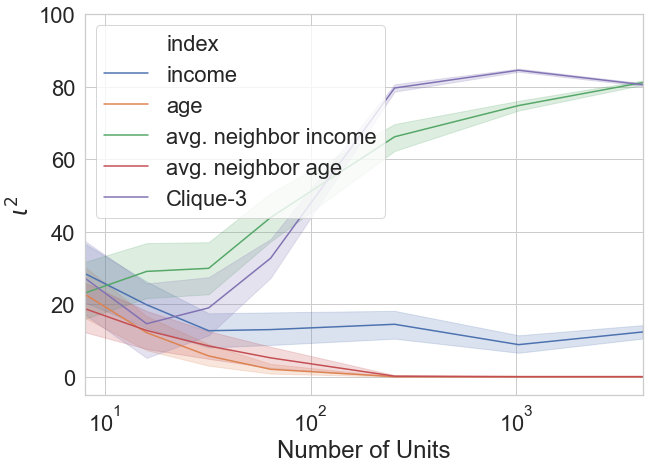

In [48]:
sns.set(font_scale=2)
sns.set_style("whitegrid")
fig = plt.figure(figsize=(10,7))
sns.lineplot(x='n',y='I2',hue='index',data=output)
plt.ylim(-5,100)
plt.xlim(8,4098)
plt.xscale('log')
plt.ylabel('$\iota^2$')
plt.xlabel('Number of Units')
plt.savefig('I2vsNumSamples.png')

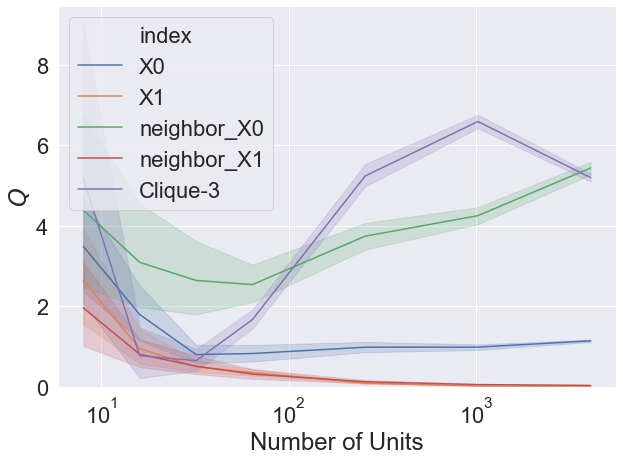

In [129]:
sns.set(font_scale=2)
sns.set_style("whitegrid")
fig = plt.figure(figsize=(10,7))
sns.lineplot(x='n',y='Q',hue='index',data=output)
plt.ylim(bottom=0)
plt.xscale('log')
plt.ylabel('$Q$')
plt.xlabel('Number of Units')
plt.savefig('QvsNumSamples.png')

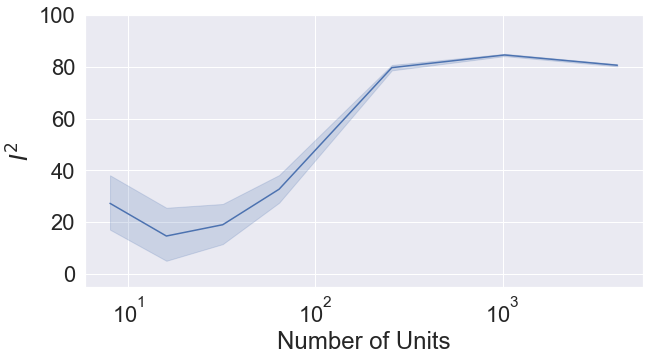

In [126]:
fig = plt.figure(figsize=(10,5))
sns.lineplot(x='n',y='I2',data=pd.concat(accumulator_main['test']).loc['Clique-3'])
plt.ylim(-5,100)
plt.xscale('log')
plt.ylabel('$I^2$')
plt.xlabel('Number of Units')
plt.savefig('I2vsNumSamples_tri.png')

## Effect of Noise

In [20]:
sample_noise = [0,1,4,8,16,64]
n = 4000
p = 2
accumulator_main = {'test':[]}
for rep in tqdm(range(100)):
    accumulator = {'test':[]}
    for noise in (sample_noise):
        df,df_social_net,social_net,triangle,Y1,Y0 = data_gen(n=n,p=p,meaningful=False,noise=noise)
        X,Y,T = effect_modifier_test.set_data(outcome='Y', treatment='T', df_unit = df, df_social_net = df_social_net, hypothesis = hypothesis)
        X['Clique-3'] = (triangle>0).astype(int)
        X_sample, Y_sample, T_sample = X[0:n], Y[0:n], T[0:n]
        X_sample,Y_sample,T_sample,CDE,ADE = effect_modifier_test.get_cde(X_sample,Y_sample,T_sample)
        discrete = ['Clique-3']
        df_CDE,ADE,estimator_f,Q,H  = effect_modifier_test.test_heterogeneity(X_sample,Y_sample,T_sample,CDE,ADE,hypothesis,discrete=discrete,predictor='Ridge')
        dfree = (n-1)/n#np.array([k-1 if key not in discrete else 1 for key in Q.keys()]).reshape(-1,1)
        df_test = pd.DataFrame.from_dict(Q,orient='index',columns=['Q'])
        df_test['I2'] = np.abs(pd.DataFrame((100*(df_test[['Q']].to_numpy()-dfree)/df_test[['Q']].to_numpy())*((df_test[['Q']].to_numpy()-dfree)>0),index=Q.keys()))
        df_test['df'] = dfree
        df_test['Noise'] = noise**2
        df_test['repeat'] = rep
        accumulator['test'] = accumulator['test']+[df_test]
    for key in accumulator.keys():
        accumulator_main[key] =  accumulator_main[key] + [pd.concat(accumulator[key])]

100%|██████████| 4000/4000 [00:07<00:00, 563.34it/s]

100%|██████████| 4000/4000 [00:24<00:00, 160.59it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.68it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.61it/s]

100%|██████████| 5/5 [00:00<00:00, 132.14it/s]


4.5799374722732775
(-39.660440065420524, 48.82031500996708)



100%|██████████| 4000/4000 [00:08<00:00, 495.33it/s]

100%|██████████| 4000/4000 [00:28<00:00, 139.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.85it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.10it/s]

100%|██████████| 5/5 [00:00<00:00, 150.00it/s]


6.145181400495645
(-39.04433170566607, 51.33469450665736)



100%|██████████| 4000/4000 [00:06<00:00, 591.79it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.07it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.63it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.78it/s]

100%|██████████| 5/5 [00:00<00:00, 146.64it/s]


1.1004633722675075
(-42.07565181102221, 44.27657855555722)



100%|██████████| 4000/4000 [00:06<00:00, 580.91it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.85it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.16it/s]

100%|██████████| 5/5 [00:00<00:00, 159.13it/s]


9.058411468761
(-38.14949535439524, 56.266318291917244)



100%|██████████| 4000/4000 [00:06<00:00, 586.68it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.97it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.87it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.85it/s]

100%|██████████| 5/5 [00:00<00:00, 142.34it/s]


-6.357223482488046
(-50.94918137340605, 38.23473440842996)



100%|██████████| 4000/4000 [00:07<00:00, 546.23it/s]

100%|██████████| 4000/4000 [00:23<00:00, 172.23it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.53it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.84it/s]

  1%|          | 1/100 [06:50<11:17:18, 410.49s/it]

-8.452200745427712
(-55.40787721948613, 38.50347572863071)



100%|██████████| 4000/4000 [00:06<00:00, 622.04it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.83it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.59it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.37it/s]

100%|██████████| 5/5 [00:00<00:00, 171.66it/s]


5.655385350664807
(-39.007465305315115, 50.31823600664473)



100%|██████████| 4000/4000 [00:06<00:00, 611.91it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.31it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.88it/s]

100%|██████████| 4000/4000 [00:16<00:00, 243.86it/s]

100%|██████████| 5/5 [00:00<00:00, 162.24it/s]


5.730509855618658
(-39.74466153616925, 51.20568124740656)



100%|██████████| 4000/4000 [00:07<00:00, 563.70it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.10it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.53it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.24it/s]

100%|██████████| 5/5 [00:00<00:00, 163.86it/s]


6.372098399020575
(-37.907326165097, 50.65152296313814)



100%|██████████| 4000/4000 [00:06<00:00, 608.78it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.38it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.31it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.02it/s]

100%|██████████| 5/5 [00:00<00:00, 162.68it/s]


15.715739737794687
(-37.619523847887436, 69.0510033234768)



100%|██████████| 4000/4000 [00:06<00:00, 621.07it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.98it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.77it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.60it/s]

100%|██████████| 5/5 [00:00<00:00, 125.19it/s]


2.3675637116485753
(-40.71953957608028, 45.45466699937742)



100%|██████████| 4000/4000 [00:06<00:00, 576.38it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.03it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.35it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.76it/s]

  2%|▏         | 2/100 [12:51<10:46:26, 395.78s/it]

-0.113812606312816
(-0.40603318232753094, 0.1784079697018989)



100%|██████████| 4000/4000 [00:06<00:00, 620.37it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.25it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.66it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.06it/s]

100%|██████████| 5/5 [00:00<00:00, 146.52it/s]


4.561058411621661
(-38.50451042371018, 47.6266272469535)



100%|██████████| 4000/4000 [00:06<00:00, 598.96it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.87it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.08it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.65it/s]

100%|██████████| 5/5 [00:00<00:00, 159.34it/s]


4.623122084581812
(-39.820466548183205, 49.06671071734684)



100%|██████████| 4000/4000 [00:06<00:00, 602.80it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.18it/s]

100%|██████████| 4000/4000 [00:14<00:00, 277.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 235.24it/s]

100%|██████████| 5/5 [00:00<00:00, 159.69it/s]


2.490143588597452
(-40.59199027507194, 45.57227745226685)



100%|██████████| 4000/4000 [00:06<00:00, 594.00it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.94it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.52it/s]

100%|██████████| 5/5 [00:00<00:00, 149.63it/s]


6.545197793344174
(-39.582173343144845, 52.67256892983319)



100%|██████████| 4000/4000 [00:06<00:00, 603.30it/s]

100%|██████████| 4000/4000 [00:25<00:00, 159.23it/s]

100%|██████████| 4000/4000 [00:14<00:00, 272.26it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.97it/s]

100%|██████████| 5/5 [00:00<00:00, 173.84it/s]


0.029375925043959705
(-0.054471785434991746, 0.11322363552291116)



100%|██████████| 4000/4000 [00:06<00:00, 629.06it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.10it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.90it/s]

  3%|▎         | 3/100 [18:46<10:19:57, 383.48s/it]

-17.992387513788966
(-74.18801219044177, 38.20323716286384)



100%|██████████| 4000/4000 [00:06<00:00, 612.53it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.25it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.79it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.21it/s]

100%|██████████| 5/5 [00:00<00:00, 155.64it/s]


6.451947524620831
(-38.99461400380156, 51.89850905304323)



100%|██████████| 4000/4000 [00:06<00:00, 582.70it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.99it/s]

100%|██████████| 4000/4000 [00:14<00:00, 276.19it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.47it/s]

100%|██████████| 5/5 [00:00<00:00, 162.70it/s]


4.9099738150186765
(-40.86410312665116, 50.68405075668851)



100%|██████████| 4000/4000 [00:06<00:00, 592.38it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.60it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.96it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.60it/s]

100%|██████████| 5/5 [00:00<00:00, 147.74it/s]


3.792651255451581
(-40.40337690921771, 47.988679420120874)



100%|██████████| 4000/4000 [00:07<00:00, 558.90it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.69it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.72it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.59it/s]

100%|██████████| 5/5 [00:00<00:00, 99.84it/s]


5.83414899995782
(-39.289472891259386, 50.957770891175024)



100%|██████████| 4000/4000 [00:07<00:00, 555.91it/s]

100%|██████████| 4000/4000 [00:23<00:00, 172.65it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.35it/s]

100%|██████████| 4000/4000 [00:22<00:00, 181.56it/s]

100%|██████████| 5/5 [00:00<00:00, 140.19it/s]


-8.59638745106105
(-53.678101656446884, 36.48532675432479)



100%|██████████| 4000/4000 [00:07<00:00, 569.03it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.21it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.93it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.97it/s]

  4%|▍         | 4/100 [25:22<10:19:34, 387.24s/it]

-53.43569052426239
(-169.58811084529415, 62.716729796769364)



100%|██████████| 4000/4000 [00:07<00:00, 567.24it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.21it/s]

100%|██████████| 4000/4000 [00:16<00:00, 243.93it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.69it/s]

100%|██████████| 5/5 [00:00<00:00, 159.05it/s]


5.405652607765837
(-38.51781357393502, 49.3291187894667)



100%|██████████| 4000/4000 [00:06<00:00, 595.28it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.55it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.87it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.88it/s]

100%|██████████| 5/5 [00:00<00:00, 169.78it/s]


5.923095466580524
(-38.336093397576505, 50.18228433073756)



100%|██████████| 4000/4000 [00:06<00:00, 593.00it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.00it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.35it/s]

100%|██████████| 5/5 [00:00<00:00, 170.42it/s]


3.1526268884747797
(-41.23647906615248, 47.54173284310203)



100%|██████████| 4000/4000 [00:06<00:00, 623.83it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.72it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.91it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.84it/s]

100%|██████████| 5/5 [00:00<00:00, 165.71it/s]


0.014431155663084385
(-0.21048162711378743, 0.23934393843995622)



100%|██████████| 4000/4000 [00:06<00:00, 633.52it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.96it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.50it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.39it/s]

100%|██████████| 5/5 [00:00<00:00, 166.40it/s]


0.023531489837574818
(-0.49056902925438894, 0.5376320089295386)



100%|██████████| 4000/4000 [00:06<00:00, 636.19it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.12it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.66it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.45it/s]

  5%|▌         | 5/100 [31:21<9:59:38, 378.72s/it] 

-0.133516698911696
(-0.41621489867722294, 0.1491815008538309)



100%|██████████| 4000/4000 [00:06<00:00, 632.10it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.98it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.39it/s]

100%|██████████| 5/5 [00:00<00:00, 147.64it/s]


5.827154229173184
(-40.39061554091392, 52.044923999260284)



100%|██████████| 4000/4000 [00:06<00:00, 626.54it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.46it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.11it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.15it/s]

100%|██████████| 5/5 [00:00<00:00, 169.29it/s]


6.01044401207119
(-39.21013571340583, 51.23102373754821)



100%|██████████| 4000/4000 [00:06<00:00, 616.88it/s]

100%|██████████| 4000/4000 [00:23<00:00, 169.04it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.61it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.53it/s]

100%|██████████| 5/5 [00:00<00:00, 146.31it/s]


1.422438548454455
(-43.018700837207746, 45.86357793411666)



100%|██████████| 4000/4000 [00:07<00:00, 552.55it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.54it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.12it/s]

100%|██████████| 5/5 [00:00<00:00, 173.58it/s]


-1.189775473398604
(-47.28233624521368, 44.90278529841647)



100%|██████████| 4000/4000 [00:06<00:00, 620.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.95it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.68it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.65it/s]

100%|██████████| 5/5 [00:00<00:00, 161.54it/s]


16.14091856989845
(-37.883199868672676, 70.16503700846957)



100%|██████████| 4000/4000 [00:06<00:00, 610.81it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.27it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.51it/s]

  6%|▌         | 6/100 [37:13<9:40:40, 370.64s/it]

-0.387154596845657
(-1.2042983470615516, 0.42998915337023746)



100%|██████████| 4000/4000 [00:06<00:00, 607.34it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.21it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.66it/s]

100%|██████████| 5/5 [00:00<00:00, 172.25it/s]


4.660161943485216
(-39.35776464843229, 48.678088535402715)



100%|██████████| 4000/4000 [00:06<00:00, 627.80it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.66it/s]

100%|██████████| 4000/4000 [00:13<00:00, 288.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.24it/s]

100%|██████████| 5/5 [00:00<00:00, 169.97it/s]


4.309376798845845
(-39.821430461409584, 48.44018405910128)



100%|██████████| 4000/4000 [00:06<00:00, 597.47it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.67it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.49it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.74it/s]

100%|██████████| 5/5 [00:00<00:00, 171.70it/s]


5.671517255991841
(-39.95545088744119, 51.29848539942488)



100%|██████████| 4000/4000 [00:06<00:00, 630.96it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.21it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.56it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.09it/s]

100%|██████████| 5/5 [00:00<00:00, 154.34it/s]


1.2429215569477106
(-41.16028685664873, 43.64612997054416)



100%|██████████| 4000/4000 [00:07<00:00, 569.68it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.27it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.40it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.64it/s]

100%|██████████| 5/5 [00:00<00:00, 141.53it/s]


-17.054959516560245
(-71.50831482033533, 37.39839578721484)



100%|██████████| 4000/4000 [00:07<00:00, 556.60it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.19it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.43it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.59it/s]

  7%|▋         | 7/100 [43:11<9:28:32, 366.80s/it]

-0.16875660997117503
(-0.5371961785242819, 0.19968295858193186)



100%|██████████| 4000/4000 [00:07<00:00, 539.62it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.89it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.18it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.05it/s]

100%|██████████| 5/5 [00:00<00:00, 165.49it/s]


5.478191338711702
(-39.886536881444876, 50.84291955886828)



100%|██████████| 4000/4000 [00:07<00:00, 561.96it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.39it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.55it/s]

100%|██████████| 5/5 [00:00<00:00, 107.19it/s]


4.911408632385433
(-39.606549818601444, 49.429367083372306)



100%|██████████| 4000/4000 [00:07<00:00, 557.26it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.43it/s]

100%|██████████| 4000/4000 [00:16<00:00, 241.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.53it/s]

100%|██████████| 5/5 [00:00<00:00, 121.12it/s]


3.5492052529450895
(-40.753521013496496, 47.85193151938668)



100%|██████████| 4000/4000 [00:06<00:00, 572.20it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.47it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.49it/s]

100%|██████████| 5/5 [00:00<00:00, 105.06it/s]


7.21530432557804
(-40.77037288993837, 55.20098154109445)



100%|██████████| 4000/4000 [00:08<00:00, 488.88it/s]

100%|██████████| 4000/4000 [00:26<00:00, 153.62it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.77it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.51it/s]

100%|██████████| 5/5 [00:00<00:00, 90.52it/s]


7.575639173921389
(-37.96580707620822, 53.117085424051)



100%|██████████| 4000/4000 [00:08<00:00, 479.78it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.26it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.91it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.96it/s]

  8%|▊         | 8/100 [50:06<9:44:32, 381.22s/it]

-16.49507732717165
(-70.93560762007412, 37.94545296573082)



100%|██████████| 4000/4000 [00:07<00:00, 570.94it/s]

100%|██████████| 4000/4000 [00:21<00:00, 183.81it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.62it/s]

100%|██████████| 5/5 [00:00<00:00, 160.90it/s]


6.351200132683875
(-39.976703853395065, 52.67910411876282)



100%|██████████| 4000/4000 [00:06<00:00, 605.13it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.77it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.50it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.67it/s]

100%|██████████| 5/5 [00:00<00:00, 158.36it/s]


3.8369308501163877
(-38.77549215305625, 46.449353853289026)



100%|██████████| 4000/4000 [00:06<00:00, 593.58it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.33it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.39it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.93it/s]

100%|██████████| 5/5 [00:00<00:00, 150.24it/s]


5.855904382241841
(-38.41245044182546, 50.12425920630914)



100%|██████████| 4000/4000 [00:07<00:00, 564.69it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.63it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.42it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.58it/s]

100%|██████████| 5/5 [00:00<00:00, 119.82it/s]


0.08657018897469243
(-45.66146565388198, 45.83460603183136)



100%|██████████| 4000/4000 [00:06<00:00, 577.15it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.62it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.43it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.88it/s]

100%|██████████| 5/5 [00:00<00:00, 156.04it/s]


-0.06431790820958028
(-0.29056948422627016, 0.16193366780710958)



100%|██████████| 4000/4000 [00:06<00:00, 573.68it/s]

100%|██████████| 4000/4000 [00:21<00:00, 184.73it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.59it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.36it/s]

  9%|▉         | 9/100 [56:33<9:41:02, 383.11s/it]

43.5299607079365
(-54.390309535420606, 141.4502309512936)



100%|██████████| 4000/4000 [00:07<00:00, 560.88it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.54it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.76it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.97it/s]

100%|██████████| 5/5 [00:00<00:00, 164.56it/s]


6.330416054960355
(-40.87947424039934, 53.540306350320044)



100%|██████████| 4000/4000 [00:06<00:00, 580.56it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.00it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.76it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.01it/s]

100%|██████████| 5/5 [00:00<00:00, 147.76it/s]


4.563354323272483
(-39.65625498747039, 48.78296363401536)



100%|██████████| 4000/4000 [00:07<00:00, 559.82it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.77it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.70it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.44it/s]

100%|██████████| 5/5 [00:00<00:00, 110.27it/s]


8.057147222930567
(-37.80233604871787, 53.916630494579)



100%|██████████| 4000/4000 [00:06<00:00, 593.85it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.77it/s]

100%|██████████| 4000/4000 [00:14<00:00, 272.16it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.35it/s]

100%|██████████| 5/5 [00:00<00:00, 163.74it/s]


3.8258050066416636
(-40.5060430260493, 48.15765303933263)



100%|██████████| 4000/4000 [00:07<00:00, 508.70it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.96it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.91it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.29it/s]

100%|██████████| 5/5 [00:00<00:00, 164.69it/s]


-29.843888179310074
(-105.0219622305954, 45.334185871975265)



100%|██████████| 4000/4000 [00:06<00:00, 598.02it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.96it/s]

100%|██████████| 4000/4000 [00:14<00:00, 279.36it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.06it/s]

 10%|█         | 10/100 [1:02:50<9:31:44, 381.16s/it]

-15.877110817502514
(-70.81121690515496, 39.05699527014993)



100%|██████████| 4000/4000 [00:06<00:00, 603.91it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.52it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.38it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.52it/s]

100%|██████████| 5/5 [00:00<00:00, 164.09it/s]


4.255887300034275
(-38.71100957089404, 47.22278417096259)



100%|██████████| 4000/4000 [00:06<00:00, 614.44it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.73it/s]

100%|██████████| 4000/4000 [00:14<00:00, 276.57it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.71it/s]

100%|██████████| 5/5 [00:00<00:00, 139.98it/s]


4.282502366810104
(-40.534241548491394, 49.09924628211161)



100%|██████████| 4000/4000 [00:06<00:00, 600.93it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.13it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.46it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.22it/s]

100%|██████████| 5/5 [00:00<00:00, 160.93it/s]


5.65996947836217
(-39.647811938162754, 50.9677508948871)



100%|██████████| 4000/4000 [00:06<00:00, 605.74it/s]

100%|██████████| 4000/4000 [00:18<00:00, 210.90it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.41it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.34it/s]

100%|██████████| 5/5 [00:00<00:00, 123.63it/s]


3.3497111419584225
(-40.90375698257077, 47.603179266487615)



100%|██████████| 4000/4000 [00:06<00:00, 584.20it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.31it/s]

100%|██████████| 4000/4000 [00:14<00:00, 279.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.03it/s]

100%|██████████| 5/5 [00:00<00:00, 166.21it/s]


2.762947737592277
(-41.21561676026351, 46.74151223544806)



100%|██████████| 4000/4000 [00:06<00:00, 622.62it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.44it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.50it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.18it/s]

 11%|█         | 11/100 [1:08:41<9:11:52, 372.05s/it]

0.05056765754290474
(-0.0570095134285348, 0.15814482851434428)



100%|██████████| 4000/4000 [00:06<00:00, 618.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.94it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.21it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.84it/s]

100%|██████████| 5/5 [00:00<00:00, 169.10it/s]


5.226059885625065
(-38.95714928365993, 49.409269054910055)



100%|██████████| 4000/4000 [00:06<00:00, 632.27it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.20it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.94it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.21it/s]

100%|██████████| 5/5 [00:00<00:00, 169.35it/s]


4.143042030545827
(-40.01045477425713, 48.296538835348784)



100%|██████████| 4000/4000 [00:06<00:00, 638.32it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.55it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.00it/s]

100%|██████████| 5/5 [00:00<00:00, 160.99it/s]


5.042391697692137
(-39.697787172384565, 49.78257056776884)



100%|██████████| 4000/4000 [00:06<00:00, 626.79it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.26it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.75it/s]

100%|██████████| 5/5 [00:00<00:00, 163.75it/s]


9.45536372904392
(-38.23871636949697, 57.149443827584804)



100%|██████████| 4000/4000 [00:06<00:00, 626.04it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.64it/s]

100%|██████████| 4000/4000 [00:14<00:00, 271.40it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.22it/s]

100%|██████████| 5/5 [00:00<00:00, 150.93it/s]


4.982022921280496
(-38.95107478684803, 48.915120629409024)



100%|██████████| 4000/4000 [00:07<00:00, 539.75it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.35it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.70it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.80it/s]

 12%|█▏        | 12/100 [1:14:22<8:52:20, 362.96s/it]

43.321533411654556
(-51.52943847596097, 138.17250529927009)



100%|██████████| 4000/4000 [00:06<00:00, 600.75it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.59it/s]

100%|██████████| 4000/4000 [00:14<00:00, 271.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.36it/s]

100%|██████████| 5/5 [00:00<00:00, 163.93it/s]


5.362596354885782
(-39.5817469033632, 50.30693961313476)



100%|██████████| 4000/4000 [00:06<00:00, 588.36it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.47it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.09it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.52it/s]

100%|██████████| 5/5 [00:00<00:00, 162.61it/s]


6.279250177531398
(-40.55326600486258, 53.11176635992537)



100%|██████████| 4000/4000 [00:06<00:00, 608.37it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.40it/s]

100%|██████████| 4000/4000 [00:14<00:00, 276.29it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.63it/s]

100%|██████████| 5/5 [00:00<00:00, 156.30it/s]


2.6919233639090554
(-41.557664041249836, 46.941510769067946)



100%|██████████| 4000/4000 [00:06<00:00, 614.49it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.59it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.62it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.78it/s]

100%|██████████| 5/5 [00:00<00:00, 165.36it/s]


-0.0004388584487554174
(-0.007235107854306805, 0.00635739095679597)



100%|██████████| 4000/4000 [00:06<00:00, 609.55it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.31it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.69it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.29it/s]

100%|██████████| 5/5 [00:00<00:00, 165.44it/s]


13.010770871564588
(-38.403018501328184, 64.42456024445735)



100%|██████████| 4000/4000 [00:06<00:00, 610.20it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.49it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.43it/s]

 13%|█▎        | 13/100 [1:20:12<8:40:30, 358.97s/it]

18.507955599130845
(-39.381950492891896, 76.3978616911536)



100%|██████████| 4000/4000 [00:06<00:00, 607.60it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.47it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.40it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.60it/s]

100%|██████████| 5/5 [00:00<00:00, 146.24it/s]


5.79137546876441
(-39.210838005310436, 50.79358894283925)



100%|██████████| 4000/4000 [00:06<00:00, 605.20it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.69it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.40it/s]

100%|██████████| 5/5 [00:00<00:00, 160.01it/s]


5.643572006649291
(-40.607618231672674, 51.89476224497126)



100%|██████████| 4000/4000 [00:06<00:00, 619.43it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.89it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.85it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.31it/s]

100%|██████████| 5/5 [00:00<00:00, 167.55it/s]


4.764623323262313
(-41.325983306894365, 50.85522995341899)



100%|██████████| 4000/4000 [00:06<00:00, 607.06it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.24it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.85it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.02it/s]

100%|██████████| 5/5 [00:00<00:00, 165.51it/s]


3.3511341317274157
(-40.45369516369348, 47.15596342714831)



100%|██████████| 4000/4000 [00:06<00:00, 609.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.77it/s]

100%|██████████| 4000/4000 [00:13<00:00, 286.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.42it/s]

100%|██████████| 5/5 [00:00<00:00, 159.24it/s]


0.005871802481755132
(-0.3886549638878146, 0.40039856885132485)



100%|██████████| 4000/4000 [00:06<00:00, 587.86it/s]

100%|██████████| 4000/4000 [00:18<00:00, 210.62it/s]

100%|██████████| 4000/4000 [00:14<00:00, 285.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.35it/s]

 14%|█▍        | 14/100 [1:26:00<8:29:44, 355.63s/it]

0.11595106072562808
(-0.20691048665271353, 0.4388126081039697)



100%|██████████| 4000/4000 [00:06<00:00, 615.44it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.24it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.00it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.31it/s]

100%|██████████| 5/5 [00:00<00:00, 161.42it/s]


5.757902082988971
(-39.08400078803009, 50.59980495400803)



100%|██████████| 4000/4000 [00:06<00:00, 619.11it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.03it/s]

100%|██████████| 4000/4000 [00:13<00:00, 286.18it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.02it/s]

100%|██████████| 5/5 [00:00<00:00, 157.95it/s]


4.948041342713872
(-40.82737859643165, 50.72346128185939)



100%|██████████| 4000/4000 [00:06<00:00, 608.59it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.43it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.34it/s]

100%|██████████| 5/5 [00:00<00:00, 155.89it/s]


7.5700230064207465
(-38.09666490407063, 53.23671091691212)



100%|██████████| 4000/4000 [00:06<00:00, 609.52it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.72it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.85it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.80it/s]

100%|██████████| 5/5 [00:00<00:00, 165.51it/s]


15.959836312149568
(-38.155452473115936, 70.07512509741507)



100%|██████████| 4000/4000 [00:06<00:00, 611.36it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.04it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.11it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.30it/s]

100%|██████████| 5/5 [00:00<00:00, 170.15it/s]


-7.613179618580645
(-53.168743996497696, 37.942384759336406)



100%|██████████| 4000/4000 [00:06<00:00, 607.67it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.50it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.07it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.17it/s]

 15%|█▌        | 15/100 [1:31:49<8:21:03, 353.69s/it]

-0.0010279621760735417
(-0.005924024672901891, 0.0038681003207548083)



100%|██████████| 4000/4000 [00:06<00:00, 609.13it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.29it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.33it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.70it/s]

100%|██████████| 5/5 [00:00<00:00, 121.61it/s]


5.246309557158236
(-40.15035691023051, 50.642976024546975)



100%|██████████| 4000/4000 [00:08<00:00, 494.20it/s]

100%|██████████| 4000/4000 [00:22<00:00, 181.10it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.04it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.73it/s]

100%|██████████| 5/5 [00:00<00:00, 163.06it/s]


5.971452826927136
(-40.27711288267787, 52.22001853653214)



100%|██████████| 4000/4000 [00:06<00:00, 581.35it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.34it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.14it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.33it/s]

100%|██████████| 5/5 [00:00<00:00, 163.77it/s]


2.7052769537972177
(-41.030067803990825, 46.44062171158526)



100%|██████████| 4000/4000 [00:06<00:00, 596.73it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.89it/s]

100%|██████████| 4000/4000 [00:17<00:00, 235.11it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.51it/s]

100%|██████████| 5/5 [00:00<00:00, 106.36it/s]


2.0149885220123034
(-42.127343501135606, 46.15732054516021)



100%|██████████| 4000/4000 [00:07<00:00, 565.65it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.39it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.97it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.29it/s]

100%|██████████| 5/5 [00:00<00:00, 105.52it/s]


10.87579235103982
(-37.508095449073565, 59.259680151153205)



100%|██████████| 4000/4000 [00:06<00:00, 582.33it/s]

100%|██████████| 4000/4000 [00:21<00:00, 183.57it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.80it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.08it/s]

 16%|█▌        | 16/100 [1:38:40<8:39:24, 371.01s/it]

0.29562240790801103
(-0.4372526526235773, 1.0284974684395993)



100%|██████████| 4000/4000 [00:06<00:00, 577.15it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.64it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.59it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.13it/s]

100%|██████████| 5/5 [00:00<00:00, 164.79it/s]


5.537526163097473
(-40.23861547908552, 51.31366780528047)



100%|██████████| 4000/4000 [00:06<00:00, 589.31it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.29it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.48it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.55it/s]

100%|██████████| 5/5 [00:00<00:00, 141.48it/s]


4.878904896551595
(-39.294931900312804, 49.052741693415996)



100%|██████████| 4000/4000 [00:07<00:00, 540.29it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.64it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.47it/s]

100%|██████████| 5/5 [00:00<00:00, 169.05it/s]


-0.006280440735416963
(-0.05277299723564926, 0.040212115764815336)



100%|██████████| 4000/4000 [00:06<00:00, 602.81it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.08it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.43it/s]

100%|██████████| 5/5 [00:00<00:00, 152.76it/s]


8.668896621763382
(-38.12605276300068, 55.46384600652744)



100%|██████████| 4000/4000 [00:07<00:00, 565.24it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.84it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.53it/s]

100%|██████████| 5/5 [00:00<00:00, 153.42it/s]


-0.009698014625804713
(-0.07193831404945791, 0.05254228479784848)



100%|██████████| 4000/4000 [00:07<00:00, 567.14it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.31it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.58it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.24it/s]

 17%|█▋        | 17/100 [1:45:08<8:40:20, 376.15s/it]

0.006935947369656031
(-0.007664709423628478, 0.02153660416294054)



100%|██████████| 4000/4000 [00:06<00:00, 584.05it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.41it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.11it/s]

100%|██████████| 4000/4000 [00:23<00:00, 167.22it/s]

100%|██████████| 5/5 [00:00<00:00, 123.47it/s]


6.010813028722117
(-39.0309556793039, 51.05258173674814)



100%|██████████| 4000/4000 [00:07<00:00, 541.88it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.70it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.80it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.82it/s]

100%|██████████| 5/5 [00:00<00:00, 122.38it/s]


5.404684213295057
(-37.87819505879072, 48.687563485380835)



100%|██████████| 4000/4000 [00:07<00:00, 558.06it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.01it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.02it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.89it/s]

100%|██████████| 5/5 [00:00<00:00, 138.93it/s]


5.871251623442773
(-39.10687261512904, 50.84937586201459)



100%|██████████| 4000/4000 [00:07<00:00, 551.06it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.83it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.28it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.86it/s]

100%|██████████| 5/5 [00:00<00:00, 130.31it/s]


6.569842339448871
(-38.33838918786268, 51.47807386676042)



100%|██████████| 4000/4000 [00:07<00:00, 556.25it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.16it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.33it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.86it/s]

100%|██████████| 5/5 [00:00<00:00, 140.04it/s]


2.119354620977244
(-40.680409480430995, 44.91911872238548)



100%|██████████| 4000/4000 [00:07<00:00, 571.07it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.43it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.91it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.32it/s]

 18%|█▊        | 18/100 [1:52:12<8:53:25, 390.31s/it]

3.863083931939148
(-41.44708041377787, 49.17324827765617)



100%|██████████| 4000/4000 [00:06<00:00, 596.39it/s]

100%|██████████| 4000/4000 [00:21<00:00, 184.94it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.01it/s]

100%|██████████| 4000/4000 [00:28<00:00, 138.37it/s]

100%|██████████| 5/5 [00:00<00:00, 42.26it/s]


5.078333602201395
(-39.93585650254337, 50.09252370694617)



100%|██████████| 4000/4000 [00:08<00:00, 473.27it/s]

100%|██████████| 4000/4000 [00:24<00:00, 166.15it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.72it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.92it/s]

100%|██████████| 5/5 [00:00<00:00, 100.49it/s]


4.601661552984324
(-40.33572389344291, 49.53904699941156)



100%|██████████| 4000/4000 [00:07<00:00, 559.74it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.76it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.93it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.73it/s]

100%|██████████| 5/5 [00:00<00:00, 147.27it/s]


6.302893952486455
(-40.54717830108489, 53.152966206057805)



100%|██████████| 4000/4000 [00:07<00:00, 567.33it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.85it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.18it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.05it/s]

100%|██████████| 5/5 [00:00<00:00, 138.06it/s]


4.998212538056523
(-41.86619193161785, 51.86261700773089)



100%|██████████| 4000/4000 [00:07<00:00, 544.75it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.56it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.43it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.93it/s]

100%|██████████| 5/5 [00:00<00:00, 135.01it/s]


-0.019266148919146266
(-0.13021721619775992, 0.09168491835946738)



100%|██████████| 4000/4000 [00:07<00:00, 545.80it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.74it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.58it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.85it/s]

 19%|█▉        | 19/100 [1:59:34<9:08:07, 406.02s/it]

-6.326679637792091
(-50.80865711701943, 38.15529784143525)



100%|██████████| 4000/4000 [00:07<00:00, 567.75it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.62it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.00it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.17it/s]

100%|██████████| 5/5 [00:00<00:00, 134.90it/s]


4.679334948663012
(-38.37775542696595, 47.73642532429197)



100%|██████████| 4000/4000 [00:06<00:00, 573.21it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.99it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.27it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.21it/s]

100%|██████████| 5/5 [00:00<00:00, 147.69it/s]


3.8847742415010718
(-38.5796516348044, 46.34920011780654)



100%|██████████| 4000/4000 [00:06<00:00, 587.00it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.01it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.14it/s]

100%|██████████| 4000/4000 [00:18<00:00, 210.59it/s]

100%|██████████| 5/5 [00:00<00:00, 140.61it/s]


1.3424259876855633
(-42.10254106636501, 44.787393041736145)



100%|██████████| 4000/4000 [00:06<00:00, 606.65it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.89it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.03it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.20it/s]

100%|██████████| 5/5 [00:00<00:00, 90.19it/s]


-0.0004578746480181053
(-43.28834120020786, 43.28742545091182)



100%|██████████| 4000/4000 [00:06<00:00, 580.37it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.77it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.46it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.31it/s]

100%|██████████| 5/5 [00:00<00:00, 124.73it/s]


0.06334546209128791
(-0.23751156678352556, 0.36420249096610136)



100%|██████████| 4000/4000 [00:06<00:00, 607.49it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.39it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.83it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.01it/s]

 20%|██        | 20/100 [2:06:02<8:53:54, 400.43s/it]

0.4601726425334023
(-0.5177583383990498, 1.4381036234658544)



100%|██████████| 4000/4000 [00:06<00:00, 605.25it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.35it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.37it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.91it/s]

100%|██████████| 5/5 [00:00<00:00, 128.88it/s]


4.664080737121597
(-38.69692578593045, 48.02508726017364)



100%|██████████| 4000/4000 [00:06<00:00, 586.01it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.66it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.84it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.21it/s]

100%|██████████| 5/5 [00:00<00:00, 140.11it/s]


5.319285305543919
(-39.60510394459758, 50.24367455568542)



100%|██████████| 4000/4000 [00:06<00:00, 592.96it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.34it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.31it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.16it/s]

100%|██████████| 5/5 [00:00<00:00, 157.41it/s]


-0.017888730438447065
(-0.528428168964054, 0.4926507080871598)



100%|██████████| 4000/4000 [00:06<00:00, 591.23it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.42it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.88it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.55it/s]

100%|██████████| 5/5 [00:00<00:00, 152.77it/s]


7.0868176224706145
(-38.68579142888964, 52.85942667383086)



100%|██████████| 4000/4000 [00:06<00:00, 584.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.04it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.65it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.93it/s]

100%|██████████| 5/5 [00:00<00:00, 139.94it/s]


0.20325932829516166
(-0.40122464528285107, 0.8077433018731744)



100%|██████████| 4000/4000 [00:06<00:00, 596.85it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.87it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.86it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.56it/s]

 21%|██        | 21/100 [2:12:16<8:36:46, 392.49s/it]

-0.04980431689984558
(-0.15449760736834836, 0.05488897356865719)



100%|██████████| 4000/4000 [00:06<00:00, 624.10it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.80it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.36it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.12it/s]

100%|██████████| 5/5 [00:00<00:00, 177.80it/s]


5.690444140337075
(-37.71988075658818, 49.100769037262324)



100%|██████████| 4000/4000 [00:06<00:00, 630.10it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.86it/s]

100%|██████████| 4000/4000 [00:13<00:00, 285.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.06it/s]

100%|██████████| 5/5 [00:00<00:00, 170.14it/s]


5.4519988854040475
(-39.67322669139739, 50.57722446220548)



100%|██████████| 4000/4000 [00:06<00:00, 635.75it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.42it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.57it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.08it/s]

100%|██████████| 5/5 [00:00<00:00, 174.80it/s]


5.065106449932731
(-37.8273605064427, 47.95757340630817)



100%|██████████| 4000/4000 [00:06<00:00, 624.80it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.41it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.38it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.88it/s]

100%|██████████| 5/5 [00:00<00:00, 165.34it/s]


6.9896524040646595
(-38.416638568078824, 52.39594337620814)



100%|██████████| 4000/4000 [00:06<00:00, 617.51it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.11it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.24it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.02it/s]

100%|██████████| 5/5 [00:00<00:00, 177.65it/s]


9.140837104345827
(-39.75894473074501, 58.04061893943666)



100%|██████████| 4000/4000 [00:06<00:00, 638.07it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.65it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.93it/s]

 22%|██▏       | 22/100 [2:17:50<8:07:31, 375.02s/it]

0.028233758513098537
(-0.11144469826047157, 0.16791221528666864)



100%|██████████| 4000/4000 [00:06<00:00, 630.20it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.16it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.21it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.93it/s]

100%|██████████| 5/5 [00:00<00:00, 169.35it/s]


4.87659988478985
(-38.92117131638293, 48.674371085962626)



100%|██████████| 4000/4000 [00:06<00:00, 640.05it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.22it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.43it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.90it/s]

100%|██████████| 5/5 [00:00<00:00, 166.96it/s]


4.4495491704945636
(-39.2485831545794, 48.14768149556853)



100%|██████████| 4000/4000 [00:06<00:00, 633.73it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.20it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.87it/s]

100%|██████████| 5/5 [00:00<00:00, 166.90it/s]


8.7596316838577
(-38.43543331825178, 55.95469668596718)



100%|██████████| 4000/4000 [00:06<00:00, 626.80it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.24it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.90it/s]

100%|██████████| 5/5 [00:00<00:00, 173.89it/s]


-0.5503280054393028
(-42.91889760795685, 41.81824159707824)



100%|██████████| 4000/4000 [00:06<00:00, 637.73it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.30it/s]

100%|██████████| 4000/4000 [00:13<00:00, 290.01it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.07it/s]

100%|██████████| 5/5 [00:00<00:00, 171.16it/s]


-4.528594505947531
(-49.93421276321787, 40.87702375132281)



100%|██████████| 4000/4000 [00:06<00:00, 638.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.73it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.92it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.30it/s]

 23%|██▎       | 23/100 [2:23:20<7:43:55, 361.50s/it]

-0.4969420747149934
(-1.5613699618737735, 0.5674858124437866)



100%|██████████| 4000/4000 [00:06<00:00, 584.56it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.34it/s]

100%|██████████| 5/5 [00:00<00:00, 166.62it/s]


4.662775676938418
(-38.315697883027106, 47.64124923690394)



100%|██████████| 4000/4000 [00:06<00:00, 646.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.46it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.88it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.33it/s]

100%|██████████| 5/5 [00:00<00:00, 167.54it/s]


5.362189882762071
(-38.17466056687603, 48.899040332400176)



100%|██████████| 4000/4000 [00:06<00:00, 646.08it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.62it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.14it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.43it/s]

100%|██████████| 5/5 [00:00<00:00, 163.92it/s]


4.1288482593421625
(-40.265015786786705, 48.52271230547103)



100%|██████████| 4000/4000 [00:06<00:00, 608.79it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.20it/s]

100%|██████████| 4000/4000 [00:13<00:00, 291.44it/s]

100%|██████████| 4000/4000 [00:14<00:00, 271.93it/s]

100%|██████████| 5/5 [00:00<00:00, 153.50it/s]


5.341529043028545
(-39.12200518992709, 49.805063275984175)



100%|██████████| 4000/4000 [00:06<00:00, 632.92it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.10it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.14it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.21it/s]

100%|██████████| 5/5 [00:00<00:00, 169.76it/s]


19.570299699920902
(-38.70430307169875, 77.84490247154056)



100%|██████████| 4000/4000 [00:06<00:00, 618.38it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.62it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.52it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.44it/s]

 24%|██▍       | 24/100 [2:28:51<7:26:07, 352.20s/it]

-0.00716702716229582
(-0.02423042358578603, 0.00989636926119439)



100%|██████████| 4000/4000 [00:06<00:00, 625.18it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.93it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.02it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.42it/s]

100%|██████████| 5/5 [00:00<00:00, 168.88it/s]


7.269935880456589
(-40.27298100444482, 54.812852765357995)



100%|██████████| 4000/4000 [00:06<00:00, 637.30it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.82it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.78it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.46it/s]

100%|██████████| 5/5 [00:00<00:00, 154.45it/s]


5.508214425829759
(-40.03839810482603, 51.05482695648554)



100%|██████████| 4000/4000 [00:06<00:00, 638.07it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.84it/s]

100%|██████████| 4000/4000 [00:14<00:00, 285.47it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.36it/s]

100%|██████████| 5/5 [00:00<00:00, 166.53it/s]


3.3470149053073226
(-41.53434330609495, 48.2283731167096)



100%|██████████| 4000/4000 [00:06<00:00, 632.20it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.59it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.04it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.66it/s]

100%|██████████| 5/5 [00:00<00:00, 165.84it/s]


-3.175841734488487
(-46.98089160144782, 40.62920813247085)



100%|██████████| 4000/4000 [00:06<00:00, 644.41it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.54it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.72it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.57it/s]

100%|██████████| 5/5 [00:00<00:00, 143.57it/s]


11.094152782978329
(-38.343620762512224, 60.53192632846888)



100%|██████████| 4000/4000 [00:06<00:00, 618.15it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.70it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.05it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.34it/s]

 25%|██▌       | 25/100 [2:34:25<7:13:42, 346.97s/it]

0.13566609426060863
(-0.15802292994269942, 0.4293551184639167)



100%|██████████| 4000/4000 [00:07<00:00, 537.51it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.46it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.37it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.31it/s]

100%|██████████| 5/5 [00:00<00:00, 165.35it/s]


4.833799273491747
(-39.90943442096273, 49.57703296794623)



100%|██████████| 4000/4000 [00:06<00:00, 624.14it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.15it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.49it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.63it/s]

100%|██████████| 5/5 [00:00<00:00, 165.01it/s]


4.917275621906045
(-39.061213159210084, 48.89576440302217)



100%|██████████| 4000/4000 [00:06<00:00, 634.79it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.80it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.17it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.59it/s]

100%|██████████| 5/5 [00:00<00:00, 168.45it/s]


5.610281212192379
(-38.495514134245695, 49.71607655863045)



100%|██████████| 4000/4000 [00:06<00:00, 611.98it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.91it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.32it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.44it/s]

100%|██████████| 5/5 [00:00<00:00, 162.74it/s]


-0.0017453101668953935
(-0.2821104161978708, 0.27861979586408003)



100%|██████████| 4000/4000 [00:06<00:00, 603.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.03it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.73it/s]

100%|██████████| 5/5 [00:00<00:00, 173.93it/s]


0.5855655545293125
(-44.15265389196479, 45.32378500102341)



100%|██████████| 4000/4000 [00:06<00:00, 635.90it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.39it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.19it/s]

 26%|██▌       | 26/100 [2:40:03<7:04:25, 344.13s/it]

0.2253049831306439
(-0.2283666438872965, 0.6789766101485843)



100%|██████████| 4000/4000 [00:06<00:00, 613.62it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.23it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.78it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.51it/s]

100%|██████████| 5/5 [00:00<00:00, 52.79it/s]


5.402827020928542
(-37.35225590973, 48.15790995158708)



100%|██████████| 4000/4000 [00:06<00:00, 622.20it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.09it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.58it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.52it/s]

100%|██████████| 5/5 [00:00<00:00, 161.71it/s]


4.085725827420773
(-38.613478836050206, 46.78493049089175)



100%|██████████| 4000/4000 [00:06<00:00, 636.84it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.14it/s]

100%|██████████| 4000/4000 [00:13<00:00, 288.01it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.83it/s]

100%|██████████| 5/5 [00:00<00:00, 164.50it/s]


4.572511778796894
(-39.513856838133364, 48.65888039572715)



100%|██████████| 4000/4000 [00:06<00:00, 629.15it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.85it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.80it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.09it/s]

100%|██████████| 5/5 [00:00<00:00, 169.59it/s]


19.41193282276734
(-38.60123436064497, 77.42510000617966)



100%|██████████| 4000/4000 [00:06<00:00, 622.92it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.52it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.01it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.22it/s]

100%|██████████| 5/5 [00:00<00:00, 172.00it/s]


18.20793018093967
(-39.380270117614984, 75.79613047949432)



100%|██████████| 4000/4000 [00:06<00:00, 634.43it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 290.07it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.87it/s]

 27%|██▋       | 27/100 [2:45:45<6:57:50, 343.43s/it]

0.024066337592958856
(-0.041723867813861254, 0.08985654299977897)



100%|██████████| 4000/4000 [00:06<00:00, 637.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.03it/s]

100%|██████████| 4000/4000 [00:13<00:00, 289.26it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.26it/s]

100%|██████████| 5/5 [00:00<00:00, 169.47it/s]


4.3864926415479575
(-40.21329196711021, 48.98627725020613)



100%|██████████| 4000/4000 [00:06<00:00, 632.76it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.52it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.66it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.02it/s]

100%|██████████| 5/5 [00:00<00:00, 168.90it/s]


4.874689873955318
(-38.489833727699995, 48.23921347561063)



100%|██████████| 4000/4000 [00:06<00:00, 627.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.93it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.30it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.51it/s]

100%|██████████| 5/5 [00:00<00:00, 172.94it/s]


7.191202254257507
(-38.30253454149893, 52.68493905001394)



100%|██████████| 4000/4000 [00:06<00:00, 629.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.26it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.12it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.41it/s]

100%|██████████| 5/5 [00:00<00:00, 144.32it/s]


-5.038144998339975
(-51.05351694411484, 40.97722694743489)



100%|██████████| 4000/4000 [00:06<00:00, 612.68it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.14it/s]

100%|██████████| 4000/4000 [00:14<00:00, 276.86it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.91it/s]

100%|██████████| 5/5 [00:00<00:00, 173.20it/s]


18.23532315117684
(-38.34998309560886, 74.82062939796255)



100%|██████████| 4000/4000 [00:06<00:00, 599.11it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.18it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.35it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.59it/s]

 28%|██▊       | 28/100 [2:51:23<6:50:09, 341.79s/it]

-0.01955707980016979
(-0.06799265397708043, 0.02887849437674085)



100%|██████████| 4000/4000 [00:06<00:00, 629.52it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.31it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.76it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.23it/s]

100%|██████████| 5/5 [00:00<00:00, 167.52it/s]


4.88197764442035
(-39.71911843574597, 49.483073724586674)



100%|██████████| 4000/4000 [00:06<00:00, 623.84it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.41it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.67it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.89it/s]

100%|██████████| 5/5 [00:00<00:00, 106.88it/s]


5.258144655499338
(-39.295460333023506, 49.81174964402218)



100%|██████████| 4000/4000 [00:07<00:00, 563.24it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.01it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.86it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.34it/s]

100%|██████████| 5/5 [00:00<00:00, 126.32it/s]


8.224207542992422
(-38.706172905418455, 55.154587991403304)



100%|██████████| 4000/4000 [00:07<00:00, 565.62it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.36it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.32it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.10it/s]

100%|██████████| 5/5 [00:00<00:00, 149.79it/s]


-1.131428521154008
(-47.30568531938696, 45.04282827707895)



100%|██████████| 4000/4000 [00:07<00:00, 569.79it/s]

100%|██████████| 4000/4000 [00:25<00:00, 159.78it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.72it/s]

100%|██████████| 4000/4000 [00:17<00:00, 233.11it/s]

100%|██████████| 5/5 [00:00<00:00, 168.74it/s]


-0.8077113868408876
(-45.60570472133608, 43.99028194765431)



100%|██████████| 4000/4000 [00:06<00:00, 600.43it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.72it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.73it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.24it/s]

 29%|██▉       | 29/100 [2:57:55<7:02:24, 356.97s/it]

8.673888976214602
(-39.3607562174295, 56.708534169858694)



100%|██████████| 4000/4000 [00:07<00:00, 563.51it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.26it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.62it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.52it/s]

100%|██████████| 5/5 [00:00<00:00, 165.50it/s]


5.928597159930068
(-38.83746395098817, 50.694658270848315)



100%|██████████| 4000/4000 [00:06<00:00, 579.26it/s]

100%|██████████| 4000/4000 [00:23<00:00, 170.62it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.84it/s]

100%|██████████| 5/5 [00:00<00:00, 151.72it/s]


4.586521245096449
(-40.84938156475794, 50.02242405495084)



100%|██████████| 4000/4000 [00:07<00:00, 567.87it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.09it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.92it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.89it/s]

100%|██████████| 5/5 [00:00<00:00, 121.84it/s]


8.590401596692853
(-36.92463955320771, 54.10544274659341)



100%|██████████| 4000/4000 [00:06<00:00, 574.45it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.20it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.04it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.54it/s]

100%|██████████| 5/5 [00:00<00:00, 152.94it/s]


9.303443404901106
(-37.9543392424668, 56.56122605226902)



100%|██████████| 4000/4000 [00:06<00:00, 587.74it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.42it/s]

100%|██████████| 4000/4000 [00:14<00:00, 272.13it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.84it/s]

100%|██████████| 5/5 [00:00<00:00, 150.09it/s]


-8.26756026473122
(-54.42529968910523, 37.890179159642784)



100%|██████████| 4000/4000 [00:07<00:00, 541.86it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.45it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.61it/s]

 30%|███       | 30/100 [3:04:25<7:07:57, 366.82s/it]

0.0006357794792620062
(-0.009914367695713713, 0.011185926654237725)



100%|██████████| 4000/4000 [00:06<00:00, 583.69it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.50it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.59it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.58it/s]

100%|██████████| 5/5 [00:00<00:00, 162.51it/s]


4.4753219518207406
(-39.78706780326868, 48.737711706910154)



100%|██████████| 4000/4000 [00:06<00:00, 606.01it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.27it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.94it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.43it/s]

100%|██████████| 5/5 [00:00<00:00, 168.63it/s]


4.358205885553377
(-39.577952300425245, 48.294364071531994)



100%|██████████| 4000/4000 [00:06<00:00, 606.99it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.58it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.79it/s]

100%|██████████| 5/5 [00:00<00:00, 159.82it/s]


3.7378483281416424
(-40.41994651435555, 47.89564317063884)



100%|██████████| 4000/4000 [00:06<00:00, 589.00it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.73it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.16it/s]

100%|██████████| 5/5 [00:00<00:00, 142.77it/s]


1.2918376424612923
(-43.25140527866331, 45.835080563585905)



100%|██████████| 4000/4000 [00:06<00:00, 573.24it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.32it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.09it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.74it/s]

100%|██████████| 5/5 [00:00<00:00, 139.26it/s]


0.03967457516556214
(-0.1252929014431417, 0.20464205177426598)



100%|██████████| 4000/4000 [00:06<00:00, 578.30it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.23it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 233.60it/s]

 31%|███       | 31/100 [3:10:48<7:07:25, 371.68s/it]

11.986354960622311
(-37.17618604745, 61.14889596869462)



100%|██████████| 4000/4000 [00:06<00:00, 599.42it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.63it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.63it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.05it/s]

100%|██████████| 5/5 [00:00<00:00, 117.49it/s]


5.638087221192575
(-40.01086057856561, 51.28703502095077)



100%|██████████| 4000/4000 [00:06<00:00, 627.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.94it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.03it/s]

100%|██████████| 5/5 [00:00<00:00, 166.69it/s]


4.929514108025196
(-40.72551679825232, 50.58454501430271)



100%|██████████| 4000/4000 [00:06<00:00, 580.30it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.00it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.01it/s]

100%|██████████| 5/5 [00:00<00:00, 99.37it/s]


4.1272486749051565
(-40.468026921390354, 48.72252427120066)



100%|██████████| 4000/4000 [00:07<00:00, 550.13it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.71it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.52it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.56it/s]

100%|██████████| 5/5 [00:00<00:00, 156.68it/s]


9.812223141178107
(-37.70026240462905, 57.32470868698527)



100%|██████████| 4000/4000 [00:07<00:00, 561.94it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.61it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.30it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.38it/s]

100%|██████████| 5/5 [00:00<00:00, 151.32it/s]


2.9398256331538115
(-41.67217471611891, 47.55182598242653)



100%|██████████| 4000/4000 [00:06<00:00, 578.23it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.77it/s]

100%|██████████| 4000/4000 [00:17<00:00, 235.28it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.95it/s]

 32%|███▏      | 32/100 [3:16:55<6:59:50, 370.45s/it]

-6.457965490407313
(-51.72657944094764, 38.81064846013302)



100%|██████████| 4000/4000 [00:06<00:00, 572.43it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.75it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.42it/s]

100%|██████████| 5/5 [00:00<00:00, 160.99it/s]


5.0078464153884
(-38.88654365961086, 48.90223649038766)



100%|██████████| 4000/4000 [00:06<00:00, 579.27it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.56it/s]

100%|██████████| 4000/4000 [00:16<00:00, 241.91it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.77it/s]

100%|██████████| 5/5 [00:00<00:00, 136.56it/s]


4.798396033595548
(-41.19213186950874, 50.78892393669983)



100%|██████████| 4000/4000 [00:07<00:00, 566.17it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.07it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.30it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.66it/s]

100%|██████████| 5/5 [00:00<00:00, 152.53it/s]


6.087113139912095
(-38.91141352698898, 51.08563980681316)



100%|██████████| 4000/4000 [00:06<00:00, 571.70it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.52it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.62it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.06it/s]

100%|██████████| 5/5 [00:00<00:00, 115.14it/s]


10.298268202176054
(-38.87493514933928, 59.47147155369139)



100%|██████████| 4000/4000 [00:06<00:00, 579.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.47it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.29it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.31it/s]

100%|██████████| 5/5 [00:00<00:00, 145.84it/s]


-0.0004979403512529275
(-0.0022083086897597025, 0.0012124279872538475)



100%|██████████| 4000/4000 [00:06<00:00, 578.93it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.74it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.29it/s]

 33%|███▎      | 33/100 [3:23:19<6:57:57, 374.29s/it]

-0.11415065992133953
(-0.4175054352783959, 0.1892041154357168)



100%|██████████| 4000/4000 [00:07<00:00, 561.93it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.57it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.95it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.89it/s]

100%|██████████| 5/5 [00:00<00:00, 164.66it/s]


4.007738565386571
(-38.675953358087924, 46.69143048886106)



100%|██████████| 4000/4000 [00:06<00:00, 580.39it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.20it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.06it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.61it/s]

100%|██████████| 5/5 [00:00<00:00, 157.15it/s]


4.844952466711049
(-39.42307577895156, 49.112980712373655)



100%|██████████| 4000/4000 [00:06<00:00, 583.74it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.83it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.45it/s]

100%|██████████| 5/5 [00:00<00:00, 163.56it/s]


3.817043953229113
(-39.282026904813215, 46.916114811271434)



100%|██████████| 4000/4000 [00:06<00:00, 579.92it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.21it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.99it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.55it/s]

100%|██████████| 5/5 [00:00<00:00, 129.75it/s]


2.266884383937678
(-40.03452991662099, 44.56829868449635)



100%|██████████| 4000/4000 [00:06<00:00, 574.57it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.70it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.81it/s]

100%|██████████| 5/5 [00:00<00:00, 167.20it/s]


-1.244410539455311
(-45.71779133332397, 43.228970254413355)



100%|██████████| 4000/4000 [00:06<00:00, 637.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.86it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.76it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.04it/s]

 34%|███▍      | 34/100 [3:29:25<6:49:11, 371.99s/it]

24.75725924120256
(-41.16057873348613, 90.67509721589126)



100%|██████████| 4000/4000 [00:06<00:00, 632.83it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.62it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.55it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.78it/s]

100%|██████████| 5/5 [00:00<00:00, 162.50it/s]


4.899239009656323
(-39.63826662219152, 49.43674464150418)



100%|██████████| 4000/4000 [00:07<00:00, 570.83it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.97it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.53it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.40it/s]

100%|██████████| 5/5 [00:00<00:00, 148.76it/s]


2.97689830648585
(-41.78637690827653, 47.74017352124823)



100%|██████████| 4000/4000 [00:06<00:00, 579.09it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.50it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.26it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.69it/s]

100%|██████████| 5/5 [00:00<00:00, 132.92it/s]


4.38362554074715
(-39.66973242974813, 48.436983511242424)



100%|██████████| 4000/4000 [00:07<00:00, 566.21it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.00it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.63it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.37it/s]

100%|██████████| 5/5 [00:00<00:00, 144.34it/s]


2.2967320111298895
(-40.3250254677197, 44.91848948997948)



100%|██████████| 4000/4000 [00:06<00:00, 586.03it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.42it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.26it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.10it/s]

100%|██████████| 5/5 [00:00<00:00, 120.92it/s]


-0.297809240848921
(-43.285948528691584, 42.69033004699374)



100%|██████████| 4000/4000 [00:06<00:00, 581.47it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.91it/s]

 35%|███▌      | 35/100 [3:35:43<6:44:46, 373.64s/it]

93.04347980366653
(-101.10568141825614, 287.1926410255892)



100%|██████████| 4000/4000 [00:06<00:00, 629.38it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.48it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.94it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.07it/s]

100%|██████████| 5/5 [00:00<00:00, 169.64it/s]


4.241540897016816
(-38.25048725301552, 46.73356904704916)



100%|██████████| 4000/4000 [00:06<00:00, 629.56it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.39it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.04it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.90it/s]

100%|██████████| 5/5 [00:00<00:00, 176.91it/s]


3.2838088573707434
(-40.84413006108889, 47.41174777583038)



100%|██████████| 4000/4000 [00:06<00:00, 608.98it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.74it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.33it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.06it/s]

100%|██████████| 5/5 [00:00<00:00, 176.70it/s]


6.766242531408967
(-38.99839504023271, 52.53088010305065)



100%|██████████| 4000/4000 [00:06<00:00, 622.20it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.43it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.99it/s]

100%|██████████| 5/5 [00:00<00:00, 160.92it/s]


8.609440930168763
(-38.77318064273092, 55.99206250306844)



100%|██████████| 4000/4000 [00:06<00:00, 630.03it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.31it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.47it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.35it/s]

100%|██████████| 5/5 [00:00<00:00, 168.92it/s]


-9.298022687541815
(-56.94684294940549, 38.35079757432186)



100%|██████████| 4000/4000 [00:06<00:00, 634.30it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.99it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.61it/s]

 36%|███▌      | 36/100 [3:41:23<6:27:45, 363.52s/it]

28.43340695615982
(-41.21097541615405, 98.0777893284737)



100%|██████████| 4000/4000 [00:06<00:00, 625.73it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.83it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.60it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.80it/s]

100%|██████████| 5/5 [00:00<00:00, 169.76it/s]


5.086368699436062
(-38.846808987954326, 49.019546386826455)



100%|██████████| 4000/4000 [00:06<00:00, 644.29it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.34it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.55it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.78it/s]

100%|██████████| 5/5 [00:00<00:00, 174.39it/s]


5.8266000997607605
(-39.25981345113155, 50.91301365065307)



100%|██████████| 4000/4000 [00:06<00:00, 635.60it/s]

100%|██████████| 4000/4000 [16:41<00:00,  3.99it/s] 

100%|██████████| 4000/4000 [00:16<00:00, 241.06it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.46it/s]

100%|██████████| 5/5 [00:00<00:00, 163.32it/s]


11.564562933948975
(-39.17057782061428, 62.29970368851223)



100%|██████████| 4000/4000 [00:06<00:00, 615.82it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.88it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.66it/s]

100%|██████████| 5/5 [00:00<00:00, 176.01it/s]


2.1365242180673008
(-41.9069346379771, 46.1799830741117)



100%|██████████| 4000/4000 [00:06<00:00, 631.83it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.71it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.48it/s]

100%|██████████| 5/5 [00:00<00:00, 171.06it/s]


34.12301107889711
(-46.87805521396015, 115.12407737175437)



100%|██████████| 4000/4000 [00:06<00:00, 609.45it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.11it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.49it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.82it/s]

 37%|███▋      | 37/100 [4:03:25<11:23:36, 651.06s/it]

0.00647758453152497
(-0.07458848431464188, 0.08754365337769182)



100%|██████████| 4000/4000 [00:06<00:00, 643.17it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.68it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.53it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.65it/s]

100%|██████████| 5/5 [00:00<00:00, 168.64it/s]


5.9152139550441865
(-39.84206914998125, 51.672497060069624)



100%|██████████| 4000/4000 [00:06<00:00, 639.91it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.60it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.61it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.79it/s]

100%|██████████| 5/5 [00:00<00:00, 169.83it/s]


4.673044008505999
(-39.60414550535178, 48.950233522363774)



100%|██████████| 4000/4000 [00:06<00:00, 611.36it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 290.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.61it/s]

100%|██████████| 5/5 [00:00<00:00, 150.98it/s]


6.945910166054895
(-40.178211761860936, 54.070032093970724)



100%|██████████| 4000/4000 [00:06<00:00, 626.57it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.19it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.89it/s]

100%|██████████| 5/5 [00:00<00:00, 177.41it/s]


3.8543221621348094
(-40.550985549754465, 48.25962987402408)



100%|██████████| 4000/4000 [00:06<00:00, 656.59it/s]

100%|██████████| 4000/4000 [21:35<00:00,  3.09it/s] 

100%|██████████| 4000/4000 [00:15<00:00, 256.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.85it/s]

100%|██████████| 5/5 [00:00<00:00, 160.73it/s]


8.638361643120357
(-37.81399769064989, 55.0907209768906)



100%|██████████| 4000/4000 [00:06<00:00, 626.57it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.26it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.75it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.14it/s]

 38%|███▊      | 38/100 [4:30:24<16:13:01, 941.63s/it]

0.017202710639969122
(-0.0511245510184171, 0.08552997229835535)



100%|██████████| 4000/4000 [00:07<00:00, 548.92it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.23it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.44it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.21it/s]

100%|██████████| 5/5 [00:00<00:00, 113.26it/s]


5.11185715040336
(-39.71871346203856, 49.94242776284528)



100%|██████████| 4000/4000 [00:06<00:00, 577.76it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.09it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.51it/s]

100%|██████████| 5/5 [00:00<00:00, 169.99it/s]


4.245254034746749
(-39.86978968647677, 48.36029775597027)



100%|██████████| 4000/4000 [00:07<00:00, 557.01it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.92it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.15it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.34it/s]

100%|██████████| 5/5 [00:00<00:00, 168.21it/s]


4.69588181384844
(-39.63461186053668, 49.026375488233555)



100%|██████████| 4000/4000 [00:06<00:00, 626.59it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.70it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.74it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.48it/s]

100%|██████████| 5/5 [00:00<00:00, 166.68it/s]


10.866005433382602
(-37.66732109178692, 59.399331958552125)



100%|██████████| 4000/4000 [00:06<00:00, 582.95it/s]

100%|██████████| 4000/4000 [00:24<00:00, 165.06it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.46it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.38it/s]

100%|██████████| 5/5 [00:00<00:00, 165.17it/s]


18.833537388056115
(-38.5220106815537, 76.18908545766593)



100%|██████████| 4000/4000 [00:06<00:00, 605.49it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.31it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.78it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.57it/s]

 39%|███▉      | 39/100 [4:36:53<13:08:35, 775.66s/it]

58.09444226964193
(-68.3162506059011, 184.50513514518497)



100%|██████████| 4000/4000 [00:06<00:00, 631.01it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.10it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.00it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.72it/s]

100%|██████████| 5/5 [00:00<00:00, 170.35it/s]


5.833911862965247
(-40.30014405743903, 51.96796778336952)



100%|██████████| 4000/4000 [00:06<00:00, 604.08it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.95it/s]

100%|██████████| 4000/4000 [00:13<00:00, 285.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.98it/s]

100%|██████████| 5/5 [00:00<00:00, 169.18it/s]


5.045983229926364
(-39.28563227834439, 49.377598738197115)



100%|██████████| 4000/4000 [00:06<00:00, 641.81it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.26it/s]

100%|██████████| 4000/4000 [00:24<00:00, 160.66it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.65it/s]

100%|██████████| 5/5 [00:00<00:00, 169.54it/s]


10.173651701837679
(-38.748575943430474, 59.09587934710583)



100%|██████████| 4000/4000 [00:06<00:00, 615.73it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.14it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.19it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.68it/s]

100%|██████████| 5/5 [00:00<00:00, 135.96it/s]


7.495173059796907
(-39.51371153408187, 54.50405765367568)



100%|██████████| 4000/4000 [00:06<00:00, 581.99it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.24it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.30it/s]

100%|██████████| 5/5 [00:00<00:00, 170.40it/s]


-0.01148651238660965
(-0.4156458137120065, 0.3926727889387872)



100%|██████████| 4000/4000 [00:06<00:00, 623.01it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.29it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.58it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.69it/s]

 40%|████      | 40/100 [4:42:55<10:51:45, 651.76s/it]

-72.2563648354375
(-223.34077890088452, 78.82804923000953)



100%|██████████| 4000/4000 [00:06<00:00, 607.54it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.74it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.37it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.83it/s]

100%|██████████| 5/5 [00:00<00:00, 159.78it/s]


6.0486465019634945
(-39.62934289274193, 51.726635896668924)



100%|██████████| 4000/4000 [00:06<00:00, 607.34it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.73it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.64it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.71it/s]

100%|██████████| 5/5 [00:00<00:00, 170.56it/s]


3.701854554643252
(-39.6901032965291, 47.09381240581561)



100%|██████████| 4000/4000 [00:06<00:00, 623.29it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.71it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.22it/s]

100%|██████████| 5/5 [00:00<00:00, 177.02it/s]


6.504997129840721
(-39.020086166407424, 52.03008042608887)



100%|██████████| 4000/4000 [00:06<00:00, 631.94it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.36it/s]

100%|██████████| 4000/4000 [00:14<00:00, 273.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.78it/s]

100%|██████████| 5/5 [00:00<00:00, 170.43it/s]


-0.011035509352602535
(-0.051501979457379846, 0.029430960752174773)



100%|██████████| 4000/4000 [00:06<00:00, 624.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.59it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.17it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.79it/s]

100%|██████████| 5/5 [00:00<00:00, 170.34it/s]


12.514631434605072
(-38.966053541334915, 63.99531641054506)



100%|██████████| 4000/4000 [00:06<00:00, 626.74it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.03it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.53it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.10it/s]

 41%|████      | 41/100 [4:48:40<9:10:15, 559.59s/it] 

-1.7237941554646008
(-46.348684720752715, 42.90109640982351)



100%|██████████| 4000/4000 [00:06<00:00, 634.57it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.83it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.63it/s]

100%|██████████| 5/5 [00:00<00:00, 159.04it/s]


5.793926854987581
(-38.71440986917001, 50.302263579145176)



100%|██████████| 4000/4000 [00:06<00:00, 633.41it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.57it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.33it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.45it/s]

100%|██████████| 5/5 [00:00<00:00, 164.62it/s]


3.555020074417883
(-40.95136958812997, 48.061409736965736)



100%|██████████| 4000/4000 [00:06<00:00, 642.55it/s]

100%|██████████| 4000/4000 [00:23<00:00, 170.78it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.82it/s]

100%|██████████| 5/5 [00:00<00:00, 114.89it/s]


-1.9291437189136766
(-44.87302361221674, 41.014736174389384)



100%|██████████| 4000/4000 [00:07<00:00, 554.71it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.26it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.22it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.49it/s]

100%|██████████| 5/5 [00:00<00:00, 166.34it/s]


-3.7991087998603734
(-47.18891976760393, 39.59070216788319)



100%|██████████| 4000/4000 [00:06<00:00, 588.18it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.42it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.70it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.99it/s]

100%|██████████| 5/5 [00:00<00:00, 134.52it/s]


13.493834534468409
(-38.36979210196402, 65.35746117090083)



100%|██████████| 4000/4000 [00:07<00:00, 525.79it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.84it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.42it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.02it/s]

 42%|████▏     | 42/100 [4:54:49<8:05:46, 502.52s/it]

-0.01522550504508833
(-0.09516457149531377, 0.06471356140513712)



100%|██████████| 4000/4000 [00:06<00:00, 582.56it/s]

100%|██████████| 4000/4000 [00:24<00:00, 160.05it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.19it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.99it/s]

100%|██████████| 5/5 [00:00<00:00, 156.51it/s]


4.743134269921158
(-38.18013852949889, 47.666407069341204)



100%|██████████| 4000/4000 [00:07<00:00, 506.55it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.42it/s]

100%|██████████| 4000/4000 [00:17<00:00, 233.20it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.96it/s]

100%|██████████| 5/5 [00:00<00:00, 143.44it/s]


3.847044806022169
(-40.00870376364457, 47.702793375688906)



100%|██████████| 4000/4000 [00:07<00:00, 558.42it/s]

100%|██████████| 4000/4000 [00:25<00:00, 157.57it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.03it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.73it/s]

100%|██████████| 5/5 [00:00<00:00, 84.25it/s]


2.850299605006051
(-40.62714109507545, 46.32774030508755)



100%|██████████| 4000/4000 [00:08<00:00, 494.28it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.10it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.40it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.63it/s]

100%|██████████| 5/5 [00:00<00:00, 163.10it/s]


11.627293215299954
(-36.75266466206568, 60.007251092665584)



100%|██████████| 4000/4000 [00:06<00:00, 580.38it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.38it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.40it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.85it/s]

100%|██████████| 5/5 [00:00<00:00, 103.25it/s]


-15.862413621699085
(-69.08627290250621, 37.36144565910804)



100%|██████████| 4000/4000 [00:07<00:00, 553.73it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.14it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.33it/s]

 43%|████▎     | 43/100 [5:01:39<7:30:55, 474.65s/it]

0.08677489037507628
(-0.15821660555927325, 0.33176638630942584)



100%|██████████| 4000/4000 [00:07<00:00, 570.98it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.68it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.21it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.56it/s]

100%|██████████| 5/5 [00:00<00:00, 82.19it/s]


5.593159753121939
(-41.29521704769913, 52.48153655394301)



100%|██████████| 4000/4000 [00:07<00:00, 568.95it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.77it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.16it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.06it/s]

100%|██████████| 5/5 [00:00<00:00, 148.70it/s]


4.861654177997729
(-40.502220836428165, 50.22552919242362)



100%|██████████| 4000/4000 [00:07<00:00, 537.53it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.87it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.65it/s]

100%|██████████| 5/5 [00:00<00:00, 128.15it/s]


5.675741778962878
(-40.155996989644045, 51.507480547569806)



100%|██████████| 4000/4000 [00:06<00:00, 571.85it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.07it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.58it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.66it/s]

100%|██████████| 5/5 [00:00<00:00, 149.83it/s]


13.491254199534653
(-38.877945898025416, 65.86045429709472)



100%|██████████| 4000/4000 [00:07<00:00, 547.43it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.79it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.50it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.11it/s]

100%|██████████| 5/5 [00:00<00:00, 167.51it/s]


-7.957396704084922
(-55.57426925041382, 39.65947584224398)



100%|██████████| 4000/4000 [00:07<00:00, 565.82it/s]

100%|██████████| 4000/4000 [00:23<00:00, 171.38it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.16it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.23it/s]

 44%|████▍     | 44/100 [5:08:26<7:04:02, 454.33s/it]

0.0025759900397988662
(-0.05920910235946091, 0.06436108243905865)



100%|██████████| 4000/4000 [00:06<00:00, 576.88it/s]

100%|██████████| 4000/4000 [00:22<00:00, 176.67it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.05it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.57it/s]

100%|██████████| 5/5 [00:00<00:00, 166.22it/s]


3.996874548881093
(-40.61389213477737, 48.607641232539564)



100%|██████████| 4000/4000 [00:06<00:00, 572.55it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.40it/s]

100%|██████████| 4000/4000 [00:14<00:00, 271.33it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.48it/s]

100%|██████████| 5/5 [00:00<00:00, 144.81it/s]


5.2592116528343
(-40.40523088298184, 50.923654188650445)



100%|██████████| 4000/4000 [00:06<00:00, 592.25it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.18it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.81it/s]

100%|██████████| 5/5 [00:00<00:00, 158.65it/s]


4.932909746474526
(-39.128607565061984, 48.99442705801104)



100%|██████████| 4000/4000 [00:07<00:00, 568.50it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.01it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.85it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.80it/s]

100%|██████████| 5/5 [00:00<00:00, 108.26it/s]


12.33575902013971
(-38.67126400773783, 63.342782048017256)



100%|██████████| 4000/4000 [00:06<00:00, 583.51it/s]

100%|██████████| 4000/4000 [00:22<00:00, 174.87it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.40it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.52it/s]

100%|██████████| 5/5 [00:00<00:00, 161.99it/s]


3.825846657476267
(-42.169087802466734, 49.82078111741927)



100%|██████████| 4000/4000 [00:07<00:00, 568.53it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.68it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.88it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.05it/s]

 45%|████▌     | 45/100 [5:14:47<6:36:18, 432.33s/it]

-0.03318251266289726
(-0.10766101328056146, 0.04129598795476694)



100%|██████████| 4000/4000 [00:06<00:00, 584.60it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.65it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.71it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.57it/s]

100%|██████████| 5/5 [00:00<00:00, 160.91it/s]


5.394459442379002
(-39.23889890419146, 50.02781778894946)



100%|██████████| 4000/4000 [00:06<00:00, 591.60it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.86it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.22it/s]

100%|██████████| 4000/4000 [00:17<00:00, 235.28it/s]

100%|██████████| 5/5 [00:00<00:00, 150.94it/s]


4.68353924569792
(-41.591271662677286, 50.95835015407313)



100%|██████████| 4000/4000 [00:07<00:00, 569.83it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.40it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.04it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.44it/s]

100%|██████████| 5/5 [00:00<00:00, 156.17it/s]


2.0978844981128306
(-42.62449626619638, 46.82026526242205)



100%|██████████| 4000/4000 [00:07<00:00, 569.22it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.35it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.28it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.19it/s]

100%|██████████| 5/5 [00:00<00:00, 127.26it/s]


6.713102408550734
(-37.6112855283832, 51.03749034548466)



100%|██████████| 4000/4000 [00:06<00:00, 580.79it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.02it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.20it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.19it/s]

100%|██████████| 5/5 [00:00<00:00, 103.22it/s]


11.713594357244919
(-36.21047457514905, 59.637663289638894)



100%|██████████| 4000/4000 [00:06<00:00, 579.37it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.14it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.67it/s]

 46%|████▌     | 46/100 [5:21:04<6:14:18, 415.89s/it]

-51.9123234934994
(-164.27977007994102, 60.455123092942216)



100%|██████████| 4000/4000 [00:06<00:00, 577.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.16it/s]

100%|██████████| 5/5 [00:00<00:00, 154.16it/s]


5.602720649678958
(-39.487466106833466, 50.69290740619138)



100%|██████████| 4000/4000 [00:06<00:00, 579.71it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.19it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.41it/s]

100%|██████████| 5/5 [00:00<00:00, 122.77it/s]


4.793318133017269
(-37.90306101467718, 47.489697280711724)



100%|██████████| 4000/4000 [00:06<00:00, 596.81it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.58it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.20it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.21it/s]

100%|██████████| 5/5 [00:00<00:00, 156.84it/s]


4.51803434878816
(-39.51907629554028, 48.555144993116606)



100%|██████████| 4000/4000 [00:07<00:00, 561.32it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.77it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.91it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.94it/s]

100%|██████████| 5/5 [00:00<00:00, 137.05it/s]


0.7489805493834213
(-42.61295479914156, 44.1109158979084)



100%|██████████| 4000/4000 [00:06<00:00, 583.10it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.59it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.95it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.97it/s]

100%|██████████| 5/5 [00:00<00:00, 143.05it/s]


0.014461603202504168
(-0.2124610531536557, 0.24138425955866405)



100%|██████████| 4000/4000 [00:06<00:00, 589.94it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.53it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.83it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.03it/s]

 47%|████▋     | 47/100 [5:27:24<5:57:50, 405.11s/it]

23.0051923212796
(-40.17706989521352, 86.18745453777272)



100%|██████████| 4000/4000 [00:07<00:00, 525.31it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.62it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.71it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.07it/s]

100%|██████████| 5/5 [00:00<00:00, 154.45it/s]


5.482138904676047
(-38.40162266832156, 49.365900477673655)



100%|██████████| 4000/4000 [00:06<00:00, 579.64it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.45it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.57it/s]

100%|██████████| 5/5 [00:00<00:00, 161.24it/s]


3.823732167644796
(-39.10128808921585, 46.74875242450545)



100%|██████████| 4000/4000 [00:06<00:00, 588.06it/s]

100%|██████████| 4000/4000 [00:21<00:00, 183.22it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.03it/s]

100%|██████████| 5/5 [00:00<00:00, 163.82it/s]


6.285868073199728
(-38.22922219842319, 50.80095834482265)



100%|██████████| 4000/4000 [00:06<00:00, 605.01it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.02it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.46it/s]

100%|██████████| 5/5 [00:00<00:00, 160.85it/s]


8.251710550755481
(-38.0956925127829, 54.59911361429386)



100%|██████████| 4000/4000 [00:06<00:00, 574.14it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.38it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.29it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.16it/s]

100%|██████████| 5/5 [00:00<00:00, 160.67it/s]


0.0035696861444348736
(-0.29635336322405753, 0.30349273551292727)



100%|██████████| 4000/4000 [00:07<00:00, 550.55it/s]

100%|██████████| 4000/4000 [00:22<00:00, 181.78it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.99it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.72it/s]

 48%|████▊     | 48/100 [5:33:49<5:45:52, 399.09s/it]

-54.38420501819124
(-174.32125948296476, 65.55284944658229)



100%|██████████| 4000/4000 [00:06<00:00, 580.63it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.41it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.65it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.83it/s]

100%|██████████| 5/5 [00:00<00:00, 105.45it/s]


5.467797749552683
(-40.13717292839276, 51.07276842749812)



100%|██████████| 4000/4000 [00:07<00:00, 507.98it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.64it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.45it/s]

100%|██████████| 5/5 [00:00<00:00, 156.61it/s]


6.104109571280387
(-39.77461474609974, 51.98283388866052)



100%|██████████| 4000/4000 [00:06<00:00, 590.71it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.33it/s]

100%|██████████| 4000/4000 [00:14<00:00, 272.02it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.32it/s]

100%|██████████| 5/5 [00:00<00:00, 124.11it/s]


1.6316625388710895
(-41.80809343901773, 45.07141851675991)



100%|██████████| 4000/4000 [00:06<00:00, 586.52it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.67it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.28it/s][A

100%|██████████| 4000/4000 [00:19<00:00, 206.99it/s]

100%|██████████| 5/5 [00:00<00:00, 122.31it/s]


3.9922377736500447
(-39.01849236035666, 47.00296790765675)



100%|██████████| 4000/4000 [00:07<00:00, 521.17it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.11it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.56it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.05it/s]

100%|██████████| 5/5 [00:00<00:00, 147.26it/s]


-0.29698294987044394
(-1.0939977523252604, 0.5000318525843725)



100%|██████████| 4000/4000 [00:06<00:00, 572.45it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.29it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.58it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.91it/s]

 49%|████▉     | 49/100 [5:40:24<5:38:03, 397.71s/it]

-0.02101884464961078
(-0.08439481344034228, 0.04235712414112072)



100%|██████████| 4000/4000 [00:07<00:00, 568.44it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.50it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.50it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.70it/s]

100%|██████████| 5/5 [00:00<00:00, 164.73it/s]


5.764791194466562
(-40.18383766898668, 51.713420057919805)



100%|██████████| 4000/4000 [00:06<00:00, 593.55it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.83it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.24it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.66it/s]

100%|██████████| 5/5 [00:00<00:00, 153.66it/s]


4.349855423746203
(-40.533465145551425, 49.23317599304384)



100%|██████████| 4000/4000 [00:06<00:00, 592.84it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.75it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.45it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.54it/s]

100%|██████████| 5/5 [00:00<00:00, 166.14it/s]


8.484011102891825
(-38.74768176785709, 55.71570397364074)



100%|██████████| 4000/4000 [00:06<00:00, 602.75it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.15it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.07it/s][A

100%|██████████| 4000/4000 [00:18<00:00, 214.14it/s]

100%|██████████| 5/5 [00:00<00:00, 172.69it/s]


4.896277846377357
(-39.8930721141475, 49.68562780690222)



100%|██████████| 4000/4000 [00:06<00:00, 600.32it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.06it/s]

100%|██████████| 4000/4000 [00:14<00:00, 277.91it/s]

100%|██████████| 4000/4000 [00:16<00:00, 243.78it/s]

100%|██████████| 5/5 [00:00<00:00, 165.27it/s]


0.03047871461884142
(-0.13808233257397287, 0.1990397618116557)



100%|██████████| 4000/4000 [00:06<00:00, 609.85it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.73it/s]

100%|██████████| 4000/4000 [00:22<00:00, 181.12it/s]

 50%|█████     | 50/100 [5:46:40<5:26:08, 391.38s/it]

0.20449981363566685
(-0.2458345223772145, 0.6548341496485482)



100%|██████████| 4000/4000 [00:06<00:00, 572.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.86it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.41it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.77it/s]

100%|██████████| 5/5 [00:00<00:00, 145.24it/s]


4.760037491193026
(-39.17636173067475, 48.6964367130608)



100%|██████████| 4000/4000 [00:06<00:00, 590.53it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.74it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.31it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.32it/s]

100%|██████████| 5/5 [00:00<00:00, 147.47it/s]


4.013962750412195
(-39.25890744892673, 47.28683294975112)



100%|██████████| 4000/4000 [00:06<00:00, 596.92it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.55it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.24it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.48it/s]

100%|██████████| 5/5 [00:00<00:00, 156.60it/s]


1.2282413123785454
(-43.172037981340736, 45.62852060609782)



100%|██████████| 4000/4000 [00:06<00:00, 600.17it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.30it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.76it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.80it/s]

100%|██████████| 5/5 [00:00<00:00, 133.47it/s]


3.371200807932475
(-41.187480266247874, 47.929881882112824)



100%|██████████| 4000/4000 [00:07<00:00, 535.36it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.49it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.50it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.88it/s]

100%|██████████| 5/5 [00:00<00:00, 151.69it/s]


-0.003416978251139781
(-0.052436181991235016, 0.04560222548895545)



100%|██████████| 4000/4000 [00:06<00:00, 587.27it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.43it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.80it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.94it/s]

 51%|█████     | 51/100 [5:52:54<5:15:09, 385.92s/it]

0.025806484404057885
(-0.030105562679133332, 0.0817185314872491)



100%|██████████| 4000/4000 [00:06<00:00, 597.26it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.47it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.81it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.81it/s]

100%|██████████| 5/5 [00:00<00:00, 103.73it/s]


5.928006457531459
(-38.684296667795955, 50.540309582858875)



100%|██████████| 4000/4000 [00:06<00:00, 606.37it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.84it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.45it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.58it/s]

100%|██████████| 5/5 [00:00<00:00, 134.21it/s]


6.158637250454916
(-38.06438511607103, 50.38165961698086)



100%|██████████| 4000/4000 [00:06<00:00, 581.81it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.03it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.14it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.42it/s]

100%|██████████| 5/5 [00:00<00:00, 159.94it/s]


4.994466777631906
(-39.3722347802418, 49.36116833550561)



100%|██████████| 4000/4000 [00:06<00:00, 590.33it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.06it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.62it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.94it/s]

100%|██████████| 5/5 [00:00<00:00, 156.25it/s]


2.652533364900709
(-38.97731241747486, 44.28237914727629)



100%|██████████| 4000/4000 [00:06<00:00, 600.09it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.46it/s]

100%|██████████| 4000/4000 [00:14<00:00, 277.82it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.48it/s]

100%|██████████| 5/5 [00:00<00:00, 168.09it/s]


7.690194688524559
(-38.96254876355162, 54.34293814060073)



100%|██████████| 4000/4000 [00:06<00:00, 572.93it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.14it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.69it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.79it/s]

 52%|█████▏    | 52/100 [5:59:21<5:09:11, 386.48s/it]

18.408648420489076
(-39.16971933748448, 75.98701617846262)



100%|██████████| 4000/4000 [00:06<00:00, 587.32it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.67it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.39it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.29it/s]

100%|██████████| 5/5 [00:00<00:00, 155.44it/s]


5.410030516265834
(-39.0523398897353, 49.87240092226697)



100%|██████████| 4000/4000 [00:07<00:00, 551.26it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.06it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.74it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.81it/s]

100%|██████████| 5/5 [00:00<00:00, 152.07it/s]


4.226252036867246
(-39.44946455121356, 47.90196862494805)



100%|██████████| 4000/4000 [00:06<00:00, 592.73it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.69it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.94it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.01it/s]

100%|██████████| 5/5 [00:00<00:00, 158.06it/s]


6.606211129716773
(-37.64184720366712, 50.85426946310067)



100%|██████████| 4000/4000 [00:06<00:00, 593.03it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.86it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.19it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.78it/s]

100%|██████████| 5/5 [00:00<00:00, 133.50it/s]


14.844125548856093
(-37.27560319403231, 66.9638542917445)



100%|██████████| 4000/4000 [00:06<00:00, 604.92it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.18it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.73it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.92it/s]

100%|██████████| 5/5 [00:00<00:00, 166.58it/s]


15.479908811937234
(-36.93353312434252, 67.89335074821699)



100%|██████████| 4000/4000 [00:06<00:00, 589.31it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.79it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.92it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.66it/s]

 53%|█████▎    | 53/100 [6:05:53<5:04:00, 388.09s/it]

-15.074691452535852
(-67.55915104097, 37.40976813589829)



100%|██████████| 4000/4000 [00:06<00:00, 599.53it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.47it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.54it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.36it/s]

100%|██████████| 5/5 [00:00<00:00, 162.28it/s]


3.6099139875788393
(-40.733085008433626, 47.95291298359131)



100%|██████████| 4000/4000 [00:06<00:00, 596.36it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.00it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.51it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.45it/s]

100%|██████████| 5/5 [00:00<00:00, 134.47it/s]


2.7906164182817608
(-40.02774752499383, 45.60898036155734)



100%|██████████| 4000/4000 [00:06<00:00, 575.55it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.72it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.77it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.23it/s]

100%|██████████| 5/5 [00:00<00:00, 165.05it/s]


7.629679510188183
(-38.84140316327963, 54.100762183655995)



100%|██████████| 4000/4000 [00:06<00:00, 581.81it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.91it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.33it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.89it/s]

100%|██████████| 5/5 [00:00<00:00, 166.67it/s]


1.9288986832403618
(-43.33483971887004, 47.19263708535077)



100%|██████████| 4000/4000 [00:07<00:00, 517.13it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.46it/s]

100%|██████████| 4000/4000 [00:17<00:00, 233.88it/s]

100%|██████████| 4000/4000 [00:23<00:00, 171.58it/s]

100%|██████████| 5/5 [00:00<00:00, 98.28it/s]


5.21910351320064
(-39.84069079564294, 50.278897822044215)



100%|██████████| 4000/4000 [00:06<00:00, 572.46it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.96it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.94it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.57it/s]

 54%|█████▍    | 54/100 [6:12:22<4:57:39, 388.25s/it]

0.034407183387916346
(-0.07684312832556932, 0.14565749510140202)



100%|██████████| 4000/4000 [00:07<00:00, 547.35it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.74it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.36it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.00it/s]

100%|██████████| 5/5 [00:00<00:00, 137.94it/s]


4.371635470083617
(-39.3484024679282, 48.09167340809544)



100%|██████████| 4000/4000 [00:07<00:00, 561.39it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.86it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.85it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.04it/s]

100%|██████████| 5/5 [00:00<00:00, 159.93it/s]


6.524196819764437
(-39.52469672832932, 52.573090367858185)



100%|██████████| 4000/4000 [00:06<00:00, 587.87it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.50it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.38it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.45it/s]

100%|██████████| 5/5 [00:00<00:00, 112.12it/s]


8.3631467253316
(-38.264652577690555, 54.99094602835376)



100%|██████████| 4000/4000 [00:06<00:00, 580.70it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.79it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.02it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.35it/s]

100%|██████████| 5/5 [00:00<00:00, 113.86it/s]


12.044765259096708
(-38.08652613343156, 62.176056651624975)



100%|██████████| 4000/4000 [00:07<00:00, 560.50it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.56it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.06it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.10it/s]

100%|██████████| 5/5 [00:00<00:00, 152.15it/s]


0.13414878787450468
(-0.2636424631444495, 0.5319400388934589)



100%|██████████| 4000/4000 [00:06<00:00, 600.82it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.90it/s]

100%|██████████| 4000/4000 [00:14<00:00, 273.19it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.29it/s]

 55%|█████▌    | 55/100 [6:18:56<4:52:30, 390.00s/it]

-0.09526107939628273
(-0.3276497414322287, 0.1371275826396632)



100%|██████████| 4000/4000 [00:06<00:00, 594.06it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.32it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.14it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.42it/s]

100%|██████████| 5/5 [00:00<00:00, 170.61it/s]


5.549597747722058
(-38.46009831011566, 49.55929380555978)



100%|██████████| 4000/4000 [00:06<00:00, 597.07it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.03it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.75it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.11it/s]

100%|██████████| 5/5 [00:00<00:00, 144.97it/s]


6.954264037827177
(-38.20507844879888, 52.11360652445324)



100%|██████████| 4000/4000 [00:06<00:00, 592.11it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.73it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.31it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.59it/s]

100%|██████████| 5/5 [00:00<00:00, 168.97it/s]


2.8475864825320216
(-41.54592899263213, 47.24110195769617)



100%|██████████| 4000/4000 [00:07<00:00, 523.76it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.18it/s]

100%|██████████| 4000/4000 [00:14<00:00, 277.46it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.63it/s]

100%|██████████| 5/5 [00:00<00:00, 172.34it/s]


-0.008664597797600114
(-0.06200194516984146, 0.044672749574641235)



100%|██████████| 4000/4000 [00:06<00:00, 585.63it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.21it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.76it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.63it/s]

100%|██████████| 5/5 [00:00<00:00, 125.26it/s]


12.648866398246613
(-38.69076916564519, 63.988501962138415)



100%|██████████| 4000/4000 [00:06<00:00, 599.35it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.33it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.11it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.77it/s]

 56%|█████▌    | 56/100 [6:25:07<4:41:54, 384.42s/it]

-0.010911075689108379
(-0.0945256363811747, 0.07270348500295795)



100%|██████████| 4000/4000 [00:07<00:00, 568.40it/s]

100%|██████████| 4000/4000 [00:23<00:00, 169.53it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.97it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.96it/s]

100%|██████████| 5/5 [00:00<00:00, 166.43it/s]


5.240745320662816
(-40.509707198064746, 50.99119783939038)



100%|██████████| 4000/4000 [00:06<00:00, 592.83it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.54it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.59it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.49it/s]

100%|██████████| 5/5 [00:00<00:00, 132.51it/s]


5.007747798613609
(-40.46645587539795, 50.48195147262516)



100%|██████████| 4000/4000 [00:07<00:00, 502.56it/s]

100%|██████████| 4000/4000 [00:23<00:00, 170.07it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.91it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.62it/s]

100%|██████████| 5/5 [00:00<00:00, 162.84it/s]


5.649239217803281
(-39.832099298414846, 51.130577734021415)



100%|██████████| 4000/4000 [00:06<00:00, 585.44it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.28it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.47it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.88it/s]

100%|██████████| 5/5 [00:00<00:00, 144.68it/s]


4.045849132120681
(-40.49161920925233, 48.583317473493686)



100%|██████████| 4000/4000 [00:06<00:00, 586.69it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.49it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.74it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.29it/s]

100%|██████████| 5/5 [00:00<00:00, 163.12it/s]


0.03672414077385808
(-0.07312588370123928, 0.14657416524895545)



100%|██████████| 4000/4000 [00:06<00:00, 578.24it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.65it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.71it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.74it/s]

 57%|█████▋    | 57/100 [6:31:52<4:39:46, 390.39s/it]

-0.06087284102097487
(-0.1982413273335466, 0.07649564529159686)



100%|██████████| 4000/4000 [00:07<00:00, 568.99it/s]

100%|██████████| 4000/4000 [00:23<00:00, 172.36it/s]

100%|██████████| 4000/4000 [00:14<00:00, 279.00it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.94it/s]

100%|██████████| 5/5 [00:00<00:00, 162.03it/s]


5.643135852086304
(-39.23766646841939, 50.523938172592)



100%|██████████| 4000/4000 [00:06<00:00, 603.73it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.29it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.73it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.66it/s]

100%|██████████| 5/5 [00:00<00:00, 133.71it/s]


5.896019989334541
(-39.18712463327418, 50.97916461194326)



100%|██████████| 4000/4000 [00:06<00:00, 579.04it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.51it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.21it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.70it/s]

100%|██████████| 5/5 [00:00<00:00, 159.57it/s]


2.3672990515887937
(-40.95774547353973, 45.69234357671732)



100%|██████████| 4000/4000 [00:06<00:00, 585.18it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.93it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.02it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.37it/s]

100%|██████████| 5/5 [00:00<00:00, 126.86it/s]


-2.437112207483165
(-47.27818454175188, 42.40396012678554)



100%|██████████| 4000/4000 [00:06<00:00, 599.87it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.09it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.88it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.80it/s]

100%|██████████| 5/5 [00:00<00:00, 154.88it/s]


-0.0080571134477509
(-0.12145505405760547, 0.10534082716210368)



100%|██████████| 4000/4000 [00:06<00:00, 603.89it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.82it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.27it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.22it/s]

 58%|█████▊    | 58/100 [6:38:20<4:32:53, 389.86s/it]

-73.64995569552958
(-226.74288231235244, 79.44297092129328)



100%|██████████| 4000/4000 [00:06<00:00, 589.15it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.91it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.96it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.07it/s]

100%|██████████| 5/5 [00:00<00:00, 160.94it/s]


5.482380196370241
(-40.51486666270951, 51.479627055449996)



100%|██████████| 4000/4000 [00:06<00:00, 586.75it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.64it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.81it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.09it/s]

100%|██████████| 5/5 [00:00<00:00, 142.06it/s]


6.585850702776894
(-38.65383038747316, 51.82553179302695)



100%|██████████| 4000/4000 [00:06<00:00, 604.64it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.23it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.50it/s]

100%|██████████| 4000/4000 [00:16<00:00, 243.31it/s]

100%|██████████| 5/5 [00:00<00:00, 160.92it/s]


1.8289892184749195
(-42.47771250898797, 46.1356909459378)



100%|██████████| 4000/4000 [00:07<00:00, 530.46it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.73it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.85it/s]

100%|██████████| 4000/4000 [00:21<00:00, 184.05it/s]

100%|██████████| 5/5 [00:00<00:00, 111.01it/s]


-2.7727065338767334
(-44.942707293650436, 39.397294225896964)



100%|██████████| 4000/4000 [00:07<00:00, 569.19it/s]

100%|██████████| 4000/4000 [00:24<00:00, 164.78it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.26it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.25it/s]

100%|██████████| 5/5 [00:00<00:00, 95.53it/s]


6.33504692322338
(-38.02713406903537, 50.69722791548213)



100%|██████████| 4000/4000 [00:07<00:00, 549.94it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.14it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.79it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.76it/s]

 59%|█████▉    | 59/100 [6:45:04<4:29:11, 393.94s/it]

47.667953175170915
(-58.55937817449624, 153.89528452483808)



100%|██████████| 4000/4000 [00:07<00:00, 555.18it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.09it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.59it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.71it/s]

100%|██████████| 5/5 [00:00<00:00, 162.60it/s]


5.597883244037785
(-38.815846083675694, 50.01161257175127)



100%|██████████| 4000/4000 [00:07<00:00, 545.70it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.46it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.07it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.32it/s]

100%|██████████| 5/5 [00:00<00:00, 71.26it/s]


4.87518789914837
(-39.09215327117757, 48.84252906947432)



100%|██████████| 4000/4000 [00:06<00:00, 583.87it/s]

100%|██████████| 4000/4000 [00:21<00:00, 186.27it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.15it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.53it/s]

100%|██████████| 5/5 [00:00<00:00, 159.57it/s]


3.8360493771257707
(-40.76526265569317, 48.43736140994471)



100%|██████████| 4000/4000 [00:06<00:00, 574.00it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.99it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.05it/s]

100%|██████████| 4000/4000 [00:17<00:00, 233.30it/s]

100%|██████████| 5/5 [00:00<00:00, 156.41it/s]


8.666401843417658
(-37.579244480234394, 54.91204816706971)



100%|██████████| 4000/4000 [00:06<00:00, 580.92it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.20it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.51it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.38it/s]

100%|██████████| 5/5 [00:00<00:00, 155.70it/s]


0.0004279293622568441
(-0.00044019013556160206, 0.0012960488600752902)



100%|██████████| 4000/4000 [00:06<00:00, 599.98it/s]

100%|██████████| 4000/4000 [00:24<00:00, 165.38it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.26it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.63it/s]

 60%|██████    | 60/100 [6:51:42<4:23:35, 395.39s/it]

160.35597003561912
(-171.51607356487767, 492.2280136361159)



100%|██████████| 4000/4000 [00:06<00:00, 580.46it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.29it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.73it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.21it/s]

100%|██████████| 5/5 [00:00<00:00, 177.51it/s]


4.876815458048505
(-38.91134370432216, 48.664974620419166)



100%|██████████| 4000/4000 [00:06<00:00, 590.31it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.19it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.13it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.47it/s]

100%|██████████| 5/5 [00:00<00:00, 156.90it/s]


5.373668368054955
(-41.054061938788486, 51.8013986748984)



100%|██████████| 4000/4000 [00:06<00:00, 593.54it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.79it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.05it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.39it/s]

100%|██████████| 5/5 [00:00<00:00, 158.92it/s]


9.050438331594597
(-37.177221140622436, 55.27809780381163)



100%|██████████| 4000/4000 [00:07<00:00, 570.20it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.16it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.74it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.18it/s]

100%|██████████| 5/5 [00:00<00:00, 159.92it/s]


0.07819596558389776
(-44.61870373189755, 44.775095663065336)



100%|██████████| 4000/4000 [00:07<00:00, 567.59it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.50it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.08it/s]

100%|██████████| 5/5 [00:00<00:00, 164.03it/s]


0.017955113658316483
(-0.0595309027942153, 0.09544113011084826)



100%|██████████| 4000/4000 [00:06<00:00, 589.10it/s]

100%|██████████| 4000/4000 [00:21<00:00, 189.92it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.77it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.62it/s]

 61%|██████    | 61/100 [6:58:20<4:17:29, 396.15s/it]

0.00042076892241403656
(-0.008710064179243462, 0.009551602024071534)



100%|██████████| 4000/4000 [00:06<00:00, 577.80it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.64it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.04it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.11it/s]

100%|██████████| 5/5 [00:00<00:00, 141.80it/s]


5.710346661635404
(-38.52834373643657, 49.94903705970738)



100%|██████████| 4000/4000 [00:06<00:00, 587.15it/s]

100%|██████████| 4000/4000 [00:21<00:00, 184.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.36it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.66it/s]

100%|██████████| 5/5 [00:00<00:00, 156.48it/s]


5.191247280634412
(-40.83095821277296, 51.21345277404179)



100%|██████████| 4000/4000 [00:07<00:00, 555.05it/s]

100%|██████████| 4000/4000 [00:27<00:00, 146.59it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.36it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.77it/s]

100%|██████████| 5/5 [00:00<00:00, 156.16it/s]


7.643858289244453
(-39.4121294333668, 54.69984601185571)



100%|██████████| 4000/4000 [00:06<00:00, 592.21it/s]

100%|██████████| 4000/4000 [00:31<00:00, 127.12it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.04it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.50it/s]

100%|██████████| 5/5 [00:00<00:00, 92.18it/s]


-0.06401042315235152
(-0.6249985102640163, 0.4969776639593133)



100%|██████████| 4000/4000 [00:07<00:00, 547.14it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.49it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.24it/s]

100%|██████████| 5/5 [00:00<00:00, 107.45it/s]


0.015100821881932147
(-0.030044173349417884, 0.060245817113282175)



100%|██████████| 4000/4000 [00:07<00:00, 569.74it/s]

100%|██████████| 4000/4000 [00:26<00:00, 152.06it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.30it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.55it/s]

 62%|██████▏   | 62/100 [7:05:35<4:18:08, 407.59s/it]

20.95929956103885
(-37.99660632314368, 79.91520544522137)



100%|██████████| 4000/4000 [00:07<00:00, 535.90it/s]

100%|██████████| 4000/4000 [00:23<00:00, 169.84it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.13it/s]

100%|██████████| 4000/4000 [00:22<00:00, 174.12it/s]

100%|██████████| 5/5 [00:00<00:00, 123.46it/s]


6.206672615982046
(-39.339419447525366, 51.75276467948945)



100%|██████████| 4000/4000 [00:07<00:00, 555.91it/s]

100%|██████████| 4000/4000 [00:23<00:00, 170.51it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.69it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.24it/s]

100%|██████████| 5/5 [00:00<00:00, 115.36it/s]


4.346016457620239
(-42.04015217905421, 50.732185094294685)



100%|██████████| 4000/4000 [00:07<00:00, 541.92it/s]

100%|██████████| 4000/4000 [00:24<00:00, 162.68it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.37it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.71it/s]

100%|██████████| 5/5 [00:00<00:00, 87.91it/s]


6.73795141771506
(-38.155086259173, 51.630989094603116)



100%|██████████| 4000/4000 [00:06<00:00, 574.39it/s]

100%|██████████| 4000/4000 [00:24<00:00, 162.71it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.63it/s]

100%|██████████| 4000/4000 [00:23<00:00, 172.86it/s][A

100%|██████████| 5/5 [00:00<00:00, 81.11it/s]


5.238959290173405
(-38.331916412969086, 48.809834993315896)



100%|██████████| 4000/4000 [00:07<00:00, 508.57it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.03it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.23it/s]

100%|██████████| 5/5 [00:00<00:00, 146.92it/s]


-0.006605064080234177
(-0.04286194474408874, 0.02965181658362039)



100%|██████████| 4000/4000 [00:08<00:00, 493.60it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.34it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.90it/s]

 63%|██████▎   | 63/100 [7:12:49<4:16:20, 415.69s/it]

-0.29598264412920466
(-0.9309636305333306, 0.33899834227492137)



100%|██████████| 4000/4000 [00:07<00:00, 552.22it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.60it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.60it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.73it/s]

100%|██████████| 5/5 [00:00<00:00, 147.14it/s]


6.393536497778831
(-40.62767823476947, 53.414751230327134)



100%|██████████| 4000/4000 [00:06<00:00, 605.64it/s]

100%|██████████| 4000/4000 [00:22<00:00, 181.23it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.86it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.90it/s]

100%|██████████| 5/5 [00:00<00:00, 116.63it/s]


3.741575711511603
(-40.949940410925194, 48.433091833948396)



100%|██████████| 4000/4000 [00:06<00:00, 624.72it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.77it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.46it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.64it/s]

100%|██████████| 5/5 [00:00<00:00, 162.38it/s]


7.749272729525627
(-37.38354577490137, 52.88209123395263)



100%|██████████| 4000/4000 [00:06<00:00, 624.94it/s]

100%|██████████| 4000/4000 [00:22<00:00, 179.16it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.02it/s]

100%|██████████| 4000/4000 [00:22<00:00, 176.43it/s]

100%|██████████| 5/5 [00:00<00:00, 160.85it/s]


3.7278942165877025
(-40.26786312690748, 47.72365156008288)



100%|██████████| 4000/4000 [00:07<00:00, 544.45it/s]

100%|██████████| 4000/4000 [00:22<00:00, 174.60it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.03it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.55it/s]

100%|██████████| 5/5 [00:00<00:00, 83.54it/s]


-15.43759880336699
(-68.89728640470216, 38.02208879796818)



100%|██████████| 4000/4000 [00:06<00:00, 593.47it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.43it/s]

100%|██████████| 4000/4000 [00:14<00:00, 277.58it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.59it/s]

 64%|██████▍   | 64/100 [7:19:15<4:04:02, 406.75s/it]

0.036234748723277144
(-0.1734963378118135, 0.2459658352583678)



100%|██████████| 4000/4000 [00:06<00:00, 623.88it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.62it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.69it/s]

100%|██████████| 5/5 [00:00<00:00, 169.76it/s]


5.409051330040888
(-39.28730175444259, 50.105404414524365)



100%|██████████| 4000/4000 [00:07<00:00, 511.20it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.77it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.74it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.38it/s]

100%|██████████| 5/5 [00:00<00:00, 163.28it/s]


5.456200467534285
(-39.48404060671977, 50.39644154178835)



100%|██████████| 4000/4000 [00:06<00:00, 583.59it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.99it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.54it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.94it/s]

100%|██████████| 5/5 [00:00<00:00, 169.73it/s]


5.511743308906857
(-38.10528684630903, 49.128773464122744)



100%|██████████| 4000/4000 [00:06<00:00, 628.11it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.54it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.21it/s]

100%|██████████| 5/5 [00:00<00:00, 170.00it/s]


4.616141092687374
(-40.293701970425346, 49.52598415580009)



100%|██████████| 4000/4000 [00:06<00:00, 643.27it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.89it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.08it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.04it/s]

100%|██████████| 5/5 [00:00<00:00, 161.98it/s]


0.25574525938759807
(-0.5906038267752953, 1.1020943455504915)



100%|██████████| 4000/4000 [00:06<00:00, 600.18it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.27it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.04it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.16it/s]

 65%|██████▌   | 65/100 [7:25:24<3:50:38, 395.39s/it]

-0.003818470575791592
(-0.3715963324499073, 0.3639593912983241)



100%|██████████| 4000/4000 [00:06<00:00, 621.49it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.24it/s]

100%|██████████| 4000/4000 [00:27<00:00, 144.63it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.82it/s]

100%|██████████| 5/5 [00:00<00:00, 155.31it/s]


5.942134873209083
(-38.24650041397967, 50.13077016039784)



100%|██████████| 4000/4000 [00:06<00:00, 622.25it/s]

100%|██████████| 4000/4000 [00:22<00:00, 174.35it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.46it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.01it/s]

100%|██████████| 5/5 [00:00<00:00, 127.04it/s]


5.598683564908272
(-40.0577362501981, 51.25510338001464)



100%|██████████| 4000/4000 [00:06<00:00, 616.28it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.87it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.54it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.35it/s]

100%|██████████| 5/5 [00:00<00:00, 172.92it/s]


2.7828584868119632
(-40.58857831347759, 46.15429528710151)



100%|██████████| 4000/4000 [00:06<00:00, 610.85it/s]

100%|██████████| 4000/4000 [00:22<00:00, 178.89it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.99it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.84it/s]

100%|██████████| 5/5 [00:00<00:00, 170.20it/s]


3.646101068078787
(-42.38424170321232, 49.67644383936989)



100%|██████████| 4000/4000 [00:06<00:00, 628.51it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.13it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.59it/s]

100%|██████████| 5/5 [00:00<00:00, 152.63it/s]


1.106094120367905
(-43.255516037387586, 45.4677042781234)



100%|██████████| 4000/4000 [00:06<00:00, 591.08it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.42it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.67it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.38it/s]

 66%|██████▌   | 66/100 [7:31:53<3:42:59, 393.50s/it]

-0.003316229423372203
(-0.031639458685635016, 0.025006999838890608)



100%|██████████| 4000/4000 [00:06<00:00, 610.34it/s]

100%|██████████| 4000/4000 [00:22<00:00, 176.67it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.96it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.34it/s]

100%|██████████| 5/5 [00:00<00:00, 155.67it/s]


5.5675665355430715
(-40.24799592329195, 51.3831289943781)



100%|██████████| 4000/4000 [00:07<00:00, 541.81it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.00it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.61it/s]

100%|██████████| 5/5 [00:00<00:00, 169.69it/s]


4.230599395170877
(-39.864890691298264, 48.32608948164002)



100%|██████████| 4000/4000 [00:06<00:00, 602.29it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.57it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.09it/s]

100%|██████████| 5/5 [00:00<00:00, 175.67it/s]


8.873381047890637
(-37.65990587563089, 55.40666797141217)



100%|██████████| 4000/4000 [00:06<00:00, 579.94it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.61it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.54it/s]

100%|██████████| 4000/4000 [00:19<00:00, 208.12it/s]

100%|██████████| 5/5 [00:00<00:00, 137.27it/s]


10.761140755018767
(-38.18210767847531, 59.70438918851284)



100%|██████████| 4000/4000 [00:06<00:00, 588.54it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.51it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.34it/s]

100%|██████████| 5/5 [00:00<00:00, 146.87it/s]


4.997011903513346
(-39.5673860297221, 49.561409836748794)



100%|██████████| 4000/4000 [00:06<00:00, 596.44it/s]

100%|██████████| 4000/4000 [00:23<00:00, 170.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.73it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.62it/s]

 67%|██████▋   | 67/100 [7:38:19<3:35:07, 391.14s/it]

-30.650889495130425
(-105.990472784732, 44.68869379447115)



100%|██████████| 4000/4000 [00:06<00:00, 588.51it/s]

100%|██████████| 4000/4000 [00:24<00:00, 166.20it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.30it/s]

100%|██████████| 4000/4000 [00:24<00:00, 160.75it/s]

100%|██████████| 5/5 [00:00<00:00, 134.79it/s]


6.333456089605454
(-41.06523120813824, 53.732143387349154)



100%|██████████| 4000/4000 [00:07<00:00, 538.10it/s]

100%|██████████| 4000/4000 [00:24<00:00, 163.62it/s]

100%|██████████| 4000/4000 [00:22<00:00, 177.19it/s]

100%|██████████| 4000/4000 [00:21<00:00, 184.20it/s]

100%|██████████| 5/5 [00:00<00:00, 106.54it/s]


3.815522285742187
(-41.635631357129, 49.26667592861337)



100%|██████████| 4000/4000 [00:06<00:00, 572.57it/s]

100%|██████████| 4000/4000 [00:19<00:00, 210.10it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.94it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.22it/s]

100%|██████████| 5/5 [00:00<00:00, 128.37it/s]


0.22450632092473904
(-0.8931332097059919, 1.34214585155547)



100%|██████████| 4000/4000 [00:06<00:00, 598.39it/s]

100%|██████████| 4000/4000 [00:25<00:00, 157.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.23it/s]

100%|██████████| 4000/4000 [00:21<00:00, 187.03it/s]

100%|██████████| 5/5 [00:00<00:00, 123.31it/s]


9.660424681396114
(-38.40320318717891, 57.72405254997114)



100%|██████████| 4000/4000 [00:07<00:00, 517.15it/s]

100%|██████████| 4000/4000 [00:24<00:00, 160.63it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.62it/s]

100%|██████████| 4000/4000 [00:19<00:00, 203.66it/s]

100%|██████████| 5/5 [00:00<00:00, 150.67it/s]


-6.855490272857061
(-52.94941589879491, 39.23843535308079)



100%|██████████| 4000/4000 [00:07<00:00, 569.12it/s]

100%|██████████| 4000/4000 [00:22<00:00, 175.71it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.99it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.21it/s]

 68%|██████▊   | 68/100 [7:45:21<3:33:38, 400.57s/it]

23.148629819939806
(-39.64883649642884, 85.94609613630846)



100%|██████████| 4000/4000 [00:06<00:00, 592.11it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.08it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.19it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.36it/s]

100%|██████████| 5/5 [00:00<00:00, 161.41it/s]


5.391220831350052
(-38.65239230847574, 49.43483397117585)



100%|██████████| 4000/4000 [00:06<00:00, 592.65it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.92it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.00it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.33it/s]

100%|██████████| 5/5 [00:00<00:00, 169.56it/s]


4.113516140276496
(-39.92636860358522, 48.15340088413821)



100%|██████████| 4000/4000 [00:06<00:00, 606.74it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.03it/s]

100%|██████████| 4000/4000 [00:13<00:00, 286.42it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.07it/s]

100%|██████████| 5/5 [00:00<00:00, 168.05it/s]


4.758688037349863
(-39.60990626841752, 49.127282343117244)



100%|██████████| 4000/4000 [00:07<00:00, 518.82it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.68it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.09it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.08it/s]

100%|██████████| 5/5 [00:00<00:00, 165.29it/s]


6.538651962392612
(-39.409683553233855, 52.48698747801908)



100%|██████████| 4000/4000 [00:06<00:00, 587.15it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.45it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.08it/s]

100%|██████████| 5/5 [00:00<00:00, 169.25it/s]


9.613594649345622
(-37.235119312818995, 56.46230861151024)



100%|██████████| 4000/4000 [00:06<00:00, 628.91it/s]

100%|██████████| 4000/4000 [01:02<00:00, 64.44it/s] 

100%|██████████| 4000/4000 [00:15<00:00, 265.23it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.71it/s]

 69%|██████▉   | 69/100 [7:52:07<3:27:43, 402.04s/it]

-14.33451336134841
(-65.86431164928662, 37.19528492658979)



100%|██████████| 4000/4000 [05:01<00:00, 13.25it/s] 

100%|██████████| 4000/4000 [00:48<00:00, 81.96it/s] 

100%|██████████| 4000/4000 [00:15<00:00, 264.58it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.88it/s]

100%|██████████| 5/5 [00:00<00:00, 150.40it/s]


5.604635920317982
(-38.84629871118795, 50.05557055182391)



100%|██████████| 4000/4000 [00:06<00:00, 614.74it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.73it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.89it/s]

100%|██████████| 4000/4000 [00:17<00:00, 234.29it/s]

100%|██████████| 5/5 [00:00<00:00, 166.02it/s]


5.401165491821447
(-38.79968626018687, 49.602017243829756)



100%|██████████| 4000/4000 [00:06<00:00, 589.71it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.54it/s]

100%|██████████| 4000/4000 [00:13<00:00, 285.99it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.21it/s]

100%|██████████| 5/5 [00:00<00:00, 175.20it/s]


11.330085817395238
(-37.40181616300354, 60.06198779779401)



100%|██████████| 4000/4000 [00:07<00:00, 501.58it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.30it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.81it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.55it/s]

100%|██████████| 5/5 [00:00<00:00, 167.84it/s]


9.037363862026275
(-37.80870321133759, 55.88343093539014)



100%|██████████| 4000/4000 [00:06<00:00, 605.54it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.83it/s]

100%|██████████| 4000/4000 [00:14<00:00, 283.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.91it/s]

100%|██████████| 5/5 [00:00<00:00, 160.63it/s]


8.838134685921744
(-39.57094465579773, 57.24721402764122)



100%|██████████| 4000/4000 [00:06<00:00, 610.77it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.30it/s]

100%|██████████| 4000/4000 [00:14<00:00, 276.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 232.07it/s]

 70%|███████   | 70/100 [8:03:26<4:02:37, 485.26s/it]

0.030378048158962143
(-0.18595531603852308, 0.24671141235644736)



100%|██████████| 4000/4000 [00:07<00:00, 558.78it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.19it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.68it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.00it/s]

100%|██████████| 5/5 [00:00<00:00, 156.98it/s]


5.7505222325837
(-38.612412951404174, 50.11345741657157)



100%|██████████| 4000/4000 [00:06<00:00, 592.34it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.99it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.03it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.51it/s]

100%|██████████| 5/5 [00:00<00:00, 166.56it/s]


4.463300565917163
(-41.88555665395875, 50.81215778579308)



100%|██████████| 4000/4000 [00:07<00:00, 517.62it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.13it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.86it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.39it/s]

100%|██████████| 5/5 [00:00<00:00, 168.96it/s]


2.5875615298866967
(-41.183865274612316, 46.358988334385714)



100%|██████████| 4000/4000 [00:07<00:00, 542.87it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.22it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.00it/s]

100%|██████████| 5/5 [00:00<00:00, 126.71it/s]


14.771140175247487
(-38.41889505559038, 67.96117540608536)



100%|██████████| 4000/4000 [00:06<00:00, 589.13it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.14it/s]

100%|██████████| 5/5 [00:00<00:00, 165.30it/s]


9.732513027998536
(-38.86081076036763, 58.3258368163647)



100%|██████████| 4000/4000 [00:06<00:00, 608.09it/s]

100%|██████████| 4000/4000 [00:21<00:00, 183.70it/s]

100%|██████████| 4000/4000 [00:14<00:00, 272.54it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.83it/s]

 71%|███████   | 71/100 [8:09:36<3:37:44, 450.52s/it]

0.0923728678978836
(-0.44788164894758187, 0.632627384743349)



100%|██████████| 4000/4000 [00:06<00:00, 572.11it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.89it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.31it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.10it/s]

100%|██████████| 5/5 [00:00<00:00, 129.29it/s]


4.168816610107416
(-39.86237155896991, 48.20000477918474)



100%|██████████| 4000/4000 [00:06<00:00, 611.72it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.79it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.77it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.78it/s]

100%|██████████| 5/5 [00:00<00:00, 162.23it/s]


6.2380504326691435
(-40.58846699482264, 53.06456786016092)



100%|██████████| 4000/4000 [00:06<00:00, 631.40it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.20it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.41it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.79it/s]

100%|██████████| 5/5 [00:00<00:00, 163.56it/s]


6.229916052941524
(-39.70149820802934, 52.161330313912394)



100%|██████████| 4000/4000 [00:06<00:00, 609.45it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.86it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.54it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.79it/s]

100%|██████████| 5/5 [00:00<00:00, 168.42it/s]


1.5643072253042747
(-39.88742368879405, 43.0160381394026)



100%|██████████| 4000/4000 [00:07<00:00, 539.39it/s]

100%|██████████| 4000/4000 [00:22<00:00, 174.24it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.37it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.98it/s]

100%|██████████| 5/5 [00:00<00:00, 164.65it/s]


13.02452304562536
(-37.919427265989015, 63.96847335723973)



100%|██████████| 4000/4000 [00:06<00:00, 598.66it/s]

100%|██████████| 4000/4000 [00:28<00:00, 141.85it/s]

100%|██████████| 4000/4000 [00:21<00:00, 188.27it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.23it/s]

 72%|███████▏  | 72/100 [8:16:09<3:22:13, 433.32s/it]

0.03146546306138196
(-0.036782402005639474, 0.09971332812840339)



100%|██████████| 4000/4000 [00:07<00:00, 551.01it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.89it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.88it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.42it/s]

100%|██████████| 5/5 [00:00<00:00, 160.64it/s]


3.938141401318215
(-39.813596495849694, 47.68987929848612)



100%|██████████| 4000/4000 [00:06<00:00, 608.87it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.98it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.93it/s]

100%|██████████| 4000/4000 [00:23<00:00, 169.81it/s]

100%|██████████| 5/5 [00:00<00:00, 116.62it/s]


5.540294006616278
(-41.383427069964554, 52.46401508319711)



100%|██████████| 4000/4000 [00:06<00:00, 576.03it/s]

100%|██████████| 4000/4000 [00:24<00:00, 165.04it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.86it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.26it/s]

100%|██████████| 5/5 [00:00<00:00, 133.84it/s]


7.287326469239545
(-38.04630301894221, 52.6209559574213)



100%|██████████| 4000/4000 [00:06<00:00, 610.97it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.04it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.81it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.16it/s]

100%|██████████| 5/5 [00:00<00:00, 175.39it/s]


2.2837032101459487
(-42.23409935002363, 46.80150577031553)



100%|██████████| 4000/4000 [00:06<00:00, 596.32it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.23it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.13it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.60it/s]

100%|██████████| 5/5 [00:00<00:00, 137.04it/s]


-6.564326319309965
(-49.4084455848434, 36.27979294622347)



100%|██████████| 4000/4000 [00:06<00:00, 591.45it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.19it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.56it/s]

100%|██████████| 4000/4000 [00:18<00:00, 213.29it/s]

 73%|███████▎  | 73/100 [8:22:50<3:10:41, 423.75s/it]

42.52742451294941
(-52.257199311907414, 137.31204833780623)



100%|██████████| 4000/4000 [00:06<00:00, 595.60it/s]

100%|██████████| 4000/4000 [00:20<00:00, 199.10it/s]

100%|██████████| 4000/4000 [00:16<00:00, 241.84it/s]

100%|██████████| 4000/4000 [00:17<00:00, 231.11it/s]

100%|██████████| 5/5 [00:00<00:00, 156.50it/s]


5.308577300794169
(-40.26710207505703, 50.88425667664537)



100%|██████████| 4000/4000 [00:07<00:00, 566.35it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.13it/s]

100%|██████████| 4000/4000 [00:16<00:00, 241.23it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.22it/s]

100%|██████████| 5/5 [00:00<00:00, 134.16it/s]


6.209515487601811
(-38.99938039855352, 51.418411373757145)



100%|██████████| 4000/4000 [00:06<00:00, 601.08it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.50it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.35it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.27it/s]

100%|██████████| 5/5 [00:00<00:00, 155.75it/s]


9.083794481913937
(-39.29514996096772, 57.4627389247956)



100%|██████████| 4000/4000 [00:06<00:00, 590.33it/s]

100%|██████████| 4000/4000 [00:21<00:00, 185.23it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.76it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.92it/s]

100%|██████████| 5/5 [00:00<00:00, 124.40it/s]


7.242782430310876
(-37.95267218581609, 52.43823704643784)



100%|██████████| 4000/4000 [00:06<00:00, 585.17it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.17it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.50it/s]

100%|██████████| 4000/4000 [00:22<00:00, 180.57it/s]

100%|██████████| 5/5 [00:00<00:00, 137.56it/s]


-0.009737832222758109
(-0.1684324195449954, 0.14895675509947917)



100%|██████████| 4000/4000 [00:07<00:00, 549.94it/s]

100%|██████████| 4000/4000 [00:23<00:00, 168.88it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.11it/s]

100%|██████████| 4000/4000 [00:18<00:00, 210.60it/s]

 74%|███████▍  | 74/100 [8:29:29<3:00:22, 416.26s/it]

0.29508096974573805
(-0.509095089068006, 1.099257028559482)



100%|██████████| 4000/4000 [00:06<00:00, 584.35it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.03it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.71it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.99it/s]

100%|██████████| 5/5 [00:00<00:00, 116.00it/s]


4.704404245505083
(-38.81790108033505, 48.22670957134521)



100%|██████████| 4000/4000 [00:07<00:00, 551.74it/s]

100%|██████████| 4000/4000 [00:21<00:00, 190.42it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.82it/s]

100%|██████████| 4000/4000 [00:18<00:00, 211.01it/s]

100%|██████████| 5/5 [00:00<00:00, 168.79it/s]


4.19512232259667
(-40.218775755738854, 48.60902040093219)



100%|██████████| 4000/4000 [00:06<00:00, 581.27it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.78it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.82it/s]

100%|██████████| 5/5 [00:00<00:00, 128.30it/s]


2.5197880419376975
(-40.95475555043036, 45.99433163430575)



100%|██████████| 4000/4000 [00:06<00:00, 599.51it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.95it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.16it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.89it/s]

100%|██████████| 5/5 [00:00<00:00, 173.68it/s]


-0.038189977039401114
(-0.15110058858549888, 0.07472063450669664)



100%|██████████| 4000/4000 [00:06<00:00, 598.35it/s]

100%|██████████| 4000/4000 [00:20<00:00, 193.47it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.95it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.23it/s]

100%|██████████| 5/5 [00:00<00:00, 164.57it/s]


0.02509818375374172
(-0.19239154102386233, 0.2425879085313458)



100%|██████████| 4000/4000 [00:06<00:00, 591.24it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.86it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.49it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.32it/s]

 75%|███████▌  | 75/100 [8:35:56<2:49:49, 407.56s/it]

-0.00555157276053893
(-0.016853762807244807, 0.005750617286166949)



100%|██████████| 4000/4000 [00:07<00:00, 558.02it/s]

100%|██████████| 4000/4000 [00:23<00:00, 167.46it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.41it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.06it/s]

100%|██████████| 5/5 [00:00<00:00, 151.51it/s]


5.242705580358152
(-38.387457990167476, 48.87286915088377)



100%|██████████| 4000/4000 [00:06<00:00, 601.97it/s]

100%|██████████| 4000/4000 [00:20<00:00, 197.46it/s]

100%|██████████| 4000/4000 [00:14<00:00, 268.35it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.12it/s]

100%|██████████| 5/5 [00:00<00:00, 161.22it/s]


2.2366497157490564
(-42.10483574016848, 46.57813517166659)



100%|██████████| 4000/4000 [00:06<00:00, 599.58it/s]

100%|██████████| 4000/4000 [00:20<00:00, 196.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.27it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.60it/s]

100%|██████████| 5/5 [00:00<00:00, 160.49it/s]


6.046622784376731
(-38.389611871145156, 50.482857439898616)



100%|██████████| 4000/4000 [00:06<00:00, 595.36it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.07it/s]

100%|██████████| 4000/4000 [00:16<00:00, 240.23it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.66it/s]

100%|██████████| 5/5 [00:00<00:00, 161.63it/s]


7.721229093132431
(-39.10411212668602, 54.54657031295088)



100%|██████████| 4000/4000 [00:06<00:00, 589.84it/s]

100%|██████████| 4000/4000 [00:20<00:00, 191.69it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.08it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.86it/s]

100%|██████████| 5/5 [00:00<00:00, 169.65it/s]


-11.84337658912952
(-60.287001194813634, 36.600248016554595)



100%|██████████| 4000/4000 [00:06<00:00, 594.37it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.71it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.36it/s]

 76%|███████▌  | 76/100 [8:42:22<2:40:20, 400.84s/it]

0.03557799667999636
(-0.04012759130901065, 0.11128358466900337)



100%|██████████| 4000/4000 [00:06<00:00, 575.23it/s]

100%|██████████| 4000/4000 [00:19<00:00, 200.14it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.70it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.40it/s]

100%|██████████| 5/5 [00:00<00:00, 121.31it/s]


4.964425553432926
(-40.18760714323829, 50.11645825010414)



100%|██████████| 4000/4000 [00:06<00:00, 598.82it/s]

100%|██████████| 4000/4000 [00:21<00:00, 183.41it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.34it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.55it/s]

100%|██████████| 5/5 [00:00<00:00, 118.54it/s]


5.9179019814565414
(-39.68007557867281, 51.5158795415859)



100%|██████████| 4000/4000 [00:07<00:00, 554.76it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 230.91it/s]

100%|██████████| 4000/4000 [00:16<00:00, 244.43it/s]

100%|██████████| 5/5 [00:00<00:00, 165.31it/s]


2.8935408304327725
(-40.51572491659611, 46.30280657746165)



100%|██████████| 4000/4000 [00:06<00:00, 623.92it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.36it/s]

100%|██████████| 4000/4000 [00:14<00:00, 284.39it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.79it/s]

100%|██████████| 5/5 [00:00<00:00, 168.00it/s]


8.95951245183846
(-37.910064437020594, 55.82908934069751)



100%|██████████| 4000/4000 [00:06<00:00, 612.66it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.58it/s]

100%|██████████| 4000/4000 [02:17<00:00, 29.00it/s] 

100%|██████████| 4000/4000 [00:20<00:00, 195.65it/s]

100%|██████████| 5/5 [00:00<00:00, 125.24it/s]


4.213179873467935
(-39.94129335813633, 48.3676531050722)



100%|██████████| 4000/4000 [00:07<00:00, 545.29it/s]

100%|██████████| 4000/4000 [00:19<00:00, 204.28it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.29it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.31it/s]

 77%|███████▋  | 77/100 [8:50:46<2:45:35, 431.99s/it]

-0.5662201836868412
(-2.064393115828724, 0.9319527484550414)



100%|██████████| 4000/4000 [00:06<00:00, 591.28it/s]

100%|██████████| 4000/4000 [00:19<00:00, 209.38it/s]

100%|██████████| 4000/4000 [00:14<00:00, 278.71it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.03it/s]

100%|██████████| 5/5 [00:00<00:00, 161.84it/s]


3.988869791748426
(-38.581394966078065, 46.55913454957492)



100%|██████████| 4000/4000 [00:06<00:00, 616.38it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.05it/s]

100%|██████████| 4000/4000 [00:14<00:00, 273.73it/s]

100%|██████████| 4000/4000 [00:16<00:00, 235.62it/s]

100%|██████████| 5/5 [00:00<00:00, 154.71it/s]


4.970531176834528
(-39.56188610145398, 49.50294845512303)



100%|██████████| 4000/4000 [00:06<00:00, 610.31it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.63it/s]

100%|██████████| 4000/4000 [00:14<00:00, 269.63it/s]

100%|██████████| 4000/4000 [00:16<00:00, 242.91it/s]

100%|██████████| 5/5 [00:00<00:00, 149.99it/s]


0.9736859569101288
(-42.5036119511612, 44.45098386498146)



100%|██████████| 4000/4000 [00:06<00:00, 595.81it/s]

100%|██████████| 4000/4000 [00:20<00:00, 192.99it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.10it/s]

100%|██████████| 5/5 [00:00<00:00, 166.03it/s]


-6.783425043992947
(-53.54217975539398, 39.97532966740808)



100%|██████████| 4000/4000 [00:06<00:00, 597.97it/s]

100%|██████████| 4000/4000 [00:19<00:00, 205.02it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.05it/s]

100%|██████████| 4000/4000 [00:16<00:00, 236.70it/s]

100%|██████████| 5/5 [00:00<00:00, 165.48it/s]


7.616689515226311
(-38.591878872624115, 53.82525790307674)



100%|██████████| 4000/4000 [00:06<00:00, 588.35it/s]

100%|██████████| 4000/4000 [00:20<00:00, 194.85it/s]

100%|██████████| 4000/4000 [00:16<00:00, 238.92it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.15it/s]

 78%|███████▊  | 78/100 [8:56:54<2:31:21, 412.81s/it]

-17.124968949972306
(-71.67450035871084, 37.42456245876623)



100%|██████████| 4000/4000 [00:06<00:00, 581.78it/s]

100%|██████████| 4000/4000 [00:20<00:00, 195.07it/s]

100%|██████████| 4000/4000 [00:16<00:00, 239.73it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.98it/s]

100%|██████████| 5/5 [00:00<00:00, 131.62it/s]


5.518851099449628
(-39.14219065928338, 50.17989285818263)



100%|██████████| 4000/4000 [00:07<00:00, 556.41it/s]

100%|██████████| 4000/4000 [00:23<00:00, 172.92it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.60it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.18it/s]

100%|██████████| 5/5 [00:00<00:00, 147.35it/s]


6.3465344245922015
(-38.59146772815099, 51.28453657733539)



100%|██████████| 4000/4000 [00:06<00:00, 594.44it/s]

100%|██████████| 4000/4000 [00:20<00:00, 190.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.49it/s]

100%|██████████| 4000/4000 [00:19<00:00, 202.17it/s]

100%|██████████| 5/5 [00:00<00:00, 103.73it/s]


8.962660259483343
(-38.49440365751197, 56.41972417647865)



100%|██████████| 4000/4000 [00:06<00:00, 591.80it/s]

100%|██████████| 4000/4000 [00:24<00:00, 164.97it/s]

100%|██████████| 4000/4000 [00:20<00:00, 198.31it/s]

100%|██████████| 4000/4000 [00:21<00:00, 182.06it/s]

100%|██████████| 5/5 [00:00<00:00, 158.71it/s]


6.928118836686976
(-40.2565523884157, 54.11279006178965)



100%|██████████| 4000/4000 [00:07<00:00, 550.36it/s]

100%|██████████| 4000/4000 [00:19<00:00, 201.80it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.78it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.19it/s]

100%|██████████| 5/5 [00:00<00:00, 161.33it/s]


-1.3191671055521943
(-44.44424831862803, 41.805914107523634)



100%|██████████| 4000/4000 [00:06<00:00, 609.83it/s]

100%|██████████| 4000/4000 [00:19<00:00, 206.99it/s]

100%|██████████| 4000/4000 [00:14<00:00, 275.27it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.13it/s]

 79%|███████▉  | 79/100 [9:03:30<2:22:41, 407.70s/it]

-0.028980026377584796
(-0.09026260219764586, 0.032302549442476264)



100%|██████████| 4000/4000 [00:06<00:00, 622.08it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.32it/s]

100%|██████████| 4000/4000 [00:13<00:00, 291.61it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.07it/s]

100%|██████████| 5/5 [00:00<00:00, 171.95it/s]


6.0162371407070285
(-39.36115033249902, 51.393624613913076)



100%|██████████| 4000/4000 [00:06<00:00, 606.75it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.12it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.23it/s]

100%|██████████| 5/5 [00:00<00:00, 169.14it/s]


6.992370669450352
(-40.75374322815579, 54.738484567056496)



100%|██████████| 4000/4000 [00:06<00:00, 625.29it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.60it/s]

100%|██████████| 4000/4000 [00:14<00:00, 273.11it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.88it/s]

100%|██████████| 5/5 [00:00<00:00, 159.87it/s]


3.4114763904222163
(-39.376334055119514, 46.199286835963946)



100%|██████████| 4000/4000 [00:06<00:00, 616.89it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.03it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.33it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.38it/s]

100%|██████████| 5/5 [00:00<00:00, 173.01it/s]


3.213885533909305
(-39.257208152442, 45.68497922026061)



100%|██████████| 4000/4000 [00:06<00:00, 634.32it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.10it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.03it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.54it/s]

100%|██████████| 5/5 [00:00<00:00, 89.46it/s]


-11.199478929735715
(-59.66891359533969, 37.269955735868265)



100%|██████████| 4000/4000 [00:06<00:00, 579.72it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.24it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.32it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.47it/s]

 80%|████████  | 80/100 [9:09:14<2:09:28, 388.45s/it]

-45.2888431886145
(-147.2799852664662, 56.70229888923722)



100%|██████████| 4000/4000 [00:06<00:00, 637.15it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.09it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.28it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.10it/s]

100%|██████████| 5/5 [00:00<00:00, 143.54it/s]


5.471625569475774
(-40.525423956941275, 51.46867509589283)



100%|██████████| 4000/4000 [00:06<00:00, 610.56it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.99it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.82it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.24it/s]

100%|██████████| 5/5 [00:00<00:00, 137.57it/s]


5.5553442641919455
(-38.579187162462695, 49.689875690846584)



100%|██████████| 4000/4000 [00:06<00:00, 615.13it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.11it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.40it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.06it/s]

100%|██████████| 5/5 [00:00<00:00, 173.88it/s]


10.834165120570995
(-37.68591118367222, 59.354241424814205)



100%|██████████| 4000/4000 [00:06<00:00, 610.28it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.49it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.53it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.47it/s]

100%|██████████| 5/5 [00:00<00:00, 149.82it/s]


-0.006358839481059114
(-0.7086970313757929, 0.6959793524136747)



100%|██████████| 4000/4000 [00:06<00:00, 615.84it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.22it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.50it/s]

100%|██████████| 5/5 [00:00<00:00, 148.52it/s]


0.04326226977615295
(-0.09165589407616874, 0.17818043362847463)



100%|██████████| 4000/4000 [00:06<00:00, 637.04it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.73it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.16it/s]

 81%|████████  | 81/100 [9:14:48<1:57:52, 372.22s/it]

-0.00396960566636728
(-0.015588023387772557, 0.007648812055037996)



100%|██████████| 4000/4000 [00:06<00:00, 630.38it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.71it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.68it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.93it/s]

100%|██████████| 5/5 [00:00<00:00, 167.37it/s]


5.5333704213964126
(-39.24213207264679, 50.308872915439615)



100%|██████████| 4000/4000 [00:06<00:00, 629.69it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.48it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.43it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.16it/s]

100%|██████████| 5/5 [00:00<00:00, 168.36it/s]


4.440920999543446
(-39.89818078805935, 48.78002278714624)



100%|██████████| 4000/4000 [00:06<00:00, 630.43it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.04it/s]

100%|██████████| 4000/4000 [00:13<00:00, 286.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.17it/s]

100%|██████████| 5/5 [00:00<00:00, 167.44it/s]


8.363027066955441
(-39.32178323098993, 56.04783736490081)



100%|██████████| 4000/4000 [00:06<00:00, 632.08it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.75it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.10it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.44it/s]

100%|██████████| 5/5 [00:00<00:00, 176.78it/s]


10.027651874635422
(-38.593709132776866, 58.649012882047714)



100%|██████████| 4000/4000 [00:06<00:00, 628.41it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.76it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.14it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.71it/s]

100%|██████████| 5/5 [00:00<00:00, 175.13it/s]


8.164898275749692
(-38.4593211435316, 54.78911769503098)



100%|██████████| 4000/4000 [00:06<00:00, 654.85it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.36it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.50it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.07it/s]

 82%|████████▏ | 82/100 [9:20:21<1:48:10, 360.58s/it]

0.007447496701650425
(-0.21975284596069472, 0.23464783936399558)



100%|██████████| 4000/4000 [00:06<00:00, 638.57it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.92it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.92it/s]

100%|██████████| 4000/4000 [00:16<00:00, 249.80it/s]

100%|██████████| 5/5 [00:00<00:00, 172.99it/s]


4.673486447760823
(-40.46229856990967, 49.809271465431316)



100%|██████████| 4000/4000 [00:06<00:00, 585.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.91it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.86it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.26it/s]

100%|██████████| 5/5 [00:00<00:00, 166.90it/s]


4.5072964892167064
(-39.710157940157096, 48.72475091859051)



100%|██████████| 4000/4000 [00:06<00:00, 640.03it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.23it/s]

100%|██████████| 5/5 [00:00<00:00, 170.73it/s]


6.759882364552917
(-39.368380241924314, 52.888144971030144)



100%|██████████| 4000/4000 [00:06<00:00, 641.59it/s]

100%|██████████| 4000/4000 [00:19<00:00, 207.62it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.84it/s]

100%|██████████| 5/5 [00:00<00:00, 155.30it/s]


14.459552105740366
(-37.921873023500176, 66.84097723498091)



100%|██████████| 4000/4000 [00:06<00:00, 642.83it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.59it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.40it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.97it/s]

100%|██████████| 5/5 [00:00<00:00, 175.28it/s]


5.3380883927345355
(-39.58919218331241, 50.26536896878148)



100%|██████████| 4000/4000 [00:06<00:00, 630.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.81it/s]

100%|██████████| 4000/4000 [00:13<00:00, 291.23it/s]

100%|██████████| 4000/4000 [00:16<00:00, 248.99it/s]

 83%|████████▎ | 83/100 [9:25:54<1:39:49, 352.33s/it]

-0.07450158117006377
(-0.22817154788439425, 0.07916838554426674)



100%|██████████| 4000/4000 [00:06<00:00, 636.01it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.91it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.55it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.43it/s]

100%|██████████| 5/5 [00:00<00:00, 182.21it/s]


5.009908712528623
(-40.36598579365955, 50.38580321871679)



100%|██████████| 4000/4000 [00:06<00:00, 632.45it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.83it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.04it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.45it/s]

100%|██████████| 5/5 [00:00<00:00, 175.29it/s]


4.744011551502308
(-38.056269946426056, 47.54429304943068)



100%|██████████| 4000/4000 [00:06<00:00, 638.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.54it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.82it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.38it/s]

100%|██████████| 5/5 [00:00<00:00, 167.07it/s]


7.570965789652956
(-37.51487217584426, 52.656803755150165)



100%|██████████| 4000/4000 [00:06<00:00, 635.19it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.25it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.66it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.18it/s]

100%|██████████| 5/5 [00:00<00:00, 169.03it/s]


-2.0908270328079905
(-46.61936708870468, 42.43771302308869)



100%|██████████| 4000/4000 [00:06<00:00, 612.56it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.74it/s]

100%|██████████| 4000/4000 [00:13<00:00, 288.61it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.79it/s]

100%|██████████| 5/5 [00:00<00:00, 178.62it/s]


23.391479494671227
(-40.325240473214635, 87.10819946255708)



100%|██████████| 4000/4000 [00:06<00:00, 618.10it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.28it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.15it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.60it/s]

 84%|████████▍ | 84/100 [9:31:30<1:32:37, 347.33s/it]

0.436986092253361
(-0.545165580444559, 1.4191377649512809)



100%|██████████| 4000/4000 [00:06<00:00, 579.95it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.06it/s]

100%|██████████| 4000/4000 [00:13<00:00, 294.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.48it/s]

100%|██████████| 5/5 [00:00<00:00, 173.77it/s]


5.631034885033602
(-40.48194013337543, 51.74400990344263)



100%|██████████| 4000/4000 [00:06<00:00, 627.09it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.48it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.17it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.33it/s]

100%|██████████| 5/5 [00:00<00:00, 167.12it/s]


6.495160054408706
(-39.94532198538925, 52.93564209420666)



100%|██████████| 4000/4000 [00:06<00:00, 638.98it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.78it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.02it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.10it/s]

100%|██████████| 5/5 [00:00<00:00, 172.29it/s]


12.656058246974334
(-39.574375435853064, 64.88649192980174)



100%|██████████| 4000/4000 [00:06<00:00, 628.50it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.14it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.03it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.10it/s]

100%|██████████| 5/5 [00:00<00:00, 167.67it/s]


0.44713686379369255
(-43.552646176228926, 44.446919903816315)



100%|██████████| 4000/4000 [00:06<00:00, 635.58it/s]

100%|██████████| 4000/4000 [00:17<00:00, 229.13it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.66it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.84it/s]

100%|██████████| 5/5 [00:00<00:00, 170.81it/s]


-0.055753794994397365
(-41.43163722757793, 41.32012963758914)



100%|██████████| 4000/4000 [00:06<00:00, 625.46it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.32it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.61it/s]

 85%|████████▌ | 85/100 [9:37:02<1:25:42, 342.85s/it]

-11.236906455471129
(-60.54597378656345, 38.072160875621194)



100%|██████████| 4000/4000 [00:06<00:00, 639.88it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.39it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.44it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.58it/s]

100%|██████████| 5/5 [00:00<00:00, 170.40it/s]


6.676664898637644
(-39.27697455489417, 52.63030435216946)



100%|██████████| 4000/4000 [00:06<00:00, 623.77it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.19it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.58it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.37it/s]

100%|██████████| 5/5 [00:00<00:00, 171.54it/s]


6.901269986852862
(-38.63688334500511, 52.43942331871083)



100%|██████████| 4000/4000 [00:06<00:00, 628.67it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.65it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.16it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.87it/s]

100%|██████████| 5/5 [00:00<00:00, 171.05it/s]


10.03733397847937
(-38.051090205419, 58.125758162377736)



100%|██████████| 4000/4000 [00:06<00:00, 627.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.47it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.32it/s]

100%|██████████| 5/5 [00:00<00:00, 171.90it/s]


11.874151496502868
(-38.1265382217244, 61.87484121473014)



100%|██████████| 4000/4000 [00:06<00:00, 638.40it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.18it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.87it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.95it/s]

100%|██████████| 5/5 [00:00<00:00, 170.01it/s]


-0.05993802773666243
(-0.2623232332988601, 0.14244717782553523)



100%|██████████| 4000/4000 [00:06<00:00, 625.19it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.41it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.39it/s]

 86%|████████▌ | 86/100 [9:42:34<1:19:13, 339.55s/it]

76.4108280282492
(-84.09209146252107, 236.91374751901947)



100%|██████████| 4000/4000 [00:06<00:00, 628.20it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.07it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.60it/s]

100%|██████████| 5/5 [00:00<00:00, 172.12it/s]


4.700729601624835
(-41.431139400623124, 50.832598603872796)



100%|██████████| 4000/4000 [00:06<00:00, 643.64it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.13it/s]

100%|██████████| 4000/4000 [00:13<00:00, 293.67it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.29it/s]

100%|██████████| 5/5 [00:00<00:00, 170.17it/s]


6.042615504164795
(-40.01690113042392, 52.102132138753504)



100%|██████████| 4000/4000 [00:06<00:00, 637.22it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.81it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.80it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.45it/s]

100%|██████████| 5/5 [00:00<00:00, 141.18it/s]


4.000060520166859
(-42.20502062843131, 50.20514166876504)



100%|██████████| 4000/4000 [00:06<00:00, 633.99it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.64it/s]

100%|██████████| 4000/4000 [00:14<00:00, 285.29it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.95it/s]

100%|██████████| 5/5 [00:00<00:00, 169.59it/s]


4.219194576687126
(-41.271003787824725, 49.709392941198985)



100%|██████████| 4000/4000 [00:06<00:00, 635.72it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.97it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.56it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.00it/s]

100%|██████████| 5/5 [00:00<00:00, 173.27it/s]


15.423433857247982
(-37.44111828660918, 68.28798600110515)



100%|██████████| 4000/4000 [00:06<00:00, 635.09it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.94it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.05it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.39it/s]

 87%|████████▋ | 87/100 [9:48:06<1:13:02, 337.10s/it]

-58.14826312167441
(-183.05621641692406, 66.75969017357522)



100%|██████████| 4000/4000 [00:06<00:00, 633.15it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.85it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.34it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.67it/s]

100%|██████████| 5/5 [00:00<00:00, 170.86it/s]


6.610450482119753
(-39.08051001142678, 52.301410975666286)



100%|██████████| 4000/4000 [00:06<00:00, 648.46it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.19it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.80it/s]

100%|██████████| 4000/4000 [00:14<00:00, 266.69it/s]

100%|██████████| 5/5 [00:00<00:00, 179.06it/s]


6.928647150106804
(-40.048947347093474, 53.906241647307084)



100%|██████████| 4000/4000 [00:06<00:00, 589.03it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.63it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.21it/s]

100%|██████████| 5/5 [00:00<00:00, 168.78it/s]


9.823070013710945
(-38.95775789195127, 58.60389791937316)



100%|██████████| 4000/4000 [00:06<00:00, 639.58it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.67it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.45it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.01it/s]

100%|██████████| 5/5 [00:00<00:00, 169.23it/s]


1.8130761337380752
(-40.05144148196477, 43.677593749440916)



100%|██████████| 4000/4000 [00:06<00:00, 630.47it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.22it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.25it/s]

100%|██████████| 5/5 [00:00<00:00, 167.34it/s]


3.328419629944189
(-39.76232520292736, 46.41916446281573)



100%|██████████| 4000/4000 [00:06<00:00, 627.88it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.49it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.04it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.20it/s]

 88%|████████▊ | 88/100 [9:53:36<1:07:00, 335.05s/it]

7.057526153517047
(-39.0333755562336, 53.14842786326769)



100%|██████████| 4000/4000 [00:06<00:00, 641.79it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.81it/s]

100%|██████████| 4000/4000 [00:14<00:00, 285.07it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.65it/s]

100%|██████████| 5/5 [00:00<00:00, 171.70it/s]


4.917727039094489
(-38.75532187201035, 48.59077595019932)



100%|██████████| 4000/4000 [00:06<00:00, 628.20it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.92it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.24it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.24it/s]

100%|██████████| 5/5 [00:00<00:00, 170.22it/s]


5.793120952891602
(-39.438560034769324, 51.02480194055252)



100%|██████████| 4000/4000 [00:06<00:00, 618.61it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.31it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.91it/s]

100%|██████████| 4000/4000 [00:16<00:00, 247.10it/s]

100%|██████████| 5/5 [00:00<00:00, 171.41it/s]


8.987625870834952
(-37.4818061456348, 55.45705788730471)



100%|██████████| 4000/4000 [00:06<00:00, 632.72it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.90it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.16it/s]

100%|██████████| 5/5 [00:00<00:00, 166.26it/s]


8.893423187299682
(-37.393092486432906, 55.17993886103227)



100%|██████████| 4000/4000 [00:06<00:00, 616.00it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.66it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.84it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.33it/s]

100%|██████████| 5/5 [00:00<00:00, 160.01it/s]


0.019221152598696264
(-0.07516173646034718, 0.11360404165773971)



100%|██████████| 4000/4000 [00:07<00:00, 523.48it/s]

100%|██████████| 4000/4000 [00:18<00:00, 214.27it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.25it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.41it/s]

 89%|████████▉ | 89/100 [9:59:11<1:01:24, 334.97s/it]

0.26830705850053266
(-0.39821020277377434, 0.9348243197748396)



100%|██████████| 4000/4000 [00:06<00:00, 622.86it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.00it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.14it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.42it/s]

100%|██████████| 5/5 [00:00<00:00, 165.63it/s]


6.342246534069734
(-40.83205948488566, 53.51655255302512)



100%|██████████| 4000/4000 [00:06<00:00, 597.52it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.38it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.29it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.61it/s]

100%|██████████| 5/5 [00:00<00:00, 154.54it/s]


6.4741142514816685
(-40.02929789574157, 52.9775263987049)



100%|██████████| 4000/4000 [00:06<00:00, 639.41it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.69it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.36it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.09it/s]

100%|██████████| 5/5 [00:00<00:00, 170.88it/s]


2.293167205247239
(-39.77384341299126, 44.360177823485735)



100%|██████████| 4000/4000 [00:06<00:00, 638.40it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.34it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.51it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.90it/s]

100%|██████████| 5/5 [00:00<00:00, 170.03it/s]


8.421448570056112
(-36.10015069295523, 52.94304783306746)



100%|██████████| 4000/4000 [00:06<00:00, 623.74it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.64it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.14it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.74it/s]

100%|██████████| 5/5 [00:00<00:00, 165.94it/s]


-3.80833396117385
(-48.33702871689354, 40.72036079454584)



100%|██████████| 4000/4000 [00:06<00:00, 651.65it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.41it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.03it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.19it/s]

 90%|█████████ | 90/100 [10:04:43<55:41, 334.19s/it] 

38.539360516908886
(-51.11885664469669, 128.19757767851445)



100%|██████████| 4000/4000 [00:06<00:00, 609.97it/s]

100%|██████████| 4000/4000 [00:18<00:00, 220.18it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.01it/s]

100%|██████████| 5/5 [00:00<00:00, 176.11it/s]


4.317236647192566
(-38.92853551764865, 47.56300881203378)



100%|██████████| 4000/4000 [00:06<00:00, 650.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.66it/s]

100%|██████████| 4000/4000 [00:13<00:00, 289.69it/s]

100%|██████████| 4000/4000 [00:16<00:00, 246.04it/s]

100%|██████████| 5/5 [00:00<00:00, 163.57it/s]


5.111408301006549
(-37.71446604332382, 47.937282645336914)



100%|██████████| 4000/4000 [00:06<00:00, 632.38it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.86it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.20it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.08it/s]

100%|██████████| 5/5 [00:00<00:00, 173.47it/s]


6.305692186653265
(-40.46608674371025, 53.077471117016785)



100%|██████████| 4000/4000 [00:06<00:00, 636.46it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.50it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.73it/s]

100%|██████████| 4000/4000 [00:16<00:00, 245.02it/s]

100%|██████████| 5/5 [00:00<00:00, 169.62it/s]


3.8783285314933185
(-38.11030415135445, 45.86696121434108)



100%|██████████| 4000/4000 [00:06<00:00, 591.79it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.67it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.23it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.52it/s]

100%|██████████| 5/5 [00:00<00:00, 170.33it/s]


4.869316918193958
(-40.80705212040019, 50.54568595678811)



100%|██████████| 4000/4000 [00:06<00:00, 642.55it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.53it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.25it/s]

 91%|█████████ | 91/100 [10:10:17<50:05, 333.99s/it]

0.009263432799470412
(-0.043519729664813975, 0.062046595263754806)



100%|██████████| 4000/4000 [00:06<00:00, 630.98it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.15it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.76it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.73it/s]

100%|██████████| 5/5 [00:00<00:00, 123.42it/s]


4.636610031816508
(-38.16177451958033, 47.434994583213346)



100%|██████████| 4000/4000 [00:06<00:00, 628.35it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.21it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.67it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.86it/s]

100%|██████████| 5/5 [00:00<00:00, 164.30it/s]


6.3115554461286285
(-38.13163878908495, 50.75474968134221)



100%|██████████| 4000/4000 [00:06<00:00, 645.12it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.77it/s]

100%|██████████| 4000/4000 [00:14<00:00, 282.09it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.51it/s]

100%|██████████| 5/5 [00:00<00:00, 168.88it/s]


11.214732180740357
(-37.45630104244378, 59.885765403924495)



100%|██████████| 4000/4000 [00:06<00:00, 637.36it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.35it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.08it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.07it/s]

100%|██████████| 5/5 [00:00<00:00, 146.81it/s]


0.0003871007048292441
(-0.08792889208227637, 0.08870309349193485)



100%|██████████| 4000/4000 [00:06<00:00, 629.14it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.50it/s]

100%|██████████| 4000/4000 [00:14<00:00, 274.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 254.31it/s]

100%|██████████| 5/5 [00:00<00:00, 168.15it/s]


8.867680672620688
(-37.91317366567057, 55.64853501091194)



100%|██████████| 4000/4000 [00:06<00:00, 637.17it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.98it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.99it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.18it/s]

 92%|█████████▏| 92/100 [10:15:50<44:31, 333.94s/it]

0.010419483759782007
(-0.03380659943147551, 0.054645566951039524)



100%|██████████| 4000/4000 [00:06<00:00, 636.79it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.79it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.22it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.77it/s]

100%|██████████| 5/5 [00:00<00:00, 149.72it/s]


5.988129039530303
(-39.38854706061855, 51.36480513967916)



100%|██████████| 4000/4000 [00:06<00:00, 633.81it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.43it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.24it/s]

100%|██████████| 5/5 [00:00<00:00, 172.89it/s]


4.86017711660185
(-38.85467673386151, 48.57503096706522)



100%|██████████| 4000/4000 [00:06<00:00, 640.01it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.78it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.59it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.76it/s]

100%|██████████| 5/5 [00:00<00:00, 162.79it/s]


2.993610227807639
(-41.207770223925415, 47.19499067954069)



100%|██████████| 4000/4000 [00:06<00:00, 638.24it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.22it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.19it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.15it/s]

100%|██████████| 5/5 [00:00<00:00, 170.80it/s]


6.665523418750277
(-39.266543928604285, 52.59759076610484)



100%|██████████| 4000/4000 [00:06<00:00, 646.75it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.58it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.20it/s]

100%|██████████| 5/5 [00:00<00:00, 168.67it/s]


34.37509315133471
(-46.19818924436204, 114.94837554703146)



100%|██████████| 4000/4000 [00:06<00:00, 636.95it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.05it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.90it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.52it/s]

 93%|█████████▎| 93/100 [10:21:24<38:55, 333.71s/it]

-46.39082445487932
(-149.76360420589043, 56.98195529613179)



100%|██████████| 4000/4000 [00:06<00:00, 625.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.03it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.85it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.62it/s]

100%|██████████| 5/5 [00:00<00:00, 167.48it/s]


4.597713920635819
(-41.379274178122884, 50.57470201939452)



100%|██████████| 4000/4000 [00:06<00:00, 645.25it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.68it/s]

100%|██████████| 4000/4000 [00:13<00:00, 287.27it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.49it/s]

100%|██████████| 5/5 [00:00<00:00, 173.29it/s]


5.489170158360673
(-40.45763377173874, 51.435974088460085)



100%|██████████| 4000/4000 [00:06<00:00, 626.99it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.78it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.95it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.80it/s]

100%|██████████| 5/5 [00:00<00:00, 170.68it/s]


1.249574142701001
(-41.229062759199316, 43.728211044601316)



100%|██████████| 4000/4000 [00:06<00:00, 632.40it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.64it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.30it/s]

100%|██████████| 4000/4000 [00:15<00:00, 251.08it/s]

100%|██████████| 5/5 [00:00<00:00, 168.39it/s]


6.6324122067473334
(-38.46671106745534, 51.73153548095001)



100%|██████████| 4000/4000 [00:06<00:00, 637.29it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.60it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.30it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.55it/s]

100%|██████████| 5/5 [00:00<00:00, 175.07it/s]


0.06293356839247578
(-0.21866485000766883, 0.34453198679262037)



100%|██████████| 4000/4000 [00:06<00:00, 629.06it/s]

100%|██████████| 4000/4000 [00:18<00:00, 216.91it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 263.72it/s]

 94%|█████████▍| 94/100 [10:26:55<33:18, 333.12s/it]

23.512907722509308
(-40.48396847454596, 87.50978391956458)



100%|██████████| 4000/4000 [00:06<00:00, 590.61it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.42it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.28it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.89it/s]

100%|██████████| 5/5 [00:00<00:00, 170.55it/s]


6.078593016325639
(-39.877095195206834, 52.034281227858116)



100%|██████████| 4000/4000 [00:06<00:00, 637.55it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.66it/s]

100%|██████████| 4000/4000 [00:14<00:00, 267.48it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.50it/s]

100%|██████████| 5/5 [00:00<00:00, 150.03it/s]


3.475456780499471
(-41.08651640321069, 48.03742996420963)



100%|██████████| 4000/4000 [00:06<00:00, 640.20it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.23it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.69it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.11it/s]

100%|██████████| 5/5 [00:00<00:00, 175.92it/s]


2.0438444571026646
(-41.860037495867616, 45.947726410072946)



100%|██████████| 4000/4000 [00:06<00:00, 643.60it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.97it/s]

100%|██████████| 4000/4000 [00:13<00:00, 296.73it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.38it/s]

100%|██████████| 5/5 [00:00<00:00, 170.22it/s]


7.494483231961157
(-37.67919610259298, 52.66816256651529)



100%|██████████| 4000/4000 [00:06<00:00, 636.33it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.07it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.13it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.45it/s]

100%|██████████| 5/5 [00:00<00:00, 168.10it/s]


4.127562131742505
(-39.46408703644265, 47.719211299927665)



100%|██████████| 4000/4000 [00:06<00:00, 633.88it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.63it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.40it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.50it/s]

 95%|█████████▌| 95/100 [10:32:30<27:47, 333.43s/it]

-0.4795026250393956
(-1.69655648466254, 0.7375512345837487)



100%|██████████| 4000/4000 [00:06<00:00, 635.51it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.83it/s]

100%|██████████| 4000/4000 [00:13<00:00, 295.83it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.56it/s]

100%|██████████| 5/5 [00:00<00:00, 169.24it/s]


4.763195367808395
(-40.493621492428986, 50.02001222804577)



100%|██████████| 4000/4000 [00:06<00:00, 636.92it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.79it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.98it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.62it/s]

100%|██████████| 5/5 [00:00<00:00, 174.30it/s]


4.8736502882689
(-41.6914147654118, 51.438715341949596)



100%|██████████| 4000/4000 [00:06<00:00, 622.29it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.84it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.36it/s]

100%|██████████| 4000/4000 [00:15<00:00, 253.26it/s]

100%|██████████| 5/5 [00:00<00:00, 171.21it/s]


3.19858837927552
(-41.44873932840488, 47.845916086955924)



100%|██████████| 4000/4000 [00:06<00:00, 607.11it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.09it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.99it/s]

100%|██████████| 4000/4000 [00:15<00:00, 260.75it/s]

100%|██████████| 5/5 [00:00<00:00, 142.36it/s]


4.69630736224562
(-40.84098687896894, 50.23360160346018)



100%|██████████| 4000/4000 [00:06<00:00, 642.89it/s]

100%|██████████| 4000/4000 [00:17<00:00, 226.07it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.06it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.39it/s]

100%|██████████| 5/5 [00:00<00:00, 172.50it/s]


9.272230185251116
(-37.12441034229327, 55.6688707127955)



100%|██████████| 4000/4000 [00:06<00:00, 648.12it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.59it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.22it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.86it/s]

 96%|█████████▌| 96/100 [10:38:01<22:11, 332.85s/it]

5.364054677249706
(-38.98354436711051, 49.71165372160992)



100%|██████████| 4000/4000 [00:06<00:00, 627.37it/s]

100%|██████████| 4000/4000 [00:18<00:00, 212.54it/s]

100%|██████████| 4000/4000 [00:13<00:00, 301.18it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.11it/s]

100%|██████████| 5/5 [00:00<00:00, 170.23it/s]


4.834195263462871
(-41.00134702016938, 50.66973754709513)



100%|██████████| 4000/4000 [00:06<00:00, 621.42it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.29it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.88it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.01it/s]

100%|██████████| 5/5 [00:00<00:00, 164.15it/s]


6.646635330614989
(-39.09292026841109, 52.386190929641074)



100%|██████████| 4000/4000 [00:06<00:00, 638.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.86it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.36it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.99it/s]

100%|██████████| 5/5 [00:00<00:00, 173.77it/s]


2.720881477406335
(-40.293050222970734, 45.73481317778341)



100%|██████████| 4000/4000 [00:06<00:00, 643.84it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.17it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.22it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.48it/s]

100%|██████████| 5/5 [00:00<00:00, 175.17it/s]


-0.00864588989502844
(-0.041473687260798184, 0.024181907470741306)



100%|██████████| 4000/4000 [00:06<00:00, 622.27it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.11it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.24it/s]

100%|██████████| 4000/4000 [00:15<00:00, 257.93it/s]

100%|██████████| 5/5 [00:00<00:00, 155.81it/s]


13.451098242719453
(-37.96436637476432, 64.86656286020323)



100%|██████████| 4000/4000 [00:06<00:00, 641.70it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.36it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.07it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.28it/s]

 97%|█████████▋| 97/100 [10:43:34<16:39, 333.03s/it]

0.00949369623721928
(-0.013419812687949307, 0.03240720516238787)



100%|██████████| 4000/4000 [00:06<00:00, 634.46it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.23it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.27it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.13it/s]

100%|██████████| 5/5 [00:00<00:00, 171.70it/s]


4.939279431980057
(-39.28346939391416, 49.16202825787427)



100%|██████████| 4000/4000 [00:06<00:00, 634.72it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.52it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.50it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.27it/s]

100%|██████████| 5/5 [00:00<00:00, 176.76it/s]


3.334964347769256
(-39.150753698896516, 45.82068239443503)



100%|██████████| 4000/4000 [00:06<00:00, 588.88it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.35it/s]

100%|██████████| 4000/4000 [00:13<00:00, 300.28it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.84it/s]

100%|██████████| 5/5 [00:00<00:00, 163.26it/s]


3.637116245624762
(-41.01252675201027, 48.28675924325979)



100%|██████████| 4000/4000 [00:06<00:00, 633.91it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.39it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.30it/s]

100%|██████████| 4000/4000 [00:15<00:00, 256.82it/s]

100%|██████████| 5/5 [00:00<00:00, 154.68it/s]


3.954052456921985
(-39.52396219477955, 47.43206710862352)



100%|██████████| 4000/4000 [00:06<00:00, 627.38it/s]

100%|██████████| 4000/4000 [00:18<00:00, 215.66it/s]

100%|██████████| 4000/4000 [00:13<00:00, 305.15it/s]

100%|██████████| 4000/4000 [00:15<00:00, 258.70it/s]

100%|██████████| 5/5 [00:00<00:00, 171.84it/s]


9.934430813676027
(-37.8482322775792, 57.71709390493126)



100%|██████████| 4000/4000 [00:06<00:00, 593.48it/s]

100%|██████████| 4000/4000 [00:18<00:00, 219.24it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.06it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.62it/s]

 98%|█████████▊| 98/100 [10:49:08<11:06, 333.21s/it]

0.04549980942746905
(-0.05203652886865348, 0.14303614772359158)



100%|██████████| 4000/4000 [00:06<00:00, 633.70it/s]

100%|██████████| 4000/4000 [00:18<00:00, 221.94it/s]

100%|██████████| 4000/4000 [00:14<00:00, 280.94it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.01it/s]

100%|██████████| 5/5 [00:00<00:00, 178.86it/s]


5.234012344609834
(-38.78383802755381, 49.25186271677349)



100%|██████████| 4000/4000 [00:06<00:00, 637.55it/s]

100%|██████████| 4000/4000 [00:17<00:00, 225.17it/s]

100%|██████████| 4000/4000 [00:13<00:00, 304.04it/s]

100%|██████████| 4000/4000 [00:15<00:00, 264.36it/s]

100%|██████████| 5/5 [00:00<00:00, 173.12it/s]


6.07634935544195
(-40.279450862218596, 52.43214957310249)



100%|██████████| 4000/4000 [00:06<00:00, 644.98it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.36it/s]

100%|██████████| 4000/4000 [00:13<00:00, 303.47it/s]

100%|██████████| 4000/4000 [00:15<00:00, 250.73it/s]

100%|██████████| 5/5 [00:00<00:00, 168.99it/s]


11.705546333100685
(-38.59927321789898, 62.01036588410035)



100%|██████████| 4000/4000 [00:06<00:00, 639.56it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.75it/s]

100%|██████████| 4000/4000 [00:13<00:00, 298.06it/s]

100%|██████████| 4000/4000 [00:15<00:00, 265.27it/s]

100%|██████████| 5/5 [00:00<00:00, 162.93it/s]


4.705044185882946
(-37.845992327489405, 47.2560806992553)



100%|██████████| 4000/4000 [00:06<00:00, 630.90it/s]

100%|██████████| 4000/4000 [00:17<00:00, 224.38it/s]

100%|██████████| 4000/4000 [00:13<00:00, 292.49it/s]

100%|██████████| 4000/4000 [00:15<00:00, 259.11it/s]

100%|██████████| 5/5 [00:00<00:00, 175.13it/s]


-4.574675711889008
(-47.8513168034741, 38.701965379696084)



100%|██████████| 4000/4000 [00:06<00:00, 616.83it/s]

100%|██████████| 4000/4000 [00:17<00:00, 222.26it/s]

100%|██████████| 4000/4000 [00:13<00:00, 306.75it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.52it/s]

 99%|█████████▉| 99/100 [10:54:41<05:32, 333.00s/it]

72.81699991771899
(-80.95724295256039, 226.59124278799837)



100%|██████████| 4000/4000 [00:06<00:00, 636.30it/s]

100%|██████████| 4000/4000 [00:17<00:00, 223.23it/s]

100%|██████████| 4000/4000 [00:13<00:00, 302.98it/s]

100%|██████████| 4000/4000 [00:15<00:00, 255.79it/s]

100%|██████████| 5/5 [00:00<00:00, 170.51it/s]


3.5232680148320985
(-38.56833154295435, 45.61486757261854)



100%|██████████| 4000/4000 [00:06<00:00, 640.86it/s]

100%|██████████| 4000/4000 [00:18<00:00, 218.58it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.41it/s]

100%|██████████| 4000/4000 [00:15<00:00, 262.63it/s]

100%|██████████| 5/5 [00:00<00:00, 159.19it/s]


5.278371879612182
(-39.49599824850229, 50.05274200772665)



100%|██████████| 4000/4000 [00:06<00:00, 650.05it/s]

100%|██████████| 4000/4000 [00:17<00:00, 228.14it/s]

100%|██████████| 4000/4000 [00:13<00:00, 297.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 266.57it/s]

100%|██████████| 5/5 [00:00<00:00, 167.00it/s]


6.795028480371944
(-40.29396833914972, 53.884025299893615)



100%|██████████| 4000/4000 [00:06<00:00, 603.63it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.59it/s]

100%|██████████| 4000/4000 [00:14<00:00, 281.80it/s]

100%|██████████| 4000/4000 [00:16<00:00, 237.79it/s]

100%|██████████| 5/5 [00:00<00:00, 149.18it/s]


10.278322876915494
(-38.11232823741551, 58.6689739912465)



100%|██████████| 4000/4000 [00:06<00:00, 601.26it/s]

100%|██████████| 4000/4000 [00:18<00:00, 217.76it/s]

100%|██████████| 4000/4000 [00:13<00:00, 299.18it/s]

100%|██████████| 4000/4000 [00:15<00:00, 261.65it/s]

100%|██████████| 5/5 [00:00<00:00, 120.97it/s]


12.260547402096881
(-37.52344430952582, 62.04453911371959)



100%|██████████| 4000/4000 [00:06<00:00, 630.53it/s]

100%|██████████| 4000/4000 [00:17<00:00, 227.25it/s]

100%|██████████| 4000/4000 [00:13<00:00, 288.93it/s]

100%|██████████| 4000/4000 [00:15<00:00, 252.52it/s]

100%|██████████| 100/100 [11:00:16<00:00, 396.17s/it]

-31.818853984459526
(-108.09300247139078, 44.45529450247173)


In [24]:
output1 = pd.concat(accumulator_main['test'])
output1['index'] = list(output1.index)
output1.to_csv('test_results_synth_noise.csv')

In [34]:
output1['index'] = output1['index'].replace('X0','income')
output1['index'] = output1['index'].replace('neighbor_X0','avg. neighbor income')
output1['index'] = output1['index'].replace('X1','age')
output1['index'] = output1['index'].replace('neighbor_X1','avg. neighbor age')
output1

,Q,I2,df,Noise,repeat,index
X0,1.165690,14.235375,0.99975,0,0,income
X1,0.000292,0.000000,0.99975,0,0,age
neighbor_X0,5.388084,81.445166,0.99975,0,0,avg. neighbor income
neighbor_X1,0.001981,0.000000,0.99975,0,0,avg. neighbor age
Clique-3,5.192241,80.745309,0.99975,0,0,Clique-3
...,...,...,...,...,...,...
X0,0.624619,0.000000,0.99975,4096,99,income
X1,0.019703,0.000000,0.99975,4096,99,age
neighbor_X0,3.144132,68.202675,0.99975,4096,99,avg. neighbor income
neighbor_X1,0.019735,0.000000,0.99975,4096,99,avg. neighbor age


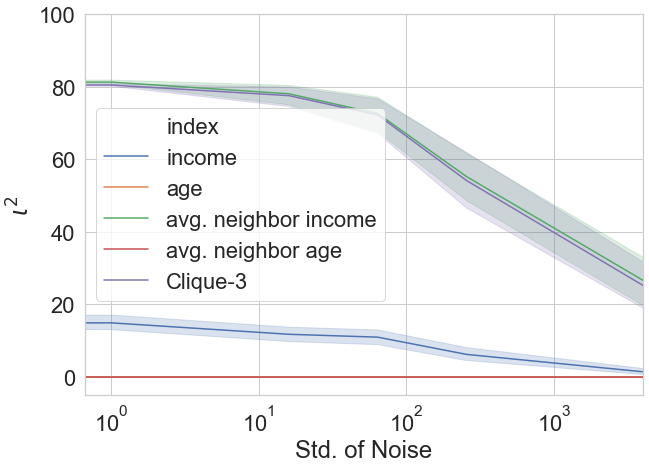

In [53]:
sns.set(font_scale=2)
sns.set_style("whitegrid")
fig = plt.figure(figsize=(10,7))
sns.lineplot(x='Noise',y='I2',hue='index',data=output1)
plt.ylim(-5,100)
# plt.xlim(0,4090)
plt.xscale('log')
plt.xlim(0,4000)
plt.ylabel('$\iota^2$')
plt.xlabel('Std. of Noise')
plt.savefig('I2vsNumSamples_noise.png')

In [46]:
print(output1.iloc[:5][['Q','I2']].to_latex())

\begin{tabular}{lrr}
\toprule
{} &         Q &         I2 \\
\midrule
X0          &  1.165690 &  14.235375 \\
X1          &  0.000292 &   0.000000 \\
neighbor\_X0 &  5.388084 &  81.445166 \\
neighbor\_X1 &  0.001981 &   0.000000 \\
Clique-3    &  5.192241 &  80.745309 \\
\bottomrule
\end{tabular}

